<a href="https://colab.research.google.com/github/Boxrof/DMP_Research/blob/main/TrkAnaSU2020_9_9_2021.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Install kerberos

In [ ]:
!apt-get install krb5-user

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  bind9-host geoip-database krb5-config libbind9-160 libdns1100 libgeoip1
  libgssrpc4 libisc169 libisccc160 libisccfg160 libkadm5clnt-mit11
  libkadm5srv-mit11 libkdb5-9 liblwres160
Suggested packages:
  geoip-bin krb5-doc
The following NEW packages will be installed:
  bind9-host geoip-database krb5-config krb5-user libbind9-160 libdns1100
  libgeoip1 libgssrpc4 libisc169 libisccc160 libisccfg160 libkadm5clnt-mit11
  libkadm5srv-mit11 libkdb5-9 liblwres160
0 upgraded, 15 newly installed, 0 to remove and 39 not upgraded.
Need to get 3,848 kB of archives.
After this operation, 15.2 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic-updates/main amd64 libisc169 amd64 1:9.11.3+dfsg-1ubuntu1.15 [238 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/main amd64 libgeoip1 amd64 1.6.12-1 [71.8 kB]
Get:3 http:/

In [ ]:
!wget https://authentication.fnal.gov/krb5conf/Linux/krb5.conf

--2021-06-24 22:13:41--  https://authentication.fnal.gov/krb5conf/Linux/krb5.conf
Resolving authentication.fnal.gov (authentication.fnal.gov)... 131.225.105.240, 2620:6a:0:105::105:240
Connecting to authentication.fnal.gov (authentication.fnal.gov)|131.225.105.240|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 17486 (17K) [text/plain]
Saving to: ‘krb5.conf’

krb5.conf           100%[===================>]  17.08K  --.-KB/s    in 0.1s    

2021-06-24 22:13:42 (175 KB/s) - ‘krb5.conf’ saved [17486/17486]



In [ ]:
import os
os.environ['KRB5_CONFIG'] = 'krb5.conf'

#Copy files from FNAL

In [ ]:
!kinit oksuzian@FNAL.GOV

Password for oksuzian@FNAL.GOV: 


In [ ]:
!scp -o StrictHostKeyChecking=no -o GSSAPIAuthentication=yes -o GSSAPIDelegateCredentials=yes oksuzian@mu2egpvm04.fnal.gov:/mu2e/data/users/oksuzian/nts.oksuzian.RecoMCTrig.cry3-reco-hi.28PE.pulses.root .
!scp -o StrictHostKeyChecking=no -o GSSAPIAuthentication=yes -o GSSAPIDelegateCredentials=yes oksuzian@mu2egpvm04.fnal.gov:/mu2e/data/users/oksuzian/nts.oksuzian.RecoMCTrig.cry3-reco-lo.28PE.pulses.root .
!scp -o StrictHostKeyChecking=no -o GSSAPIAuthentication=yes -o GSSAPIDelegateCredentials=yes oksuzian@mu2egpvm04.fnal.gov:/mu2e/data/users/oksuzian/ana.cele0s42b2.su2020v2.root .

In [ ]:
!cp ana.*.root drive/MyDrive/root_files_oksuzian/


































#Init

In [1]:
import sys

# This allows you to run on Colaboratory and load files from your Google Drive
try:
    from google.colab import drive
    drive.mount("/content/drive")
    main_path = '/content/drive/My Drive/'
except:
    main_path = ''
sys.path.append(main_path)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
%%capture
%pip install uproot3
%pip install weightwatcher
%pip install h5py

In [3]:
def default_flatname(branchname, fieldname, index):
    """This replaces the dot in the column names with underscores"""
    out = branchname.replace(".", "_")
    if not isinstance(branchname, str):
        out = branchname.decode("utf-8")
    if fieldname is not None:
        fieldname.replace(".", "_")
        out += "_" + fieldname
    if index != ():
        out += "[" + "][".join(str(x) for x in index) + "]"
    return out

In [4]:
import uproot3
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from plotly import graph_objs as go
import pylab
import seaborn as sns
import numpy as np
import pandas as pd
pd.set_option('display.float_format', lambda x: '%.1f' % x)
plt.style.use('seaborn-whitegrid')
plt.rcParams["grid.linestyle"] = (5,15)
plt.rcParams["grid.linewidth"] = 0.5
plt.rcParams["figure.figsize"] = (10,5)
plt.rcParams.update({'font.size': 22})

#Keras libs
import keras
from keras.models import Sequential, Model, Input
from keras.layers.core import Dense, Activation
from keras.layers import BatchNormalization, Dropout, concatenate
from keras.callbacks import ModelCheckpoint, EarlyStopping, Callback
from tensorflow.keras.optimizers import Adam
import keras.backend as K
from keras.models import load_model

import math
import sklearn.utils
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
from sklearn.model_selection import train_test_split

from sklearn.metrics import roc_curve
from sklearn.metrics import auc
from sklearn.metrics import brier_score_loss
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score, cohen_kappa_score, plot_confusion_matrix
import string
import torchvision.models as models
import weightwatcher as ww
from decimal import Decimal
from mpl_toolkits.axisartist.axislines import AxesZero
import pickle

In [ ]:
ww_translation = {
'alpha':'Alpha',
'alpha_weighted':'Alpha*log Max Eigenvalue',
'log_alpha_norm':'log sum(Eigenvalue^Alpha)',
'log_norm':'log sqrt(Layer Eigenvalue Sum)',
'log_spectral_norm': 'log sqrt(Max Layer Eigenvalue)',
'stable_rank': 'Stable Rank'
}

ww_titles = {
'alpha':'Alpha',
'alpha_weighted':'Weighted Alpha',
'log_alpha_norm':'log Alpha Norm',
'log_norm':'log Frobenius Norm',
'log_spectral_norm': 'log Spectral Norm',
'stable_rank': 'Stable Rank'
}

superTotal = 7530000 #This is the total number of events generated by Yuri

class Dropout(keras.layers.Dropout): #ripped straight from https://indico.cern.ch/event/917074/contributions/3855332/attachments/2035180/3407260/MCDropoutMLCoffee8thMay.pdf
  def __init__(self, rate, training=None, noise_shape=None, seed=None, **kwargs):
    super(Dropout, self).__init__(rate, noise_shape=None, seed=None, **kwargs)
    self.training = training

  def call(self, inputs, training=None):
    if 0. < self.rate < 1.:
      noise_shape = self._get_noise_shape(inputs)

      def dropped_inputs():
        return K.dropout(inputs, self.rate, noise_shape, seed=self.seed)
      
      if not training:
        return K.in_train_phase(dropped_inputs, inputs, training=self.training)
      
      return K.in_train_phase(dropped_inputs, inputs, training=training)
    
    return inputs

class AlphaEarlyStopping(keras.callbacks.Callback):
  def __init__(self):
    super(AlphaEarlyStopping, self).__init__()
    self.weight = ww.WeightWatcher(model=self.model)
  
  def on_epoch_end(self, epoch, logs={}):
    summary = self.weight.get_summary(self.weight.analyze(model=self.model))
    print('Current alpha value of', summary['alpha'])
    if summary['alpha'] <= 2.01:
      self.model.stop_training = True
    logs['weights'] = np.array([summary['alpha'],summary['alpha_weighted'],summary['log_alpha_norm'],summary['log_norm'],summary['log_spectral_norm'],summary['stable_rank']])

  # def on_epoch_begin(self, epoch, logs={}):
  #   self.weight = ww.WeightWatcher(model=self.model)
  #   summary = self.weight.get_summary(self.weight.analyze(model=self.model))
  #   if summary['alpha'] <= 2:
  #     self.model.stop_training = True

class MLAnalyzer(object):

  def __str__(self):
    printed = ""
    for l in self.model.layers:
      printed += str(l.name) + ' ' + str(l.input_shape[1]) + ' ==> ' + str(l.output_shape[1]) + '\n'
    return printed

  def __init__(self, varcolumns=None, xTrain=None, yTrain=None, xVal=None, yVal=None, xTest=None, yTest=None, model=None, history=None, scaler=None):
    self.model = model
    self.history = history

    self.xTrain = xTrain
    self.yTrain = yTrain
    self.xVal = xVal
    self.yVal = yVal
    self.xTest = xTest
    self.yTest = yTest
    self.cols = varcolumns #Dictionary of variables and their ranges
    self.scaler = scaler

    self.rejectionList = []
    self.ceList = []
    
    self.predictions = []
    self.avg_predictions = []
    self.cutoff = -1
    self.rounded_predictions = []
    self.eventError = []

    self.conf_matrix = []
    self.fractional_matrix = []
    self.matrix_errors = []
    self.event_errors = []
    self.final_matrix = None

    self.TPInputs = [] #True positive
    self.FPInputs = [] #False positive
    self.FNInputs = [] #False negative
    self.TNInputs = [] #True negative


  def weightAnalysis(self):
    self.weight = ww.WeightWatcher(model=self.model)
    details = self.weight.analyze()
    summary = self.weight.get_summary(details)
    return details, summary

  def plotWeights(self):
    weightFrame = pd.DataFrame(self.history.history['weights'], columns=['alpha','alpha_weighted','log_alpha_norm','log_norm','log_spectral_norm','stable_rank'])
    for col in weightFrame:
      plt.figure();
      plt.plot(np.array(self.history.epoch) + 1, weightFrame[col], marker='o');
      plt.title("Average " + ww_titles[col] + " VS Epoch");
      plt.xlabel("Epoch");
      plt.ylabel(ww_translation[col]);

  def trainModel(self, widthMultiplier = 2, depth = 4, batch = 100, retrain=True, modelPatience=5, epoch=250): #Use for further training or for re-training
    if retrain:
      keras.backend.clear_session() #This clears the previous training
    
    width = round(len(self.xTrain[0])*widthMultiplier)
    self.model = keras.Sequential()

    self.model.add(Dense(len(self.xTrain[0]), input_dim=len(self.xTrain[0]), activation='relu'))
    for i in range(depth):
      self.model.add(Dense(width, activation='relu'))
      self.model.add(Dropout(0.2, training=True))
    self.model.add(Dense(width, activation='relu'))
    self.model.add(Dense(1, activation='sigmoid'))

    self.model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

    es_callback = [keras.callbacks.EarlyStopping(monitor='val_loss', patience=modelPatience)]
    print("fitting model with width=",width,"\tdepth=",depth + 2,"\tsize=",1000*batch)
    print(len(self.xTrain[0]) + 1 + (depth+2)*width,"total neurons")
    self.history = self.model.fit(x=self.xTrain, y=self.yTrain, epochs=epoch, batch_size=1000*batch, validation_data=(self.xVal, self.yVal), verbose=True, callbacks = [AlphaEarlyStopping()]);

  def draw_neural_net(self, ax, left, right, bottom, top, layer_sizes, rate):
      '''
      Draw a neural network cartoon using matplotilb.
      
      :usage:
          >>> fig = plt.figure(figsize=(12, 12))
          >>> draw_neural_net(fig.gca(), .1, .9, .1, .9, [4, 7, 2])
      
      :parameters:
          - ax : matplotlib.axes.AxesSubplot
              The axes on which to plot the cartoon (get e.g. by plt.gca())
          - left : float
              The center of the leftmost node(s) will be placed here
          - right : float
              The center of the rightmost node(s) will be placed here
          - bottom : float
              The center of the bottommost node(s) will be placed here
          - top : float
              The center of the topmost node(s) will be placed here
          - layer_sizes : list of int
              List of layer sizes, including input and output dimensionality
      '''
      n_layers = len(layer_sizes)
      v_spacing = (top - bottom)/(max(layer_sizes))
      h_spacing = (right - left)/(len(layer_sizes) - 1)
      dropped_out = {}
      # Nodes
      for n, layer_size in enumerate(layer_sizes):
          dropped = np.random.choice(layer_size, math.floor(layer_size*rate), replace=False)
          # if n != 0 and n < len(layer_sizes) - 2:
          dropped_out[n] = dropped
          layer_top = v_spacing*(layer_size - 1)/2. + (top + bottom)/2.
          for m in range(layer_size):
              circle = plt.Circle((n*h_spacing + left, layer_top - m*v_spacing), v_spacing/4.,
                                  color='w', ec='k', zorder=4)
              if m in dropped and n != 0 and n < len(layer_sizes) - 2 and n != 1:
                circle = plt.Circle((n*h_spacing + left, layer_top - m*v_spacing), v_spacing/4.,
                                  color='r', ec='k', zorder=4)
              ax.add_artist(circle)
      # Edges
      for n, (layer_size_a, layer_size_b) in enumerate(zip(layer_sizes[:-1], layer_sizes[1:])):
          layer_top_a = v_spacing*(layer_size_a - 1)/2. + (top + bottom)/2.
          layer_top_b = v_spacing*(layer_size_b - 1)/2. + (top + bottom)/2.
          for m in range(layer_size_a):
              for o in range(layer_size_b):
                  if n == 0:
                    line = plt.Line2D([n*h_spacing + left, (n + 1)*h_spacing + left],
                                  [layer_top_a - m*v_spacing, layer_top_b - o*v_spacing], c='k')
                    ax.add_artist(line)

                  if n == 1:
                    if o not in dropped_out.get(n+1):
                      line = plt.Line2D([n*h_spacing + left, (n + 1)*h_spacing + left],
                                  [layer_top_a - m*v_spacing, layer_top_b - o*v_spacing], c='k')
                      ax.add_artist(line)
                      
                  elif n < len(layer_sizes) - 3:
                    if m not in dropped_out.get(n) and o not in dropped_out.get(n + 1):
                      line = plt.Line2D([n*h_spacing + left, (n + 1)*h_spacing + left],
                                    [layer_top_a - m*v_spacing, layer_top_b - o*v_spacing], c='k')
                      ax.add_artist(line)
                  elif n == len(layer_sizes) - 3:
                    if m not in dropped_out.get(n):
                      line = plt.Line2D([n*h_spacing + left, (n + 1)*h_spacing + left],
                                    [layer_top_a - m*v_spacing, layer_top_b - o*v_spacing], c='k')
                      ax.add_artist(line)
                  else:
                    line = plt.Line2D([n*h_spacing + left, (n + 1)*h_spacing + left],
                                    [layer_top_a - m*v_spacing, layer_top_b - o*v_spacing], c='k')
                    ax.add_artist(line)
  def draw(self, rate):
    layers = []
    first = True
    if self.model == None:
      print("Need to create the model to draw it!")
      return
    for l in self.model.layers:
      if 'dense' not in str(l.name):
        continue
      if first:
        layers += [l.input_shape[1]]
        first = False
      layers += [l.output_shape[1]]
    fig = plt.figure(figsize=(len(layers)*2, len(layers)*2))
    plt.axis('off');
    self.draw_neural_net(fig.gca(), 0.05, 0.95, 0, 0.95, layers, rate)


  def plotAcc(self):

    try:
      self.history.history['accuracy']
    except:
      print("Need to train the model first!")
      return None
    
    fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=True, figsize=(14,5))

    ax1.plot(self.history.history['accuracy'], label="training");
    ax1.plot(self.history.history['val_accuracy'], label="validation");
    ax1.set_title('model accuracy');
    ax1.set_ylabel('accuracy');
    ax1.set_xlabel('epoch');
    ax1.legend(loc='bottom right');
    ax1.set_ylim(0.99,1);

    ax2.plot(self.history.history['loss'], 'r-', label="training")
    ax2.plot(self.history.history['val_loss'], 'g-', label="validation")
    ax2.set_title('model loss');
    ax2.set_ylabel('loss');
    ax2.set_xlabel('epoch');
    ax2.legend(loc='best');
    ax2.set_ylim(0,0.1);
    plt.tight_layout();
    plt.show()

  def predictMC(self, num_iter = 10):
    for i in range(num_iter):
      self.predictions.append(self.model.predict(self.xTest, verbose=1).reshape(-1))
      print("iteration", i + 1, "done")
    self.avg_predictions = np.mean(self.predictions, axis=0).reshape(-1)


  def cutoffTime(self, matching_cosmic=True, predefinedcutoff=False):

    def cutoffScanner(ytest, prediction, upper, lower): #Defined within function so that global variable can be used
      divider = (upper + lower)/2
      rounded = np.where(prediction < divider, 0, 1)
      confusion = confusion_matrix(ytest, rounded, normalize='true');
      self.rejectionList.append((divider, 1 - confusion[1][1]))
      self.ceList.append((divider, 1 - confusion[0][0]))

      if divider < 0.0001 and round(confusion[1][1], 6) != 1:
        print("Mission failed, we'll get em next time. Closest cutoff found of: ", divider)
        return divider, confusion_matrix(ytest, rounded), rounded, confusion

      elif (round(confusion[1][1],4) == 0.9999):
        # print("Cutoff found of: ", divider)
        return divider, confusion_matrix(ytest, rounded), rounded, confusion

      elif round(confusion[1][1],4) > 0.9999:
        return cutoffScanner(ytest, prediction, upper, divider)

      else:
        return cutoffScanner(ytest, prediction, divider, lower)

    def cutoffScannerCE(ytest, prediction, upper, lower):
      divider = (upper + lower)/2
      rounded = np.where(prediction < divider, 0, 1)
      confusion = confusion_matrix(ytest, rounded, normalize='true');
      self.rejectionList.append((divider, 1 - confusion[1][1]))
      self.ceList.append((divider, 1 - confusion[0][0]))

      if divider < 0.0001 and round(confusion[0][0], 6) != 1:
        print("Mission failed, we'll get em next time. Closest cutoff found of: ", divider)
        return divider, confusion_matrix(ytest, rounded), rounded, confusion

      elif (round(confusion[0][0],2) == 0.60):
        # print("Cutoff found of: ", divider)
        return divider, confusion_matrix(ytest, rounded), rounded, confusion

      elif round(confusion[0][0],2) < 0.60:
        return cutoffScannerCE(ytest, prediction, upper, divider)

      else:
        return cutoffScannerCE(ytest, prediction, divider, lower)

    def outputHisto(prediction, ytest, cutoff):
      fig, ax = plt.subplots(1,2, figsize=(30,7))


      ax[0].hist(prediction[ytest==1], range=(-0.1,1.1), bins=1000, histtype='step', label='Cosmics');
      ax[0].hist(prediction[ytest==0], range=(-0.1,1.1), bins=1000, histtype='step', label='CE & Noise');
      ax[0].axvline(cutoff, label="Cutoff = " + str(round(cutoff, 5)), color='black')
      ax[0].set_yscale('log');
      ax[0].legend(loc='upper center');

      fpr_keras, tpr_keras, thresholds_keras = roc_curve(ytest, prediction);
      auc_keras = auc(fpr_keras, tpr_keras);
      ax[1].plot([0, 1], [0, 1], 'k--');
      ax[1].plot(fpr_keras, tpr_keras, label='Keras test data(area = {:.5f})'.format(auc_keras));
      ax[1].set_xlabel('False positive rate');
      ax[1].set_ylabel('True positive rate');
      ax[1].set_title('ROC curve');
      ax[1].set_ylim(0.999,1.001);
      # ax[1].set_yscale('log');
      ax[1].legend();

      ax[0].set_title("Values Returned for Cosmics and CE/Noise");
      ax[0].set_xlabel("Value Returned");
      ax[0].set_ylabel("Frequency");

    def confusionmatrix(eff, percentage, cutoff):
      plt.figure(figsize=(10,7))
      
      annotStr = annot=np.array([[str(round(eff[0][0])) + '\n(' + str(round(percentage[0][0],5)) + ')', str(round(eff[0][1])) + '\n(' + str(round(percentage[0][1],5)) + ')'], [str(round(eff[1][0])) + '\n(' + str(round(percentage[1][0],5)) + ')', str(round(eff[1][1])) + '\n(' + str(round(percentage[1][1],5)) + ')']])

      ax = sns.heatmap(percentage, annot=annotStr, xticklabels=["CE + Noise", "cosmic"], yticklabels=["CE + Noise", "cosmic"], fmt='.18s', cbar_kws={'label': 'Fraction of Events'});
      
      ax.set(title="Confusion Matrix with Cutoff at " + str(round(cutoff, 5)),
            xlabel="Predicted Label",
            ylabel="True Label",);

    cutoff, effs, rounded_predictions, percentages = (None,None,None,None)
    if not predefinedcutoff:
      if matching_cosmic:
        cutoff, effs, rounded_predictions, percentages = cutoffScanner(self.yTest, self.avg_predictions, 1, 0)
      else:
        cutoff, effs, rounded_predictions, percentages = cutoffScannerCE(self.yTest, self.avg_predictions, 1, 0)
    else:
      cutoff = predefinedcutoff
      rounded_predictions = np.where(self.avg_predictions < predefinedcutoff, 0, 1)
      effs = confusion_matrix(self.yTest, rounded_predictions)
      percentages = confusion_matrix(self.yTest, rounded_predictions, normalize='true')

    # confusionmatrix(effs, percentages, cutoff)
    outputHisto(self.avg_predictions, self.yTest, cutoff)
    plt.tight_layout();
    plt.show();
    
    self.cutoff = cutoff
    self.fractional_matrix = percentages
    self.rounded_predictions = rounded_predictions
    self.conf_matrix = effs

  def cutoffPlot(self):
    if self.rejectionList == [] or self.ceList == []:
      print("Need to select cutoff values first!")
      return
    fig, ax = plt.subplots(2,1, figsize=(8,12), sharex=True)
    self.rejectionList = sorted(self.rejectionList)
    self.ceList = sorted(self.ceList)
    ax[0].plot(*zip(*self.rejectionList), label="Cosmic", color='blue', marker='o');
    ax[1].plot(*zip(*self.ceList), label="CE", color='orange', marker='o');
    # if self.cutoff < 0.01:
    plt.xscale('log');
    ax[0].set_ylabel('Inefficiency');
    ax[1].set_ylabel('Inefficiency');
    ax[0].set_title('Cosmic');
    ax[1].set_title('CE & Noise');
    fig.suptitle("Rate of Failed Identification VS Cutoff Value", y=1.01);
    fig.text(0.45,0,"Cutoff Value");
    plt.tight_layout();
    plt.show()

  def quadrantDistribution(self, nbins):
    self.TPInputs = []
    self.FPInputs = []
    self.FNInputs = []
    self.TNInputs = []
    if self.predictions == []:
      print("You have to train and predict with the model first!")
    self.eventError = np.std(self.predictions, axis=0)
    # inputDF = pd.DataFrame(self.xTest, columns=self.cols.keys())
    for i in range(len(self.yTest)): #Placing everything in its respective bucket
        if (self.rounded_predictions[i] == 1) and (self.yTest[i] == 1):
          # self.TPErrors[i] = self.eventError[i]
          self.TPInputs.append(self.xTest[i])
        elif self.rounded_predictions[i] == 1 and self.yTest[i] == 0:
          # FPErrors[i] = AbsoluteErrors[i]
          self.FPInputs.append(self.xTest[i])
        elif self.rounded_predictions[i] == 0 and self.yTest[i] == 1:
          # FNErrors[i] = AbsoluteErrors[i]
          self.FNInputs.append(self.xTest[i])
        elif self.rounded_predictions[i] == 0 and self.yTest[i] == 0:
          # TNErrors[i] = AbsoluteErrors[i]
          self.TNInputs.append(self.xTest[i])


    self.TPInputs = pd.DataFrame(self.scaler.inverse_transform(np.array(self.TPInputs)), columns=list(self.cols.keys()))
    self.FPInputs = pd.DataFrame(self.scaler.inverse_transform(np.array(self.FPInputs)), columns=list(self.cols.keys()))
    self.FNInputs = pd.DataFrame(self.scaler.inverse_transform(np.array(self.FNInputs)), columns=list(self.cols.keys()))
    self.TNInputs = pd.DataFrame(self.scaler.inverse_transform(np.array(self.TNInputs)), columns=list(self.cols.keys()))
    
    for var in self.cols:
      plt.figure(figsize=(20, 10))
      plt.hist(self.TPInputs[var], histtype='step', label="True Cosmics", bins=nbins, density=True,  range=self.cols[var]);
      plt.hist(self.FPInputs[var], histtype='step', label="Cosmic Labelled as CE/noise", bins=nbins, density=True,  range=self.cols[var]);
      plt.hist(self.FNInputs[var], histtype='step', label="CE/noise labelled as Cosmic", bins=nbins, density=True,  range=self.cols[var]);
      plt.hist(self.TNInputs[var], histtype='step', label="True CE/noise", bins=nbins, density=True,  range=self.cols[var]);
      # plt.xlabel(translation[var])
      plt.yscale('log');
      plt.ylabel('Normalized Frequency');
      plt.legend(prop={'size': 20});
      plt.title(var)
      plt.show();
  
  def finalConfusion(self):

    def stDevBased():
      conf_errors = []
      for i in self.predictions:
        conf_errors.append(confusion_matrix(self.yTest, np.where(i < self.cutoff, 0, 1)))
      conf_errors = np.array(conf_errors)
      conf_errors = np.std(conf_errors, axis=0)
      return conf_errors

    plt.figure(figsize=(10,7))
    newEffs = np.array([['0'*50,'0'*50],['0'*50,'0'*50]])
    counter = 0
    self.matrix_errors = stDevBased()
    for i,j,z in zip(self.conf_matrix, self.matrix_errors, self.fractional_matrix):
      i = np.round(i)
      j = np.round(j)
      z = np.round(z,4)
      jj = np.round(j/(i[0]+i[1]),6)
      newEffs[counter][0] = str(i[0]) + " +/- " + str(j[0])
      newEffs[counter][0] += '\n(' + str(z[0]) + " +/- " + str('%.1e' %Decimal(jj[0])) + ')'
      newEffs[counter][1] = str(i[1]) + " +/- " + str(j[1])
      newEffs[counter][1] += '\n(' + str(z[1]) + " +/- " + str('%.1e' %Decimal(jj[1])) + ')'
      counter += 1

    ax = sns.heatmap(self.fractional_matrix, annot=newEffs, xticklabels=["CE/Noise", "cosmic"], yticklabels=["CE/Noise", "cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'});
    
    ax.set(title="Confusion Matrix with Cutoff at " + str(round(self.cutoff, 5)),
          xlabel="Predicted Label",
          ylabel="True Label",);

    self.final_matrix = ax
  
  def save(self, fname):
    modelpath = main_path + 'saved_models'
    dump = open(modelpath + '/' + fname + '.pkl', 'wb+')

    pickle.dump((self.xTrain, self.yTrain, self.xVal, self.yVal, self.xTest, self.yTest), dump)

    self.model.save(modelpath + '/' + fname + '.h5')

  def load(self, fname):
    modelpath = main_path + 'saved_models'
    sifter = open(modelpath + '/' + fname + '.pkl', 'rb')
    self.xTrain, self.yTrain, self.xVal, self.yVal, self.xTest, self.yTest = pickle.load(sifter)
    self.model = load_model(modelpath + '/' + fname + '.h5')

  def errorPlot(self):
    self.event_errors = np.std(self.predictions, axis=0)

    plt.hist2d(self.avg_predictions, self.event_errors,bins=(50,50), norm=matplotlib.colors.LogNorm(), cmap=plt.cm.YlOrBr);
    plt.colorbar();
    plt.title('Uncertainty Distribution in events based on prediction value');
    plt.xlabel('Averaged Prediction');
    plt.ylabel('Prediction Uncertainty');
    plt.show()

In [ ]:
superTotal = 7530000

#Load Data

In [ ]:
fileopener = open(main_path+"Saved_Data/noCoincidence.pkl", "rb")
noCRV_y_train, no_CRV_y_test, noCRV_y_val, noCRVscaler, noCRV_X_train, no_CRV_X_test, noCRV_X_val, noCRV_X_train_df, no_CRV_X_test_df, noCRV_X_val_df, noCRV_X_testMOM, noCRV_X_testCUT = pickle.load(fileopener)

In [ ]:
fileopener = open(main_path+"Saved_Data/Coincidence.pkl", "rb")
CRV_y_train, CRV_y_test, CRV_y_val, CRVscaler, CRV_X_train, CRV_X_test, CRV_X_val, CRV_X_train_df, CRV_X_test_df, CRV_X_val_df, CRV_X_testMOM, CRV_X_testCUT = pickle.load(fileopener)

In [ ]:
# fileopener = open(main_path+"Saved_Data/allData.pkl", "rb")
# df = pickle.load(fileopener)

#Define variables list

In [ ]:
all_variables_list = {'crvinfo__x': [-8000, 1000], 
                  'crvinfo__y': [0, 3500],
                  'crvinfo__z': [-5000, 20000],
                  'de_nhits': [-2, 100],
                  'ue_nhits': [-2, 100],
                  'dequal_TrkPID': [-1.1, 1.1],
                  'dequal_TrkQual': [-0.1, 1.1],
                  'deent_td': [0, 10],
                  'deent_z0': [-500,500],
                  'deent_d0': [-500,500],
                  'deent_om': [-0.01, 0.05],
                  'crvinfo__PEs': [-1, 1000],
                  'crvinfo__dT': [-500, 500],
                  'deent_mom': [50, 200],
                  'deent_d0_om' : [300, 1200]
                  }

In [ ]:
Z_variables_list = {
                  'de_nhits': [-2, 100],
                  'ue_nhits': [-2, 100],
                  'dequal_TrkPID': [-1.1, 1.1],
                  'dequal_TrkQual': [-0.1, 1.1],
                  'deent_td': [0, 10],
                  'deent_z0': [-500,500],
                  'deent_d0': [-500,500], #only z as the crv variable
                  'deent_om': [-0.01, 0.05],
                  'deent_mom': [50, 200],
                  'deent_d0_om' : [300, 1200],
                  'crvinfo__z': [-5000, 20000]
                  }

In [ ]:
dT_variables_list = {
                  'de_nhits': [-2, 100],
                  'ue_nhits': [-2, 100],
                  'dequal_TrkPID': [-1.1, 1.1],
                  'dequal_TrkQual': [-0.1, 1.1], #only dT as the crv variable
                  'deent_td': [0, 10],
                  'deent_z0': [-500,500],
                  'deent_d0': [-500,500],
                  'deent_om': [-0.01, 0.05],
                  'crvinfo__dT': [-500, 500],
                  'deent_mom': [50, 200],
                  'deent_d0_om' : [300, 1200]
                  }

In [ ]:
dTZ_variables_list = {
                  'de_nhits': [-2, 100],
                  'ue_nhits': [-2, 100],
                  'dequal_TrkPID': [-1.1, 1.1],
                  'dequal_TrkQual': [-0.1, 1.1],
                  'deent_td': [0, 10],
                  'deent_z0': [-500,500],
                  'deent_d0': [-500,500],
                  'deent_om': [-0.01, 0.05],
                  'crvinfo__dT': [-500, 500],
                  'deent_mom': [50, 200],
                  'deent_d0_om' : [300, 1200],
                  'crvinfo__z': [-5000, 20000]
                  }

In [ ]:
dTZPE_noMom_variables_list = {
                  'crvinfo__z': [-5000, 20000],
                  'crvinfo__PEs': [-1, 1000],
                  'crvinfo__dT': [-500, 500],
                  'de_nhits': [-2, 100],
                  'ue_nhits': [-2, 100],
                  'dequal_TrkPID': [-1.1, 1.1],
                  'dequal_TrkQual': [-0.1, 1.1],
                  'deent_td': [0, 10],
                  'deent_z0': [-500,500],
                  'deent_d0': [-500,500],
                  'deent_om': [-0.01, 0.05],
                  'deent_d0_om' : [300, 1200]
                  }

In [ ]:
noCRV_noMom_variables_list = {
                  'de_nhits': [-2, 100],
                  'ue_nhits': [-2, 100],
                  'dequal_TrkPID': [-1.1, 1.1],
                  'dequal_TrkQual': [-0.1, 1.1],
                  'deent_td': [0, 10],
                  'deent_z0': [-500,500],
                  'deent_d0': [-500,500],
                  'deent_om': [-0.01, 0.05],
                  'deent_d0_om' : [300, 1200]
                  }

In [ ]:
translation = {'crvinfo__x': "x position", 
                  'crvinfo__y': "y position",
                  'crvinfo__z': "z position",
                  'de_nhits': "Downstream tracker hits",
                  'ue_nhits': "Upstream tracker hits",
                  'dequal_TrkPID': "Particle ID", #calorimeter
                  'dequal_TrkQual': "Track Quality",
                  'deent_td': "Pitch Angle", #z axis
                  'deent_z0': "z0 of track",
                  'deent_d0': "distance from z axis",
                  'deent_om': 'Min transverse radius',
                  'crvinfo__PEs': "PE yield",
                  'crvinfo__dT': "Delta-T = T_crv - T_tracker",
                  'deent_mom': "Momentum",
                  'deent_d0_om' : 'Max transverse radius',
                  'is_cosmic':'cosmic status'
                  }

In [ ]:
variables_list = all_variables_list

#Define cuts

In [ ]:
#Default MDC-style cut box
cuts = [
    "(de_status > 0)",
    "(deent_td > 0.577350)",
    "(deent_td < 1.000)",
    "(deent_d0 > -80)",
    "(deent_d0 < 105)",
    "((deent_d0 + 2./deent_om) > 450)",
    "((deent_d0 + 2./deent_om) < 680)",
    "(is_triggered)"
]
cut_tbox = " & ".join(cuts)
#PID, TrkQual and cut on events with an usptream leg
cuts = [
    "(dequal_TrkQual > 0.8)",
    "(dequal_TrkPID > 0.95)",
    "(ue_status <= 0)"
]
cut_pid_trkqual_ue = " & ".join(cuts)
# Extended momentum window cut`
cuts = [
    "(deent_mom > 103.85)",
    "(deent_mom < 105.1)"
    # "(deent_mom > 100)",
    # "(deent_mom < 110)"
]
cut_extmom = " & ".join(cuts)
# Loose box cuts
cuts = [
    "(deent_td > 0.577350)",
    "(deent_td < 1.000)",
    "(deent_d0 > -80)",
    "(deent_d0 < 205)",
    "((deent_d0 + 2./deent_om) > 450)",
    "(is_triggered)"
]

crv_time = "((-de_t0 + crvinfo__timeWindowStart) > 50 | (de_t0-crvinfo__timeWindowStart) > 150.0)"

#crv_time = "de_t0-crvinfo__timeWindowStart > 350.0"


cut_lbox = " & ".join(cuts)

cut_lbox = " & ".join(cuts)


In [ ]:
#Combime cuts
cut_nomom  = cut_tbox +" & "+cut_pid_trkqual_ue
cut_extmom_orig = cut_extmom
cut_extmom = cut_tbox +" & "+cut_pid_trkqual_ue+" & "+cut_extmom
cut_loose  = cut_lbox +" & "+cut_pid_trkqual_ue

#Load dataframes (Don't run if loading data)

In [ ]:
fileH = uproot3.open("drive/MyDrive/root_files_oksuzian/nts.oksuzian.RecoMCTrig.cry3-reco-hi.28PE.pulses.root")
fileL = uproot3.open("drive/MyDrive/root_files_oksuzian/nts.oksuzian.RecoMCTrig.cry3-reco-lo.28PE.pulses.root")
fileB = uproot3.open("drive/MyDrive/root_files_oksuzian/ana.cele0s42b2.su2020v2.root")
filePE = uproot3.open("drive/MyDrive/root_files_oksuzian/ana.dzhadan.RecoMC.7000.root")
trkanaH = fileH["TrkAnaNeg"]["trkana"]
trkanaL = fileL["TrkAnaNeg"]["trkana"]
trkanaB = fileB["TrkAnaNeg"]["trkana"]
trkanaPE = filePE["TrkAnaNeg"]["trkana"]

In [ ]:
dfL_eve = trkanaL.pandas.df(['evtinfo.', 'de', 'deent', 'dequal', 'demc', 'trigbits', 'ue', 'crvsummary*'], flatname=default_flatname, flatten=True)
dfL_crv = trkanaL.pandas.df(['crvinfo.*', 'crvinfomc.*', 'bestcrv'], flatname=default_flatname, flatten=True)

dfH_eve = trkanaH.pandas.df(['evtinfo.', 'de', 'deent', 'dequal', 'demc', 'trigbits', 'ue', 'crvsummary*'], flatname=default_flatname, flatten=True)
dfH_crv = trkanaH.pandas.df(['crvinfo.*', 'crvinfomc.*', 'bestcrv'], flatname=default_flatname, flatten=True)

dfB_eve = trkanaB.pandas.df(['evtinfo.', 'de', 'deent', 'dequal', 'demc', 'trigbits', 'ue', 'crvsummary*'], flatname=default_flatname, flatten=True)
dfB_crv = trkanaB.pandas.df(['crvinfo.*', 'crvinfomc.*', 'bestcrv'], flatname=default_flatname, flatten=True)

dfPE_eve = trkanaPE.pandas.df(['evtinfo.', 'de', 'deent', 'dequal', 'demc', 'trigbits', 'ue', 'crvsummary*'], flatname=default_flatname, flatten=True)
dfPE_crv = trkanaPE.pandas.df(['crvinfo.*', 'crvinfomc.*', 'bestcrv'], flatname=default_flatname, flatten=True)

dfL_crv = dfL_crv[dfL_crv.index.get_level_values('subentry') == dfL_crv["bestcrv"]]
dfH_crv = dfH_crv[dfH_crv.index.get_level_values('subentry') == dfH_crv["bestcrv"]]
dfB_crv = dfB_crv[dfB_crv.index.get_level_values('subentry') == dfB_crv["bestcrv"]]
dfPE_crv = dfPE_crv[dfPE_crv.index.get_level_values('subentry') == dfPE_crv["bestcrv"]]

pd.merge(dfL_eve, dfL_crv, how="left", on='entry')
dfL = dfL_eve.merge(dfL_crv, how="left", on="entry")
dfH = dfH_eve.merge(dfH_crv, how="left", on="entry")
dfB = dfB_eve.merge(dfB_crv, how="left", on="entry")
dfPE = dfPE_eve.merge(dfPE_crv, how="left", on="entry")

dfH['is_high'] = 1
dfL['is_high'] = 0
dfB['is_high'] = -1
dfPE['is_high'] = -2

df = pd.concat([dfH, dfL, dfB, dfPE], axis=0)
df["crvinfo__dT"] = df["crvinfo__timeWindowStart"] - df["de_t0"]
df['deent_d0_om'] = df["deent_d0"]+2.0/df["deent_om"]
df["is_triggered"] = (df["trigbits"].values & 0x208) > 0

df = df.fillna(-999999)


INFO:numexpr.utils:NumExpr defaulting to 2 threads.


In [ ]:
# plt.hist(df.query('is_high==-1')['evtinfo__subrunid'], bins=15000);
# df.query('is_high==-1').groupby(['evtinfo__subrunid']).evtinfo__subrunid.count()

In [ ]:
del dfB_eve, dfB_crv, dfL_eve, dfL_crv, dfH_eve, dfH_crv, dfH, dfL, dfB, dfPE, dfPE_crv, dfPE_eve

In [ ]:
with open(main_path+"Saved_Data/allData.pkl", "wb+") as f:
  pickle.dump(df, f)

In [ ]:
#del dfH, dfL, dfB

In [ ]:
#df.to_hdf('drive/MyDrive/root_files/cosmic_ce_cominded.h5', key='df', mode='w')
#pd.read_hdf('drive/MyDrive/root_files/cosmic_ce_cominded.h5', 'df')

#Use Cuts

In [ ]:
# df_cut_nomom = df.query(cut_nomom)
df_cut_extmom = df.query(cut_extmom)
# df_cut_loose = df.query(cut_loose)
df_time = df.query(crv_time + " & " + cut_extmom) #changed this to reflect momentum cut

INFO:numexpr.utils:NumExpr defaulting to 2 threads.


In [ ]:
# no = len((df_cut_nomom[(df_cut_nomom["is_high"]==1) | (df_cut_nomom["is_high"] == 0)]))
# noN = len(df_cut_nomom[df_cut_nomom["is_high"] == -1])

ex = len((df_cut_extmom[(df_cut_extmom["is_high"]==1) | (df_cut_extmom["is_high"] == 0)]))
exN = len(df_cut_extmom[df_cut_extmom["is_high"] == -1])

# lo = len((df_cut_loose[(df_cut_loose["is_high"]==1) | (df_cut_loose["is_high"] == 0)]))
# loN = len(df_cut_loose[df_cut_loose["is_high"] == -1])

time = len(df_time[(df_time["is_high"] == 1) | (df_time["is_high"]==0)])
timeN = len(df_time[df_time["is_high"]== -1])

tot = len(df[(df["is_high"] == 1) | (df["is_high"] == 0)])
totN = len(df[df["is_high"] == -1])

# print("Number of cosmics that exist:", tot)
# print("Number of CEs that exist:", totN)
# print("-"*25,"combined cuts","-"*25)
# print("Number of cosmics found with no time or momentum cuts:", no)
# print("Cosmic veto efficiency without CRV:", 1-no/tot)
# print()
# print("Number of CEs found with no time or momentum cuts:", noN)
# print("CE Efficiency:", noN/totN)

# print("-"*25,"time cut","-"*25)
# print("Number of cosmics found with time cut:", time)
# print("Cosmic veto efficiency with CRV:", 1 - time/tot)
# print()
# print("Number of CEs found with time cut:", timeN)
# print("CE Reconstruction Effiency:", timeN/totN)

In [ ]:
print(ex, time)

847 1


In [ ]:
vetoedCE = df.query('not (' + crv_time + " & " + cut_extmom+ ')& (is_high == -1)')

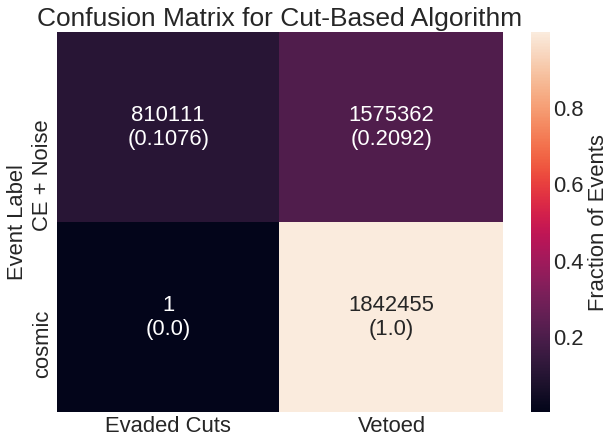

In [ ]:
cutsMatrix = np.array([[timeN/superTotal, (totN-timeN)/superTotal], [time/tot, (tot - time)/tot]])
plt.figure(figsize=(10,7));
 
annotStr = np.array([[str(round(timeN)) + '\n(' + str(round(timeN/superTotal,4)) + ')', 
                            str(round((totN-timeN))) + '\n(' + str(round((totN-timeN)/superTotal,4)) + ')'], 
                           [str(round(time)) + '\n(' + str(round(time/tot,4)) + ')', 
                            str(round(tot - time)) + '\n(' + str(round((tot - time)/tot,4)) + ')']])

ax = sns.heatmap(cutsMatrix, annot = annotStr, xticklabels=["Evaded Cuts", "Vetoed"], yticklabels=["CE + Noise", "cosmic"], fmt='.17s', cbar_kws={'label': 'Fraction of Events'});
 
ax.set(title="Confusion Matrix for Cut-Based Algorithm",
      xlabel="",
      ylabel="Event Label",);

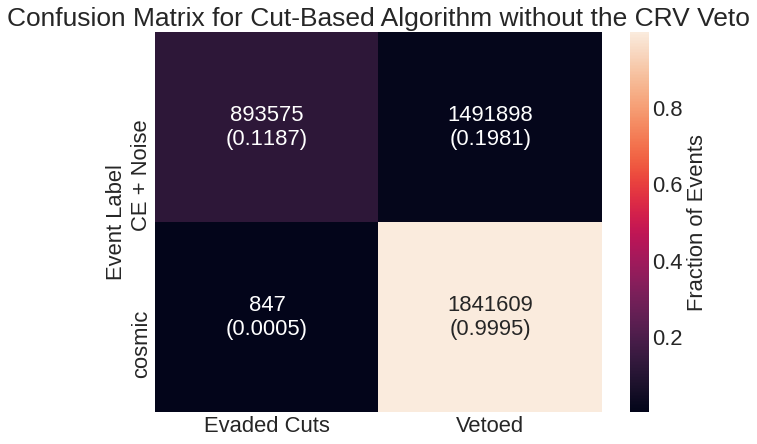

In [ ]:
cutsMatrix = np.array([[exN/superTotal, (exN-timeN)/superTotal], [ex/tot, (tot - ex)/tot]])
plt.figure(figsize=(10,7));
 
annotStr = np.array([[str(round(exN)) + '\n(' + str(round(exN/superTotal,4)) + ')', 
                            str(round((totN-exN))) + '\n(' + str(round((totN-exN)/superTotal,4)) + ')'], 
                           [str(round(ex)) + '\n(' + str(round(ex/tot,4)) + ')', 
                            str(round(tot - ex)) + '\n(' + str(round((tot - ex)/tot,4)) + ')']])

ax = sns.heatmap(cutsMatrix, annot = annotStr, xticklabels=["Evaded Cuts", "Vetoed"], yticklabels=["CE + Noise", "cosmic"], fmt='.17s', cbar_kws={'label': 'Fraction of Events'});
 
ax.set(title="Confusion Matrix for Cut-Based Algorithm without the CRV Veto",
      xlabel="",
      ylabel="Event Label",);

In [ ]:
lowLightnotVetoed = df.query('(is_high==-2) and (' + crv_time + " & " + cut_extmom+ ')')
lowLightnotVetoedSize = len(lowLightnotVetoed)
totLowLight = len(df.query(('is_high==-2')))
plt.figure(figsize=(10,7));

annotStr = [[str(lowLightnotVetoedSize) + '\n(' + str(round(lowLightnotVetoedSize/totLowLight,4)) + ')', str(totLowLight - lowLightnotVetoedSize) + '\n(' + str(round((totLowLight - lowLightnotVetoedSize)/totLowLight,4)) + ')']]

colorArray = [[lowLightnotVetoedSize/totLowLight, (totLowLight - lowLightnotVetoedSize)/totLowLight]]

ax = sns.heatmap(colorArray, annot = annotStr, xticklabels=["Evaded Cuts", "Vetoed"], yticklabels=["cosmic"], fmt='.17s', cbar_kws={'label': 'Fraction of Events'});
ax.set(title="Confusion Matrix for Cut-Based Algorithm on Low Light Yield Sample",
      xlabel="",
      ylabel="Event Label",);

In [ ]:
for i,j in zip(all_variables_list.keys(), all_variables_list.values()):
  plt.figure();

  reconstructedCE = df_time.query('is_high==-1')[i]
  rejectedCE = vetoedCE[i]  

  plt.hist([reconstructedCE, rejectedCE], bins=50, histtype='step', label=["reconstructions", "vetoes"], density=True, range=j);
  plt.title("CE/noise event distribution for " + i + " for cuts");
  plt.yscale('log');
  plt.legend(loc='best');

In [ ]:
with open(main_path+"Saved_Data/vetoedCE.pkl", "wb+") as f:
  pickle.dump([df_time, vetoedCE], f) #Dumps all the CE events

#Make plots

In [ ]:
import matplotlib as mpl

plt.plot(df.query('is_high == 1 & crvinfo__timeWindowStart>0')['crvinfomc__z'], df.query('is_high == 1 & crvinfo__timeWindowStart>0')['crvinfomc__x'], '.', markersize=0.1);
plt.title("Cosmics");
plt.xlabel("z");
plt.ylabel("x");
plt.figure()
plt.plot(df.query('is_high == 0 & crvinfo__timeWindowStart>0')['crvinfomc__z'], df.query('is_high == 0 & crvinfo__timeWindowStart>0')['crvinfomc__x'], '.', markersize=0.1);
plt.title("Low PE Cosmics");
plt.xlabel("z");
plt.ylabel("x");
plt.figure()
plt.plot(df.query('is_high == -1 & crvinfo__timeWindowStart>0')['crvinfomc__z'], df.query('is_high == -1 & crvinfo__timeWindowStart>0')['crvinfomc__x'], '.', markersize=1.0);
plt.title("CE & Noise");
plt.xlabel("z");
plt.ylabel("x");
plt.figure()
plt.hist2d(df.query('is_high == -1 & crvinfo__timeWindowStart>0')['crvinfomc__z'], df.query('is_high == -1 & crvinfo__timeWindowStart>0')['crvinfomc__x'], bins=(300, 100), norm=mpl.colors.LogNorm(), cmap = plt.cm.jet);
plt.xlabel("z");
plt.ylabel("x");


In [ ]:
np.warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)

In [ ]:
for i, j in zip(all_variables_list.keys(), all_variables_list.values()):

  cosmicData = df.query('(is_high == 0) or (is_high == 1) and (crvinfo__PEs >= -1)')[i]
  ceData = df.query('(is_high == -1) and (crvinfo__PEs >= -1)')[i]

  # cosmicHist = None
  # ceHist = None
  # if 'dT' in i:
  #   ceHist = [bins[0] if k <-500 else k for k in ceData]
  #   cosmicHist = [bins[0] if k <-500 else k for k in cosmicData]
  # else:
  #   ceHist = np.clip(ceData, bins[0], bins[-1])
  #   cosmicHist = np.clip(cosmicData, bins[0], bins[-1])

  plt.hist([ceData, cosmicData], range=j, histtype='step', bins=50, label=['ce + noise', 'cosmic'], density=True);
  if 'crv' in i:
    plt.title("CRV Data: " + translation[i])
  else:
    plt.title(translation[i])
  plt.yscale('log')
  plt.legend()
  plt.ylabel('Normalized Frequency')
  plt.figure();

In [ ]:
all_variables_list['deent_mom']

[50, 200]

In [ ]:
all_variables_list

{'crvinfo__PEs': [-1, 1000],
 'crvinfo__dT': [-500, 500],
 'crvinfo__x': [-8000, 1000],
 'crvinfo__y': [0, 3500],
 'crvinfo__z': [-5000, 20000],
 'de_nhits': [-2, 100],
 'deent_d0': [-500, 500],
 'deent_d0_om': [300, 1200],
 'deent_mom': [50, 200],
 'deent_om': [-0.01, 0.05],
 'deent_td': [0, 10],
 'deent_z0': [-500, 500],
 'dequal_TrkPID': [-1.1, 1.1],
 'dequal_TrkQual': [-0.1, 1.1],
 'ue_nhits': [-2, 100]}

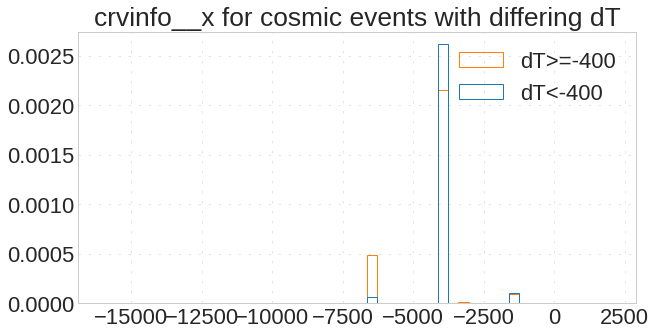

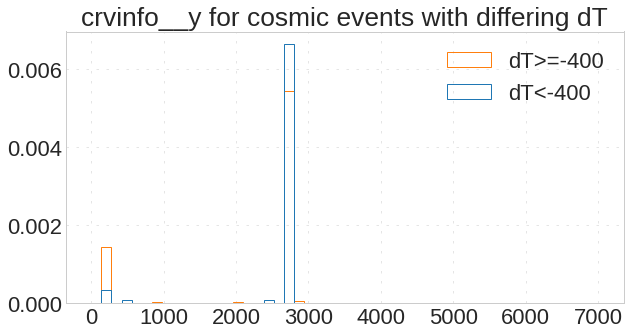

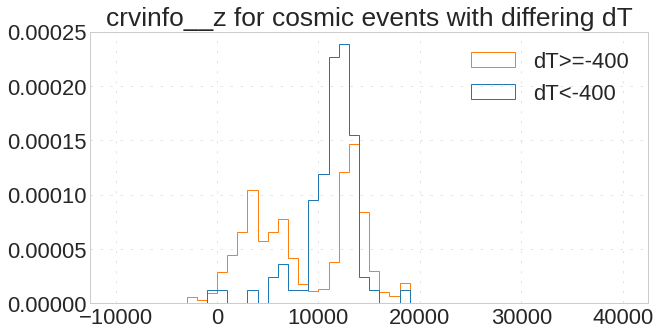

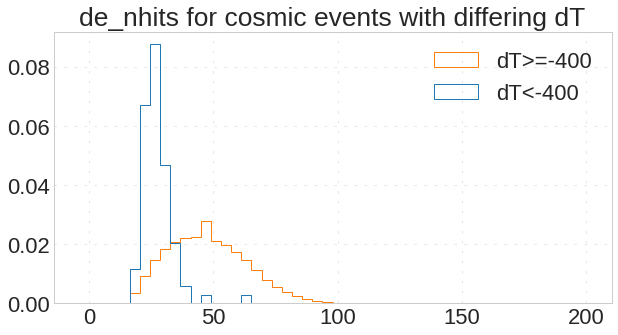

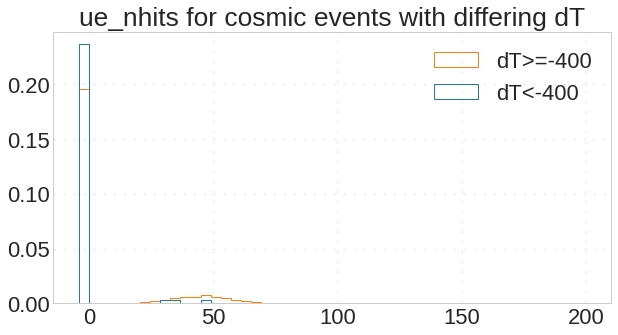

...

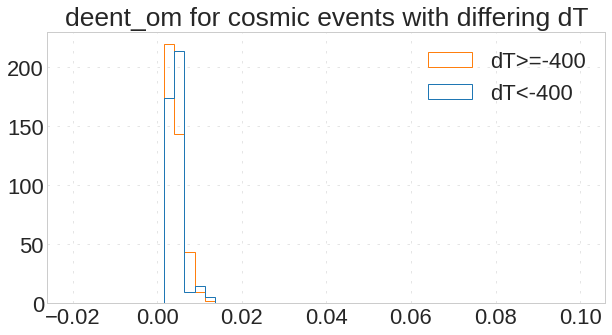

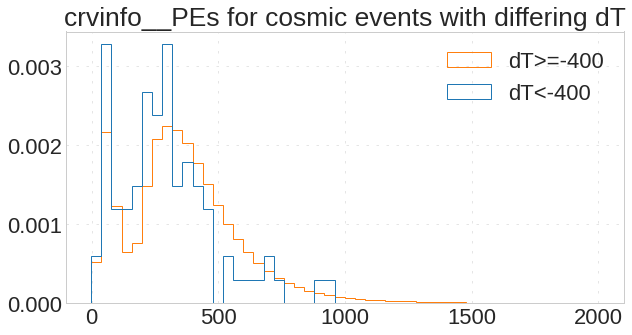

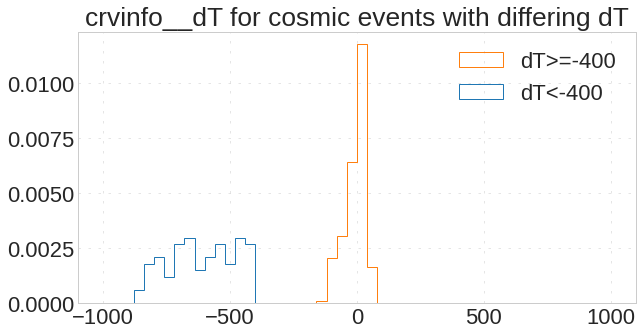

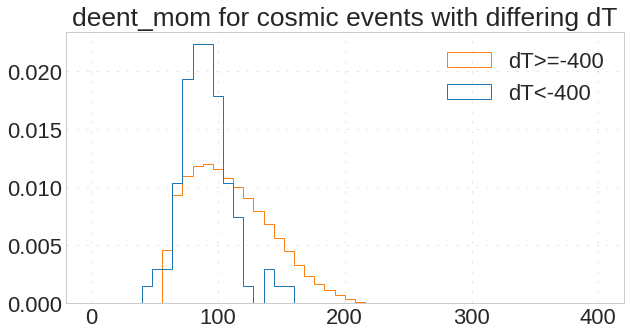

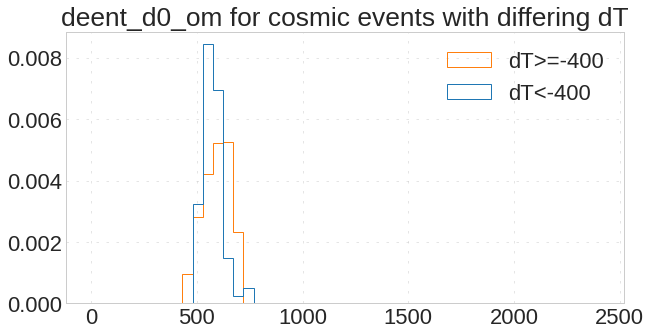

In [ ]:
strangeCosmics = df.query('(crvinfo__PEs >= -1) and (crvinfo__dT < -400) and ( (is_high==1) or (is_high==0) or (is_high==-2) )')
Cosmics = df.query('(crvinfo__PEs >= -1) and (crvinfo__dT >= -400) and ( (is_high==1) or (is_high==0) or (is_high==-2) )')
for var in all_variables_list.keys():
  plt.figure();
  plt.hist([strangeCosmics[var], Cosmics[var]], histtype='step', density=True, label=["dT<-400", "dT>=-400"], bins=50, range=np.array(all_variables_list[var] - 
                                                                                                                                      np.array([abs(all_variables_list[var][0]),0]) +
                                                                                                                                      np.array([0, abs(all_variables_list[var][1])])
                                                                                                                                      )
  );
  plt.title(var + " for cosmic events with differing dT");
  plt.legend(loc='best');
  plt.show();

#Fix and Create New Data (Don't run if loading data)

In [ ]:
lowLightYield = df.query('is_high==-2')

In [ ]:
lowLightYield['is_cosmic'] = lowLightYield['is_high'].apply(toCosmic)
lowLightYield.drop(columns='is_high', inplace=True)

In [ ]:
variables_columns = list(variables_list.keys())
variables_columns.append('is_high')

In [ ]:
MLDF = df.query('is_high != -2')

INFO:numexpr.utils:NumExpr defaulting to 2 threads.


In [ ]:
def toBinary(val):
  if val == 1 or val == 0:
    return 1
  else:
    return 0

def toCosmic(val):
  return 1

In [ ]:
def smear(arr):
  for i in arr:
    if i[1] == 1 or i[0] < -2500:
      continue
    x = -9999999
    while x < -2500 or x > 19000:
      x = np.random.normal(i[0], 500)
    i[0] = x
  return arr

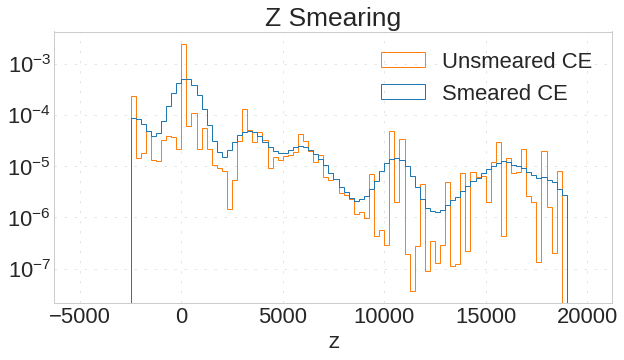

In [ ]:
MLDF['is_cosmic'] = MLDF['is_high'].apply(toBinary)
MLDF.drop(columns='is_high', inplace=True)
try:
  zz = smear(MLDF[['crvinfo__z','is_cosmic']].to_numpy()) #only use this cell if operating on crv variables
  oldZNoise = MLDF['crvinfo__z'][MLDF['is_cosmic']==0]
  MLDF['crvinfo__z'], MLDF['is_cosmic'] = zz[:,0], zz[:,1]
  plt.hist([MLDF['crvinfo__z'][MLDF['is_cosmic']==0],oldZNoise], bins=100, histtype='step', range=variables_list['crvinfo__z'], density=True, label=["Smeared CE", "Unsmeared CE"]);
  plt.yscale('log');
  plt.xlabel("z");
  plt.title("Z Smearing");
  plt.legend(loc='best');
except:
  pass

In [ ]:
onlyCRV = None
noCRV = None
try:
  onlyCRV = MLDF[(MLDF['crvinfo__PEs']>=-1)] #Data Filtration
  noCRV = MLDF[(MLDF['crvinfo__PEs']<=-2500)] #Data Filtration
  noCRV.drop(['crvinfo__z', 'crvinfo__PEs', 'crvinfo__dT'], axis=1, inplace=True)
except:
  pass

In [ ]:
del MLDF

In [ ]:
# CE_events = MLDF[MLDF['is_cosmic']==0].to_numpy()
# crvinfo = CE_events[:,[0,1,2]]
# trackinginfo = CE_events[:,3:]
# np.random.shuffle(crvinfo)
# np.random.shuffle(trackinginfo)
# newNoise = np.concatenate((crvinfo, trackinginfo), 1)
# newNoiseDF = pd.DataFrame(newNoise, columns=MLDF.columns)
# MLDF = MLDF.append(newNoiseDF, ignore_index=True)

#Create Training, Validation, and Testing Data (Don't run if loading data)

In [ ]:
# y = MLDF['is_cosmic']
# X = MLDF.drop(columns='is_cosmic')
# X_train_df, X_test_df, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# X_train_df, X_val_df, y_train, y_val = train_test_split(X_train_df, y_train, test_size=0.25, random_state=1)
# y_train = np.ravel(y_train)
# y_test = np.ravel(y_test)
# y_val = np.ravel(y_val)
# scaler = StandardScaler().fit(X)
# X_train = scaler.transform(X_train_df)
# X_test = scaler.transform(X_test_df)
# X_val = scaler.transform(X_val_df)

In [ ]:
# y_allnoCRV = y
# X_allnoCRV = MLDF.drop(['crvinfo__z', 'crvinfo__PEs', 'crvinfo__dT', 'is_cosmic'], axis=1)
# allnoCRV_X_train_df, allnoCRV_X_test_df, allnoCRV_y_train, allnoCRV_y_test = train_test_split(X_allnoCRV, y_allnoCRV, test_size=0.2, random_state=1)
# allnoCRV_X_train_df, allnoCRV_X_val_df, allnoCRV_y_train, allnoCRV_y_val = train_test_split(allnoCRV_X_train_df, allnoCRV_y_train, test_size=0.25, random_state=1)

# allnoCRV_y_train = np.ravel(allnoCRV_y_train)
# allnoCRV_y_test = np.ravel(allnoCRV_y_test)
# allnoCRV_y_val = np.ravel(allnoCRV_y_val)

# allnoCRVscaler = StandardScaler().fit(X_allnoCRV)

# allnoCRV_X_train = allnoCRVscaler.transform(allnoCRV_X_train_df)
# allnoCRV_X_test = allnoCRVscaler.transform(allnoCRV_X_test_df)
# allnoCRV_X_val = allnoCRVscaler.transform(allnoCRV_X_val_df)

In [ ]:
y_noCRV = noCRV['is_cosmic']
X_noCRV = noCRV.drop(columns='is_cosmic')
noCRV_X_train_df, no_CRV_X_test_df, noCRV_y_train, noCRV_y_test = train_test_split(X_noCRV, y_noCRV, test_size=0.2, random_state=1)
noCRV_X_train_df, noCRV_X_val_df, noCRV_y_train, noCRV_y_val = train_test_split(noCRV_X_train_df, noCRV_y_train, test_size=0.25, random_state=1)

noCRV_y_train = np.ravel(noCRV_y_train)
no_CRV_y_test = np.ravel(noCRV_y_test)
noCRV_y_val = np.ravel(noCRV_y_val)

noCRVscaler = StandardScaler().fit(X_noCRV[list(noCRV_noMom_variables_list.keys())])
noCRV_X_train = noCRVscaler.transform(noCRV_X_train_df[list(noCRV_noMom_variables_list.keys())])
no_CRV_X_test = noCRVscaler.transform(no_CRV_X_test_df[list(noCRV_noMom_variables_list.keys())])
noCRV_X_val = noCRVscaler.transform(noCRV_X_val_df[list(noCRV_noMom_variables_list.keys())])

noCRV_X_testMOM = noCRVscaler.transform(no_CRV_X_test_df.query(cut_extmom_orig)[list(noCRV_noMom_variables_list.keys())])

noCRV_X_testCUT = noCRVscaler.transform(no_CRV_X_test_df.query(cut_extmom)[list(noCRV_noMom_variables_list.keys())])


with open(main_path+"Saved_Data/noCoincidence.pkl", "wb+") as f:
  pickle.dump([noCRV_y_train, no_CRV_y_test, noCRV_y_val, noCRVscaler, noCRV_X_train, no_CRV_X_test, noCRV_X_val, noCRV_X_train_df, no_CRV_X_test_df, noCRV_X_val_df, noCRV_X_testMOM, noCRV_X_testCUT], f)

In [ ]:
del noCRV

In [ ]:
y_CRV = onlyCRV['is_cosmic']
X_CRV = onlyCRV.drop(columns='is_cosmic')
CRV_X_train_df, CRV_X_test_df, CRV_y_train, CRV_y_test = train_test_split(X_CRV, y_CRV, test_size=0.2, random_state=1)
CRV_X_train_df, CRV_X_val_df, CRV_y_train, CRV_y_val = train_test_split(CRV_X_train_df, CRV_y_train, test_size=0.25, random_state=1)

CRV_y_train = np.ravel(CRV_y_train)
CRV_y_test = np.ravel(CRV_y_test)
CRV_y_val = np.ravel(CRV_y_val)

CRVscaler = StandardScaler().fit(X_CRV[list(dTZPE_noMom_variables_list.keys())])
CRV_X_train = CRVscaler.transform(CRV_X_train_df[list(dTZPE_noMom_variables_list.keys())])
CRV_X_test = CRVscaler.transform(CRV_X_test_df[list(dTZPE_noMom_variables_list.keys())])
CRV_X_val = CRVscaler.transform(CRV_X_val_df[list(dTZPE_noMom_variables_list.keys())])

CRV_X_testMOM = CRVscaler.transform(CRV_X_test_df.query(cut_extmom_orig)[list(dTZPE_noMom_variables_list.keys())])

CRV_X_testCUT = CRVscaler.transform(CRV_X_test_df.query(cut_extmom)[list(dTZPE_noMom_variables_list.keys())])


with open(main_path+"Saved_Data/Coincidence.pkl", "wb+") as f:
  pickle.dump([CRV_y_train, CRV_y_test, CRV_y_val, CRVscaler, CRV_X_train, CRV_X_test, CRV_X_val, CRV_X_train_df, CRV_X_test_df, CRV_X_val_df, CRV_X_testMOM, CRV_X_testCUT], f)

In [ ]:
del onlyCRV

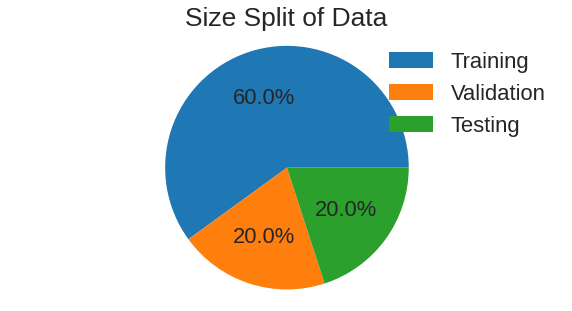

In [ ]:
labels = "Training","Validation","Testing"
sizes = len(noCRV_X_train_df)/len(X_noCRV), len(noCRV_X_val_df)/len(X_noCRV), len(no_CRV_X_test_df)/len(X_noCRV)
plt.pie(sizes, labels=labels, autopct='%1.1f%%', labeldistance=None);
plt.legend();
plt.gca().axis('equal');
plt.title("Size Split of Data");

#Make correlation plots

In [ ]:
def customPairplot(dataframe):
  for nrow, var in enumerate(all_variables_list):
    fig, ax = plt.subplots(1, len(all_variables_list.keys()), figsize=(10*(len(all_variables_list.keys())), 7))
    for ncol, comparison in enumerate(all_variables_list):
      if 'cosmic' in comparison:
        continue
      if comparison == var:
        continue
      else:
        correlation = ax[ncol].hist2d(dataframe[var], dataframe[comparison], label="cosmic", range=(all_variables_list[var], all_variables_list[comparison]), bins=(50,50), norm=matplotlib.colors.LogNorm(), cmap=plt.cm.YlOrBr);
        # cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.7]);
        # fig.colorbar(correlation, cax=cbar_ax);
        ax[ncol].set_xlabel(comparison);
        ax[ncol].set_ylabel(var);
        ax[ncol].set_title(var + " VS " + comparison)
    plt.show();
      # ax[len(dataframe.columns) - 2][ncol].set_xlim(all_variables_list[comparison])
    # ax[nrow][0].set_ylim(all_variables_list[var])
      

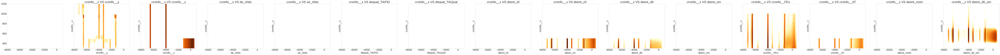

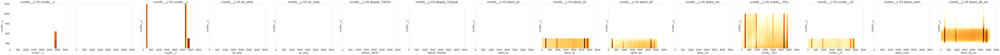

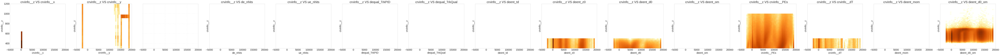

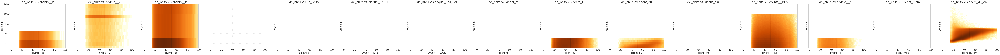

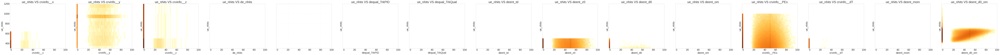

...

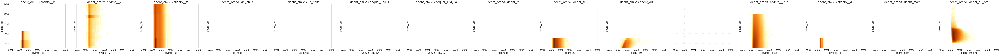

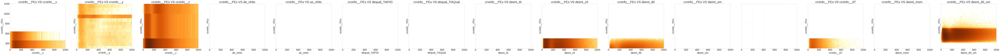

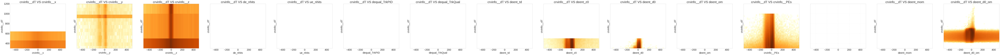

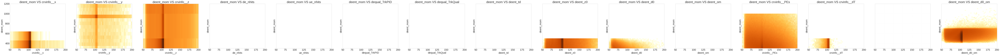

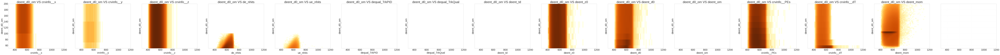

In [ ]:
customPairplot(df)

In [ ]:
corr = MLDF.corr();
sns.heatmap(abs(corr), xticklabels=list(map(translation.get, corr.columns.values)), yticklabels=list(map(translation.get, corr.columns.values)), cbar_kws={'label': 'Variable Correlation'});
plt.figure();
sns.heatmap(abs(corr[['is_cosmic']]), yticklabels=list(map(translation.get, corr.columns.values)), fmt='.2g', cmap='viridis', annot=True, cbar_kws={'label': 'Variable Correlation'});

In [ ]:
corr = noCRV.corr();
sns.heatmap(abs(corr), xticklabels=list(map(translation.get, corr.columns.values)), yticklabels=list(map(translation.get, corr.columns.values)), cbar_kws={'label': 'Variable Correlation'});
plt.figure();
# sns.heatmap(abs(corr[['is_cosmic']]), yticklabels=list(map(translation.get, corr.columns.values)), fmt='.2g', cmap='viridis', annot=True, cbar_kws={'label': 'Variable Correlation'});
sns.pairplot(noCRV, kind='hist')

In [ ]:
customPairplot(noCRV)

In [ ]:
corr = onlyCRV.corr();
sns.heatmap(abs(corr), xticklabels=list(map(translation.get, corr.columns.values)), yticklabels=list(map(translation.get, corr.columns.values)), cbar_kws={'label': 'Variable Correlation'});
plt.figure();
sns.heatmap(abs(corr[['is_cosmic']]), yticklabels=list(map(translation.get, corr.columns.values[:-1])), fmt='.2g', cmap='viridis', annot=True, cbar_kws={'label': 'Variable Correlation'});

#Model For Entire Dataset (OUTDATED)

In [ ]:
# stopgap, histoStopgap, allpredsStopgap, predsStopgap = everythingBagel.model, everythingBagel.history, everythingBagel.predictions, everythingBagel.avg_predictions #Used to save the model when you screw up

In [ ]:
everythingBagel = MLAnalyzer(variables_list, X_train, y_train, X_val, y_val, X_test, y_test, scaler=scaler)

In [ ]:
# everythingBagel.model, everythingBagel.history, everythingBagel.predictions, everythingBagel.avg_predictions = stopgap, histoStopgap, allpredsStopgap, predsStopgap

In [ ]:
everythingBagel.trainModel(4,6,10)

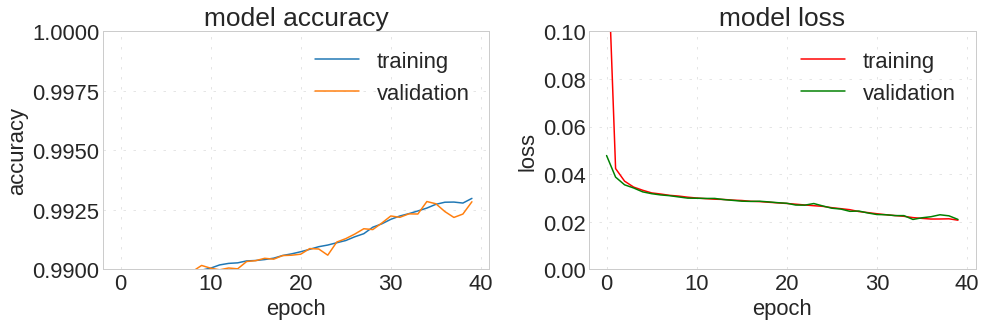

In [ ]:
everythingBagel.plotAcc()

In [ ]:
everythingBagel.predictMC(30)

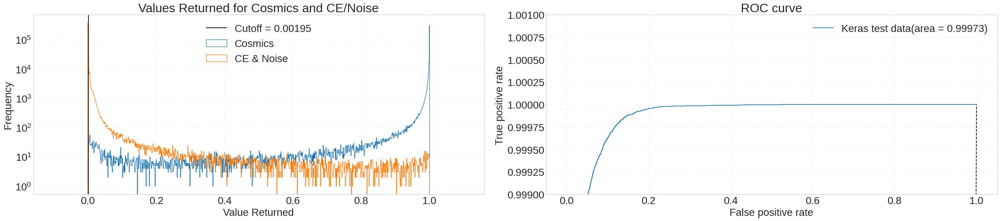

In [ ]:
everythingBagel.cutoffTime()

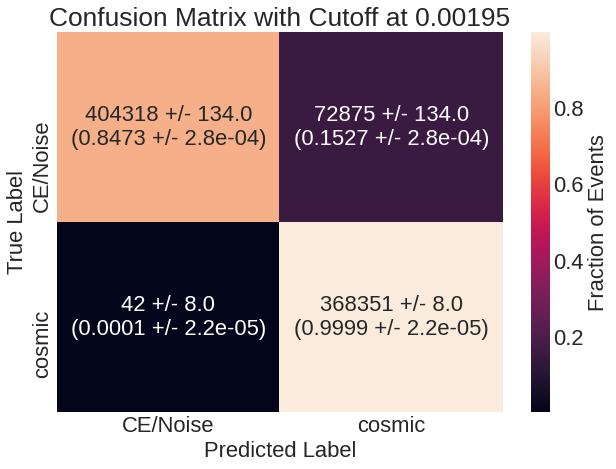

In [ ]:
everythingBagel.finalConfusion()

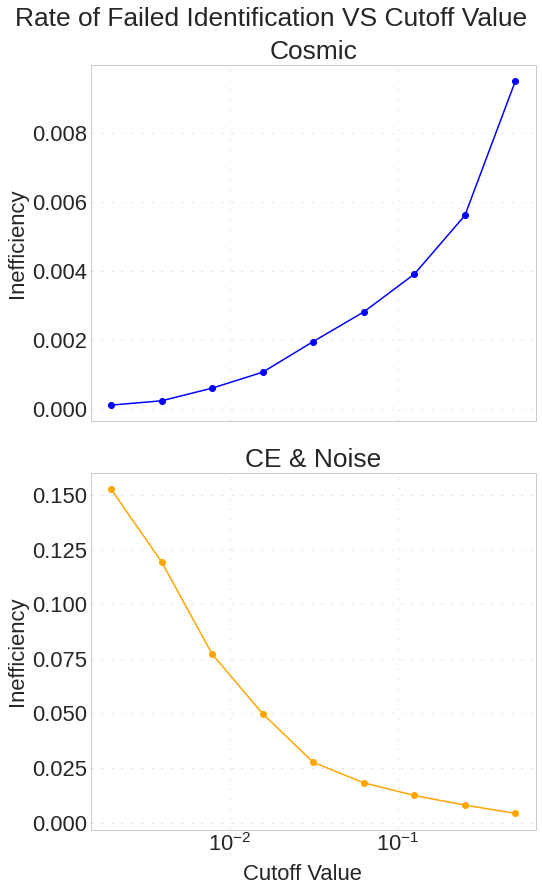

In [ ]:
everythingBagel.cutoffPlot()

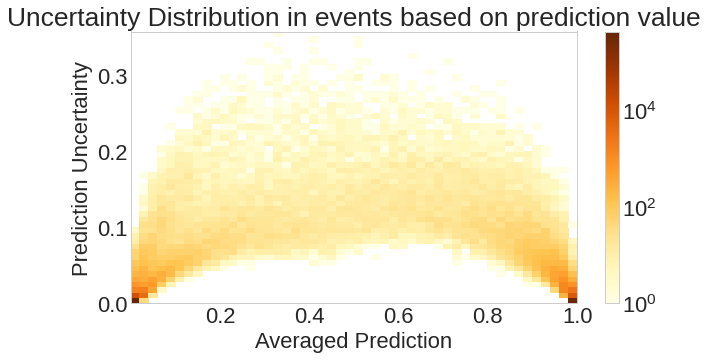

In [ ]:
everythingBagel.errorPlot()

#Model for entire Dataset w/o CRV Variables (OUTDATED)

In [ ]:
stopgap, histoStopgap, allpredsStopgap, predsStopgap = halfBagel.model, halfBagel.history, halfBagel.predictions, halfBagel.avg_predictions #Used to save the model when you screw up

In [ ]:
halfBagel = MLAnalyzer(noCRV_noMom_variables_list, allnoCRV_X_train, allnoCRV_y_train, allnoCRV_X_val, allnoCRV_y_val, allnoCRV_X_test, allnoCRV_y_test, scaler=allnoCRVscaler)

In [ ]:
halfBagel.model, halfBagel.history, halfBagel.predictions, halfBagel.avg_predictions = stopgap, histoStopgap, allpredsStopgap, predsStopgap

In [ ]:
halfBagel.trainModel(4,6,10)

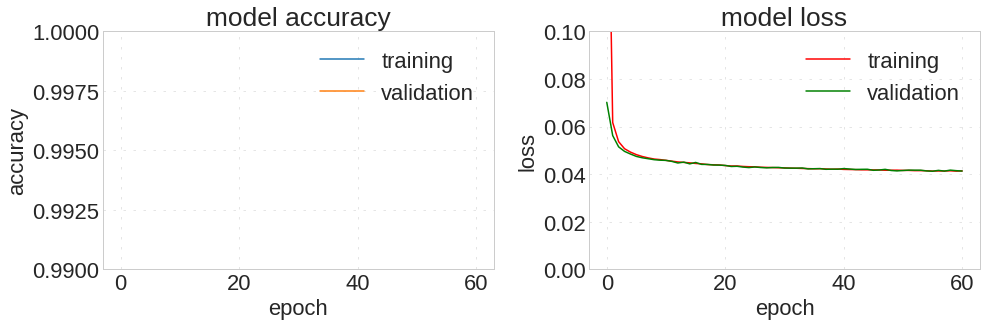

In [ ]:
halfBagel.plotAcc()

In [ ]:
halfBagel.predictMC(30)

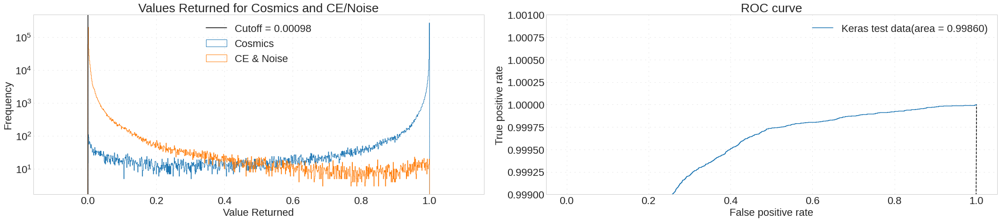

In [ ]:
halfBagel.cutoffTime()

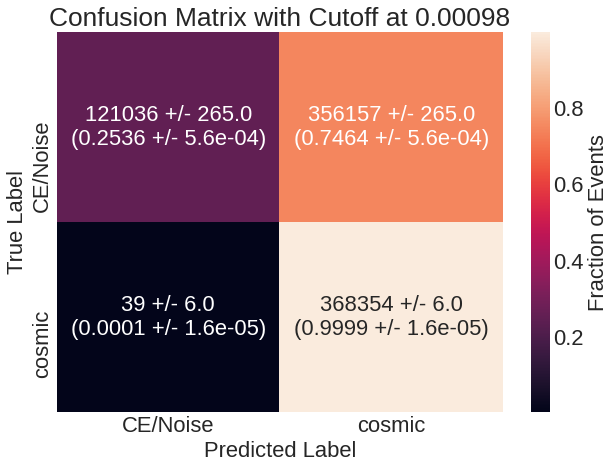

In [ ]:
halfBagel.finalConfusion()

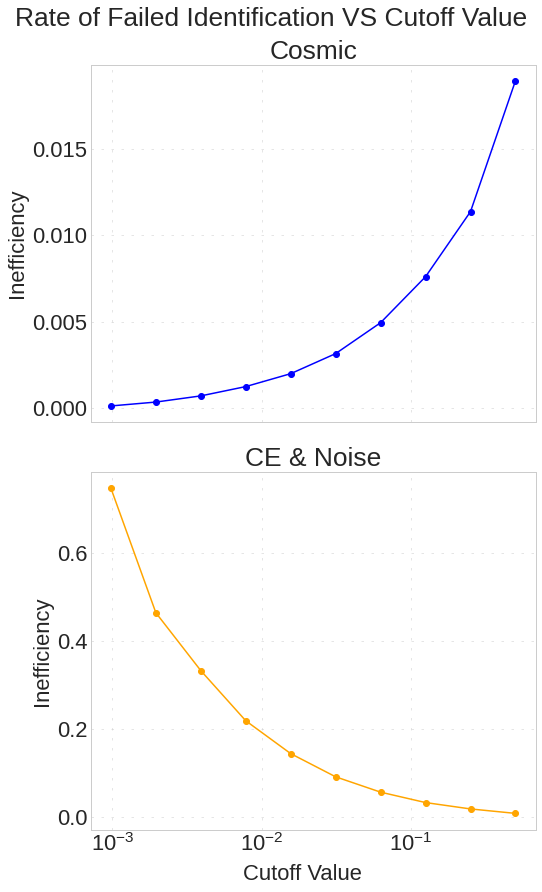

In [ ]:
halfBagel.cutoffPlot()

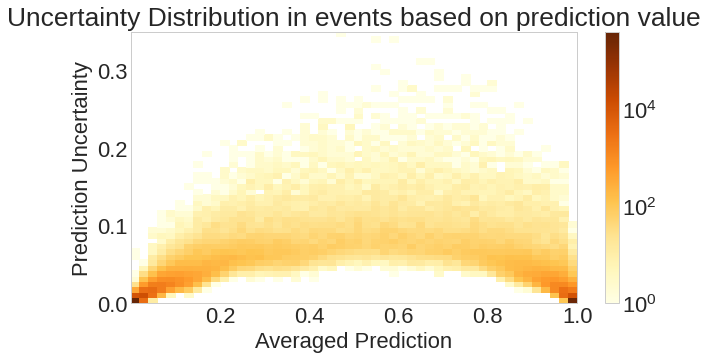

In [ ]:
halfBagel.errorPlot()

#Model for Coincidence Data Only

In [ ]:
# stopgap, histoStopgap, allpredsStopgap, predsStopgap = cinnamonBagel.model, cinnamonBagel.history, cinnamonBagel.predictions, cinnamonBagel.avg_predictions #Used to save the model when you screw up

In [ ]:
cinnamonBagel = MLAnalyzer(dTZPE_noMom_variables_list, CRV_X_train, CRV_y_train, CRV_X_val, CRV_y_val, CRV_X_test, CRV_y_test, scaler=CRVscaler)

In [ ]:
# cinnamonBagel.model, cinnamonBagel.history, cinnamonBagel.predictions, cinnamonBagel.avg_predictions = stopgap, histoStopgap, allpredsStopgap, predsStopgap

In [ ]:
cinnamonBagel.trainModel(4,6,10, epoch=800)

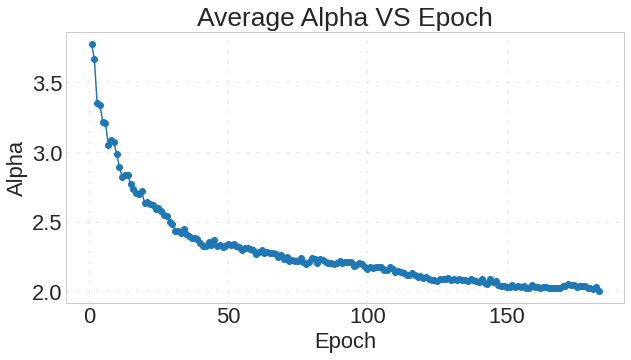

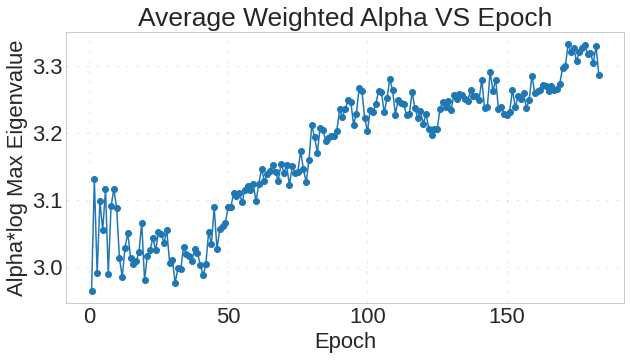

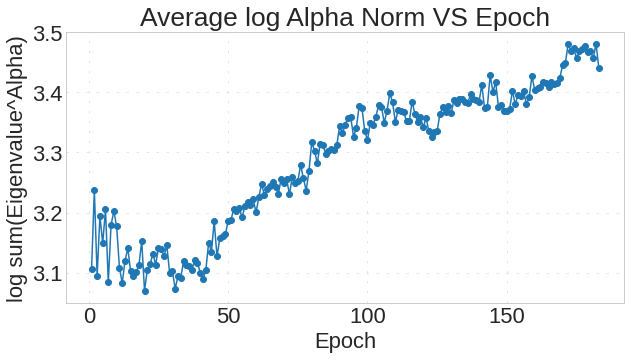

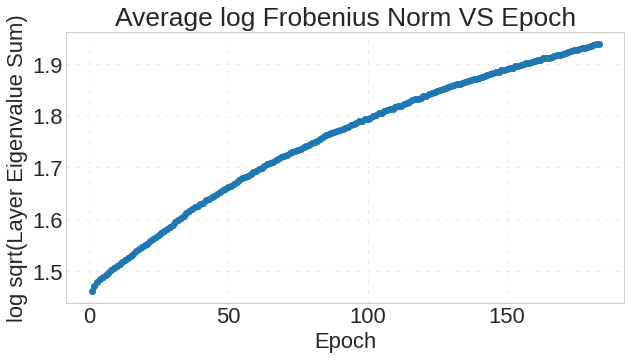

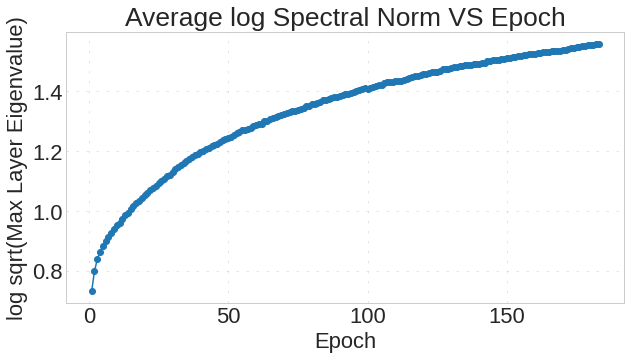

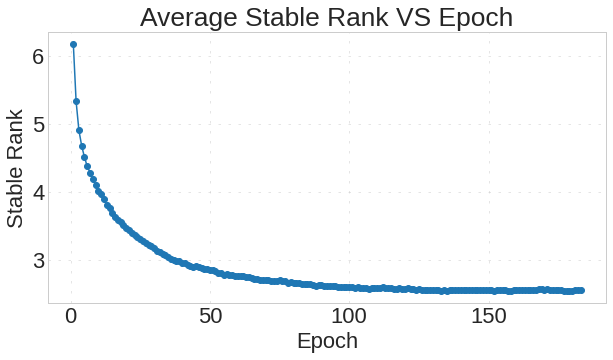

In [ ]:
cinnamonBagel.plotWeights()

In [ ]:
cinnamonDetails, _ = cinnamonBagel.weightAnalysis()

INFO:weightwatcher:

python      version 3.7.11 (default, Jul  3 2021, 18:01:19) 
[GCC 7.5.0]
numpy       version 1.19.5
tensforflow version 2.6.0
keras       version 2.6.0
INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


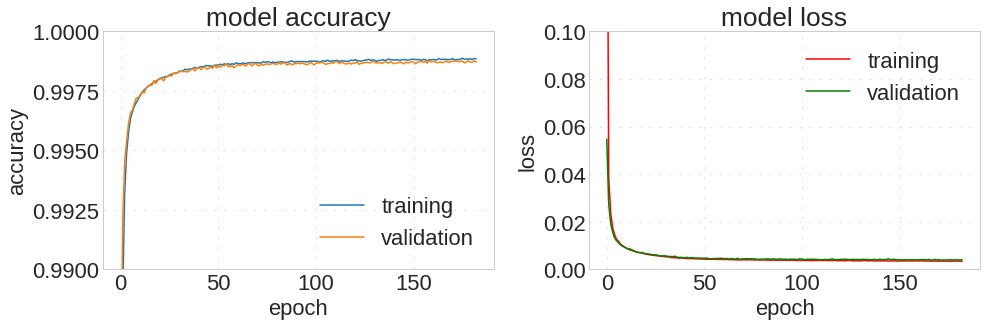

In [ ]:
cinnamonBagel.plotAcc()

In [ ]:
cinnamonBagel.save("cinnamonBagel")

In [ ]:
cinnamonBagel.load("cinnamonBagel")

In [ ]:
cinnamonBagel.predictMC(1)

15831/15831 [==============================] - 16s 1ms/step
iteration 1 done


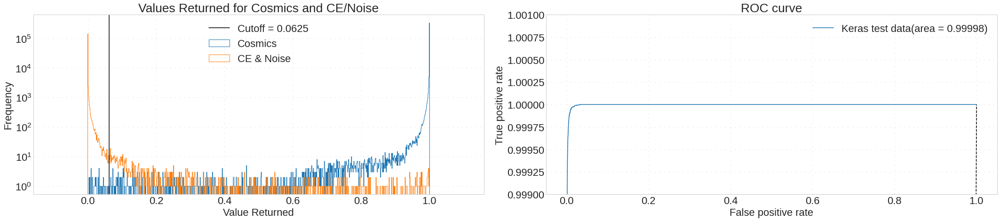

In [ ]:
cinnamonBagel.cutoffTime()

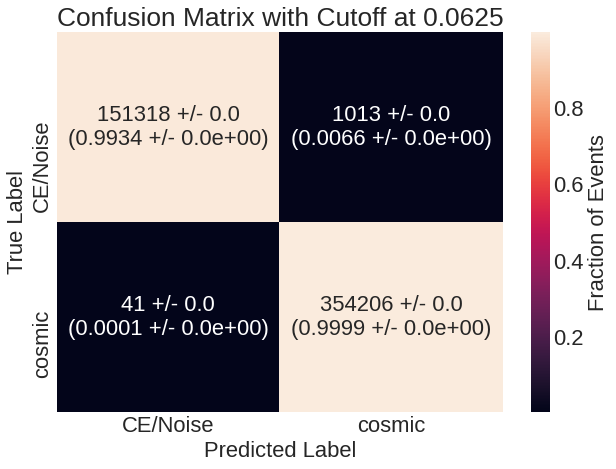

In [ ]:
cinnamonBagel.finalConfusion()

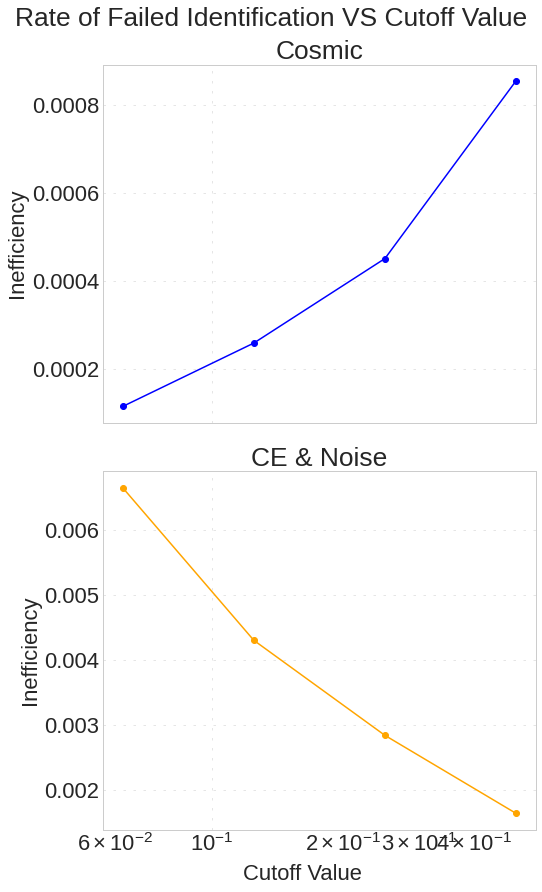

In [ ]:
cinnamonBagel.cutoffPlot()

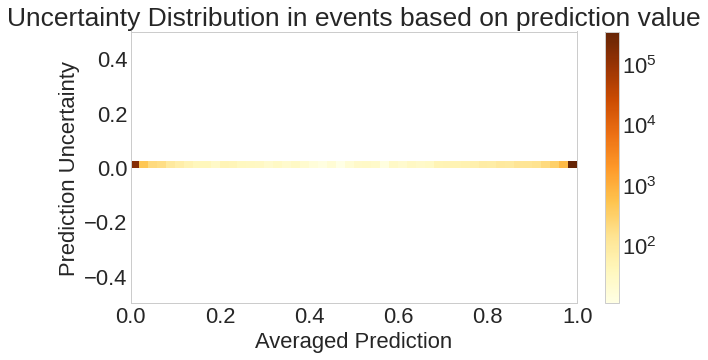

In [ ]:
cinnamonBagel.errorPlot()

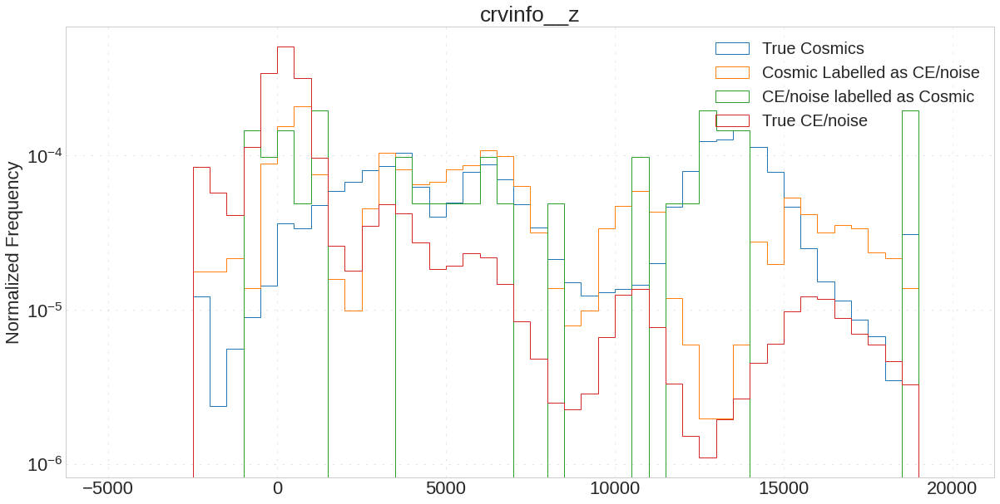

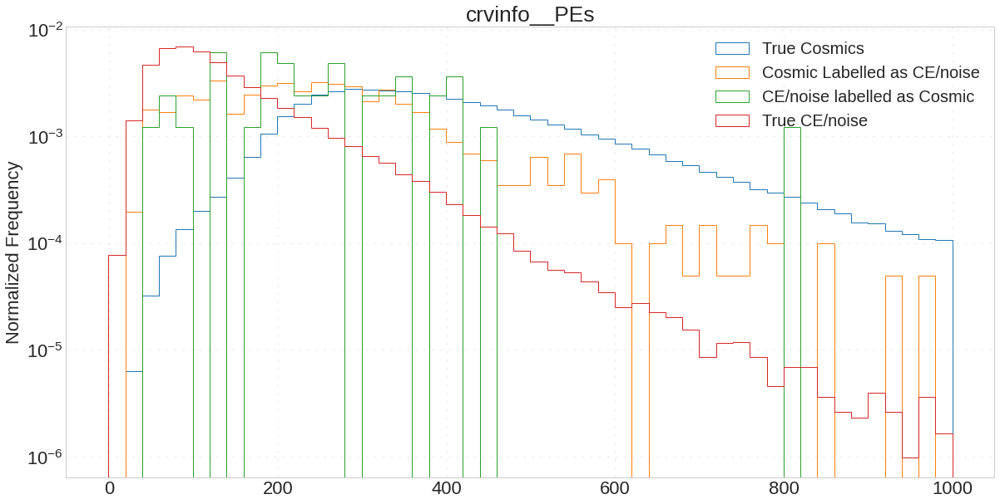

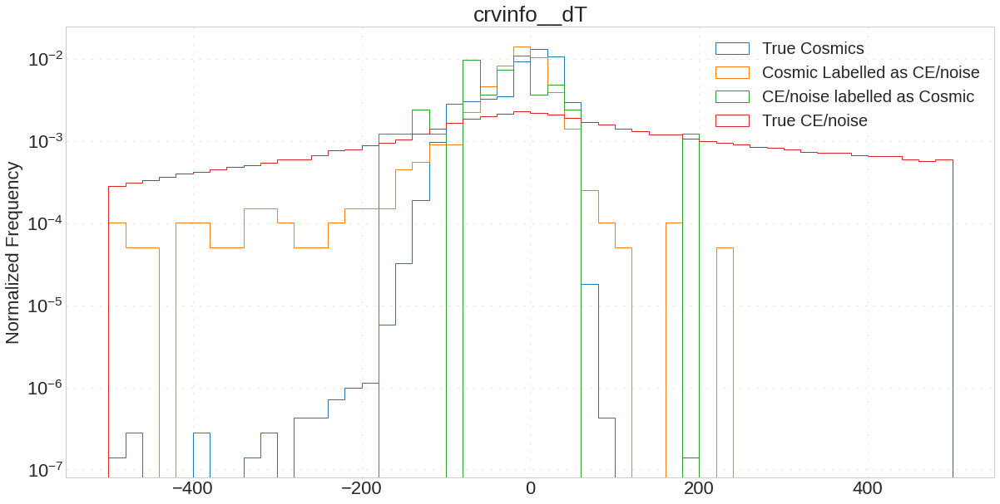

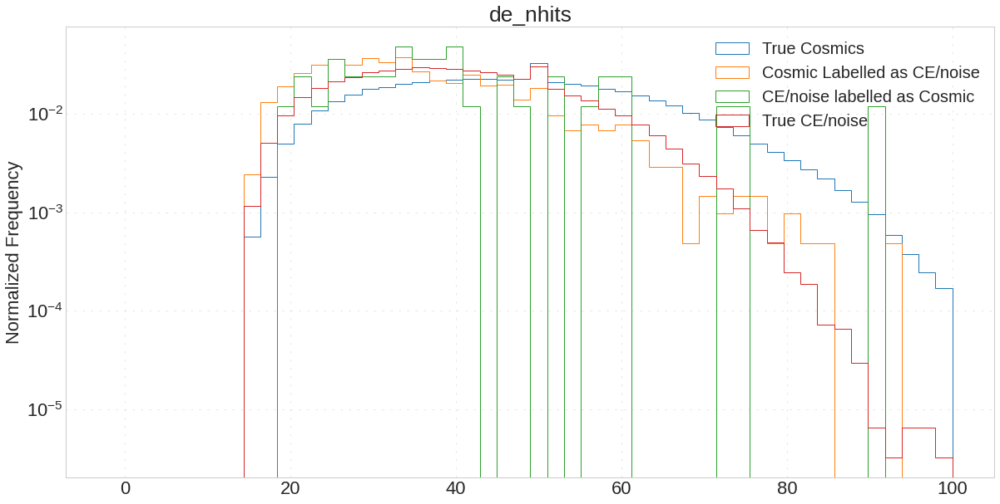

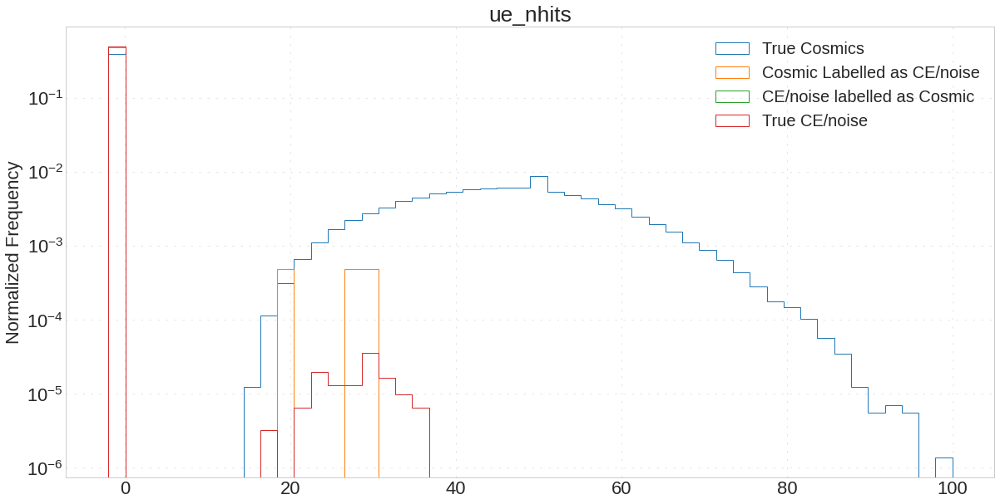

...

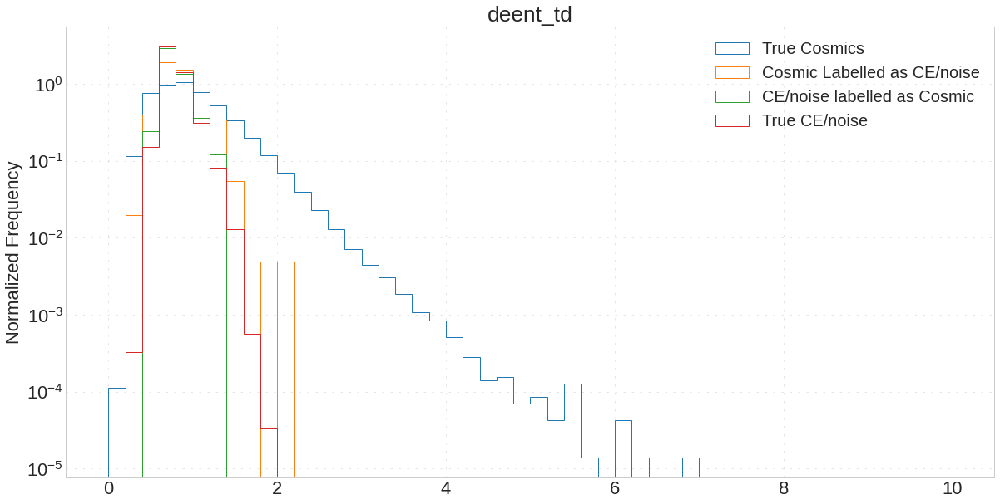

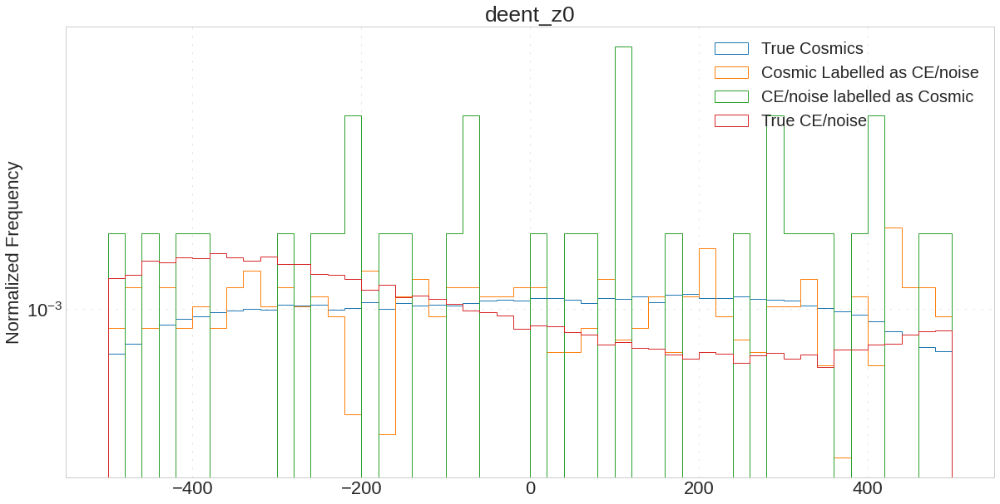

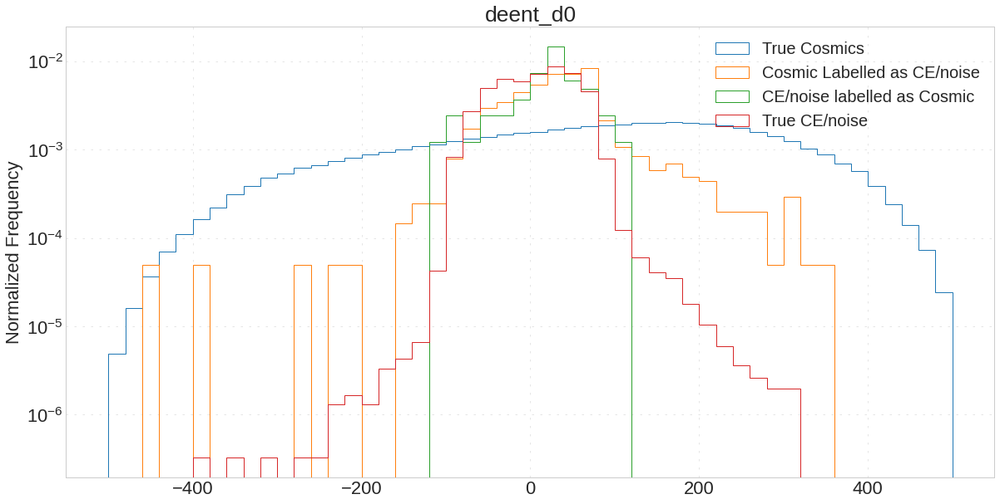

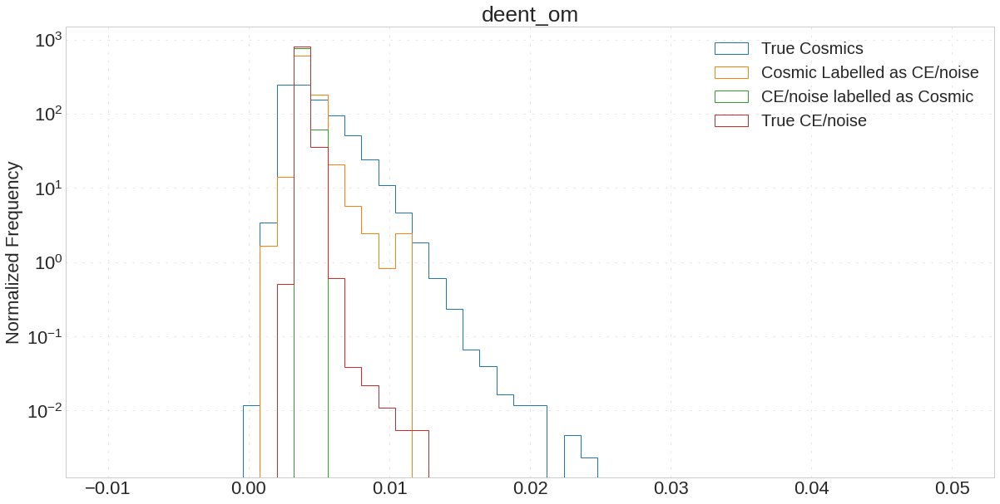

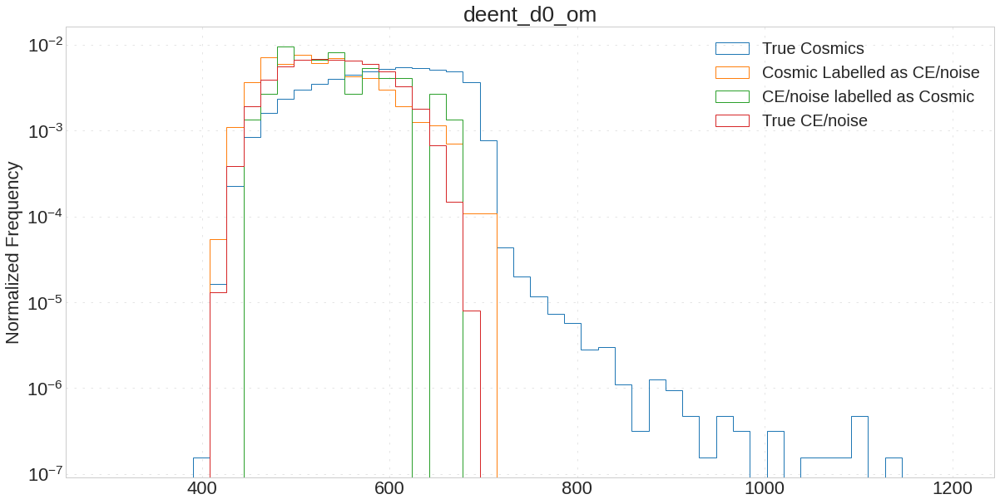

In [ ]:
cinnamonBagel.quadrantDistribution(50)

In [ ]:
with open(main_path+"Saved_Data/coincidenceData.pkl", "wb+") as f:
  pickle.dump([cinnamonBagel.avg_predictions, cinnamonBagel.rounded_predictions, cinnamonBagel.conf_matrix, cinnamonBagel.matrix_errors, cinnamonBagel.predictions], f)

In [ ]:
cinnamonBagelMOM = MLAnalyzer()
cinnamonBagel.load("cinnamonBagel")
cinnamonBagel.xTest

#Model for Coincidence Data Only - Architecture Test

In [ ]:
# stopgap, histoStopgap, allpredsStopgap, predsStopgap = cinnamonBagel.model, cinnamonBagel.history, cinnamonBagel.predictions, cinnamonBagel.avg_predictions #Used to save the model when you screw up

In [ ]:
cinnamonBagel2 = MLAnalyzer(variables_list, CRV_X_train, CRV_y_train, CRV_X_val, CRV_y_val, CRV_X_test, CRV_y_test, scaler=CRVscaler)

In [ ]:
# cinnamonBagel.model, cinnamonBagel.history, cinnamonBagel.predictions, cinnamonBagel.avg_predictions = stopgap, histoStopgap, allpredsStopgap, predsStopgap

In [ ]:
cinnamonBagel2.trainModel(widthMultiplier=8/3,depth=10,batch=10,epoch=500)

INFO:weightwatcher:

python      version 3.7.11 (default, Jul  3 2021, 18:01:19) 
[GCC 7.5.0]
numpy       version 1.19.5
tensforflow version 2.5.0
keras       version 2.5.0


fitting model with width= 32 	depth= 12 	size= 10000
397 total neurons


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 1/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 4.094922244940435
152/152 [==============================] - 34s 106ms/step - loss: 0.4853 - accuracy: 0.7403 - val_loss: 0.2379 - val_accuracy: 0.9721


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 2/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.3039544419888984
152/152 [==============================] - 15s 96ms/step - loss: 0.2239 - accuracy: 0.9788 - val_loss: 0.1930 - val_accuracy: 0.9886


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 3/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.599714002144261
152/152 [==============================] - 16s 97ms/step - loss: 0.1867 - accuracy: 0.9899 - val_loss: 0.1693 - val_accuracy: 0.9924


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 4/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.6917772417231602
152/152 [==============================] - 15s 97ms/step - loss: 0.1641 - accuracy: 0.9928 - val_loss: 0.1505 - val_accuracy: 0.9938


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 5/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.4191457793042477
152/152 [==============================] - 15s 96ms/step - loss: 0.1462 - accuracy: 0.9941 - val_loss: 0.1349 - val_accuracy: 0.9948


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 6/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.2424512394059306
152/152 [==============================] - 18s 112ms/step - loss: 0.1315 - accuracy: 0.9949 - val_loss: 0.1216 - val_accuracy: 0.9955


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 7/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.5223744380712225
152/152 [==============================] - 16s 97ms/step - loss: 0.1180 - accuracy: 0.9955 - val_loss: 0.1100 - val_accuracy: 0.9960


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 8/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.286152336677196
152/152 [==============================] - 16s 97ms/step - loss: 0.1074 - accuracy: 0.9960 - val_loss: 0.0995 - val_accuracy: 0.9965


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 9/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.3137730441224615
152/152 [==============================] - 15s 96ms/step - loss: 0.0968 - accuracy: 0.9965 - val_loss: 0.0904 - val_accuracy: 0.9967


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 10/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.310673351904338
152/152 [==============================] - 16s 97ms/step - loss: 0.0879 - accuracy: 0.9968 - val_loss: 0.0821 - val_accuracy: 0.9972


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 11/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.345007552768554
152/152 [==============================] - 15s 97ms/step - loss: 0.0800 - accuracy: 0.9971 - val_loss: 0.0750 - val_accuracy: 0.9973


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 12/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.300472209280322
152/152 [==============================] - 15s 97ms/step - loss: 0.0730 - accuracy: 0.9973 - val_loss: 0.0689 - val_accuracy: 0.9973


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 13/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.288695237611158
152/152 [==============================] - 15s 96ms/step - loss: 0.0670 - accuracy: 0.9975 - val_loss: 0.0634 - val_accuracy: 0.9975


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 14/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.275156541397429
152/152 [==============================] - 15s 96ms/step - loss: 0.0619 - accuracy: 0.9975 - val_loss: 0.0584 - val_accuracy: 0.9976


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 15/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.287430029381427
152/152 [==============================] - 15s 96ms/step - loss: 0.0566 - accuracy: 0.9977 - val_loss: 0.0537 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 16/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.258195063906655
152/152 [==============================] - 15s 96ms/step - loss: 0.0523 - accuracy: 0.9978 - val_loss: 0.0498 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 17/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.296892814479951
152/152 [==============================] - 15s 96ms/step - loss: 0.0487 - accuracy: 0.9978 - val_loss: 0.0461 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 18/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.201367236404128
152/152 [==============================] - 15s 96ms/step - loss: 0.0450 - accuracy: 0.9979 - val_loss: 0.0431 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 19/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.1779190370722836
152/152 [==============================] - 16s 97ms/step - loss: 0.0419 - accuracy: 0.9980 - val_loss: 0.0400 - val_accuracy: 0.9981


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 20/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.138461715494126
152/152 [==============================] - 15s 97ms/step - loss: 0.0390 - accuracy: 0.9981 - val_loss: 0.0373 - val_accuracy: 0.9980


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 21/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.1583938996817493
152/152 [==============================] - 16s 97ms/step - loss: 0.0361 - accuracy: 0.9981 - val_loss: 0.0348 - val_accuracy: 0.9981


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 22/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.058807192725453
152/152 [==============================] - 16s 98ms/step - loss: 0.0339 - accuracy: 0.9981 - val_loss: 0.0327 - val_accuracy: 0.9981


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 23/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.0406816489703736
152/152 [==============================] - 16s 97ms/step - loss: 0.0318 - accuracy: 0.9982 - val_loss: 0.0308 - val_accuracy: 0.9981


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 24/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.0648960927615616
152/152 [==============================] - 16s 97ms/step - loss: 0.0297 - accuracy: 0.9981 - val_loss: 0.0288 - val_accuracy: 0.9981


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 25/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.0054568886755653
152/152 [==============================] - 16s 97ms/step - loss: 0.0279 - accuracy: 0.9982 - val_loss: 0.0273 - val_accuracy: 0.9981


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 26/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.043425793932881
152/152 [==============================] - 16s 97ms/step - loss: 0.0263 - accuracy: 0.9983 - val_loss: 0.0256 - val_accuracy: 0.9982


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 27/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.977127725561194
152/152 [==============================] - 16s 97ms/step - loss: 0.0247 - accuracy: 0.9982 - val_loss: 0.0240 - val_accuracy: 0.9982


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 28/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.9563299421995715
152/152 [==============================] - 16s 97ms/step - loss: 0.0233 - accuracy: 0.9983 - val_loss: 0.0232 - val_accuracy: 0.9981


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 29/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.9585543751575822
152/152 [==============================] - 15s 96ms/step - loss: 0.0221 - accuracy: 0.9983 - val_loss: 0.0215 - val_accuracy: 0.9982


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 30/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.982887859724191
152/152 [==============================] - 16s 97ms/step - loss: 0.0209 - accuracy: 0.9983 - val_loss: 0.0205 - val_accuracy: 0.9982


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 31/500


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.956328379923724
152/152 [==============================] - 16s 98ms/step - loss: 0.0197 - accuracy: 0.9983 - val_loss: 0.0195 - val_accuracy: 0.9982


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 32/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.906300553169084
152/152 [==============================] - 16s 98ms/step - loss: 0.0188 - accuracy: 0.9983 - val_loss: 0.0184 - val_accuracy: 0.9983


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 33/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.9068239388275128
152/152 [==============================] - 16s 97ms/step - loss: 0.0179 - accuracy: 0.9983 - val_loss: 0.0176 - val_accuracy: 0.9982


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 34/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.0034210367280743
152/152 [==============================] - 16s 98ms/step - loss: 0.0170 - accuracy: 0.9983 - val_loss: 0.0170 - val_accuracy: 0.9983


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 35/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.9512545067829272
152/152 [==============================] - 16s 97ms/step - loss: 0.0160 - accuracy: 0.9984 - val_loss: 0.0159 - val_accuracy: 0.9983


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 36/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.9054509782496143
152/152 [==============================] - 16s 98ms/step - loss: 0.0156 - accuracy: 0.9983 - val_loss: 0.0154 - val_accuracy: 0.9983


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 37/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.9122561319835505
152/152 [==============================] - 16s 98ms/step - loss: 0.0147 - accuracy: 0.9983 - val_loss: 0.0147 - val_accuracy: 0.9983


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 38/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.873972843842676
152/152 [==============================] - 16s 98ms/step - loss: 0.0141 - accuracy: 0.9984 - val_loss: 0.0140 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 39/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.8705057504920006
152/152 [==============================] - 16s 97ms/step - loss: 0.0132 - accuracy: 0.9985 - val_loss: 0.0133 - val_accuracy: 0.9983


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 40/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.9010311812301364
152/152 [==============================] - 15s 97ms/step - loss: 0.0128 - accuracy: 0.9984 - val_loss: 0.0131 - val_accuracy: 0.9983


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 41/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.8866817998202534
152/152 [==============================] - 15s 97ms/step - loss: 0.0123 - accuracy: 0.9984 - val_loss: 0.0125 - val_accuracy: 0.9983


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 42/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.714324250471954
152/152 [==============================] - 16s 97ms/step - loss: 0.0116 - accuracy: 0.9985 - val_loss: 0.0119 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 43/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.7079906869332144
152/152 [==============================] - 16s 97ms/step - loss: 0.0115 - accuracy: 0.9984 - val_loss: 0.0116 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 44/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.6941213837334566
152/152 [==============================] - 16s 97ms/step - loss: 0.0110 - accuracy: 0.9984 - val_loss: 0.0112 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 45/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.6770202140321424
152/152 [==============================] - 20s 124ms/step - loss: 0.0104 - accuracy: 0.9984 - val_loss: 0.0110 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 46/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.6911295636689605
152/152 [==============================] - 16s 99ms/step - loss: 0.0102 - accuracy: 0.9984 - val_loss: 0.0105 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 47/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.6883800614536852
152/152 [==============================] - 16s 98ms/step - loss: 0.0098 - accuracy: 0.9985 - val_loss: 0.0100 - val_accuracy: 0.9983


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 48/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.630090986462309
152/152 [==============================] - 15s 96ms/step - loss: 0.0093 - accuracy: 0.9985 - val_loss: 0.0096 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 49/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.6249032362511158
152/152 [==============================] - 16s 97ms/step - loss: 0.0092 - accuracy: 0.9985 - val_loss: 0.0097 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 50/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.6278026156137146
152/152 [==============================] - 16s 97ms/step - loss: 0.0088 - accuracy: 0.9985 - val_loss: 0.0092 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 51/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.6254958803365205
152/152 [==============================] - 16s 98ms/step - loss: 0.0084 - accuracy: 0.9985 - val_loss: 0.0088 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 52/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.6224358269025507
152/152 [==============================] - 15s 96ms/step - loss: 0.0083 - accuracy: 0.9985 - val_loss: 0.0087 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 53/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.6209267426867275
152/152 [==============================] - 16s 98ms/step - loss: 0.0081 - accuracy: 0.9985 - val_loss: 0.0085 - val_accuracy: 0.9983


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 54/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.596860240566664
152/152 [==============================] - 16s 98ms/step - loss: 0.0081 - accuracy: 0.9984 - val_loss: 0.0084 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 55/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.6156838739921136
152/152 [==============================] - 16s 97ms/step - loss: 0.0074 - accuracy: 0.9985 - val_loss: 0.0079 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 56/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5548423813378
152/152 [==============================] - 15s 97ms/step - loss: 0.0075 - accuracy: 0.9985 - val_loss: 0.0081 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 57/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5737229763606178
152/152 [==============================] - 15s 96ms/step - loss: 0.0073 - accuracy: 0.9985 - val_loss: 0.0079 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 58/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.560201140585326
152/152 [==============================] - 15s 96ms/step - loss: 0.0071 - accuracy: 0.9985 - val_loss: 0.0076 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 59/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5679810498806512
152/152 [==============================] - 15s 96ms/step - loss: 0.0070 - accuracy: 0.9985 - val_loss: 0.0075 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 60/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.538147644507997
152/152 [==============================] - 15s 96ms/step - loss: 0.0067 - accuracy: 0.9986 - val_loss: 0.0072 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 61/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5505139572564106
152/152 [==============================] - 16s 97ms/step - loss: 0.0066 - accuracy: 0.9985 - val_loss: 0.0070 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 62/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5384851735952774
152/152 [==============================] - 16s 97ms/step - loss: 0.0064 - accuracy: 0.9986 - val_loss: 0.0070 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 63/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5433052109606127
152/152 [==============================] - 15s 96ms/step - loss: 0.0062 - accuracy: 0.9986 - val_loss: 0.0070 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 64/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5083277837968185
152/152 [==============================] - 15s 96ms/step - loss: 0.0062 - accuracy: 0.9986 - val_loss: 0.0068 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 65/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5377203017751753
152/152 [==============================] - 16s 97ms/step - loss: 0.0061 - accuracy: 0.9985 - val_loss: 0.0065 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 66/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5338439644865476
152/152 [==============================] - 16s 97ms/step - loss: 0.0062 - accuracy: 0.9985 - val_loss: 0.0068 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 67/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.550331187921128
152/152 [==============================] - 16s 97ms/step - loss: 0.0061 - accuracy: 0.9985 - val_loss: 0.0065 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 68/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.545010890618008
152/152 [==============================] - 16s 97ms/step - loss: 0.0060 - accuracy: 0.9985 - val_loss: 0.0065 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 69/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4775680830928315
152/152 [==============================] - 16s 97ms/step - loss: 0.0060 - accuracy: 0.9985 - val_loss: 0.0064 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 70/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5191160031989965
152/152 [==============================] - 15s 97ms/step - loss: 0.0058 - accuracy: 0.9985 - val_loss: 0.0061 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 71/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.530725729754054
152/152 [==============================] - 16s 97ms/step - loss: 0.0056 - accuracy: 0.9985 - val_loss: 0.0061 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 72/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4904840183375745
152/152 [==============================] - 16s 99ms/step - loss: 0.0056 - accuracy: 0.9985 - val_loss: 0.0061 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 73/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.542222468670341
152/152 [==============================] - 16s 98ms/step - loss: 0.0054 - accuracy: 0.9985 - val_loss: 0.0059 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 74/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5407325193488695
152/152 [==============================] - 16s 98ms/step - loss: 0.0055 - accuracy: 0.9985 - val_loss: 0.0058 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 75/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5028583642914985
152/152 [==============================] - 16s 97ms/step - loss: 0.0056 - accuracy: 0.9985 - val_loss: 0.0059 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 76/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4841967029555527
152/152 [==============================] - 16s 98ms/step - loss: 0.0052 - accuracy: 0.9986 - val_loss: 0.0058 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 77/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.484908042899784
152/152 [==============================] - 16s 97ms/step - loss: 0.0051 - accuracy: 0.9986 - val_loss: 0.0060 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 78/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4880793648120156
152/152 [==============================] - 15s 97ms/step - loss: 0.0051 - accuracy: 0.9986 - val_loss: 0.0055 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 79/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.487906910457197
152/152 [==============================] - 15s 96ms/step - loss: 0.0051 - accuracy: 0.9986 - val_loss: 0.0054 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 80/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4612524322187768
152/152 [==============================] - 16s 97ms/step - loss: 0.0051 - accuracy: 0.9986 - val_loss: 0.0057 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 81/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.465445454083073
152/152 [==============================] - 15s 96ms/step - loss: 0.0050 - accuracy: 0.9986 - val_loss: 0.0057 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 82/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4602924656750376
152/152 [==============================] - 16s 97ms/step - loss: 0.0049 - accuracy: 0.9986 - val_loss: 0.0055 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 83/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4734604204994635
152/152 [==============================] - 16s 97ms/step - loss: 0.0050 - accuracy: 0.9985 - val_loss: 0.0056 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 84/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4598881791887566
152/152 [==============================] - 16s 99ms/step - loss: 0.0049 - accuracy: 0.9986 - val_loss: 0.0055 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 85/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.447495145896425
152/152 [==============================] - 16s 98ms/step - loss: 0.0051 - accuracy: 0.9985 - val_loss: 0.0056 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 86/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4487735508509556
152/152 [==============================] - 16s 97ms/step - loss: 0.0050 - accuracy: 0.9985 - val_loss: 0.0056 - val_accuracy: 0.9984


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 87/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.397661741054423
152/152 [==============================] - 16s 97ms/step - loss: 0.0051 - accuracy: 0.9985 - val_loss: 0.0052 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 88/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3860726310576714
152/152 [==============================] - 16s 98ms/step - loss: 0.0049 - accuracy: 0.9986 - val_loss: 0.0054 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 89/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.397966409826529
152/152 [==============================] - 16s 98ms/step - loss: 0.0047 - accuracy: 0.9986 - val_loss: 0.0052 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 90/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.389401540050381
152/152 [==============================] - 16s 98ms/step - loss: 0.0046 - accuracy: 0.9986 - val_loss: 0.0052 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 91/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4058233866741725
152/152 [==============================] - 16s 99ms/step - loss: 0.0048 - accuracy: 0.9986 - val_loss: 0.0052 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 92/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.392611264598216
152/152 [==============================] - 16s 99ms/step - loss: 0.0048 - accuracy: 0.9986 - val_loss: 0.0053 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 93/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3950232987628643
152/152 [==============================] - 16s 99ms/step - loss: 0.0046 - accuracy: 0.9986 - val_loss: 0.0052 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 94/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4062251024712364
152/152 [==============================] - 16s 99ms/step - loss: 0.0048 - accuracy: 0.9985 - val_loss: 0.0052 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 95/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.379172438739978
152/152 [==============================] - 16s 99ms/step - loss: 0.0047 - accuracy: 0.9986 - val_loss: 0.0050 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 96/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3929865514868194
152/152 [==============================] - 16s 99ms/step - loss: 0.0046 - accuracy: 0.9986 - val_loss: 0.0052 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 97/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.405781219296193
152/152 [==============================] - 16s 98ms/step - loss: 0.0045 - accuracy: 0.9986 - val_loss: 0.0050 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 98/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.400863977701873
152/152 [==============================] - 16s 99ms/step - loss: 0.0045 - accuracy: 0.9986 - val_loss: 0.0052 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 99/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3856746871346313
152/152 [==============================] - 16s 99ms/step - loss: 0.0048 - accuracy: 0.9985 - val_loss: 0.0051 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 100/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.375559197234334
152/152 [==============================] - 16s 99ms/step - loss: 0.0044 - accuracy: 0.9986 - val_loss: 0.0052 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 101/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.369716433705974
152/152 [==============================] - 16s 99ms/step - loss: 0.0045 - accuracy: 0.9986 - val_loss: 0.0050 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 102/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3677341965765852
152/152 [==============================] - 16s 100ms/step - loss: 0.0045 - accuracy: 0.9986 - val_loss: 0.0053 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 103/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3583976374065974
152/152 [==============================] - 16s 99ms/step - loss: 0.0046 - accuracy: 0.9986 - val_loss: 0.0051 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 104/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.350974578711742
152/152 [==============================] - 16s 98ms/step - loss: 0.0046 - accuracy: 0.9986 - val_loss: 0.0052 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 105/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3657465899763666
152/152 [==============================] - 16s 98ms/step - loss: 0.0046 - accuracy: 0.9986 - val_loss: 0.0051 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 106/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.363565053664669
152/152 [==============================] - 16s 98ms/step - loss: 0.0044 - accuracy: 0.9986 - val_loss: 0.0050 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 107/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3701649083822534
152/152 [==============================] - 16s 99ms/step - loss: 0.0044 - accuracy: 0.9986 - val_loss: 0.0052 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 108/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.384706263443688
152/152 [==============================] - 16s 99ms/step - loss: 0.0044 - accuracy: 0.9986 - val_loss: 0.0052 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 109/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3765476754792916
152/152 [==============================] - 16s 98ms/step - loss: 0.0044 - accuracy: 0.9986 - val_loss: 0.0052 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 110/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2946395477961716
152/152 [==============================] - 16s 99ms/step - loss: 0.0045 - accuracy: 0.9986 - val_loss: 0.0048 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 111/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.293966426222308
152/152 [==============================] - 16s 99ms/step - loss: 0.0044 - accuracy: 0.9987 - val_loss: 0.0048 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 112/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3616615435445945
152/152 [==============================] - 16s 100ms/step - loss: 0.0044 - accuracy: 0.9987 - val_loss: 0.0049 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 113/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3414527538046577
152/152 [==============================] - 16s 99ms/step - loss: 0.0044 - accuracy: 0.9986 - val_loss: 0.0050 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 114/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.343669133601979
152/152 [==============================] - 16s 99ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0049 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 115/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3398430550859857
152/152 [==============================] - 16s 99ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0052 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 116/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.332133601576873
152/152 [==============================] - 16s 99ms/step - loss: 0.0044 - accuracy: 0.9986 - val_loss: 0.0049 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 117/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3283532286495783
152/152 [==============================] - 16s 100ms/step - loss: 0.0045 - accuracy: 0.9986 - val_loss: 0.0049 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 118/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.32554216334031
152/152 [==============================] - 16s 100ms/step - loss: 0.0044 - accuracy: 0.9986 - val_loss: 0.0049 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 119/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3403788522210935
152/152 [==============================] - 16s 99ms/step - loss: 0.0044 - accuracy: 0.9986 - val_loss: 0.0049 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 120/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3396249334252293
152/152 [==============================] - 16s 103ms/step - loss: 0.0042 - accuracy: 0.9986 - val_loss: 0.0051 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 121/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.330460198815821
152/152 [==============================] - 16s 102ms/step - loss: 0.0044 - accuracy: 0.9987 - val_loss: 0.0049 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 122/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2185700535740964
152/152 [==============================] - 16s 102ms/step - loss: 0.0043 - accuracy: 0.9986 - val_loss: 0.0048 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 123/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.201866407761441
152/152 [==============================] - 17s 107ms/step - loss: 0.0043 - accuracy: 0.9986 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 124/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.220191900705344
152/152 [==============================] - 17s 105ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0048 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 125/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2232929391935885
152/152 [==============================] - 17s 105ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0051 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 126/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2273805371307858
152/152 [==============================] - 17s 107ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0048 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 127/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2161951949569425
152/152 [==============================] - 17s 104ms/step - loss: 0.0043 - accuracy: 0.9986 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 128/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2094935841419416
152/152 [==============================] - 16s 101ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 129/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.334546096127653
152/152 [==============================] - 17s 107ms/step - loss: 0.0043 - accuracy: 0.9986 - val_loss: 0.0047 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>


Epoch 130/500


INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3526787442516492
152/152 [==============================] - 17s 106ms/step - loss: 0.0043 - accuracy: 0.9986 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 131/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3411187981249086
152/152 [==============================] - 17s 108ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0048 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 132/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3505629018964282
152/152 [==============================] - 17s 107ms/step - loss: 0.0043 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 133/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.353411603044607
152/152 [==============================] - 17s 104ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 134/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.346532391844201
152/152 [==============================] - 17s 105ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0048 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 135/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.341759320163695
152/152 [==============================] - 17s 105ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 136/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.344625951109387
152/152 [==============================] - 17s 105ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0049 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 137/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3547167463442684
152/152 [==============================] - 17s 104ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 138/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.337159114654234
152/152 [==============================] - 17s 103ms/step - loss: 0.0043 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 139/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3348234054760955
152/152 [==============================] - 17s 104ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 140/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.344031997589163
152/152 [==============================] - 17s 104ms/step - loss: 0.0043 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 141/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.326078641932201
152/152 [==============================] - 17s 104ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0049 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 142/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.34386818151148
152/152 [==============================] - 17s 103ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0049 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 143/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3159822715853298
152/152 [==============================] - 16s 103ms/step - loss: 0.0043 - accuracy: 0.9986 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 144/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.35370532944633
152/152 [==============================] - 17s 103ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 145/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3422746768287155
152/152 [==============================] - 17s 103ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 146/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3252825313214545
152/152 [==============================] - 16s 102ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 147/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.386869187725878
152/152 [==============================] - 16s 103ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 148/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3742645548957877
152/152 [==============================] - 16s 102ms/step - loss: 0.0043 - accuracy: 0.9986 - val_loss: 0.0046 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 149/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.395815017677235
152/152 [==============================] - 17s 103ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 150/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3767638105570623
152/152 [==============================] - 17s 104ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 151/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3868317948175
152/152 [==============================] - 16s 102ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 152/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3485015004032426
152/152 [==============================] - 16s 103ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0048 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 153/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.376397874369876
152/152 [==============================] - 16s 103ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0044 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 154/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.378415112462995
152/152 [==============================] - 16s 102ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 155/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3903921941053343
152/152 [==============================] - 16s 102ms/step - loss: 0.0043 - accuracy: 0.9986 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 156/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3757759384861754
152/152 [==============================] - 17s 103ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 157/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.349421408139935
152/152 [==============================] - 16s 103ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0048 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 158/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3104578156895546
152/152 [==============================] - 16s 103ms/step - loss: 0.0042 - accuracy: 0.9987 - val_loss: 0.0048 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 159/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3011815714761394
152/152 [==============================] - 16s 102ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0045 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 160/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2945659535450607
152/152 [==============================] - 16s 102ms/step - loss: 0.0039 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 161/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2798086863970917
152/152 [==============================] - 17s 104ms/step - loss: 0.0043 - accuracy: 0.9986 - val_loss: 0.0049 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 162/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.258264273901524
152/152 [==============================] - 17s 104ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 163/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2694326784212646
152/152 [==============================] - 17s 105ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 164/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.268139240934192
152/152 [==============================] - 17s 104ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 165/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2984220635220693
152/152 [==============================] - 17s 105ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 166/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.278799492142129
152/152 [==============================] - 17s 104ms/step - loss: 0.0039 - accuracy: 0.9987 - val_loss: 0.0045 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 167/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3207205510569433
152/152 [==============================] - 17s 103ms/step - loss: 0.0039 - accuracy: 0.9987 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 168/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.331237220218495
152/152 [==============================] - 17s 103ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0046 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 169/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3416155945939425
152/152 [==============================] - 17s 104ms/step - loss: 0.0042 - accuracy: 0.9986 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 170/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.321364068770571
152/152 [==============================] - 17s 105ms/step - loss: 0.0040 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 171/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2996224002991084
152/152 [==============================] - 17s 104ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 172/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2821059242872446
152/152 [==============================] - 17s 106ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 173/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.268831698103166
152/152 [==============================] - 17s 104ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0044 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 174/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3044222112459862
152/152 [==============================] - 17s 105ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 175/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3716959877025947
152/152 [==============================] - 17s 104ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 176/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3752007045673103
152/152 [==============================] - 17s 105ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0046 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 177/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.364919082829342
152/152 [==============================] - 17s 105ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0046 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 178/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.365418195016367
152/152 [==============================] - 17s 105ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 179/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3645546686947108
152/152 [==============================] - 17s 106ms/step - loss: 0.0040 - accuracy: 0.9988 - val_loss: 0.0046 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 180/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.363731415513863
152/152 [==============================] - 17s 106ms/step - loss: 0.0039 - accuracy: 0.9987 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 181/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3489864306854655
152/152 [==============================] - 17s 106ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 182/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3339809460082352
152/152 [==============================] - 17s 105ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0046 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 183/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3353168006146725
152/152 [==============================] - 17s 107ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0046 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 184/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.333961241787472
152/152 [==============================] - 17s 106ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 185/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.335903305503576
152/152 [==============================] - 17s 107ms/step - loss: 0.0041 - accuracy: 0.9987 - val_loss: 0.0049 - val_accuracy: 0.9985


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 186/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3244535236253943
152/152 [==============================] - 17s 108ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 187/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3272014678365047
152/152 [==============================] - 17s 108ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0045 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 188/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.322353759250189
152/152 [==============================] - 17s 108ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 189/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.324760373308262
152/152 [==============================] - 17s 107ms/step - loss: 0.0040 - accuracy: 0.9988 - val_loss: 0.0046 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 190/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3111686219225764
152/152 [==============================] - 17s 108ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 191/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3049191352292193
152/152 [==============================] - 17s 107ms/step - loss: 0.0039 - accuracy: 0.9987 - val_loss: 0.0044 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 192/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.317243234458385
152/152 [==============================] - 17s 106ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>


Epoch 193/500


INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.273205512497038
152/152 [==============================] - 17s 107ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 194/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.323030335391675
152/152 [==============================] - 17s 107ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 195/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3013804035650236
152/152 [==============================] - 17s 108ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 196/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.309451609436944
152/152 [==============================] - 17s 107ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 197/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.319669742654099
152/152 [==============================] - 17s 105ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 198/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3268833919687317
152/152 [==============================] - 17s 105ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 199/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3188665411601725
152/152 [==============================] - 17s 104ms/step - loss: 0.0038 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 200/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2655621628129583
152/152 [==============================] - 17s 104ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 201/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.310744112151789
152/152 [==============================] - 17s 104ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0045 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 202/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2511713839385736
152/152 [==============================] - 17s 104ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 203/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2864723702733634
152/152 [==============================] - 17s 104ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 204/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2577242079379976
152/152 [==============================] - 17s 104ms/step - loss: 0.0040 - accuracy: 0.9988 - val_loss: 0.0042 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 205/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.261676643607699
152/152 [==============================] - 17s 105ms/step - loss: 0.0039 - accuracy: 0.9987 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 206/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2450545291439785
152/152 [==============================] - 17s 106ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 207/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.230426501361117
152/152 [==============================] - 17s 106ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 208/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.20297513707605
152/152 [==============================] - 17s 107ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 209/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2491268929335635
152/152 [==============================] - 17s 107ms/step - loss: 0.0039 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 210/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2643081196704657
152/152 [==============================] - 17s 106ms/step - loss: 0.0039 - accuracy: 0.9987 - val_loss: 0.0046 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 211/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2720082800515065
152/152 [==============================] - 17s 107ms/step - loss: 0.0038 - accuracy: 0.9987 - val_loss: 0.0042 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 212/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.233449671977669
152/152 [==============================] - 17s 106ms/step - loss: 0.0039 - accuracy: 0.9987 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 213/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2426267545037346
152/152 [==============================] - 17s 105ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 214/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2667521010392986
152/152 [==============================] - 17s 105ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 215/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1734287352071067
152/152 [==============================] - 17s 105ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 216/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2449340832197913
152/152 [==============================] - 17s 104ms/step - loss: 0.0038 - accuracy: 0.9987 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 217/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.242334373467113
152/152 [==============================] - 17s 107ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0042 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 218/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.236176418182328
152/152 [==============================] - 17s 107ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 219/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2484482467962468
152/152 [==============================] - 17s 106ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0047 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 220/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2369534938697035
152/152 [==============================] - 17s 107ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 221/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.230866928008351
152/152 [==============================] - 17s 106ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 222/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2651937177864068
152/152 [==============================] - 17s 107ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 223/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.259874730164966
152/152 [==============================] - 17s 105ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 224/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.239449503159694
152/152 [==============================] - 17s 105ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 225/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2623381742839084
152/152 [==============================] - 17s 105ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 226/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2650207869080567
152/152 [==============================] - 17s 105ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 227/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2659239349711284
152/152 [==============================] - 17s 106ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0046 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 228/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2865960758999626
152/152 [==============================] - 18s 109ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 229/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.25446472604138
152/152 [==============================] - 17s 109ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 230/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2533774489644025
152/152 [==============================] - 17s 107ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 231/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.264170632462392
152/152 [==============================] - 17s 107ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 232/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2672826367919856
152/152 [==============================] - 17s 108ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0046 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 233/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2720112405416804
152/152 [==============================] - 17s 107ms/step - loss: 0.0039 - accuracy: 0.9987 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 234/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.289589504955756
152/152 [==============================] - 17s 107ms/step - loss: 0.0040 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 235/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2676643179494693
152/152 [==============================] - 17s 107ms/step - loss: 0.0038 - accuracy: 0.9987 - val_loss: 0.0042 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 236/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2535218772946464
152/152 [==============================] - 17s 107ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 237/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2450425860968326
152/152 [==============================] - 17s 105ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 238/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.23880856233237
152/152 [==============================] - 17s 105ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 239/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2455741700138563
152/152 [==============================] - 17s 106ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0046 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 240/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.229223562648256
152/152 [==============================] - 17s 106ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0042 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 241/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.209927641596123
152/152 [==============================] - 17s 107ms/step - loss: 0.0035 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 242/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2166647348346316
152/152 [==============================] - 17s 107ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 243/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2219580002023442
152/152 [==============================] - 17s 108ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 244/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.231114850937948
152/152 [==============================] - 17s 106ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 245/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2237623777954316
152/152 [==============================] - 17s 105ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 246/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2412773268107693
152/152 [==============================] - 17s 107ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 247/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.231159120750688
152/152 [==============================] - 17s 109ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 248/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2286249102598124
152/152 [==============================] - 17s 109ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>


Epoch 249/500


INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2348842626536594
152/152 [==============================] - 17s 108ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 250/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2383987760384296
152/152 [==============================] - 17s 108ms/step - loss: 0.0037 - accuracy: 0.9989 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 251/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2435533824604947
152/152 [==============================] - 17s 107ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 252/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2475040278582115
152/152 [==============================] - 17s 106ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 253/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2583596078485706
152/152 [==============================] - 17s 106ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0042 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 254/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2486362846890864
152/152 [==============================] - 17s 105ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 255/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.245646512361147
152/152 [==============================] - 17s 106ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 256/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.232729745732508
152/152 [==============================] - 17s 106ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 257/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.22334462663155
152/152 [==============================] - 17s 107ms/step - loss: 0.0038 - accuracy: 0.9987 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 258/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.221175446199017
152/152 [==============================] - 17s 107ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>


Epoch 259/500


INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2160996605889403
152/152 [==============================] - 17s 107ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 260/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.215093071941106
152/152 [==============================] - 17s 106ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0042 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 261/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.204413636694681
152/152 [==============================] - 17s 106ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0042 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 262/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.213234505934081
152/152 [==============================] - 17s 108ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 263/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2159144959834585
152/152 [==============================] - 17s 106ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 264/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2091149983409495
152/152 [==============================] - 17s 105ms/step - loss: 0.0036 - accuracy: 0.9989 - val_loss: 0.0042 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 265/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2235095131842595
152/152 [==============================] - 17s 104ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0042 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 266/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.217879075404149
152/152 [==============================] - 17s 105ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 267/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.199908834531336
152/152 [==============================] - 17s 107ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0040 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 268/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2070702609718653
152/152 [==============================] - 17s 106ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>


Epoch 269/500


INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.18356646808039
152/152 [==============================] - 17s 106ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0040 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 270/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1971829699759167
152/152 [==============================] - 17s 108ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0042 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 271/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1956720948914934
152/152 [==============================] - 17s 108ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0042 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 272/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.154718918366113
152/152 [==============================] - 17s 107ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 273/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1421597078401495
152/152 [==============================] - 17s 107ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 274/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.137012184499057
152/152 [==============================] - 17s 106ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 275/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.118509170425781
152/152 [==============================] - 17s 106ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 276/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1224192764641767
152/152 [==============================] - 17s 105ms/step - loss: 0.0035 - accuracy: 0.9989 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 277/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.094873916360262
152/152 [==============================] - 17s 107ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0042 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 278/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1447505067642805
152/152 [==============================] - 17s 106ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>


Epoch 279/500


INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1526595502582695
152/152 [==============================] - 17s 106ms/step - loss: 0.0040 - accuracy: 0.9987 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 280/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.152197791152896
152/152 [==============================] - 17s 106ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>


Epoch 281/500


INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1407873404046454
152/152 [==============================] - 17s 107ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0045 - val_accuracy: 0.9986


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 282/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.129300047360609
152/152 [==============================] - 17s 107ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0044 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>


Epoch 283/500


INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1444448251690136
152/152 [==============================] - 17s 109ms/step - loss: 0.0036 - accuracy: 0.9989 - val_loss: 0.0040 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 284/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1014138138047165
152/152 [==============================] - 17s 108ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0041 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 285/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.177030825888503
152/152 [==============================] - 17s 108ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0042 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 286/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.174863472154088
152/152 [==============================] - 17s 107ms/step - loss: 0.0037 - accuracy: 0.9988 - val_loss: 0.0043 - val_accuracy: 0.9987


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 287/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1708469030488944
152/152 [==============================] - 17s 107ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0041 - val_accuracy: 0.9988


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 288/500


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.039311302593521
152/152 [==============================] - 3s 13ms/step - loss: 0.0045 - accuracy: 0.9984 - val_loss: 0.0042 - val_accuracy: 0.9987


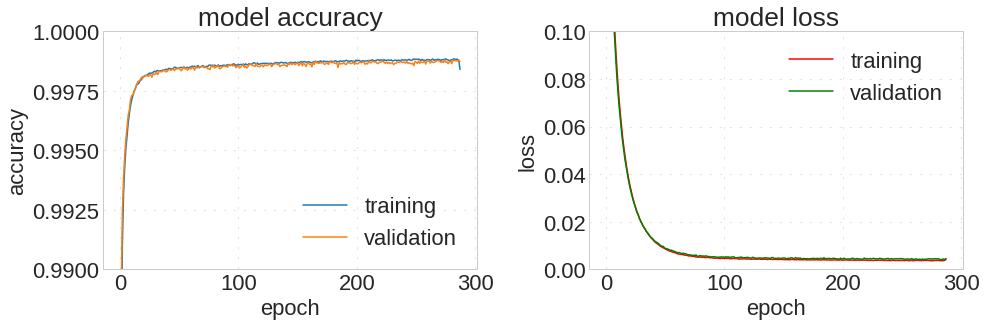

In [ ]:
cinnamonBagel2.plotAcc()

In [ ]:
cinnamonBagel2.weightAnalysis()

INFO:weightwatcher:

python      version 3.7.11 (default, Jul  3 2021, 18:01:19) 
[GCC 7.5.0]
numpy       version 1.19.5
tensforflow version 2.5.0
keras       version 2.5.0
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15

(   layer_id  name   D    M    N  ...  spectral_norm  stable_rank  sv_max  xmax  xmin
 0         0  None 0.3 12.0 12.0  ...           12.5          2.3     3.5  12.5   0.1
 1         1  None 0.3 12.0 32.0  ...           23.2          3.1     4.8  23.2   0.5
 2         3  None 0.1 32.0 32.0  ...           93.7          2.9     9.7  93.7   4.3
 3         5  None 0.1 32.0 32.0  ...          134.2          1.9    11.6 134.2   1.2
 4         7  None 0.1 32.0 32.0  ...           98.0          1.8     9.9  98.0   1.8
 5         9  None 0.1 32.0 32.0  ...           68.3          1.6     8.3  68.3   1.3
 6        11  None 0.1 32.0 32.0  ...           99.7          1.6    10.0  99.7   1.2
 7        13  None 0.1 32.0 32.0  ...           80.6          1.6     9.0  80.6   1.4
 8        15  None 0.1 32.0 32.0  ...          180.1          1.2    13.4 180.1   1.5
 9        17  None 0.1 32.0 32.0  ...           18.2          4.0     4.3  18.2   3.1
 10       19  None 0.1 32.0 32.0  ...           18.3  

In [ ]:
cinnamonBagel2.predictMC(100)

15831/15831 [==============================] - 22s 1ms/step
iteration 1 done
15831/15831 [==============================] - 21s 1ms/step
iteration 2 done
15831/15831 [==============================] - 21s 1ms/step
iteration 3 done
15831/15831 [==============================] - 22s 1ms/step
iteration 4 done
15831/15831 [==============================] - 23s 1ms/step
iteration 5 done
15831/15831 [==============================] - 23s 1ms/step
iteration 6 done
15831/15831 [==============================] - 23s 1ms/step
iteration 7 done
15831/15831 [==============================] - 24s 1ms/step
iteration 8 done
15831/15831 [==============================] - 23s 1ms/step
iteration 9 done
15831/15831 [==============================] - 21s 1ms/step
iteration 10 done
15831/15831 [==============================] - 21s 1ms/step
iteration 11 done
15831/15831 [==============================] - 21s 1ms/step
iteration 12 done
15831/15831 [==============================] - 22s 1ms/step
iteration 13 

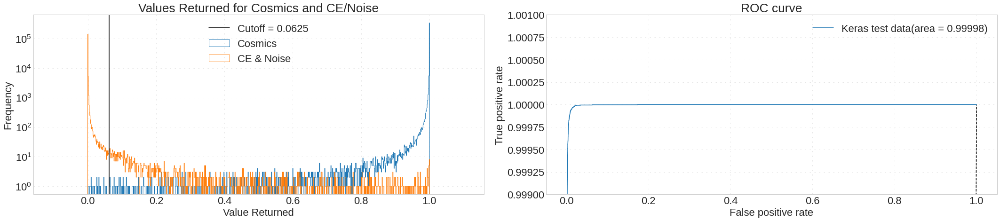

In [ ]:
cinnamonBagel2.cutoffTime()

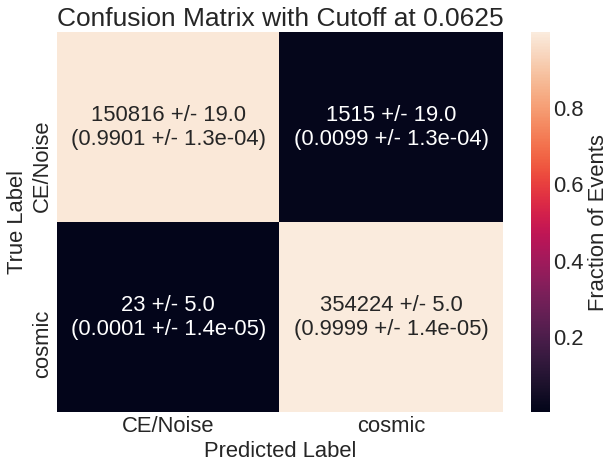

In [ ]:
cinnamonBagel2.finalConfusion()

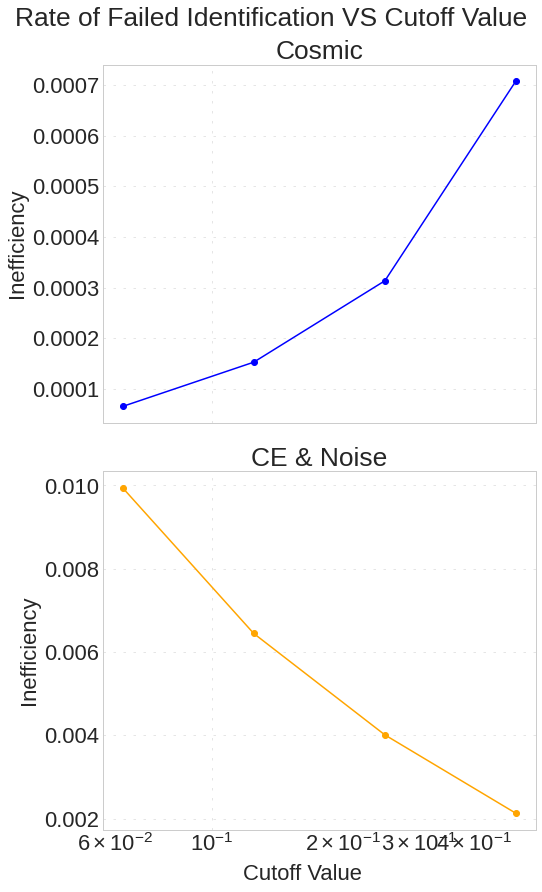

In [ ]:
cinnamonBagel2.cutoffPlot()

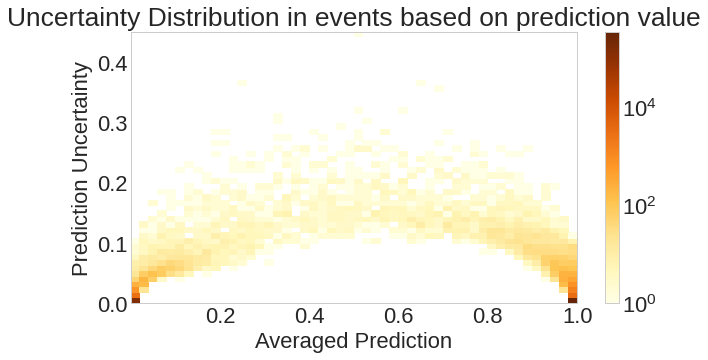

In [ ]:
cinnamonBagel2.errorPlot()

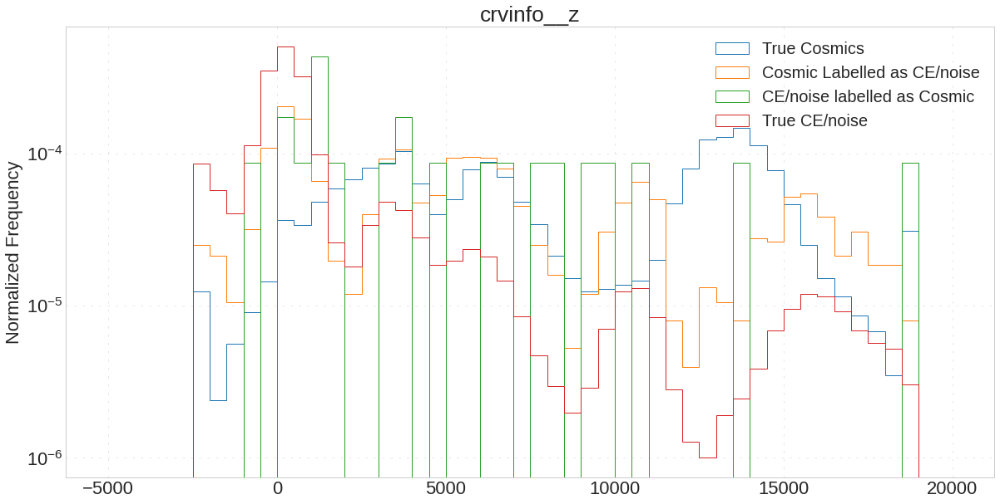

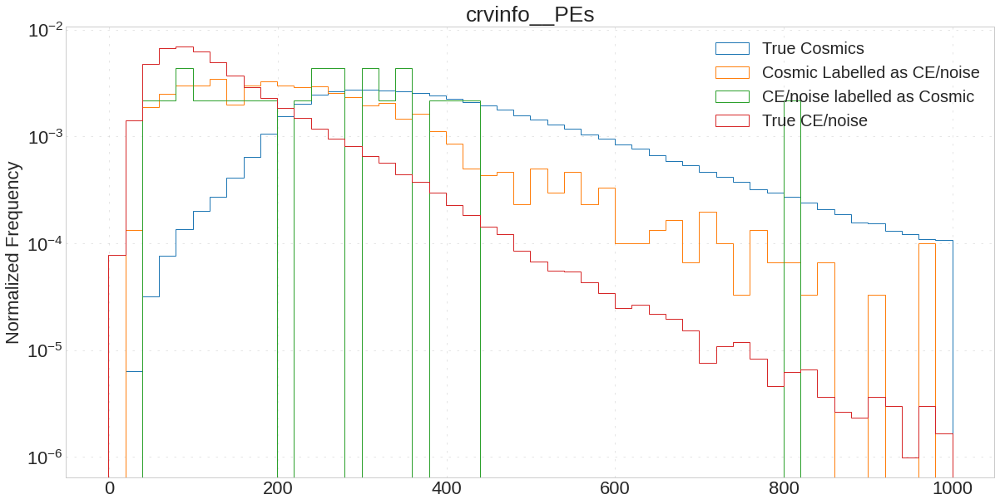

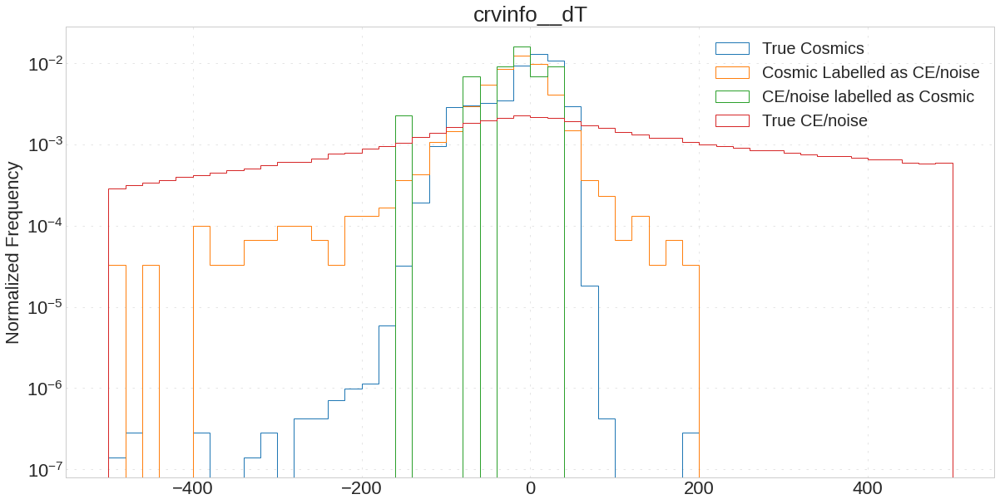

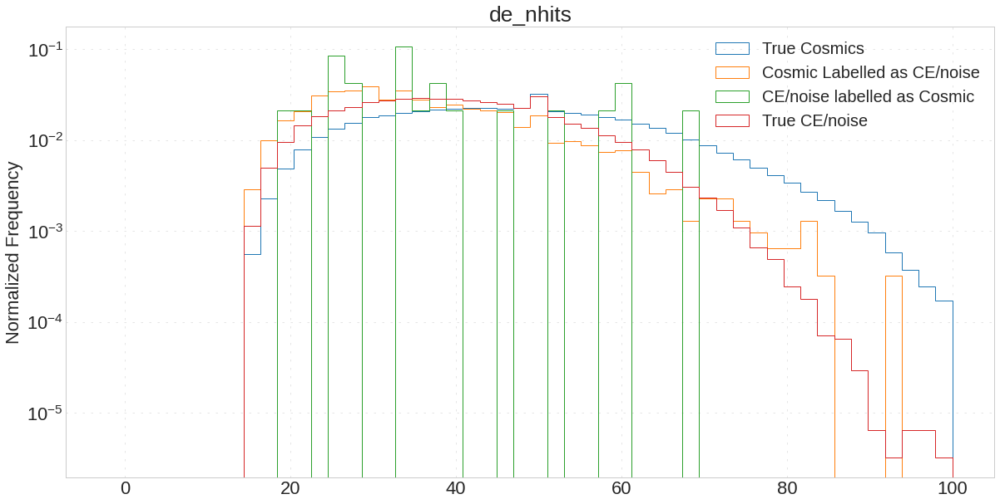

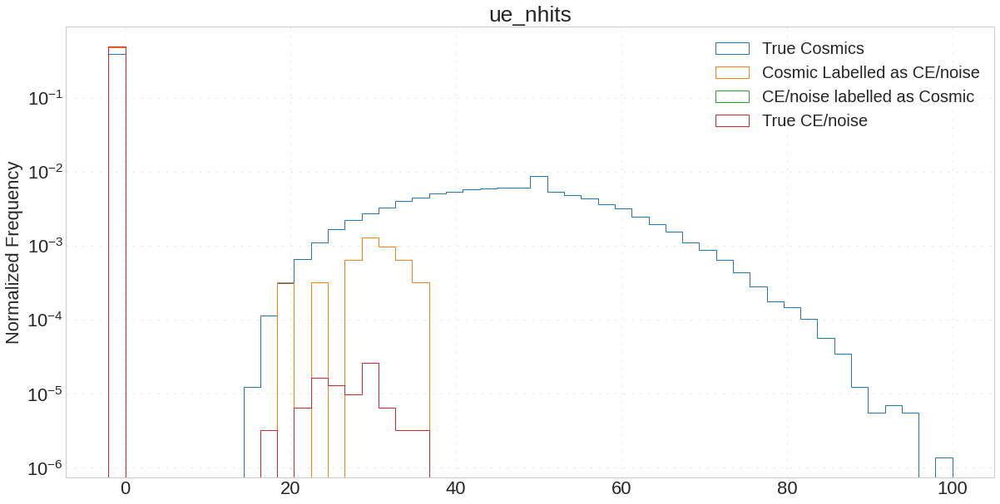

...

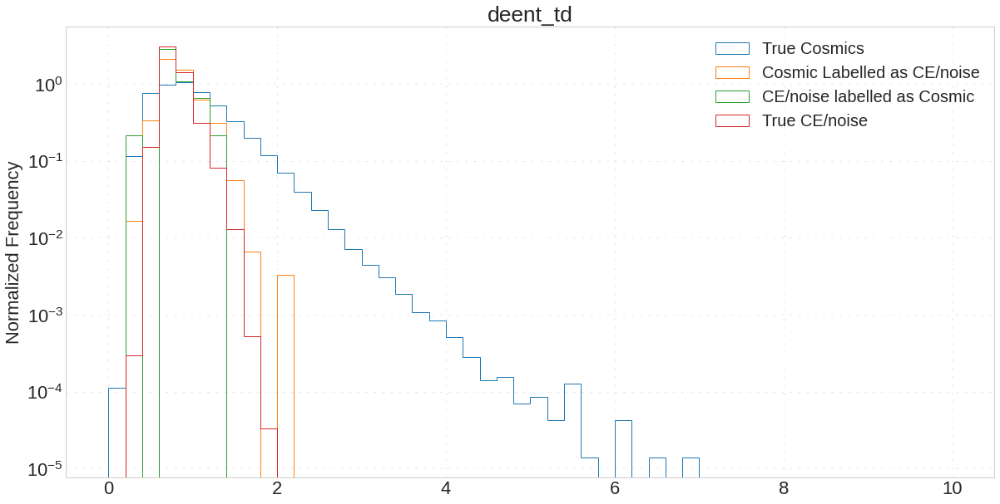

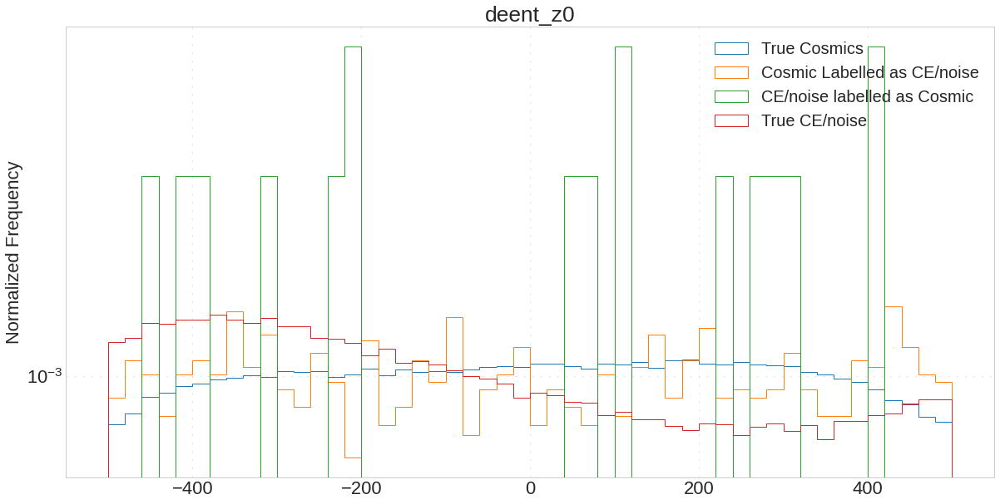

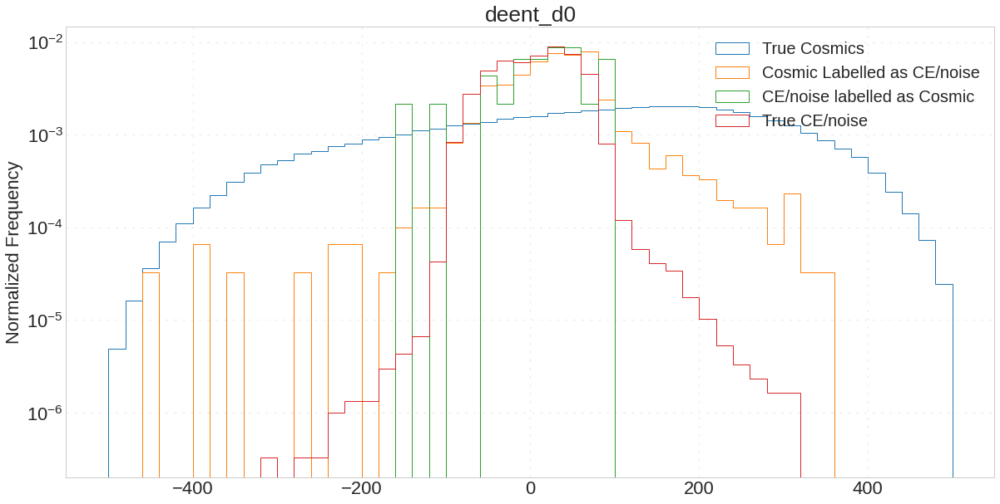

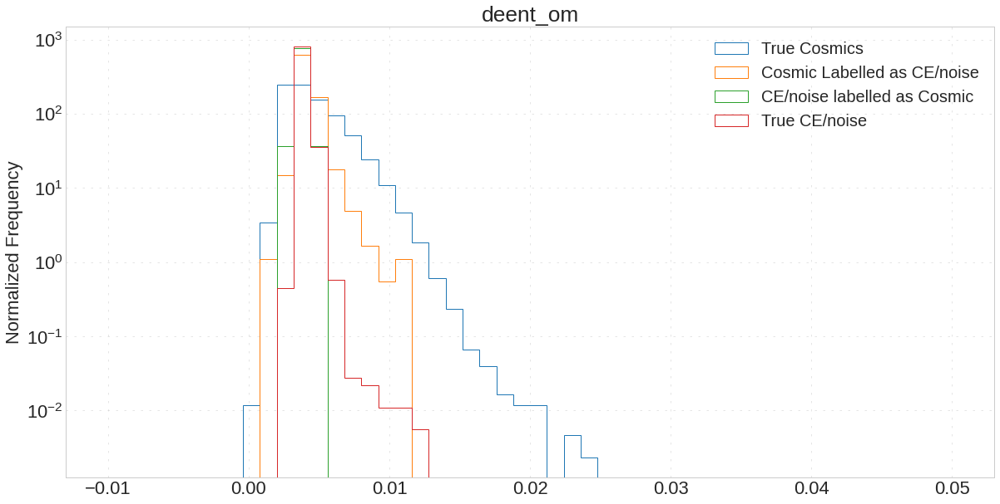

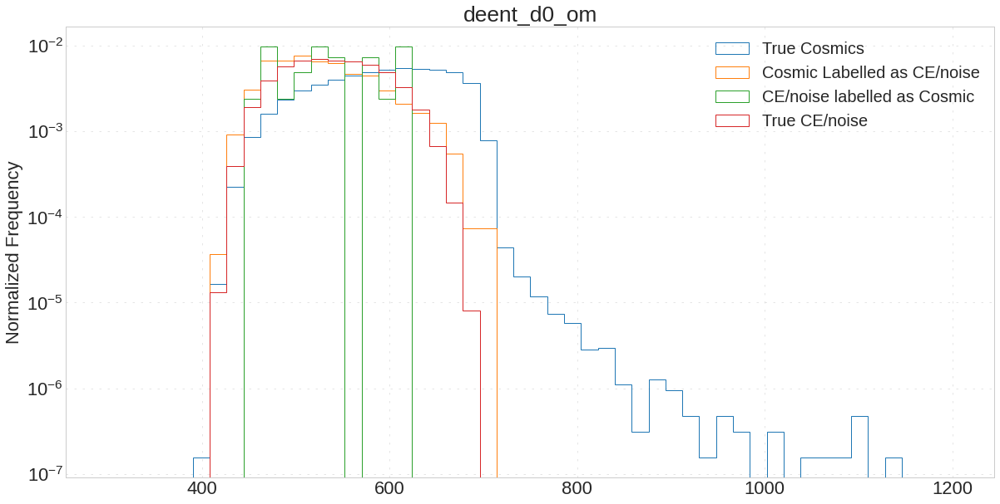

In [ ]:
cinnamonBagel2.quadrantDistribution(50)

#Model for Events Outside the CRV

In [ ]:
plainBagel = MLAnalyzer(noCRV_noMom_variables_list, noCRV_X_train, noCRV_y_train, noCRV_X_val, noCRV_y_val, no_CRV_X_test, no_CRV_y_test, scaler=noCRVscaler)

In [ ]:
plainBagel.trainModel(4,6,10, epoch=800)

INFO:weightwatcher:

python      version 3.7.11 (default, Jul  3 2021, 18:01:19) 
[GCC 7.5.0]
numpy       version 1.19.5
tensforflow version 2.6.0
keras       version 2.6.0


fitting model with width= 36 	depth= 8 	size= 10000
298 total neurons
Epoch 1/800
102/102 [==============================] - 8s 70ms/step - loss: 0.2562 - accuracy: 0.9414 - val_loss: 0.0884 - val_accuracy: 0.9571


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


xmin progress: 45%

Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 3.0035351733881797
Epoch 2/800
102/102 [==============================] - 9s 85ms/step - loss: 0.0574 - accuracy: 0.9728 - val_loss: 0.0322 - val_accuracy: 0.9922


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 3.4902333076161263
Epoch 3/800
102/102 [==============================] - 9s 86ms/step - loss: 0.0263 - accuracy: 0.9937 - val_loss: 0.0221 - val_accuracy: 0.9946


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 3.291157111635957
Epoch 4/800
102/102 [==============================] - 9s 88ms/step - loss: 0.0198 - accuracy: 0.9952 - val_loss: 0.0178 - val_accuracy: 0.9955


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.855781139865262
Epoch 5/800
102/102 [==============================] - 9s 87ms/step - loss: 0.0171 - accuracy: 0.9958 - val_loss: 0.0156 - val_accuracy: 0.9960


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.8168880985808604
Epoch 6/800
102/102 [==============================] - 9s 88ms/step - loss: 0.0156 - accuracy: 0.9962 - val_loss: 0.0147 - val_accuracy: 0.9963


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.9832255570991726
Epoch 7/800
102/102 [==============================] - 9s 91ms/step - loss: 0.0145 - accuracy: 0.9964 - val_loss: 0.0136 - val_accuracy: 0.9965


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.96596053418591
Epoch 8/800
102/102 [==============================] - 9s 89ms/step - loss: 0.0136 - accuracy: 0.9966 - val_loss: 0.0130 - val_accuracy: 0.9968


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.9694028837262914
Epoch 9/800
102/102 [==============================] - 9s 90ms/step - loss: 0.0130 - accuracy: 0.9967 - val_loss: 0.0125 - val_accuracy: 0.9968


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.9630890101276104
Epoch 10/800
102/102 [==============================] - 9s 89ms/step - loss: 0.0124 - accuracy: 0.9969 - val_loss: 0.0120 - val_accuracy: 0.9970


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.9663214653505996
Epoch 11/800
102/102 [==============================] - 10s 93ms/step - loss: 0.0119 - accuracy: 0.9970 - val_loss: 0.0114 - val_accuracy: 0.9970


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 3.088536381040783
Epoch 12/800
102/102 [==============================] - 10s 94ms/step - loss: 0.0114 - accuracy: 0.9970 - val_loss: 0.0112 - val_accuracy: 0.9970


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.957608213232519
Epoch 13/800
102/102 [==============================] - 10s 94ms/step - loss: 0.0111 - accuracy: 0.9972 - val_loss: 0.0109 - val_accuracy: 0.9971


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.901421687457131
Epoch 14/800
102/102 [==============================] - 10s 93ms/step - loss: 0.0108 - accuracy: 0.9972 - val_loss: 0.0107 - val_accuracy: 0.9972


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.8897023414521312
Epoch 15/800
102/102 [==============================] - 10s 95ms/step - loss: 0.0106 - accuracy: 0.9973 - val_loss: 0.0104 - val_accuracy: 0.9972


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.8294155164094734
Epoch 16/800
102/102 [==============================] - 10s 94ms/step - loss: 0.0104 - accuracy: 0.9973 - val_loss: 0.0101 - val_accuracy: 0.9973


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.795975175390965
Epoch 17/800
102/102 [==============================] - 10s 94ms/step - loss: 0.0102 - accuracy: 0.9973 - val_loss: 0.0100 - val_accuracy: 0.9974


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.758444846739125
Epoch 18/800
102/102 [==============================] - 10s 94ms/step - loss: 0.0099 - accuracy: 0.9974 - val_loss: 0.0097 - val_accuracy: 0.9974


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.740222482082274
Epoch 19/800
102/102 [==============================] - 10s 94ms/step - loss: 0.0097 - accuracy: 0.9974 - val_loss: 0.0096 - val_accuracy: 0.9974


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


xmin progress: 02%

Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.857740662278159
Epoch 20/800
102/102 [==============================] - 10s 96ms/step - loss: 0.0096 - accuracy: 0.9975 - val_loss: 0.0094 - val_accuracy: 0.9974


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.7391229689179406
Epoch 21/800
102/102 [==============================] - 10s 95ms/step - loss: 0.0095 - accuracy: 0.9974 - val_loss: 0.0094 - val_accuracy: 0.9974


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.8032685111629565
Epoch 22/800
102/102 [==============================] - 10s 97ms/step - loss: 0.0093 - accuracy: 0.9975 - val_loss: 0.0092 - val_accuracy: 0.9975


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.793575760107338
Epoch 23/800
102/102 [==============================] - 10s 95ms/step - loss: 0.0092 - accuracy: 0.9975 - val_loss: 0.0091 - val_accuracy: 0.9975


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.770015405542808
Epoch 24/800
102/102 [==============================] - 10s 95ms/step - loss: 0.0092 - accuracy: 0.9975 - val_loss: 0.0088 - val_accuracy: 0.9974


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.7652144316796035
Epoch 25/800
  1/102 [..............................] - ETA: 8s - loss: 0.0088 - accuracy: 0.9982

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 97ms/step - loss: 0.0091 - accuracy: 0.9975 - val_loss: 0.0089 - val_accuracy: 0.9975


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.7520196200055085
Epoch 26/800
102/102 [==============================] - 10s 96ms/step - loss: 0.0089 - accuracy: 0.9975 - val_loss: 0.0087 - val_accuracy: 0.9976


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.7213287879355104
Epoch 27/800
102/102 [==============================] - 10s 99ms/step - loss: 0.0088 - accuracy: 0.9976 - val_loss: 0.0088 - val_accuracy: 0.9975


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.711139884937516
Epoch 28/800
102/102 [==============================] - 10s 98ms/step - loss: 0.0088 - accuracy: 0.9975 - val_loss: 0.0087 - val_accuracy: 0.9975


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.6994185311974097
Epoch 29/800
102/102 [==============================] - 10s 99ms/step - loss: 0.0086 - accuracy: 0.9976 - val_loss: 0.0087 - val_accuracy: 0.9975


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.7018974844758286
Epoch 30/800
102/102 [==============================] - 10s 97ms/step - loss: 0.0085 - accuracy: 0.9976 - val_loss: 0.0086 - val_accuracy: 0.9976


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.667336760374061
Epoch 31/800
102/102 [==============================] - 10s 97ms/step - loss: 0.0085 - accuracy: 0.9976 - val_loss: 0.0084 - val_accuracy: 0.9976


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.690758225539793
Epoch 32/800
102/102 [==============================] - 10s 98ms/step - loss: 0.0084 - accuracy: 0.9977 - val_loss: 0.0083 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.6042289806443617
Epoch 33/800
102/102 [==============================] - 10s 97ms/step - loss: 0.0083 - accuracy: 0.9976 - val_loss: 0.0082 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.605005678595263
Epoch 34/800
102/102 [==============================] - 10s 98ms/step - loss: 0.0083 - accuracy: 0.9977 - val_loss: 0.0082 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.5933211668681753
Epoch 35/800
102/102 [==============================] - 10s 98ms/step - loss: 0.0083 - accuracy: 0.9976 - val_loss: 0.0083 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.5813243637704693
Epoch 36/800
102/102 [==============================] - 10s 97ms/step - loss: 0.0083 - accuracy: 0.9976 - val_loss: 0.0082 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.566210573687806
Epoch 37/800
102/102 [==============================] - 10s 96ms/step - loss: 0.0082 - accuracy: 0.9977 - val_loss: 0.0082 - val_accuracy: 0.9976


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.585400020152807
Epoch 38/800
102/102 [==============================] - 10s 96ms/step - loss: 0.0080 - accuracy: 0.9977 - val_loss: 0.0080 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.555294846563046
Epoch 39/800
102/102 [==============================] - 10s 96ms/step - loss: 0.0081 - accuracy: 0.9977 - val_loss: 0.0080 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.5338774852551325
Epoch 40/800
102/102 [==============================] - 10s 97ms/step - loss: 0.0080 - accuracy: 0.9977 - val_loss: 0.0081 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.5151036791536256
Epoch 41/800
102/102 [==============================] - 10s 95ms/step - loss: 0.0080 - accuracy: 0.9977 - val_loss: 0.0080 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.5051013988002575
Epoch 42/800
  1/102 [..............................] - ETA: 9s - loss: 0.0071 - accuracy: 0.9976

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 96ms/step - loss: 0.0079 - accuracy: 0.9977 - val_loss: 0.0081 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.503217054742144
Epoch 43/800
102/102 [==============================] - 10s 98ms/step - loss: 0.0079 - accuracy: 0.9977 - val_loss: 0.0078 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.4967675896459154
Epoch 44/800
102/102 [==============================] - 10s 98ms/step - loss: 0.0078 - accuracy: 0.9977 - val_loss: 0.0078 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.50036504574709
Epoch 45/800
102/102 [==============================] - 10s 100ms/step - loss: 0.0078 - accuracy: 0.9977 - val_loss: 0.0080 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


xmin progress: 08%

Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.5032633289520896
Epoch 46/800
102/102 [==============================] - 10s 99ms/step - loss: 0.0078 - accuracy: 0.9977 - val_loss: 0.0077 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.7154466447292367
Epoch 47/800
102/102 [==============================] - 10s 99ms/step - loss: 0.0078 - accuracy: 0.9978 - val_loss: 0.0077 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.485268089859367
Epoch 48/800
  1/102 [..............................] - ETA: 8s - loss: 0.0073 - accuracy: 0.9977

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 99ms/step - loss: 0.0076 - accuracy: 0.9978 - val_loss: 0.0078 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.466878790924519
Epoch 49/800
102/102 [==============================] - 10s 99ms/step - loss: 0.0077 - accuracy: 0.9977 - val_loss: 0.0076 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.4282559683736067
Epoch 50/800
102/102 [==============================] - 10s 98ms/step - loss: 0.0076 - accuracy: 0.9978 - val_loss: 0.0076 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.429145245467157
Epoch 51/800
102/102 [==============================] - 10s 99ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0076 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.4152617326583954
Epoch 52/800
  1/102 [..............................] - ETA: 7s - loss: 0.0075 - accuracy: 0.9975

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 100ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.4101592037054984
Epoch 53/800
  1/102 [..............................] - ETA: 7s - loss: 0.0050 - accuracy: 0.9987

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 101ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0075 - val_accuracy: 0.9977


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.4061492467496075
Epoch 54/800
102/102 [==============================] - 10s 100ms/step - loss: 0.0074 - accuracy: 0.9978 - val_loss: 0.0075 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.385044762141407
Epoch 55/800
102/102 [==============================] - 10s 101ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0075 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.383079102428804
Epoch 56/800
102/102 [==============================] - 10s 101ms/step - loss: 0.0074 - accuracy: 0.9978 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.245186366207327
Epoch 57/800
102/102 [==============================] - 10s 100ms/step - loss: 0.0074 - accuracy: 0.9978 - val_loss: 0.0075 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.244161113155186
Epoch 58/800
  1/102 [..............................] - ETA: 8s - loss: 0.0093 - accuracy: 0.9970

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 102ms/step - loss: 0.0074 - accuracy: 0.9978 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.3004594594436245
Epoch 59/800
102/102 [==============================] - 10s 101ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.0073 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.2938193558570763
Epoch 60/800
  1/102 [..............................] - ETA: 7s - loss: 0.0054 - accuracy: 0.9985

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 101ms/step - loss: 0.0074 - accuracy: 0.9978 - val_loss: 0.0075 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.3208014216461827
Epoch 61/800
  1/102 [..............................] - ETA: 8s - loss: 0.0076 - accuracy: 0.9975

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 100ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.0074 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.3480937563534634
Epoch 62/800
  2/102 [..............................] - ETA: 9s - loss: 0.0091 - accuracy: 0.9975

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 100ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.281988593131653
Epoch 63/800
  1/102 [..............................] - ETA: 8s - loss: 0.0050 - accuracy: 0.9982

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 101ms/step - loss: 0.0072 - accuracy: 0.9978 - val_loss: 0.0072 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.312761677632307
Epoch 64/800
102/102 [==============================] - 10s 101ms/step - loss: 0.0072 - accuracy: 0.9979 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.283814808584494
Epoch 65/800
  1/102 [..............................] - ETA: 8s - loss: 0.0056 - accuracy: 0.9985

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 102ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.27587407214663
Epoch 66/800
102/102 [==============================] - 10s 102ms/step - loss: 0.0072 - accuracy: 0.9979 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.2813716223664287
Epoch 67/800
  1/102 [..............................] - ETA: 7s - loss: 0.0063 - accuracy: 0.9984

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 100ms/step - loss: 0.0072 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.3081439159220722
Epoch 68/800
102/102 [==============================] - 10s 101ms/step - loss: 0.0072 - accuracy: 0.9979 - val_loss: 0.0073 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.2462573622622126
Epoch 69/800
102/102 [==============================] - 10s 102ms/step - loss: 0.0072 - accuracy: 0.9978 - val_loss: 0.0072 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.261785494747979
Epoch 70/800
  1/102 [..............................] - ETA: 7s - loss: 0.0080 - accuracy: 0.9974

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 102ms/step - loss: 0.0072 - accuracy: 0.9979 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.238500065438612
Epoch 71/800
  1/102 [..............................] - ETA: 7s - loss: 0.0066 - accuracy: 0.9976

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 10s 101ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.224290522979792
Epoch 72/800
102/102 [==============================] - 10s 102ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.226683684548122
Epoch 73/800
  1/102 [..............................] - ETA: 8s - loss: 0.0092 - accuracy: 0.9975

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 106ms/step - loss: 0.0071 - accuracy: 0.9978 - val_loss: 0.0071 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.

Current alpha value of 2.224175301895343
Epoch 74/800
  1/102 [..............................] - ETA: 7s - loss: 0.0076 - accuracy: 0.9976


Not enough data. Returning nan


102/102 [==============================] - 11s 108ms/step - loss: 0.0072 - accuracy: 0.9978 - val_loss: 0.0073 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Current alpha value of 2.217331367011769
Epoch 75/800
  1/102 [..............................] - ETA: 10s - loss: 0.0058 - accuracy: 0.9979

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 110ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.202706543452101
Epoch 76/800
102/102 [==============================] - 11s 106ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.2158525459313685
Epoch 77/800
  1/102 [..............................] - ETA: 9s - loss: 0.0059 - accuracy: 0.9981

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 109ms/step - loss: 0.0070 - accuracy: 0.9978 - val_loss: 0.0073 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Current alpha value of 2.2165761339077297
Epoch 78/800
  1/102 [..............................] - ETA: 8s - loss: 0.0057 - accuracy: 0.9981

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 107ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.203936842065266
Epoch 79/800
102/102 [==============================] - 11s 110ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1827734195013795
Epoch 80/800
  1/102 [..............................] - ETA: 9s - loss: 0.0073 - accuracy: 0.9979

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 108ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.165851297136222
Epoch 81/800
  1/102 [..............................] - ETA: 8s - loss: 0.0053 - accuracy: 0.9985

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 106ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.166763900228931
Epoch 82/800
102/102 [==============================] - 11s 109ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Assuming nested distributions


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.161020013349923
Epoch 83/800
102/102 [==============================] - 11s 109ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.167451652572489
Epoch 84/800
  1/102 [..............................] - ETA: 9s - loss: 0.0066 - accuracy: 0.9981

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 111ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1585585185742207
Epoch 85/800
102/102 [==============================] - 11s 108ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1551768542423093
Epoch 86/800
102/102 [==============================] - 11s 108ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Assuming nested distributions
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1524750604986767
Epoch 87/800
102/102 [==============================] - 11s 111ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1448539641725044
Epoch 88/800
102/102 [==============================] - 11s 110ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1402553996559748
Epoch 89/800
102/102 [==============================] - 11s 112ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.142494588190174
Epoch 90/800
102/102 [==============================] - 11s 108ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.167138076416871
Epoch 91/800
102/102 [==============================] - 11s 107ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.160106951823734
Epoch 92/800
  1/102 [..............................] - ETA: 10s - loss: 0.0079 - accuracy: 0.9976

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 111ms/step - loss: 0.0069 - accuracy: 0.9980 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


xmin progress: 20%

Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.1998599337153917
Epoch 93/800
  1/102 [..............................] - ETA: 8s - loss: 0.0060 - accuracy: 0.9986

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 108ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


xmin progress: 14%

Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1857821433327507
Epoch 94/800
102/102 [==============================] - 11s 106ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9978


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.167764820415076
Epoch 95/800
  1/102 [..............................] - ETA: 8s - loss: 0.0074 - accuracy: 0.9979

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 106ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1731285725513776
Epoch 96/800
102/102 [==============================] - 11s 108ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1571211497049467
Epoch 97/800
102/102 [==============================] - 11s 111ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1572352953278986
Epoch 98/800
102/102 [==============================] - 11s 112ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.156482735207623
Epoch 99/800
102/102 [==============================] - 11s 110ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.135703996231048
Epoch 100/800
  1/102 [..............................] - ETA: 8s - loss: 0.0083 - accuracy: 0.9977

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 110ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.1784084068364233
Epoch 101/800
  1/102 [..............................] - ETA: 8s - loss: 0.0073 - accuracy: 0.9978

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 110ms/step - loss: 0.0068 - accuracy: 0.9979 - val_loss: 0.0069 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.181352027001842
Epoch 102/800
  1/102 [..............................] - ETA: 8s - loss: 0.0060 - accuracy: 0.9981

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 110ms/step - loss: 0.0068 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1534035215980056
Epoch 103/800
102/102 [==============================] - 11s 108ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1404628523775853
Epoch 104/800
102/102 [==============================] - 11s 108ms/step - loss: 0.0068 - accuracy: 0.9979 - val_loss: 0.0069 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.1308559001404586
Epoch 105/800
  1/102 [..............................] - ETA: 8s - loss: 0.0066 - accuracy: 0.9978

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 110ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.134009512170806
Epoch 106/800
  1/102 [..............................] - ETA: 8s - loss: 0.0058 - accuracy: 0.9982

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 108ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0069 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.1317303129984806
Epoch 107/800
  1/102 [..............................] - ETA: 8s - loss: 0.0074 - accuracy: 0.9979

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 111ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Current alpha value of 2.119320090109418
Epoch 108/800
  1/102 [..............................] - ETA: 8s - loss: 0.0065 - accuracy: 0.9981

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 108ms/step - loss: 0.0068 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.123640989764276
Epoch 109/800
102/102 [==============================] - 11s 112ms/step - loss: 0.0068 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.125447618656864
Epoch 110/800
  1/102 [..............................] - ETA: 8s - loss: 0.0060 - accuracy: 0.9978

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 110ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.116752054328583
Epoch 111/800
  1/102 [..............................] - ETA: 7s - loss: 0.0045 - accuracy: 0.9988

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 113ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.1256651182424706
Epoch 112/800
  1/102 [..............................] - ETA: 7s - loss: 0.0064 - accuracy: 0.9985

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 11s 112ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.128682593512379
Epoch 113/800
  1/102 [..............................] - ETA: 9s - loss: 0.0051 - accuracy: 0.9986

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 114ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.120547735571532
Epoch 114/800
  1/102 [..............................] - ETA: 8s - loss: 0.0058 - accuracy: 0.9983

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 115ms/step - loss: 0.0068 - accuracy: 0.9979 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.1167063782149635
Epoch 115/800
  1/102 [..............................] - ETA: 8s - loss: 0.0074 - accuracy: 0.9980

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 116ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1198973409450326
Epoch 116/800
102/102 [==============================] - 12s 115ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Current alpha value of 2.107604118695088
Epoch 117/800
  1/102 [..............................] - ETA: 9s - loss: 0.0054 - accuracy: 0.9984

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 115ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


xmin progress: 14%

Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.107746813589077
Epoch 118/800
102/102 [==============================] - 12s 117ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.113415928624138
Epoch 119/800
102/102 [==============================] - 12s 118ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.107716195596126
Epoch 120/800
102/102 [==============================] - 12s 120ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.1030251413899093
Epoch 121/800
  1/102 [..............................] - ETA: 8s - loss: 0.0080 - accuracy: 0.9973

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 120ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0070 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Current alpha value of 2.102313408364676
Epoch 122/800
  1/102 [..............................] - ETA: 8s - loss: 0.0090 - accuracy: 0.9976

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 121ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Current alpha value of 2.0889230907357357
Epoch 123/800
  1/102 [..............................] - ETA: 8s - loss: 0.0065 - accuracy: 0.9982

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 117ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.


Current alpha value of 2.0908671198992743
Epoch 124/800
  1/102 [..............................] - ETA: 9s - loss: 0.0088 - accuracy: 0.9970

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 120ms/step - loss: 0.0067 - accuracy: 0.9979 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


xmin progress: 62%

Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.0833462551036783
Epoch 125/800
102/102 [==============================] - 12s 119ms/step - loss: 0.0068 - accuracy: 0.9979 - val_loss: 0.0069 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.088662505259429
Epoch 126/800
  1/102 [..............................] - ETA: 8s - loss: 0.0065 - accuracy: 0.9983

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 118ms/step - loss: 0.0068 - accuracy: 0.9979 - val_loss: 0.0069 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Current alpha value of 2.0959932546871403
Epoch 127/800
  1/102 [..............................] - ETA: 8s - loss: 0.0055 - accuracy: 0.9984

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 121ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.1001777018723775
Epoch 128/800
  1/102 [..............................] - ETA: 7s - loss: 0.0059 - accuracy: 0.9984

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 121ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.100775372667756
Epoch 129/800
102/102 [==============================] - 12s 119ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.1039173889740583
Epoch 130/800
  1/102 [..............................] - ETA: 8s - loss: 0.0054 - accuracy: 0.9982

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 120ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.102194029326756
Epoch 131/800
102/102 [==============================] - 12s 121ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0067 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.101394608782718
Epoch 132/800
102/102 [==============================] - 12s 122ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


xmin progress: 87%

Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.1073669119412815
Epoch 133/800
102/102 [==============================] - 12s 118ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions

Current alpha value of 2.093853316097514
Epoch 134/800
  1/102 [..............................] - ETA: 8s - loss: 0.0086 - accuracy: 0.9973


Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 117ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


Assuming nested distributions


xmin progress: 17%

Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.0852549354241825
Epoch 135/800
  1/102 [..............................] - ETA: 8s - loss: 0.0078 - accuracy: 0.9982

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 119ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.095895310834143
Epoch 136/800
  1/102 [..............................] - ETA: 8s - loss: 0.0054 - accuracy: 0.9981

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 119ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.106320520387177
Epoch 137/800
  1/102 [..............................] - ETA: 10s - loss: 0.0065 - accuracy: 0.9981

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 119ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.1059498600753916
Epoch 138/800
  1/102 [..............................] - ETA: 9s - loss: 0.0090 - accuracy: 0.9972

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 118ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.0446158473203955
Epoch 139/800
  1/102 [..............................] - ETA: 8s - loss: 0.0066 - accuracy: 0.9977

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 118ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.075374051437519
Epoch 140/800
  1/102 [..............................] - ETA: 9s - loss: 0.0087 - accuracy: 0.9970

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 119ms/step - loss: 0.0067 - accuracy: 0.9979 - val_loss: 0.0068 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


xmin progress: 20%

Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.0858544825537924
Epoch 141/800
  1/102 [..............................] - ETA: 8s - loss: 0.0071 - accuracy: 0.9980

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 117ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Current alpha value of 2.0939944079326747
Epoch 142/800
  1/102 [..............................] - ETA: 9s - loss: 0.0092 - accuracy: 0.9972

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 121ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.0963982089584308
Epoch 143/800
  1/102 [..............................] - ETA: 8s - loss: 0.0078 - accuracy: 0.9976

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 119ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


xmin progress: 25%

Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.043663967365264
Epoch 144/800
  1/102 [..............................] - ETA: 9s - loss: 0.0086 - accuracy: 0.9973

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 13s 124ms/step - loss: 0.0066 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.043473138647867
Epoch 145/800
  1/102 [..............................] - ETA: 8s - loss: 0.0072 - accuracy: 0.9980

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 120ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.0441239732682326
Epoch 146/800
  1/102 [..............................] - ETA: 9s - loss: 0.0052 - accuracy: 0.9988

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 118ms/step - loss: 0.0067 - accuracy: 0.9979 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.0444044009532867
Epoch 147/800
  1/102 [..............................] - ETA: 8s - loss: 0.0053 - accuracy: 0.9984

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 120ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


xmin progress: 75%

Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.0332560377615363
Epoch 148/800
102/102 [==============================] - 12s 120ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.0400888714938485
Epoch 149/800
  1/102 [..............................] - ETA: 8s - loss: 0.0070 - accuracy: 0.9980

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 122ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.0326316509953504
Epoch 150/800
  1/102 [..............................] - ETA: 9s - loss: 0.0086 - accuracy: 0.9966

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 121ms/step - loss: 0.0066 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


xmin progress: 62%

Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.0874918165908287
Epoch 151/800
  1/102 [..............................] - ETA: 8s - loss: 0.0094 - accuracy: 0.9970

No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 120ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions


Current alpha value of 2.035024697128817
Epoch 152/800
  1/102 [..............................] - ETA: 8s - loss: 0.0082 - accuracy: 0.9970

Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 13s 124ms/step - loss: 0.0066 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


xmin progress: 08%

Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Current alpha value of 2.0451325895977215
Epoch 153/800
  1/102 [..............................] - ETA: 8s - loss: 0.0086 - accuracy: 0.9974

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 122ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Current alpha value of 2.037997901306958
Epoch 154/800
  1/102 [..............................] - ETA: 8s - loss: 0.0058 - accuracy: 0.9986

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 122ms/step - loss: 0.0066 - accuracy: 0.9980 - val_loss: 0.0068 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Current alpha value of 2.079420783050911
Epoch 155/800
  1/102 [..............................] - ETA: 8s - loss: 0.0059 - accuracy: 0.9981

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 119ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions
'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Current alpha value of 2.0782474812884573
Epoch 156/800
  1/102 [..............................] - ETA: 9s - loss: 0.0051 - accuracy: 0.9985

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 123ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


xmin progress: 22%

Assuming nested distributions


Assuming nested distributions
Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Current alpha value of 2.013306081917154
Epoch 157/800
  1/102 [..............................] - ETA: 9s - loss: 0.0062 - accuracy: 0.9982

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 12s 121ms/step - loss: 0.0066 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9979


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan


Current alpha value of 2.0219356063856715
Epoch 158/800
  1/102 [..............................] - ETA: 8s - loss: 0.0072 - accuracy: 0.9980

No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 13s 125ms/step - loss: 0.0067 - accuracy: 0.9980 - val_loss: 0.0067 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


Assuming nested distributions


xmin progress: 08%

Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Current alpha value of 2.0172785134439737
Epoch 159/800
  1/102 [..............................] - ETA: 9s - loss: 0.0064 - accuracy: 0.9976

Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


102/102 [==============================] - 13s 124ms/step - loss: 0.0066 - accuracy: 0.9980 - val_loss: 0.0067 - val_accuracy: 0.9980


INFO:weightwatcher:Saving all images to ww-img
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savedir': 'ww-img', 'savefig': 'ww-img', 'rescale': True, 'deltaEs': False, 'intra': False, 'channels': None, 'conv2d_fft': False, 'ww2x': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'layers': []}
INFO:weightwatcher:Saving all images to ww-img


Assuming nested distributions


Assuming nested distributions
Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


Assuming nested distributions


'nan' in fit cumulative distribution values.
Likely underflow or overflow error: the optimal fit for this distribution gives values that are so extreme that we lack the numerical precision to calculate them.
Assuming nested distributions


Assuming nested distributions


Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.
Assuming nested distributions
Not enough data. Returning nan
No valid fits found.
Not enough data. Returning nan


Current alpha value of 2.0048390360728234


No valid fits found.
Not enough data. Returning nan


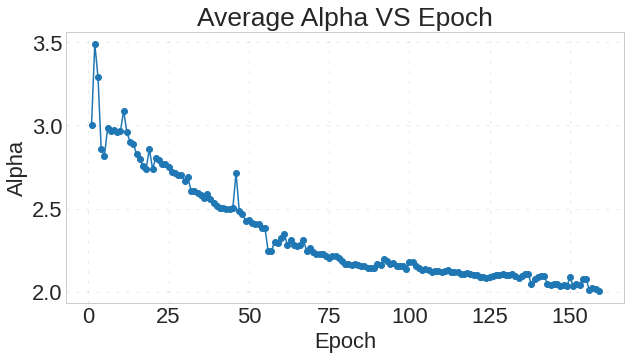

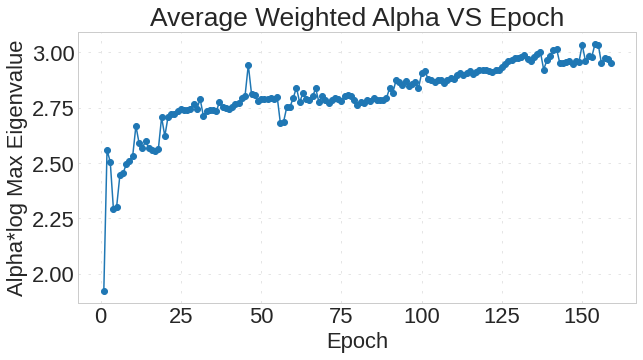

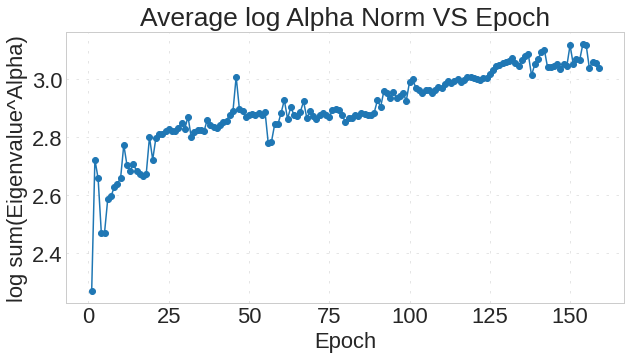

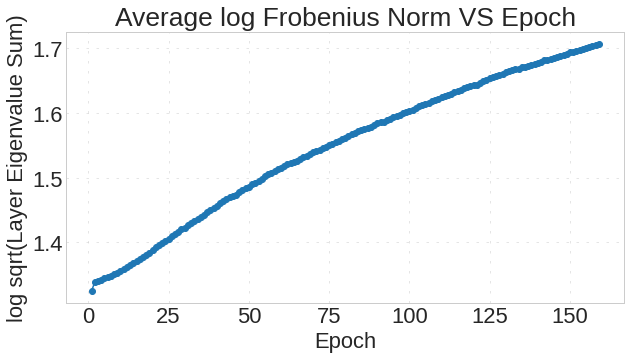

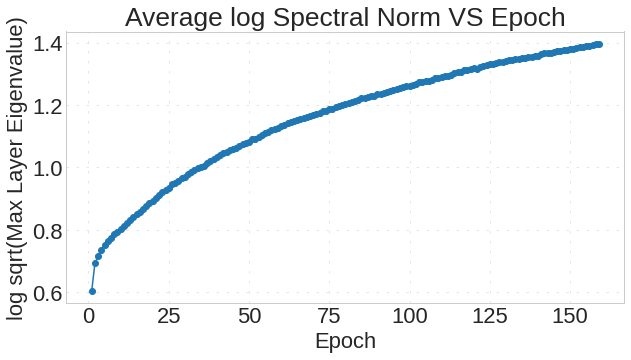

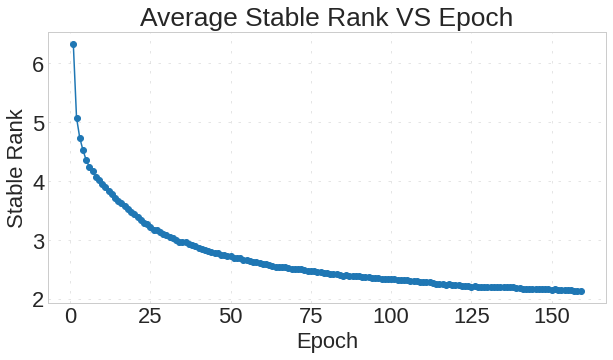

In [ ]:
plainBagel.plotWeights()

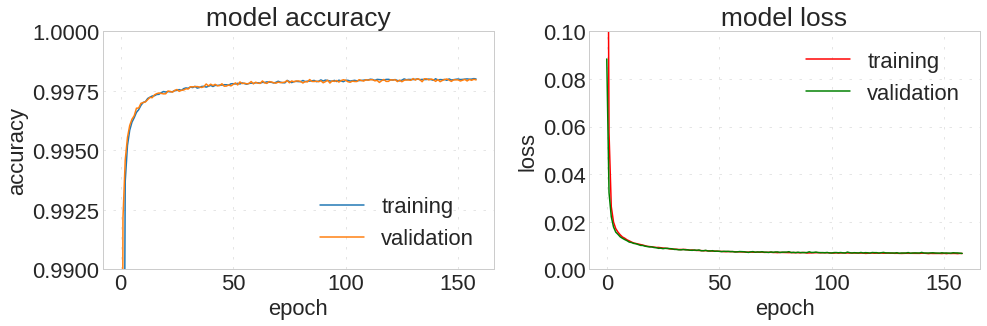

In [ ]:
plainBagel.plotAcc()

In [ ]:
plainBagel.save("PlainBagel")

In [ ]:
plainBagel.load("PlainBagel")

In [ ]:
plainBagel.predictMC(1)

10595/10595 [==============================] - 11s 1ms/step
iteration 1 done


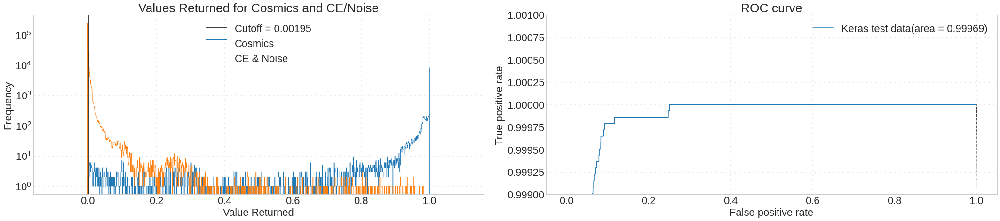

In [ ]:
plainBagel.cutoffTime()

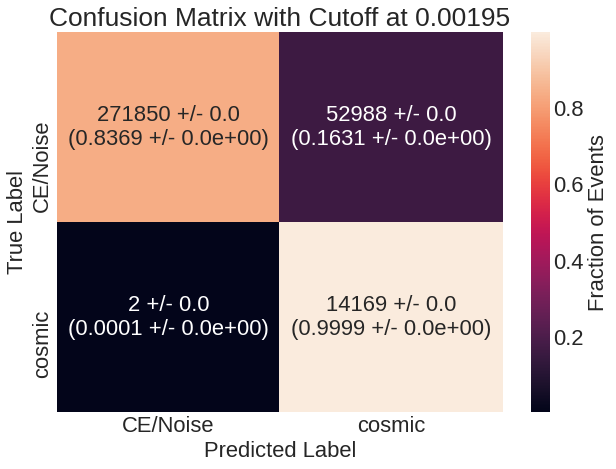

In [ ]:
plainBagel.finalConfusion()

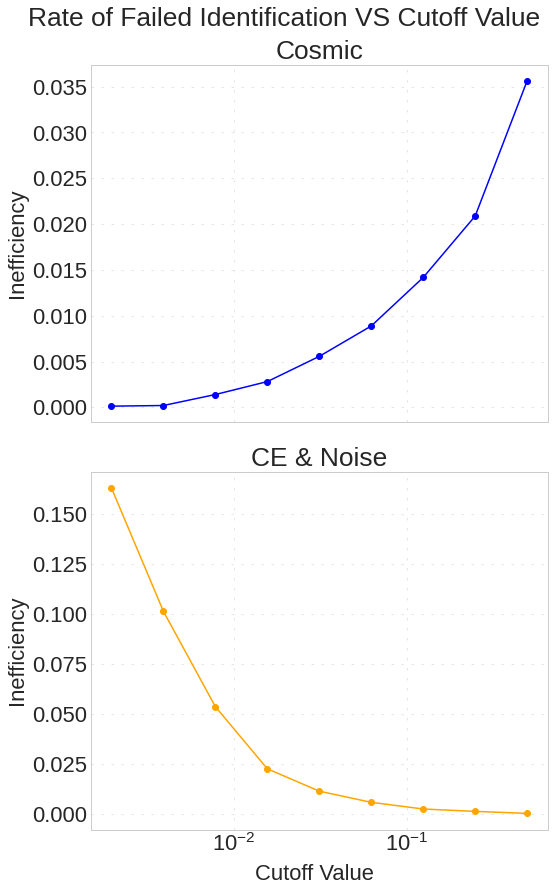

In [ ]:
plainBagel.cutoffPlot()

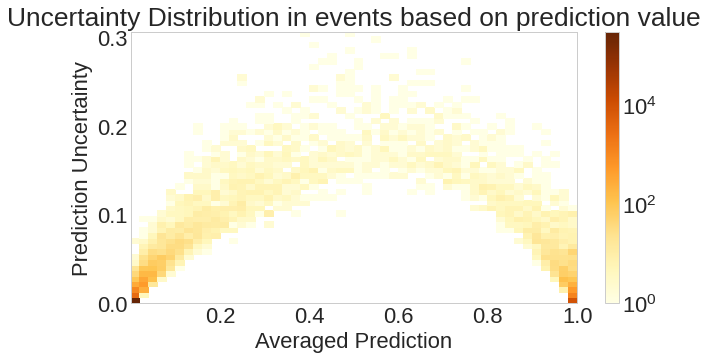

In [ ]:
plainBagel.errorPlot()

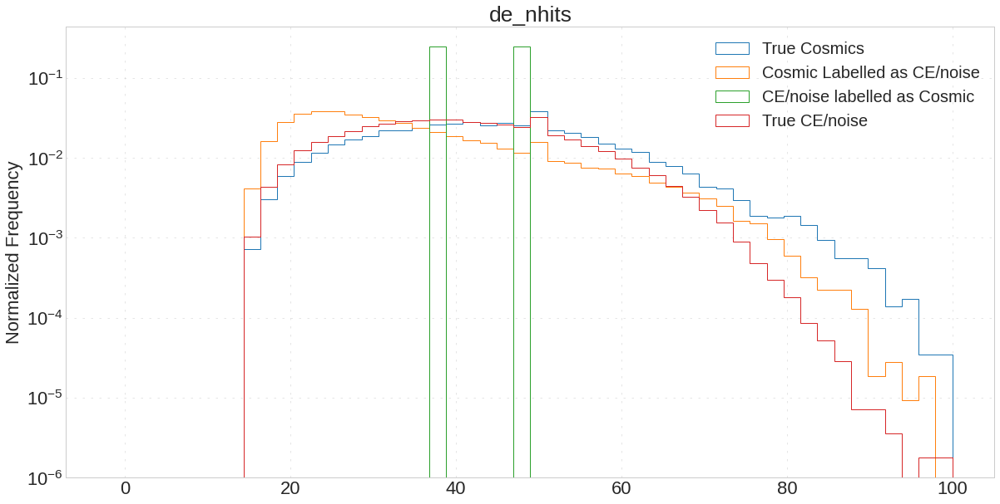

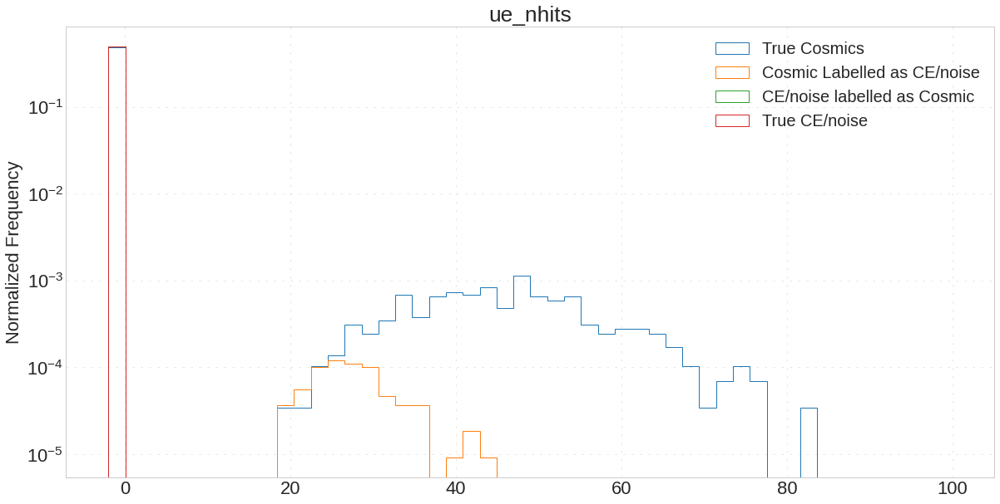

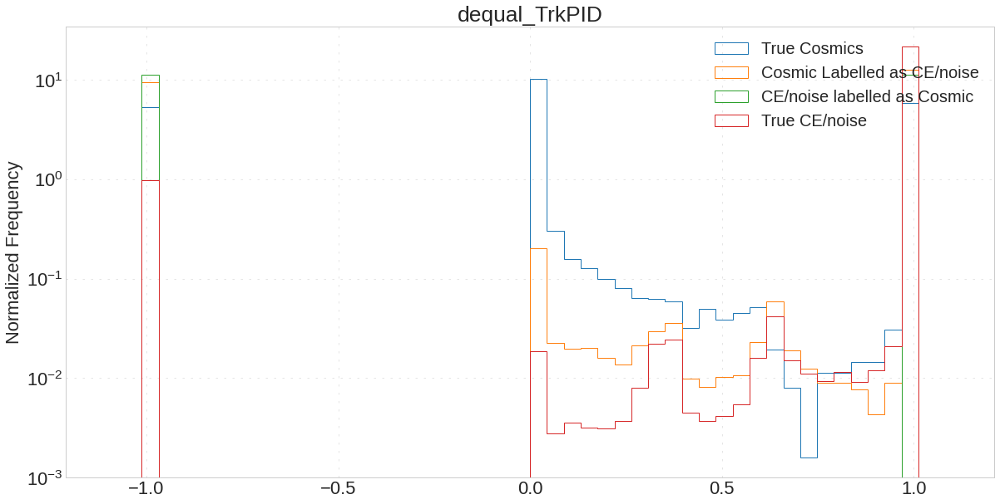

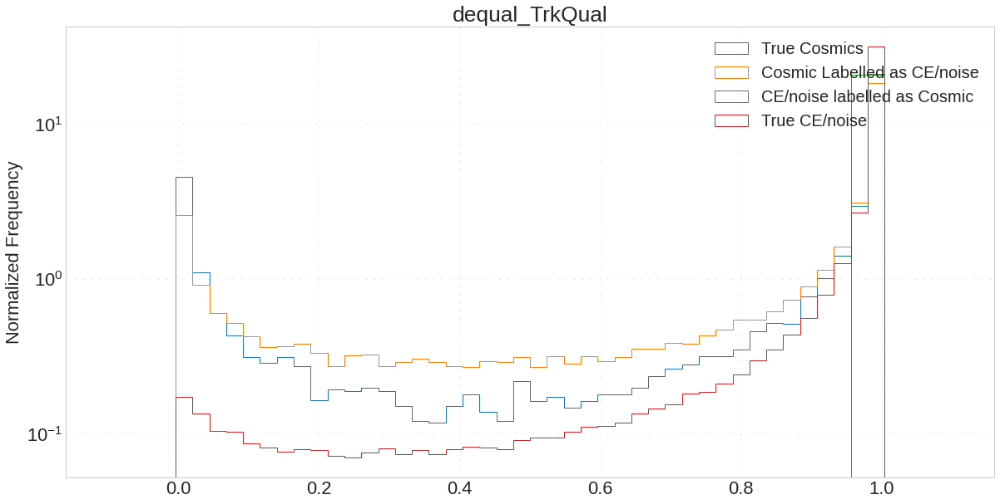

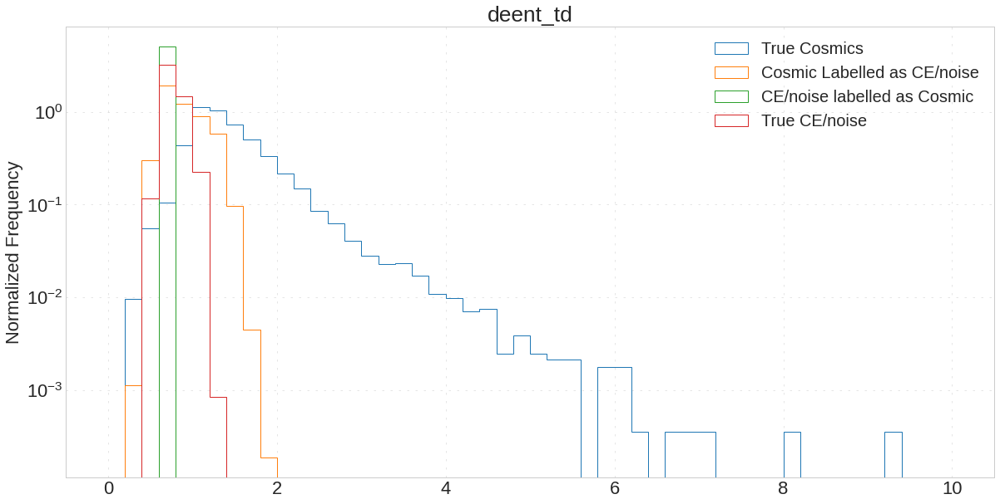

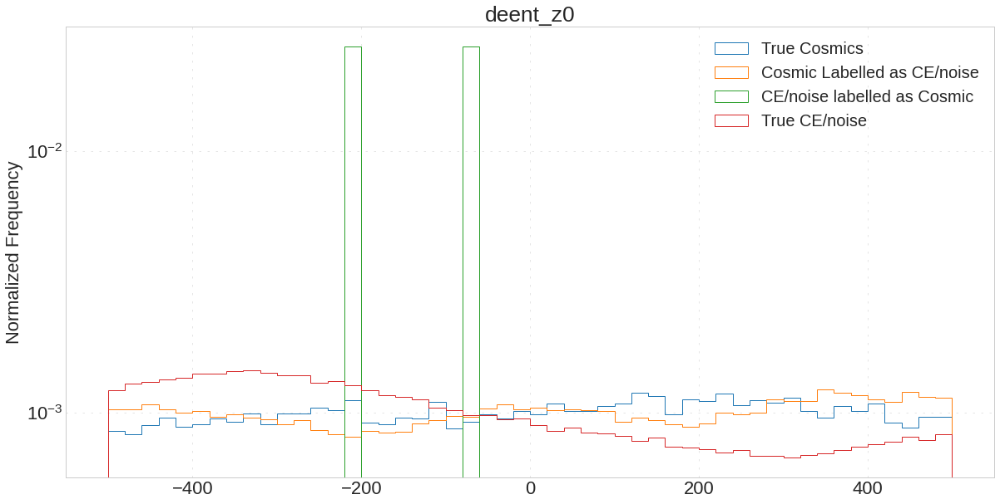

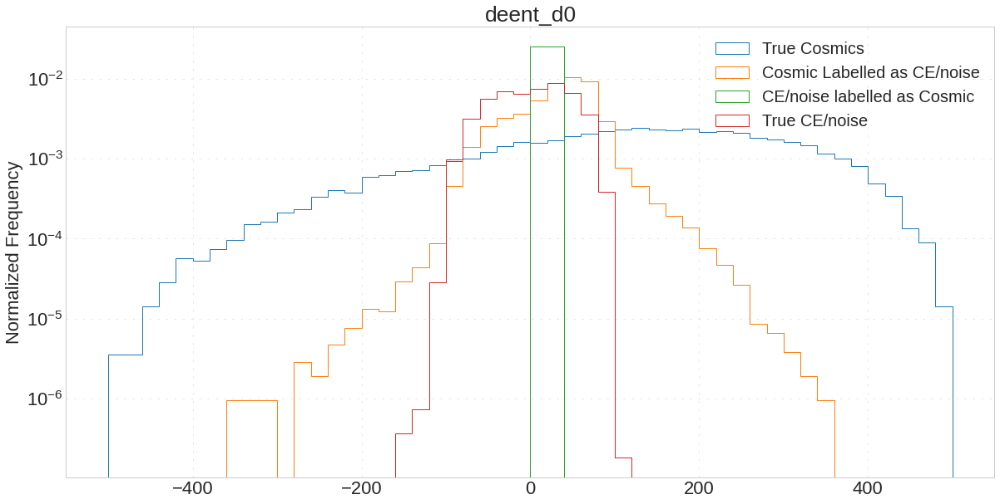

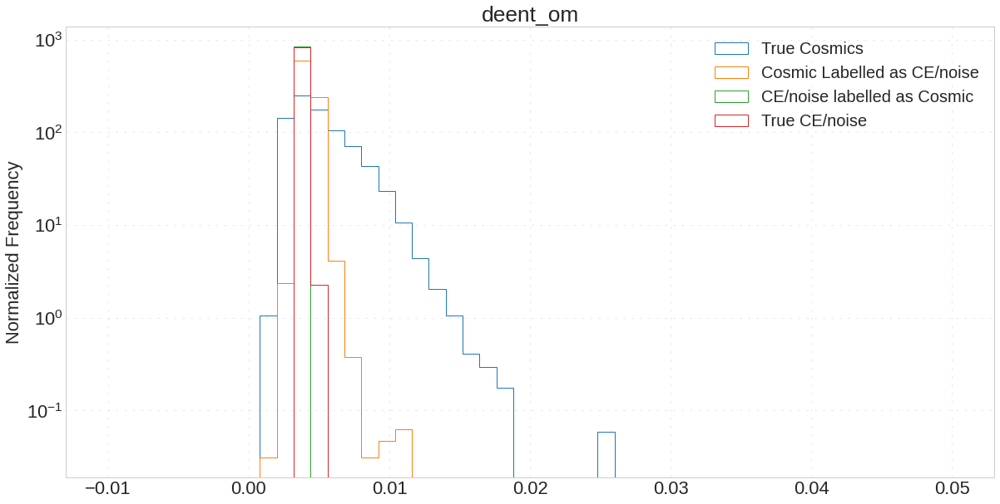

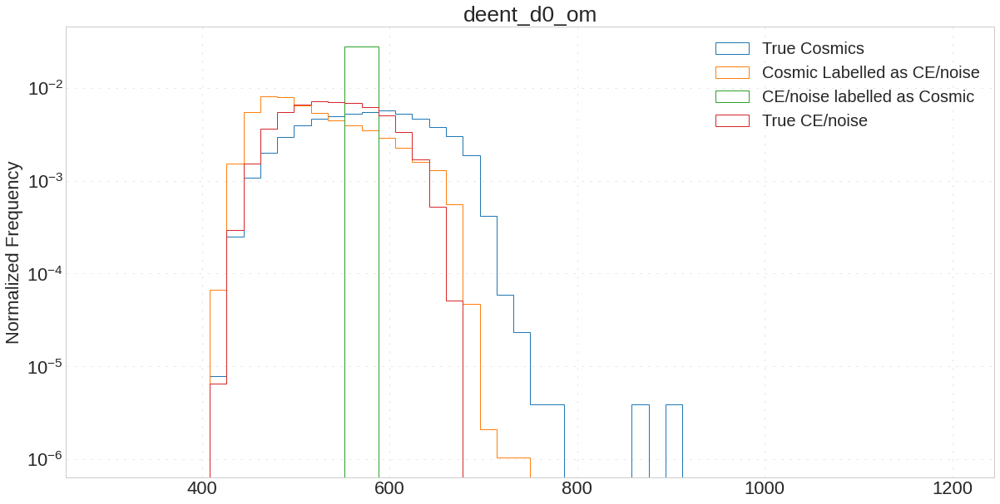

In [ ]:
plainBagel.quadrantDistribution(50)

In [ ]:
with open(main_path+"Saved_Data/noCoincidencesData.pkl", "wb+") as f:
  pickle.dump([plainBagel.avg_predictions, plainBagel.rounded_predictions, plainBagel.conf_matrix, plainBagel.matrix_errors, plainBagel.predictions], f)

#Model for Events Outside the CRV - Architecture Test

In [ ]:
plainBagel2 = MLAnalyzer(noCRV_noMom_variables_list, noCRV_X_train, noCRV_y_train, noCRV_X_val, noCRV_y_val, no_CRV_X_test, no_CRV_y_test)

In [ ]:
plainBagel2.trainModel(widthMultiplier=8/3,depth=10,batch=10, epoch=300)

INFO:weightwatcher:

python      version 3.7.11 (default, Jul  3 2021, 18:01:19) 
[GCC 7.5.0]
numpy       version 1.19.5
tensforflow version 2.5.0
keras       version 2.5.0
INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>


fitting model with width= 24 	depth= 12 	size= 10000
298 total neurons
Epoch 1/300


INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.8366824783013858
102/102 [==============================] - 12s 86ms/step - loss: 0.4932 - accuracy: 0.9001 - val_loss: 0.1070 - val_accuracy: 0.9571


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 2/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.4842183245078844
102/102 [==============================] - 8s 77ms/step - loss: 0.0859 - accuracy: 0.9581 - val_loss: 0.0569 - val_accuracy: 0.9582


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 3/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.322743587189127
102/102 [==============================] - 8s 76ms/step - loss: 0.0490 - accuracy: 0.9733 - val_loss: 0.0307 - val_accuracy: 0.9903


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 4/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.259007720789022
102/102 [==============================] - 8s 77ms/step - loss: 0.0286 - accuracy: 0.9911 - val_loss: 0.0236 - val_accuracy: 0.9928


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 5/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.1704965017990183
102/102 [==============================] - 9s 77ms/step - loss: 0.0224 - accuracy: 0.9937 - val_loss: 0.0206 - val_accuracy: 0.9951


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 6/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 3.0310229801916915
102/102 [==============================] - 8s 77ms/step - loss: 0.0197 - accuracy: 0.9953 - val_loss: 0.0183 - val_accuracy: 0.9958


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 7/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.994839245449837
102/102 [==============================] - 9s 77ms/step - loss: 0.0175 - accuracy: 0.9959 - val_loss: 0.0171 - val_accuracy: 0.9961


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 8/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.9327786029825664
102/102 [==============================] - 8s 77ms/step - loss: 0.0171 - accuracy: 0.9963 - val_loss: 0.0162 - val_accuracy: 0.9964


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 9/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.7757628225298823
102/102 [==============================] - 8s 77ms/step - loss: 0.0159 - accuracy: 0.9965 - val_loss: 0.0152 - val_accuracy: 0.9967


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 10/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.7676304701384242
102/102 [==============================] - 9s 80ms/step - loss: 0.0156 - accuracy: 0.9965 - val_loss: 0.0147 - val_accuracy: 0.9968


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 11/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.7458509655901775
102/102 [==============================] - 9s 79ms/step - loss: 0.0150 - accuracy: 0.9966 - val_loss: 0.0137 - val_accuracy: 0.9969


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 12/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5630415616723843
102/102 [==============================] - 9s 78ms/step - loss: 0.0143 - accuracy: 0.9969 - val_loss: 0.0140 - val_accuracy: 0.9968


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 13/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5546000486735467
102/102 [==============================] - 9s 79ms/step - loss: 0.0137 - accuracy: 0.9969 - val_loss: 0.0135 - val_accuracy: 0.9969


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 14/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5572185261862965
102/102 [==============================] - 9s 79ms/step - loss: 0.0135 - accuracy: 0.9970 - val_loss: 0.0130 - val_accuracy: 0.9969


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 15/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5603632730917085
102/102 [==============================] - 9s 79ms/step - loss: 0.0137 - accuracy: 0.9969 - val_loss: 0.0129 - val_accuracy: 0.9970


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 16/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.531277574607993
102/102 [==============================] - 9s 79ms/step - loss: 0.0129 - accuracy: 0.9971 - val_loss: 0.0125 - val_accuracy: 0.9970


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 17/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5264786361131972
102/102 [==============================] - 9s 80ms/step - loss: 0.0123 - accuracy: 0.9971 - val_loss: 0.0120 - val_accuracy: 0.9971


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 18/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.602613556433585
102/102 [==============================] - 9s 78ms/step - loss: 0.0126 - accuracy: 0.9971 - val_loss: 0.0115 - val_accuracy: 0.9973


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 19/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.6073302871523736
102/102 [==============================] - 9s 81ms/step - loss: 0.0117 - accuracy: 0.9973 - val_loss: 0.0117 - val_accuracy: 0.9972


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 20/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.566933400178603
102/102 [==============================] - 9s 84ms/step - loss: 0.0118 - accuracy: 0.9973 - val_loss: 0.0114 - val_accuracy: 0.9973


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 21/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.591189759186054
102/102 [==============================] - 10s 88ms/step - loss: 0.0112 - accuracy: 0.9974 - val_loss: 0.0111 - val_accuracy: 0.9973


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 22/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5873792068436803
102/102 [==============================] - 10s 89ms/step - loss: 0.0115 - accuracy: 0.9973 - val_loss: 0.0110 - val_accuracy: 0.9973


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 23/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.556155440005672
102/102 [==============================] - 10s 88ms/step - loss: 0.0113 - accuracy: 0.9973 - val_loss: 0.0108 - val_accuracy: 0.9974


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 24/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5462510830070166
102/102 [==============================] - 10s 90ms/step - loss: 0.0108 - accuracy: 0.9974 - val_loss: 0.0107 - val_accuracy: 0.9973


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 25/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5663287149758025
102/102 [==============================] - 10s 89ms/step - loss: 0.0107 - accuracy: 0.9974 - val_loss: 0.0105 - val_accuracy: 0.9974


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 26/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5480237824992744
102/102 [==============================] - 10s 89ms/step - loss: 0.0101 - accuracy: 0.9975 - val_loss: 0.0105 - val_accuracy: 0.9974


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 27/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.582695145463687
102/102 [==============================] - 10s 91ms/step - loss: 0.0105 - accuracy: 0.9974 - val_loss: 0.0106 - val_accuracy: 0.9974


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 28/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.5634204350979686
102/102 [==============================] - 10s 90ms/step - loss: 0.0099 - accuracy: 0.9975 - val_loss: 0.0100 - val_accuracy: 0.9975


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 29/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4378150014604154
102/102 [==============================] - 10s 90ms/step - loss: 0.0098 - accuracy: 0.9975 - val_loss: 0.0099 - val_accuracy: 0.9974


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 30/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.439610360329438
102/102 [==============================] - 10s 92ms/step - loss: 0.0097 - accuracy: 0.9976 - val_loss: 0.0097 - val_accuracy: 0.9975


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 31/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.500104881646766
102/102 [==============================] - 10s 91ms/step - loss: 0.0098 - accuracy: 0.9974 - val_loss: 0.0097 - val_accuracy: 0.9975


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 32/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.407866412449421
102/102 [==============================] - 10s 90ms/step - loss: 0.0099 - accuracy: 0.9975 - val_loss: 0.0095 - val_accuracy: 0.9975


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 33/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.410553754039976
102/102 [==============================] - 10s 91ms/step - loss: 0.0096 - accuracy: 0.9975 - val_loss: 0.0095 - val_accuracy: 0.9975


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 34/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.4095706187229564
102/102 [==============================] - 10s 92ms/step - loss: 0.0093 - accuracy: 0.9976 - val_loss: 0.0092 - val_accuracy: 0.9975


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 35/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.411692669077899
102/102 [==============================] - 10s 91ms/step - loss: 0.0094 - accuracy: 0.9975 - val_loss: 0.0090 - val_accuracy: 0.9976


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 36/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3752263017548043
102/102 [==============================] - 10s 92ms/step - loss: 0.0094 - accuracy: 0.9975 - val_loss: 0.0089 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 37/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3273855309944755
102/102 [==============================] - 10s 91ms/step - loss: 0.0091 - accuracy: 0.9976 - val_loss: 0.0092 - val_accuracy: 0.9975


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 38/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.370620232109792
102/102 [==============================] - 10s 90ms/step - loss: 0.0091 - accuracy: 0.9976 - val_loss: 0.0089 - val_accuracy: 0.9976


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 39/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.283122728559896
102/102 [==============================] - 10s 90ms/step - loss: 0.0088 - accuracy: 0.9976 - val_loss: 0.0090 - val_accuracy: 0.9976


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 40/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2784900826729166
102/102 [==============================] - 10s 91ms/step - loss: 0.0086 - accuracy: 0.9976 - val_loss: 0.0087 - val_accuracy: 0.9976


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 41/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3306746250563033
102/102 [==============================] - 10s 88ms/step - loss: 0.0090 - accuracy: 0.9976 - val_loss: 0.0089 - val_accuracy: 0.9975


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 42/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.353427692334136
102/102 [==============================] - 10s 89ms/step - loss: 0.0087 - accuracy: 0.9976 - val_loss: 0.0085 - val_accuracy: 0.9976


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 43/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.310307598258563
102/102 [==============================] - 10s 89ms/step - loss: 0.0085 - accuracy: 0.9976 - val_loss: 0.0086 - val_accuracy: 0.9976


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 44/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.342644615864009
102/102 [==============================] - 10s 90ms/step - loss: 0.0082 - accuracy: 0.9976 - val_loss: 0.0086 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 45/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3060490354670735
102/102 [==============================] - 10s 90ms/step - loss: 0.0085 - accuracy: 0.9976 - val_loss: 0.0082 - val_accuracy: 0.9976


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 46/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3142125112152585
102/102 [==============================] - 10s 92ms/step - loss: 0.0085 - accuracy: 0.9977 - val_loss: 0.0085 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 47/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.3422932253761934
102/102 [==============================] - 10s 90ms/step - loss: 0.0083 - accuracy: 0.9977 - val_loss: 0.0082 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 48/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.305726365160206
102/102 [==============================] - 10s 93ms/step - loss: 0.0083 - accuracy: 0.9977 - val_loss: 0.0081 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 49/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2541812586493495
102/102 [==============================] - 10s 91ms/step - loss: 0.0081 - accuracy: 0.9977 - val_loss: 0.0083 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 50/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2882135226169353
102/102 [==============================] - 10s 90ms/step - loss: 0.0083 - accuracy: 0.9977 - val_loss: 0.0081 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 51/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.283297139151572
102/102 [==============================] - 10s 90ms/step - loss: 0.0082 - accuracy: 0.9976 - val_loss: 0.0080 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 52/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.290094346134102
102/102 [==============================] - 10s 91ms/step - loss: 0.0080 - accuracy: 0.9977 - val_loss: 0.0079 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 53/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2634744349970783
102/102 [==============================] - 10s 91ms/step - loss: 0.0084 - accuracy: 0.9976 - val_loss: 0.0081 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 54/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.314407002323375
102/102 [==============================] - 10s 92ms/step - loss: 0.0081 - accuracy: 0.9977 - val_loss: 0.0078 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 55/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.288172741314421
102/102 [==============================] - 10s 92ms/step - loss: 0.0079 - accuracy: 0.9978 - val_loss: 0.0080 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 56/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.295012821641277
102/102 [==============================] - 10s 91ms/step - loss: 0.0080 - accuracy: 0.9976 - val_loss: 0.0081 - val_accuracy: 0.9976


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 57/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2469643941617217
102/102 [==============================] - 10s 91ms/step - loss: 0.0080 - accuracy: 0.9977 - val_loss: 0.0078 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 58/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2602216226291665
102/102 [==============================] - 10s 91ms/step - loss: 0.0081 - accuracy: 0.9977 - val_loss: 0.0083 - val_accuracy: 0.9976


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 59/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2505472456891225
102/102 [==============================] - 10s 89ms/step - loss: 0.0081 - accuracy: 0.9977 - val_loss: 0.0077 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 60/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2451805466048373
102/102 [==============================] - 10s 90ms/step - loss: 0.0078 - accuracy: 0.9977 - val_loss: 0.0078 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 61/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.242872746492987
102/102 [==============================] - 10s 91ms/step - loss: 0.0079 - accuracy: 0.9976 - val_loss: 0.0077 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 62/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2403283088737713
102/102 [==============================] - 10s 91ms/step - loss: 0.0080 - accuracy: 0.9976 - val_loss: 0.0077 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 63/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2339864369965525
102/102 [==============================] - 10s 91ms/step - loss: 0.0078 - accuracy: 0.9978 - val_loss: 0.0076 - val_accuracy: 0.9976


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 64/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2010650901362454
102/102 [==============================] - 10s 94ms/step - loss: 0.0077 - accuracy: 0.9978 - val_loss: 0.0077 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 65/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2350946797817186
102/102 [==============================] - 10s 90ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0075 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 66/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2297425951232146
102/102 [==============================] - 10s 92ms/step - loss: 0.0076 - accuracy: 0.9977 - val_loss: 0.0078 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 67/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.229747477314548
102/102 [==============================] - 10s 93ms/step - loss: 0.0074 - accuracy: 0.9978 - val_loss: 0.0076 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 68/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.204669789239872
102/102 [==============================] - 10s 91ms/step - loss: 0.0078 - accuracy: 0.9978 - val_loss: 0.0076 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 69/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.245108331883204
102/102 [==============================] - 10s 91ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0078 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 70/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.241613992888436
102/102 [==============================] - 10s 94ms/step - loss: 0.0077 - accuracy: 0.9977 - val_loss: 0.0075 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 71/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2361008895991494
102/102 [==============================] - 10s 90ms/step - loss: 0.0076 - accuracy: 0.9978 - val_loss: 0.0075 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 72/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2436220653676213
102/102 [==============================] - 10s 90ms/step - loss: 0.0078 - accuracy: 0.9977 - val_loss: 0.0077 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 73/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2405322276754713
102/102 [==============================] - 10s 92ms/step - loss: 0.0076 - accuracy: 0.9978 - val_loss: 0.0078 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 74/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.242217545786731
102/102 [==============================] - 10s 91ms/step - loss: 0.0077 - accuracy: 0.9978 - val_loss: 0.0076 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 75/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2423352135906707
102/102 [==============================] - 10s 91ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0076 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 76/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.241522601343164
102/102 [==============================] - 10s 93ms/step - loss: 0.0076 - accuracy: 0.9977 - val_loss: 0.0075 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 77/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2296946769815738
102/102 [==============================] - 10s 92ms/step - loss: 0.0074 - accuracy: 0.9978 - val_loss: 0.0076 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 78/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.227215195958476
102/102 [==============================] - 10s 91ms/step - loss: 0.0076 - accuracy: 0.9977 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 79/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2225427146196726
102/102 [==============================] - 10s 94ms/step - loss: 0.0076 - accuracy: 0.9978 - val_loss: 0.0076 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 80/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.217672580107133
102/102 [==============================] - 10s 92ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 81/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2547999335872047
102/102 [==============================] - 10s 91ms/step - loss: 0.0074 - accuracy: 0.9978 - val_loss: 0.0074 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 82/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2503897823933525
102/102 [==============================] - 10s 92ms/step - loss: 0.0077 - accuracy: 0.9976 - val_loss: 0.0075 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 83/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2494650716279216
102/102 [==============================] - 10s 90ms/step - loss: 0.0074 - accuracy: 0.9978 - val_loss: 0.0075 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 84/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2400327513947427
102/102 [==============================] - 10s 91ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0076 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 85/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2025350922243234
102/102 [==============================] - 10s 92ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.0074 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 86/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2330645817647827
102/102 [==============================] - 10s 91ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0076 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 87/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2303428461785946
102/102 [==============================] - 10s 89ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 88/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2374939564049128
102/102 [==============================] - 10s 91ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 89/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2388004359505875
102/102 [==============================] - 10s 89ms/step - loss: 0.0073 - accuracy: 0.9979 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 90/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2043702293069893
102/102 [==============================] - 10s 89ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 91/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1993981895322885
102/102 [==============================] - 10s 90ms/step - loss: 0.0072 - accuracy: 0.9978 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 92/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2127386819819157
102/102 [==============================] - 10s 91ms/step - loss: 0.0072 - accuracy: 0.9979 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 93/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.205678259035499
102/102 [==============================] - 10s 92ms/step - loss: 0.0074 - accuracy: 0.9979 - val_loss: 0.0075 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 94/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2182569283669507
102/102 [==============================] - 10s 92ms/step - loss: 0.0076 - accuracy: 0.9977 - val_loss: 0.0075 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 95/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2208661066394235
102/102 [==============================] - 10s 91ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 96/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.218482120223711
102/102 [==============================] - 10s 92ms/step - loss: 0.0072 - accuracy: 0.9979 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 97/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2110426348793535
102/102 [==============================] - 10s 92ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 98/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2229863907282073
102/102 [==============================] - 10s 91ms/step - loss: 0.0073 - accuracy: 0.9977 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 99/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.219408711489173
102/102 [==============================] - 10s 90ms/step - loss: 0.0074 - accuracy: 0.9977 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 100/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2192547339575097
102/102 [==============================] - 10s 92ms/step - loss: 0.0075 - accuracy: 0.9978 - val_loss: 0.0073 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 101/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1984634533546785
102/102 [==============================] - 10s 90ms/step - loss: 0.0074 - accuracy: 0.9978 - val_loss: 0.0074 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 102/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.198419212038987
102/102 [==============================] - 10s 90ms/step - loss: 0.0071 - accuracy: 0.9978 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 103/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.186011134343476
102/102 [==============================] - 10s 90ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 104/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2190184545190803
102/102 [==============================] - 10s 90ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 105/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.203162299790305
102/102 [==============================] - 10s 90ms/step - loss: 0.0074 - accuracy: 0.9978 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 106/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.190086913516161
102/102 [==============================] - 10s 91ms/step - loss: 0.0071 - accuracy: 0.9978 - val_loss: 0.0073 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 107/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.188348833489512
102/102 [==============================] - 10s 90ms/step - loss: 0.0068 - accuracy: 0.9980 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 108/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.187095820089131
102/102 [==============================] - 10s 89ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0073 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 109/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2055621041553435
102/102 [==============================] - 10s 90ms/step - loss: 0.0071 - accuracy: 0.9978 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 110/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.228033557494471
102/102 [==============================] - 10s 92ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0071 - val_accuracy: 0.9977


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 111/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1993678138736033
102/102 [==============================] - 10s 89ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 112/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1694361851650728
102/102 [==============================] - 10s 91ms/step - loss: 0.0072 - accuracy: 0.9978 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 113/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.179938400076281
102/102 [==============================] - 10s 90ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 114/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.195047120875152
102/102 [==============================] - 10s 90ms/step - loss: 0.0072 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 115/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.2119012382616607
102/102 [==============================] - 10s 91ms/step - loss: 0.0072 - accuracy: 0.9978 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 116/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.191374386376382
102/102 [==============================] - 10s 90ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 117/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1876157260773588
102/102 [==============================] - 10s 90ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.0072 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 118/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.183595226623859
102/102 [==============================] - 10s 93ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 119/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1919759409560964
102/102 [==============================] - 10s 92ms/step - loss: 0.0069 - accuracy: 0.9980 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 120/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.186501992467333
102/102 [==============================] - 10s 92ms/step - loss: 0.0071 - accuracy: 0.9978 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 121/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.17760798690288
102/102 [==============================] - 10s 93ms/step - loss: 0.0070 - accuracy: 0.9979 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 122/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.171875634623838
102/102 [==============================] - 10s 93ms/step - loss: 0.0069 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>


Epoch 123/300


INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.10935124994443
102/102 [==============================] - 10s 93ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 124/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1225074035172415
102/102 [==============================] - 10s 95ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0074 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 125/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.128733754369712
102/102 [==============================] - 10s 95ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 126/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.0878140832928693
102/102 [==============================] - 10s 91ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 127/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.091960378032568
102/102 [==============================] - 10s 94ms/step - loss: 0.0072 - accuracy: 0.9979 - val_loss: 0.0072 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 128/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1212027356724716
102/102 [==============================] - 10s 93ms/step - loss: 0.0073 - accuracy: 0.9977 - val_loss: 0.0071 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 129/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.0726714693824806
102/102 [==============================] - 10s 92ms/step - loss: 0.0070 - accuracy: 0.9978 - val_loss: 0.0071 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 130/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.105853651053717
102/102 [==============================] - 10s 94ms/step - loss: 0.0070 - accuracy: 0.9980 - val_loss: 0.0069 - val_accuracy: 0.9980


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 131/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.0976568341947166
102/102 [==============================] - 10s 91ms/step - loss: 0.0072 - accuracy: 0.9979 - val_loss: 0.0073 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 132/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.087329721254462
102/102 [==============================] - 10s 92ms/step - loss: 0.0073 - accuracy: 0.9977 - val_loss: 0.0072 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 133/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1238158595752066
102/102 [==============================] - 10s 94ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.0072 - val_accuracy: 0.9978


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 134/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.1194947321280484
102/102 [==============================] - 10s 93ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 135/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.0730280636810847
102/102 [==============================] - 10s 91ms/step - loss: 0.0071 - accuracy: 0.9978 - val_loss: 0.0070 - val_accuracy: 0.9979


INFO:weightwatcher:params {'glorot_fix': False, 'normalize': False, 'conv2d_norm': True, 'randomize': False, 'savefig': False, 'rescale': True, 'deltas': False, 'min_evals': 0, 'max_evals': None, 'plot': False, 'mp_fit': False, 'ww2x': False, 'deltaEs': False}
INFO:weightwatcher:LAYER: 0 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 1 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 3 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 5 2  : <class 'keras.layers.core.Dense'>


Epoch 136/300


INFO:weightwatcher:LAYER: 7 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 9 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 11 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 13 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 15 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 17 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 19 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 21 2  : <class 'keras.layers.core.Dense'>
INFO:weightwatcher:LAYER: 22 2  : <class 'keras.layers.core.Dense'>
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


Current alpha value of 2.041138817413764
102/102 [==============================] - 2s 12ms/step - loss: 0.0057 - accuracy: 0.9984 - val_loss: 0.0070 - val_accuracy: 0.9979


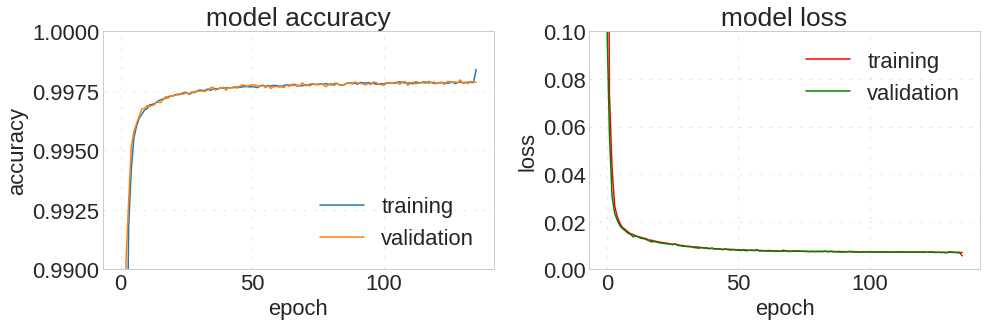

In [ ]:
plainBagel2.plotAcc()

In [ ]:
plainBagel2.predictMC(100)

10595/10595 [==============================] - 15s 1ms/step
iteration 1 done
10595/10595 [==============================] - 14s 1ms/step
iteration 2 done
10595/10595 [==============================] - 14s 1ms/step
iteration 3 done
10595/10595 [==============================] - 14s 1ms/step
iteration 4 done
10595/10595 [==============================] - 14s 1ms/step
iteration 5 done
10595/10595 [==============================] - 14s 1ms/step
iteration 6 done
10595/10595 [==============================] - 14s 1ms/step
iteration 7 done
10595/10595 [==============================] - 14s 1ms/step
iteration 8 done
10595/10595 [==============================] - 14s 1ms/step
iteration 9 done
10595/10595 [==============================] - 14s 1ms/step
iteration 10 done
10595/10595 [==============================] - 14s 1ms/step
iteration 11 done
10595/10595 [==============================] - 14s 1ms/step
iteration 12 done
10595/10595 [==============================] - 15s 1ms/step
iteration 13 

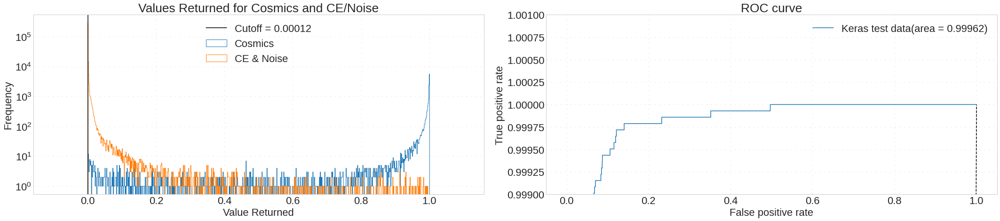

In [ ]:
plainBagel2.cutoffTime()

In [ ]:
plainBagel2.finalConfusion()

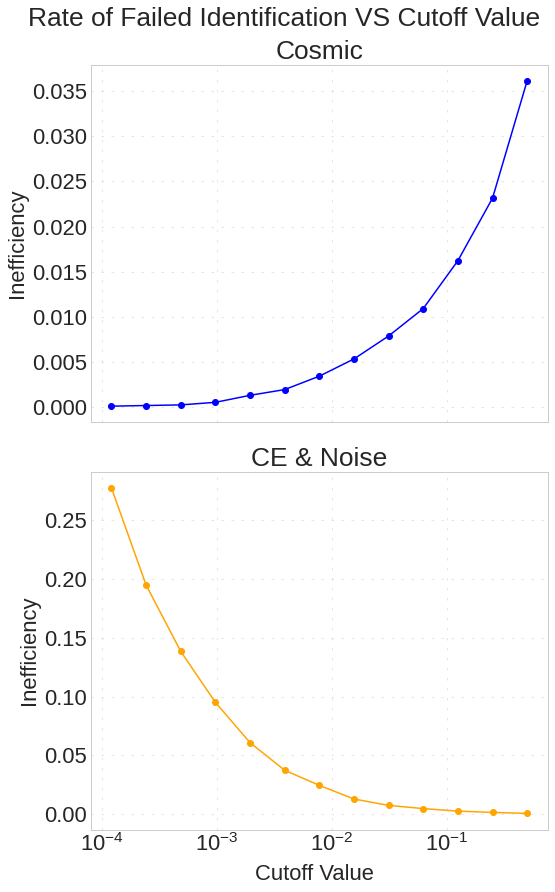

In [ ]:
plainBagel2.cutoffPlot()

In [ ]:
plainBagel2.errorPlot()

#Overall Data

In [ ]:
def cutoffTime(yTest, prediction, predefinedcutoff = False):
    rejectionList = []
    ceList = []
    def cutoffScanner(ytest, prediction, upper, lower, counter=0): #Defined within function so that global variable can be used
      divider = (upper + lower)/2
      rounded = np.where(prediction < divider, 0, 1)
      confusion = confusion_matrix(ytest, rounded, normalize='true');
      rejectionList.append((divider, 1 - confusion[1][1]))
      ceList.append((divider, 1 - confusion[0][0]))

      if divider < 0.0001 or divider > 1-0.0001:
        print("Mission failed, we'll get em next time. Closest cutoff found of: ", divider)
        return divider, confusion_matrix(ytest, rounded), rounded, confusion

      elif (round(confusion[1][1],4) == 0.999999):
        # print("Cutoff found of: ", divider)
        return divider, confusion_matrix(ytest, rounded), rounded, confusion

      elif round(confusion[1][1],4) > 0.999999:
        if counter > 10:
          print("counter reached!")
          return divider, confusion_matrix(ytest, rounded), rounded, confusion

        return cutoffScanner(ytest, prediction, upper, divider, counter + 1)

      else:
        return cutoffScanner(ytest, prediction, divider, lower, counter)

    def outputHisto(prediction, ytest, cutoff):
      fig, ax = plt.subplots(1,2, figsize=(30,7))


      ax[0].hist(prediction[ytest==1], range=(-0.1,1.1), bins=1000, histtype='step', label='Cosmics');
      ax[0].hist(prediction[ytest==0], range=(-0.1,1.1), bins=1000, histtype='step', label='CE & Noise');
      ax[0].axvline(cutoff, label="Cutoff = " + str(round(cutoff, 5)), color='black')
      ax[0].set_yscale('log');
      ax[0].legend(loc='upper center');

      fpr_keras, tpr_keras, thresholds_keras = roc_curve(ytest, prediction);
      auc_keras = auc(fpr_keras, tpr_keras);
      ax[1].plot([0, 1], [0, 1], 'k--');
      ax[1].plot(fpr_keras, tpr_keras, label='Keras test data(area = {:.5f})'.format(auc_keras));
      ax[1].set_xlabel('False positive rate');
      ax[1].set_ylabel('True positive rate');
      ax[1].set_title('ROC curve');
      ax[1].set_ylim(0.999,1.001);
      # ax[1].set_yscale('log');
      ax[1].legend();

      ax[0].set_title("Values Returned for Cosmics and CE/Noise");
      ax[0].set_xlabel("Value Returned");
      ax[0].set_ylabel("Frequency");

    def confusionmatrix(eff, percentage, cutoff):
      plt.figure(figsize=(10,7))
      
      annotStr = annot=np.array([[str(round(eff[0][0])) + '\n(' + str(round(percentage[0][0],5)) + ')', str(round(eff[0][1])) + '\n(' + str(round(percentage[0][1],5)) + ')'], [str(round(eff[1][0])) + '\n(' + str(round(percentage[1][0],5)) + ')', str(round(eff[1][1])) + '\n(' + str(round(percentage[1][1],5)) + ')']])

      ax = sns.heatmap(percentage, annot=annotStr, xticklabels=["CE + Noise", "cosmic"], yticklabels=["CE + Noise", "cosmic"], fmt='.18s', cbar_kws={'label': 'Fraction of Events'});
      
      ax.set(title="Confusion Matrix with Cutoff at " + str(round(cutoff, 5)),
            xlabel="Predicted Label",
            ylabel="True Label",);

    cutoff, effs, rounded_predictions, percentages = (None,None,None,None)
    predictionOrig = prediction
    if not predefinedcutoff:
      cutoff, effs, rounded_predictions, percentages = cutoffScanner(yTest, prediction, 1, 0)
    else:
      cutoff = predefinedcutoff
      rounded_predictions = np.where(prediction < predefinedcutoff, 0, 1)
      effs = confusion_matrix(yTest, rounded_predictions)
      percentages = confusion_matrix(yTest, rounded_predictions, normalize='true')

    # confusionmatrix(effs, percentages, cutoff)
    outputHisto(predictionOrig, yTest, cutoff)
    plt.tight_layout();
    plt.show();

    return rounded_predictions, cutoff

In [ ]:
# fileopener = open(main_path+"Saved_Data/coincidenceData.pkl", "rb")
# CRVavg_predictions, CRVrounded_predictions, CRVconf_matrix, CRVmatrix_errors, CRVpredictions = pickle.load(fileopener)

In [ ]:
# fileopener = open(main_path+"Saved_Data/noCoincidencesData.pkl", "rb")
# noCRVavg_predictions, noCRVrounded_predictions, noCRVconf_matrix, noCRVmatrix_errors, noCRVpredictions = pickle.load(fileopener)

In [ ]:
cinnamonBagel = MLAnalyzer()
cinnamonBagel.load("cinnamonBagel")

In [ ]:
# CoincidenceOverallMOM = pd.DataFrame(CRV_X_test_df)
# CoincidenceOverallMOM['is_cosmic'] = CRV_y_test
# CoincidenceOverallMOM = CoincidenceOverallMOM.query(cut_extmom_orig)

# CoincidenceOverallMOM[list(dTZPE_noMom_variables_list.keys())] = CRVscaler.transform(CoincidenceOverallMOM[list(dTZPE_noMom_variables_list.keys())])
# CoincidenceOverallMOM['Predictions'] = cinnamonBagel.model.predict(CoincidenceOverallMOM[dTZPE_noMom_variables_list])
# CoincidenceOverallMOM[list(dTZPE_noMom_variables_list.keys())] = CRVscaler.inverse_transform(CoincidenceOverallMOM[list(dTZPE_noMom_variables_list.keys())])

INFO:numexpr.utils:NumExpr defaulting to 2 threads.


In [ ]:
CoincidenceOverall = pd.DataFrame(CRV_X_test_df)
CoincidenceOverall['Predictions'] = cinnamonBagel.model.predict(CRV_X_test)
CoincidenceOverall['is_cosmic'] = CRV_y_test

INFO:numexpr.utils:NumExpr defaulting to 2 threads.


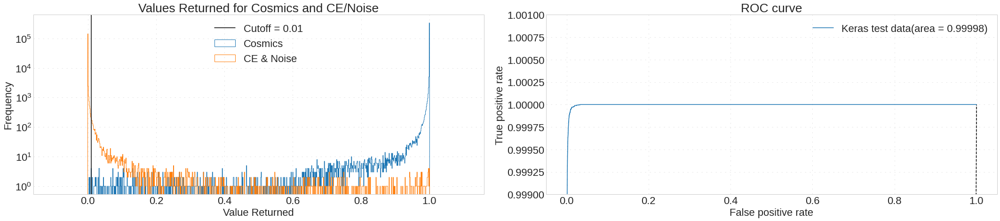

In [ ]:
CoincidenceOverall['Predictions'], coincidenceCutoff = cutoffTime(CoincidenceOverall['is_cosmic'], CoincidenceOverall['Predictions'], predefinedcutoff=0.01)

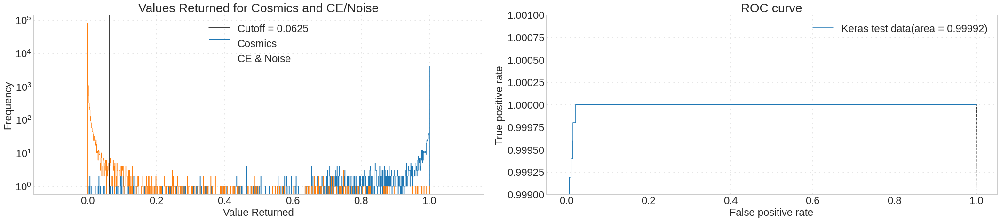

In [ ]:
# CoincidenceOverallMOM['Predictions'], _ = cutoffTime(CoincidenceOverallMOM['is_cosmic'], CoincidenceOverallMOM['Predictions'], predefinedcutoff=coincidenceCutoff)

In [ ]:
CoincidenceOverallCUT = pd.DataFrame(CRV_X_test_df)
CoincidenceOverallCUT['is_cosmic'] = CRV_y_test
CoincidenceOverallCUT = CoincidenceOverallCUT.query(cut_extmom)

CoincidenceOverallCUT[list(dTZPE_noMom_variables_list.keys())] = CRVscaler.transform(CoincidenceOverallCUT[list(dTZPE_noMom_variables_list.keys())])
CoincidenceOverallCUT['Predictions'] = cinnamonBagel.model.predict(CoincidenceOverallCUT[dTZPE_noMom_variables_list])
CoincidenceOverallCUT[list(dTZPE_noMom_variables_list.keys())] = CRVscaler.inverse_transform(CoincidenceOverallCUT[list(dTZPE_noMom_variables_list.keys())])

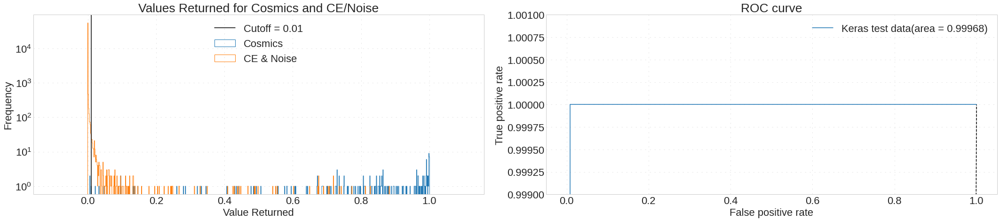

In [ ]:
CoincidenceOverallCUT['Predictions'], _ = cutoffTime(CoincidenceOverallCUT['is_cosmic'], CoincidenceOverallCUT['Predictions'], predefinedcutoff=coincidenceCutoff)

In [ ]:
plainBagel = MLAnalyzer()
plainBagel.load("PlainBagel")

In [ ]:
noCoincidenceOverall = pd.DataFrame(no_CRV_X_test_df)
noCoincidenceOverall['Predictions'] = plainBagel.model.predict(no_CRV_X_test)
noCoincidenceOverall['is_cosmic'] = no_CRV_y_test

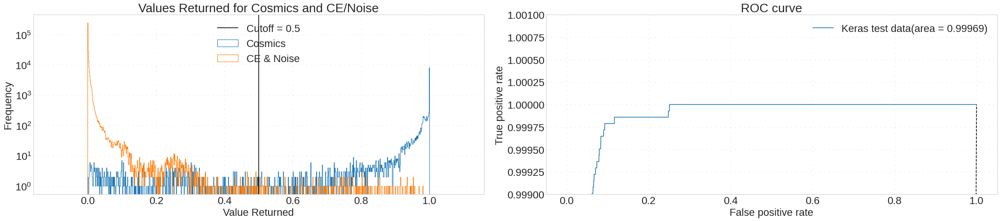

In [ ]:
noCoincidenceOverall['Predictions'], noCoincidenceCutoff = cutoffTime(noCoincidenceOverall['is_cosmic'], noCoincidenceOverall['Predictions'], predefinedcutoff=0.5)

In [ ]:
# noCoincidenceOverallMOM = pd.DataFrame(no_CRV_X_test_df)
# noCoincidenceOverallMOM['is_cosmic'] = no_CRV_y_test
# noCoincidenceOverallMOM = noCoincidenceOverallMOM.query(cut_extmom_orig)

# noCoincidenceOverallMOM[list(noCRV_noMom_variables_list.keys())] = noCRVscaler.transform(noCoincidenceOverallMOM[list(noCRV_noMom_variables_list.keys())])
# noCoincidenceOverallMOM['Predictions'] = plainBagel.model.predict(noCoincidenceOverallMOM[list(noCRV_noMom_variables_list.keys())])
# noCoincidenceOverallMOM[list(noCRV_noMom_variables_list.keys())] = noCRVscaler.inverse_transform(noCoincidenceOverallMOM[list(noCRV_noMom_variables_list.keys())])

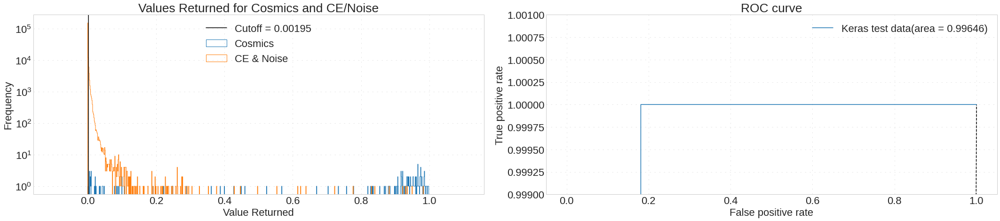

In [ ]:
# noCoincidenceOverallMOM['Predictions'], _ = cutoffTime(noCoincidenceOverallMOM['is_cosmic'], noCoincidenceOverallMOM['Predictions'], predefinedcutoff=noCoincidenceCutoff)

In [ ]:
noCoincidenceOverallCUT = pd.DataFrame(no_CRV_X_test_df)
noCoincidenceOverallCUT['is_cosmic'] = no_CRV_y_test
noCoincidenceOverallCUT = noCoincidenceOverallCUT.query(cut_extmom)

noCoincidenceOverallCUT[list(noCRV_noMom_variables_list.keys())] = noCRVscaler.transform(noCoincidenceOverallCUT[list(noCRV_noMom_variables_list.keys())])
noCoincidenceOverallCUT['Predictions'] = plainBagel.model.predict(noCoincidenceOverallCUT[list(noCRV_noMom_variables_list.keys())])
noCoincidenceOverallCUT[list(noCRV_noMom_variables_list.keys())] = noCRVscaler.inverse_transform(noCoincidenceOverallCUT[list(noCRV_noMom_variables_list.keys())])

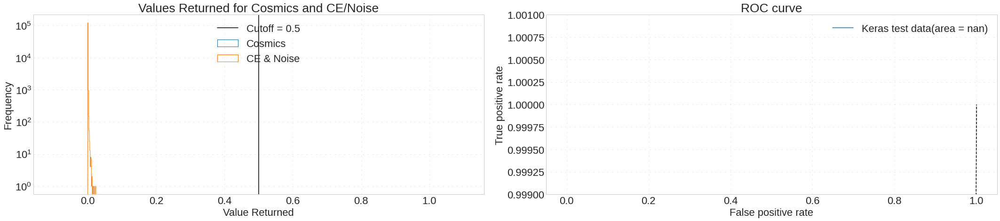

In [ ]:
noCoincidenceOverallCUT['Predictions'], _ = cutoffTime(noCoincidenceOverallCUT['is_cosmic'], noCoincidenceOverallCUT['Predictions'], predefinedcutoff=noCoincidenceCutoff)

In [ ]:
Overall = CoincidenceOverall.append(noCoincidenceOverall).reset_index(drop=True)

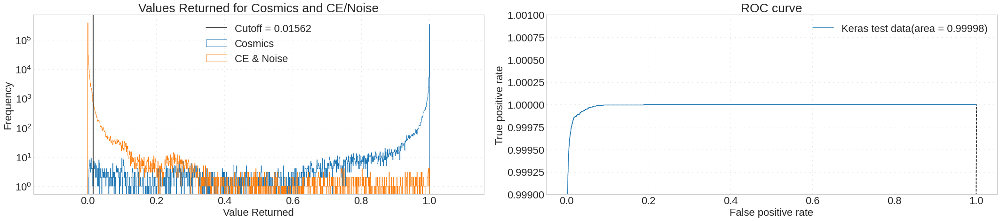

In [ ]:
# Overall['Predictions'], cutoff = cutoffTime(Overall['is_cosmic'], Overall['Predictions'])

In [ ]:
# tempMOM = Overall.query("not + (" + cut_extmom_orig + ")").assign(Predictions=1)
tempCUT = Overall.query("not + (" + cut_extmom + ")").assign(Predictions=1)

In [ ]:
# OverallMOM = CoincidenceOverallMOM.append(noCoincidenceOverallMOM).reset_index(drop=True)
# OverallMOMBig = CoincidenceOverallMOM.append(noCoincidenceOverallMOM).append(tempMOM).reset_index(drop=True)

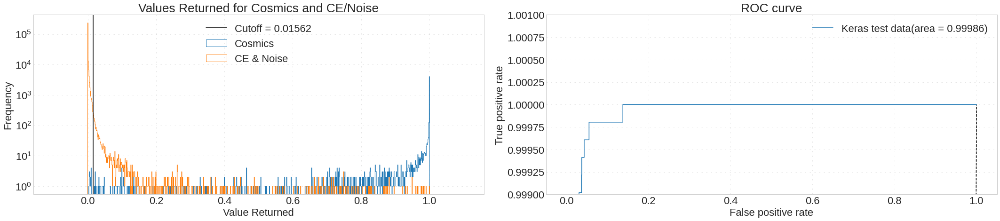

In [ ]:
# OverallMOM['Predictions'], _ = cutoffTime(OverallMOM['is_cosmic'], OverallMOM['Predictions'], predefinedcutoff=cutoff)

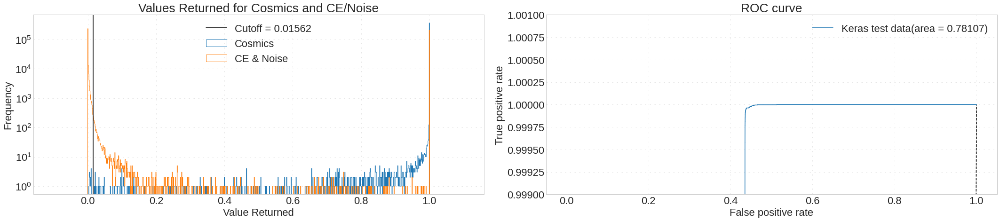

In [ ]:
# OverallMOMBig['Predictions'], _ = cutoffTime(OverallMOMBig['is_cosmic'], OverallMOMBig['Predictions'], predefinedcutoff=cutoff)

In [ ]:
OverallCUT = CoincidenceOverallCUT.append(noCoincidenceOverallCUT).reset_index(drop=True)
OverallCUTBig = CoincidenceOverallCUT.append(noCoincidenceOverallCUT).append(tempCUT).reset_index(drop=True)

In [ ]:
CosmicsThatPassed = OverallCUT.query("(is_cosmic==1) and (Predictions==0)")[["evtinfo__eventid","evtinfo__runid","evtinfo__subrunid", "deent_mom"]].to_numpy() #id, runid, subrunid

In [ ]:
CosmicsThatPassed

array([[1.30037000e+05, 1.00200000e+03, 1.68380000e+04, 1.04227364e+02],
       [3.10135000e+05, 1.00200000e+03, 1.54400000e+04, 1.04691528e+02]])

In [ ]:
CosmicsThatPassedHiLow = pd.DataFrame(data=None, columns=df.columns)
for n,i in enumerate(CosmicsThatPassed):
  found = df.query("(evtinfo__eventid==@i[0]) and (evtinfo__runid==@i[1]) and (evtinfo__subrunid==@i[2]) and (deent_mom==@i[3])")
  CosmicsThatPassedHiLow = CosmicsThatPassedHiLow.append(found)
  if n % 50 == 0:
    print(round(n/len(CosmicsThatPassed)*100),"% there")

0 % there


In [ ]:
CosmicsThatPassedHiLow#.query("is_high==1")["deent_mom"]

,evtinfo__eventid,evtinfo__runid,evtinfo__subrunid,evtinfo__nprotons,de_status,de_alg,de_pdg,de_nhits,de_ndof,de_nactive,de_ndouble,de_ndactive,de_nnullambig,de_nmat,de_nmatactive,de_nbend,de_t0,de_t0err,de_chisq,de_fitcon,de_radlen,de_firstflt,de_lastflt,de_startvalid,de_endvalid,deent_mom,deent_momerr,deent_d0,deent_p0,deent_om,deent_z0,deent_td,deent_d0err,deent_p0err,deent_omerr,deent_z0err,deent_tderr,dequal_nquals,dequal_TrkPID,dequal_TrkPIDCalib,...,ue_radlen,ue_firstflt,ue_lastflt,ue_startvalid,ue_endvalid,crvinfo__crvSectorType,crvinfo__x,crvinfo__y,crvinfo__z,crvinfo__timeWindowStart,crvinfo__timeWindowEnd,crvinfo__PEs,crvinfo__nCoincidenceHits,crvinfomc__valid,crvinfomc__pdgId,crvinfomc__primaryPdgId,crvinfomc__primaryE,crvinfomc__primaryX,crvinfomc__primaryY,crvinfomc__primaryZ,crvinfomc__parentPdgId,crvinfomc__parentE,crvinfomc__parentX,crvinfomc__parentY,crvinfomc__parentZ,crvinfomc__gparentPdgId,crvinfomc__gparentE,crvinfomc__gparentX,crvinfomc__gparentY,crvinfomc__gparentZ,crvinfomc__x,crvinfomc__y,crvinfomc__z,crvinfomc__time,crvinfomc__depositedEnergy,bestcrv,is_high,crvinfo__dT,deent_d0_om,is_triggered
382456,130037,1002,16838,1,1,0,11,27,21,25,11,11,2,31,26,632,787.1,0.3,21.5,0.4,0.0,-2756.5,1314.0,-2769.8,2851.0,104.2,0.2,-47.5,-2.4,0.0,106.8,0.7,1.6,0.0,0.0,3.3,0.0,4,1.0,0.0,...,-1.0,-1.0,-1.0,-999999.0,-999999.0,3.0,-3904.0,2701.6,3972.7,767.9,792.6,232.0,13.0,True,13.0,13.0,2185.2,-7784.2,15365.4,3141.5,13.0,2185.2,-7784.2,15365.4,3141.5,13.0,2185.2,-7784.2,15365.4,3141.5,-4979.9,2761.1,3972.3,723.1,12.2,0.0,0,-19.2,507.7,True
1217583,310135,1002,15440,1,1,1,11,38,33,37,15,14,0,44,43,622,785.8,0.3,28.6,0.6,0.0,-1515.1,1419.9,-1515.1,2834.0,104.7,0.1,83.7,-1.0,0.0,-239.1,1.0,1.4,0.0,0.0,3.2,0.0,4,1.0,0.0,...,-1.0,-1.0,-1.0,-999999.0,-999999.0,3.0,-3904.0,2708.8,1189.9,778.3,806.0,196.0,9.0,True,13.0,13.0,2433.3,-3399.5,15365.4,-7788.0,13.0,2433.3,-3399.5,15365.4,-7788.0,13.0,2433.3,-3399.5,15365.4,-7788.0,-4153.3,2761.1,1147.5,730.2,23.2,0.0,1,-7.4,579.7,True


In [ ]:
for i in all_variables_list:
  plt.hist(CosmicsThatPassedHiLow.query("is_high==1")[i], histtype='step', range=all_variables_list[i], bins=50, label="hi");
  plt.hist(CosmicsThatPassedHiLow.query("is_high==0")[i], histtype='step', range=all_variables_list[i], bins=50, label="lo");
  plt.title("Cosmic Events that Passed ML Alongside Kinematical Cuts " + i);
  plt.legend();
  plt.figure();

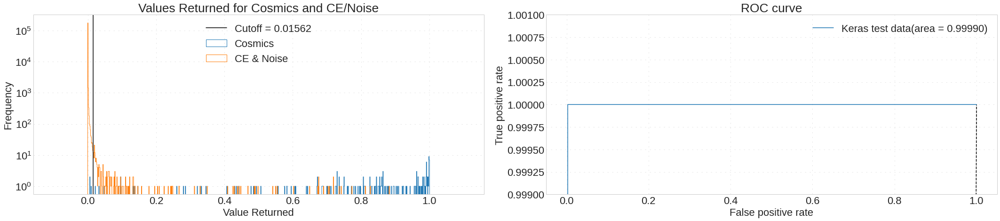

In [ ]:
# OverallCUT['Predictions'], _ = cutoffTime(OverallCUT['is_cosmic'], OverallCUT['Predictions'], predefinedcutoff=cutoff)

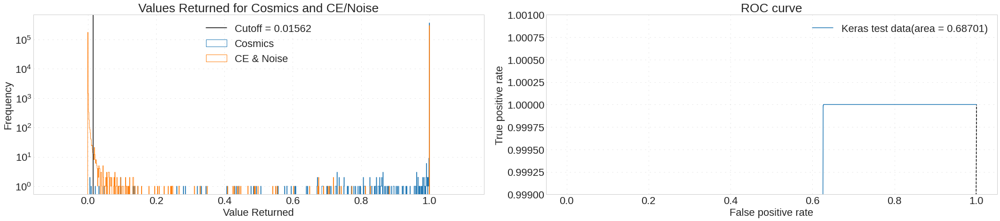

In [ ]:
# OverallCUTBig['Predictions'], _ = cutoffTime(OverallCUTBig['is_cosmic'], OverallCUTBig['Predictions'], predefinedcutoff=cutoff)

In [ ]:
def createCutDistributions(dataframe, OverallMLCuts, plot=False, dense=True): #uses the overall dataframe as the default
  Vetoed = dataframe.query('not (' + cut_extmom + ')')#These are automatically shoved into the cosmic category
  NotVetoed = dataframe.query(cut_extmom)#These are whatever
  
  VetoedCut = None 
  NotVetoedCut = None 

  VetoedCut = OverallMLCuts.query('not (' + crv_time + " & " + cut_extmom+ ')')
  NotVetoedCut = OverallMLCuts.query('(' + crv_time + " & " + cut_extmom+ ')')

  VetoedAssignmentCut = VetoedCut.assign(Predictions=1)
  NotVetoedAssignmentCut = NotVetoedCut.assign(Predictions=0)

  OverallCut = VetoedAssignmentCut.append(NotVetoedAssignmentCut).reset_index(drop=True)
  OverallcutNoCRV = Vetoed.assign(Predictions=1).append(NotVetoed.assign(Predictions=0)).reset_index(drop=True)

  if not plot:
    return dataframe, OverallMLCuts, OverallcutNoCRV, OverallCut

  for var in all_variables_list.keys():
    fig, ax = plt.subplots(1,2, sharey=True, figsize=(25,7));


    ax[0].hist(dataframe.query('(is_cosmic==0) and (Predictions == 0)')[var], range=all_variables_list[var], histtype='step', bins=50, label="ML-Based Veto w/o Kinematical Cuts", density=dense);
    # ax[0].hist(OverallMom.query('(is_cosmic==0) and (Predictions == 0)')[var], range=all_variables_list[var], histtype='step', bins=50, label="ML w/ Momentum Cut", density=dense);
    ax[0].hist(OverallMLCuts.query('(is_cosmic == 0) and (Predictions == 0)')[var], range=all_variables_list[var], histtype='step', bins=50, label="ML-Based Veto w/ Kinematical Cuts", density=dense);
    ax[0].hist(OverallCut.query('(is_cosmic == 0) and (Predictions == 0)')[var], range=all_variables_list[var], histtype='step', bins=50, label="CRV Veto w/ Kinematical Cuts", density=dense);
    ax[0].set_yscale('log');
    ax[0].set_title("Identified as CE:");

    if not dense:
      ax[0].set_ylim(bottom=1);
    

    ax[1].hist(dataframe.query('(is_cosmic==0) and (Predictions == 1)')[var], range=all_variables_list[var], histtype='step', bins=50, label="ML-Based Veto w/o Kinematical Cuts", density=dense);
    # ax[1].hist(OverallMom.query('(is_cosmic==0) and (Predictions == 1)')[var], range=all_variables_list[var], histtype='step', bins=50, label="ML w/ Momentum Cut", density=dense);
    ax[1].hist(OverallMLCuts.query('(is_cosmic==0) and (Predictions == 1)')[var], range=all_variables_list[var], histtype='step', bins=50, label="ML-Based Veto w/ Kinematical Cuts", density=dense);
    ax[1].hist(OverallCut.query('(is_cosmic==0) and (Predictions == 1)')[var], range=all_variables_list[var], histtype='step', bins=50, label="CRV Veto w/ Kinematical Cuts", density=dense);
    ax[1].legend(bbox_to_anchor=(1.04, 1), loc="upper left");
    ax[1].set_yscale('log');
    ax[1].set_title("Identified as Not a CE:");
    if not dense:
      ax[1].set_ylim(bottom=1);
    
    supertitle = ""
    if not dense:
      supertitle = "CE Events: " + var
    else:
      supertitle = "CE Events that Passed Respective Cuts " + var
    fig.suptitle(supertitle, x=0.4, y=1.04);
    plt.tight_layout();
    plt.show();
  
  return dataframe, OverallMLCuts, OverallcutNoCRV, OverallCut

In [ ]:
numCE = len(Overall.query('is_cosmic!=1'))

In [ ]:
def MoarMatrix(Overall, OverallMLCuts, OverallcutNoCRV, OverallCut):

  divisor = np.array([superTotal*0.2*(len(Overall.query('is_cosmic!=1'))/numCE), len(Overall.query('is_cosmic==1'))])

  raw = confusion_matrix(OverallMLCuts['is_cosmic'], OverallMLCuts['Predictions'])
  raw = np.concatenate((raw, np.array([[divisor[0] - (raw[0][0] + raw[0][1])], [divisor[1] - (raw[1][0] + raw[1][1])]])), axis=1 )
  raw = np.round(raw)

  newEffs = np.array([['0'*50,'0'*50,'0'*50],['0'*50,'0'*50,'0'*50]])
  percentage = raw/divisor[:,None]

  for n, i in enumerate(raw):
      percentages = np.round(i/(divisor[n]),4)
      newEffs[n][0] = str(i[0]) + '\n(' + str(percentages[0]) + ')'
      newEffs[n][1] = str(i[1]) + '\n(' + str(percentages[1]) + ')'
      newEffs[n][2] = str(i[2]) + '\n(' + str(percentages[2]) + ')'


  # momRaw = confusion_matrix(OverallMom['is_cosmic'], OverallMom['Predictions'])
  # momRaw = np.concatenate((momRaw, np.array([[divisor[0] - (momRaw[0][0] + momRaw[0][1])], [divisor[1] - (momRaw[1][0] + momRaw[1][1])]])), axis=1 )
  # momRaw = np.round(momRaw)


  # momNewEffs = np.array([['0'*50,'0'*50,'0'*50],['0'*50,'0'*50,'0'*50]])
  # momPercentage = momRaw/divisor[:,None]

  # for n, i in enumerate(momRaw):
  #     percentages = np.round(i/(divisor[n]),4)
  #     momNewEffs[n][0] = str(i[0]) + '\n(' + str(percentages[0]) + ')'
  #     momNewEffs[n][1] = str(i[1]) + '\n(' + str(percentages[1]) + ')'
  #     momNewEffs[n][2] = str(i[2]) + '\n(' + str(percentages[2]) + ')'


  noCRVcutRaw = confusion_matrix(OverallcutNoCRV['is_cosmic'], OverallcutNoCRV['Predictions'])
  noCRVcutRaw = np.concatenate((noCRVcutRaw, np.array([[divisor[0] - (noCRVcutRaw[0][0] + noCRVcutRaw[0][1])], [divisor[1] - (noCRVcutRaw[1][0] + noCRVcutRaw[1][1])]])), axis=1 )
  noCRVcutRaw = np.round(noCRVcutRaw)

  noCRVCutNewEffs = np.array([['0'*50,'0'*50,'0'*50],['0'*50,'0'*50,'0'*50]])
  noCRVCutPercentage = noCRVcutRaw/divisor[:,None]

  for n, i in enumerate(noCRVcutRaw):
      percentages = np.round(i/(divisor[n]),4)
      noCRVCutNewEffs[n][0] = str(i[0]) + '\n(' + str(percentages[0]) + ')'
      noCRVCutNewEffs[n][1] = str(i[1]) + '\n(' + str(percentages[1]) + ')'
      noCRVCutNewEffs[n][2] = str(i[2]) + '\n(' + str(percentages[2]) + ')'

  cutRaw = confusion_matrix(OverallCut['is_cosmic'], OverallCut['Predictions'])
  cutRaw = np.concatenate((cutRaw, np.array([[divisor[0] - (cutRaw[0][0] + cutRaw[0][1])], [divisor[1] - (cutRaw[1][0] + cutRaw[1][1])]])), axis=1 )
  cutRaw = np.round(cutRaw)


  cutNewEffs = np.array([['0'*50,'0'*50,'0'*50],['0'*50,'0'*50,'0'*50]])
  cutPercentage = cutRaw/divisor[:,None]

  for n, i in enumerate(cutRaw):
      percentages = np.round(i/(divisor[n]),4)
      cutNewEffs[n][0] = str(i[0]) + '\n(' + str(percentages[0]) + ')'
      cutNewEffs[n][1] = str(i[1]) + '\n(' + str(percentages[1]) + ')'
      cutNewEffs[n][2] = str(i[2]) + '\n(' + str(percentages[2]) + ')'

  MLRaw = confusion_matrix(Overall['is_cosmic'], Overall['Predictions'])
  MLRaw = np.concatenate((MLRaw, np.array([[divisor[0] - (MLRaw[0][0] + MLRaw[0][1])], [divisor[1] - (MLRaw[1][0] + MLRaw[1][1])]])), axis=1 )
  MLRaw = np.round(MLRaw)


  MLNewEffs = np.array([['0'*50,'0'*50,'0'*50],['0'*50,'0'*50,'0'*50]])
  MLPercentage = MLRaw/divisor[:,None]

  for n, i in enumerate(MLRaw):
      percentages = np.round(i/(divisor[n]),4)
      MLNewEffs[n][0] = str(i[0]) + '\n(' + str(percentages[0]) + ')'
      MLNewEffs[n][1] = str(i[1]) + '\n(' + str(percentages[1]) + ')'
      MLNewEffs[n][2] = str(i[2]) + '\n(' + str(percentages[2]) + ')'



  ax = sns.heatmap(MLPercentage, annot=MLNewEffs, xticklabels=["CE", "Not CE", "NVTG"], yticklabels=["CE/Noise", "Cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'})
  ax.set(title="Overall Confusion Matrix when Using ML With no Further Cuts",
        xlabel="Identified As",
        ylabel="Event Label",);

  # plt.figure();

  # ax = sns.heatmap(momPercentage, annot=momNewEffs, xticklabels=["CE", "Not CE", "NVTG"], yticklabels=["CE/Noise", "Cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'})
  # ax.set(title="Overall Confusion Matrix when Using ML Alongside Momentum Cut",
  #       xlabel="Identified As",
  #       ylabel="Event Label",);

  plt.figure();

  ax = sns.heatmap(percentage, annot=newEffs, xticklabels=["CE", "Not CE", "NVTG"], yticklabels=["CE/Noise", "Cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'})
  ax.set(title="Overall Confusion Matrix when Using ML Alongside Kinematical Cuts",
        xlabel="Identified As",
        ylabel="Event Label",);

  plt.figure();

  ax = sns.heatmap(noCRVCutPercentage, annot=noCRVCutNewEffs, xticklabels=["CE", "Not CE", "NVTG"], yticklabels=["CE/Noise", "Cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'})
  ax.set(title="Overall Confusion Matrix when Using Kinematical Cuts",
        xlabel="Identified As",
        ylabel="Event Label",);

  plt.figure();

  ax = sns.heatmap(cutPercentage, annot=cutNewEffs, xticklabels=["CE", "Not CE", "NVTG"], yticklabels=["CE/Noise", "Cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'})
  ax.set(title="Overall Confusion Matrix when Using the CRV Veto Alongside Kinematical Cuts",
        xlabel="Identified As",
        ylabel="Event Label",);

#Overall Analysis

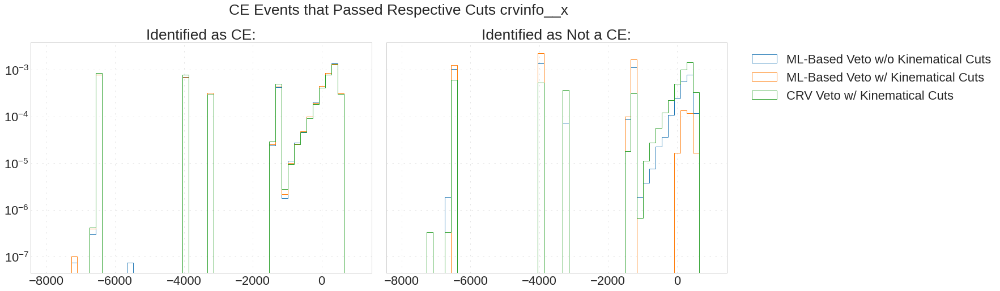

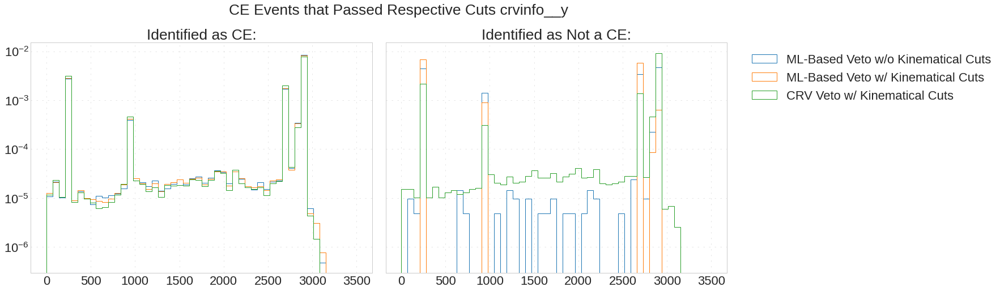

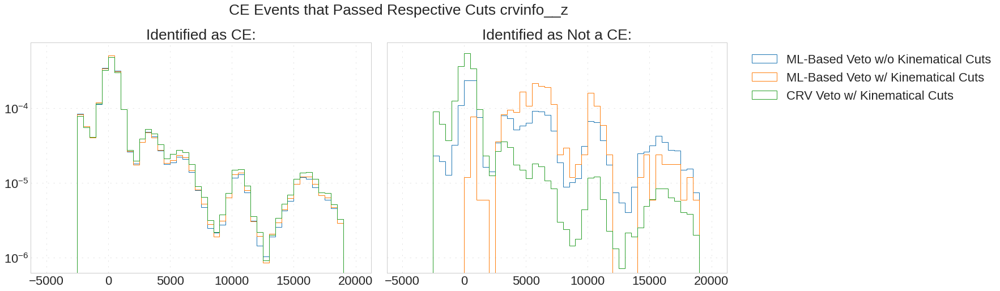

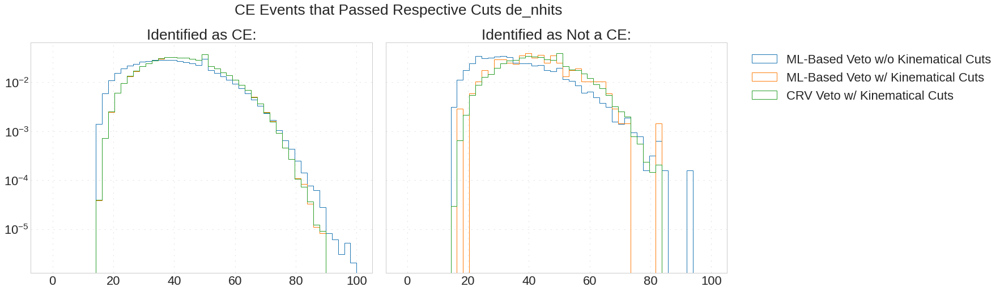

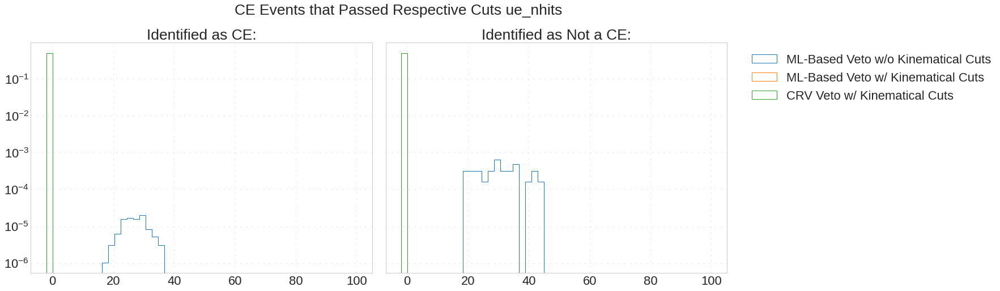

...

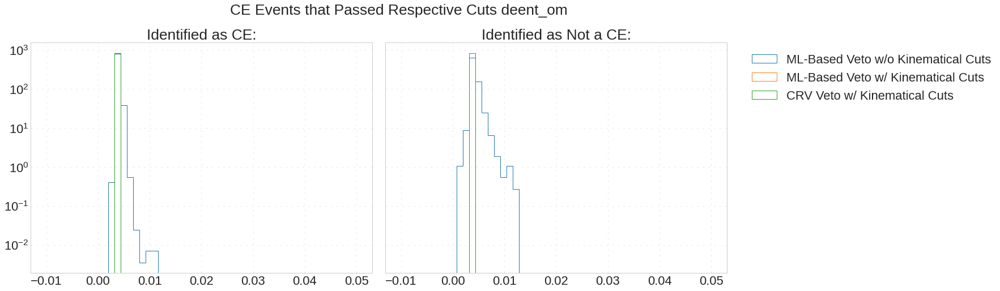

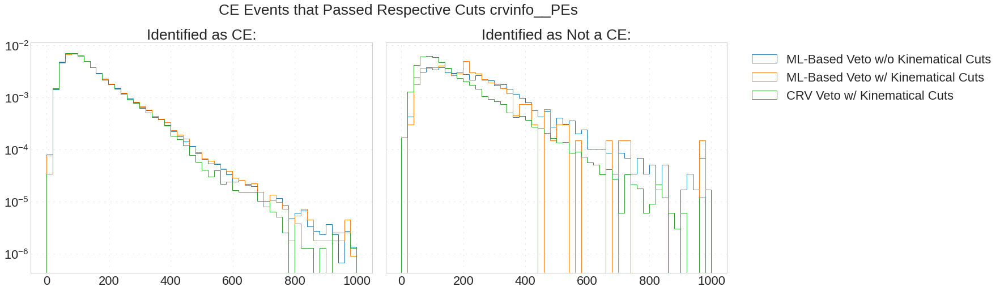

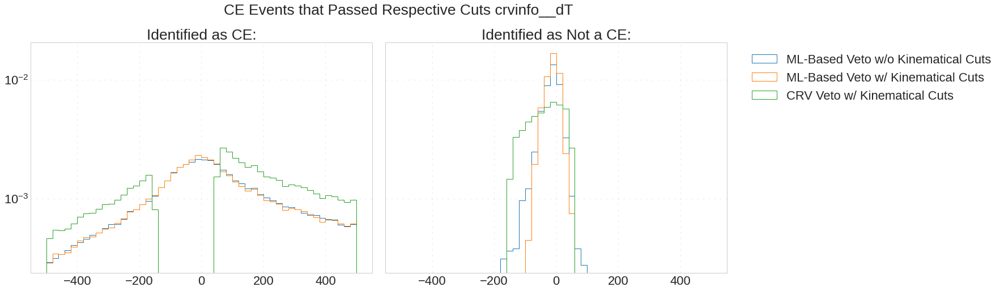

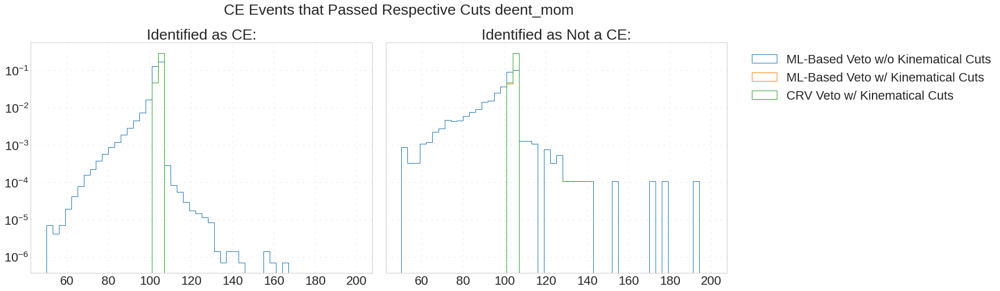

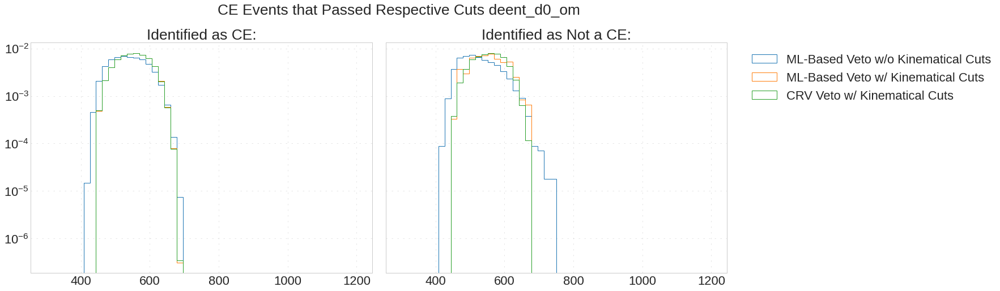

In [ ]:
Overall, OverallMLCuts, OverallcutNoCRV, OverallCut = createCutDistributions(Overall, OverallCUT, plot=True)

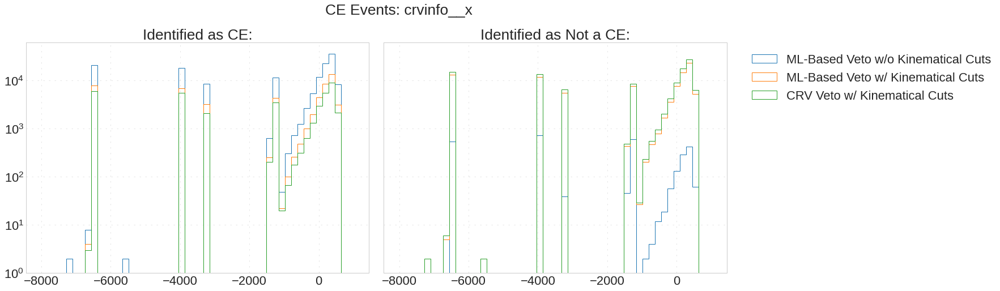

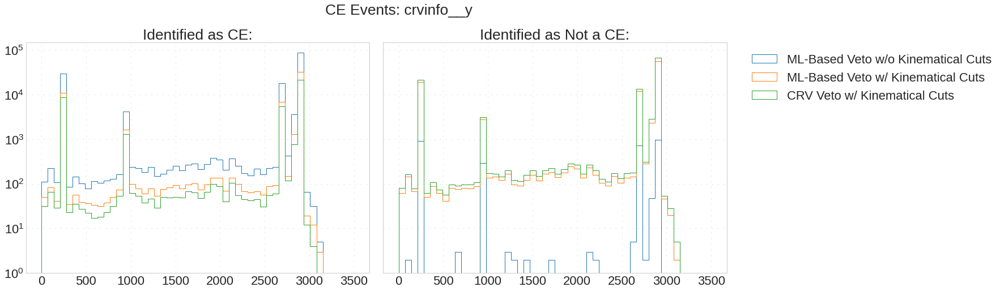

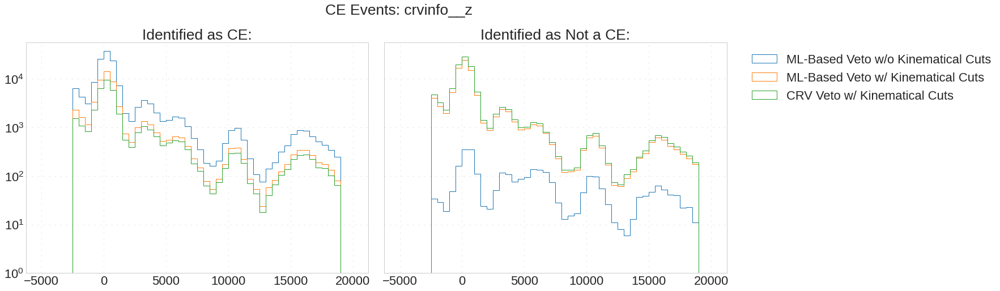

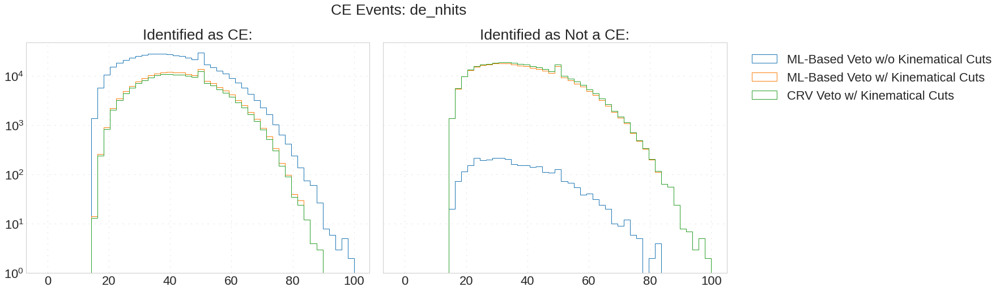

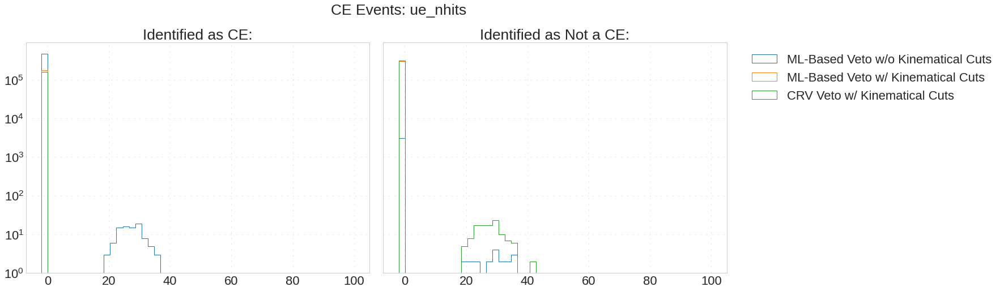

...

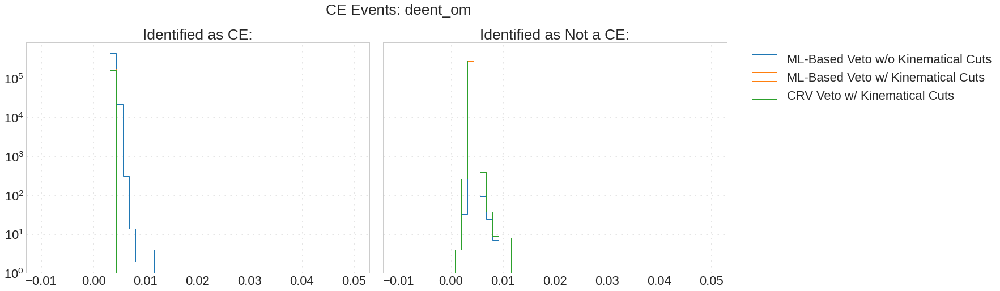

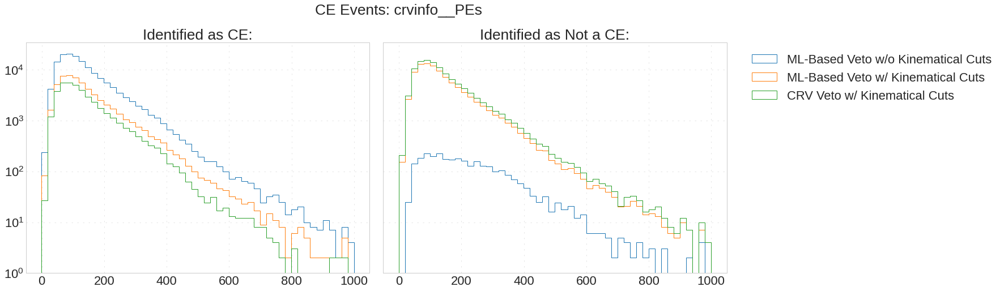

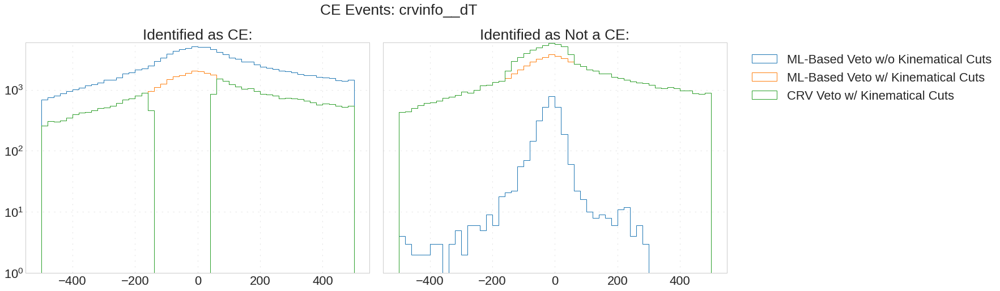

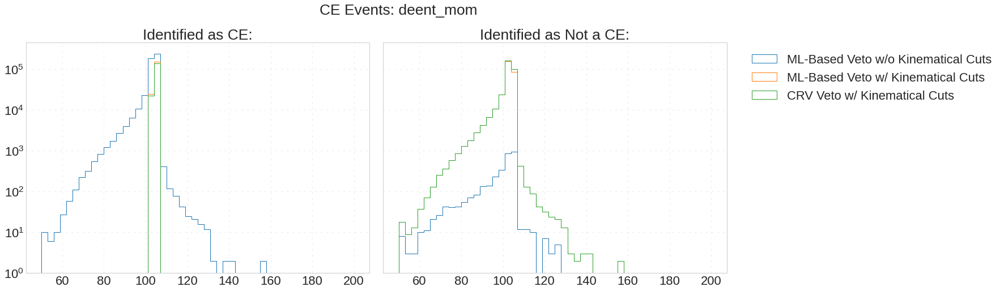

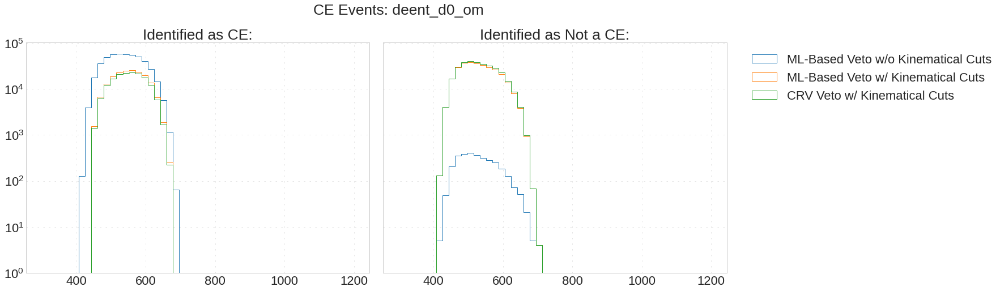

In [ ]:
Overall, OverallMLCuts, OverallcutNoCRV, OverallCut = createCutDistributions(Overall, OverallCUTBig, plot=True, dense=False)

In [ ]:
Overall.query("(Predictions != 1) and (Predictions !=0)")

,evtinfo__eventid,evtinfo__runid,evtinfo__subrunid,evtinfo__nprotons,de_status,de_alg,de_pdg,de_nhits,de_ndof,de_nactive,de_ndouble,de_ndactive,de_nnullambig,de_nmat,de_nmatactive,de_nbend,de_t0,de_t0err,de_chisq,de_fitcon,de_radlen,de_firstflt,de_lastflt,de_startvalid,de_endvalid,deent_mom,deent_momerr,deent_d0,deent_p0,deent_om,deent_z0,deent_td,deent_d0err,deent_p0err,deent_omerr,deent_z0err,deent_tderr,dequal_nquals,dequal_TrkPID,dequal_TrkPIDCalib,...,ue_firstflt,ue_lastflt,ue_startvalid,ue_endvalid,crvinfo__crvSectorType,crvinfo__x,crvinfo__y,crvinfo__z,crvinfo__timeWindowStart,crvinfo__timeWindowEnd,crvinfo__PEs,crvinfo__nCoincidenceHits,crvinfomc__valid,crvinfomc__pdgId,crvinfomc__primaryPdgId,crvinfomc__primaryE,crvinfomc__primaryX,crvinfomc__primaryY,crvinfomc__primaryZ,crvinfomc__parentPdgId,crvinfomc__parentE,crvinfomc__parentX,crvinfomc__parentY,crvinfomc__parentZ,crvinfomc__gparentPdgId,crvinfomc__gparentE,crvinfomc__gparentX,crvinfomc__gparentY,crvinfomc__gparentZ,crvinfomc__x,crvinfomc__y,crvinfomc__z,crvinfomc__time,crvinfomc__depositedEnergy,bestcrv,crvinfo__dT,deent_d0_om,is_triggered,Predictions,is_cosmic


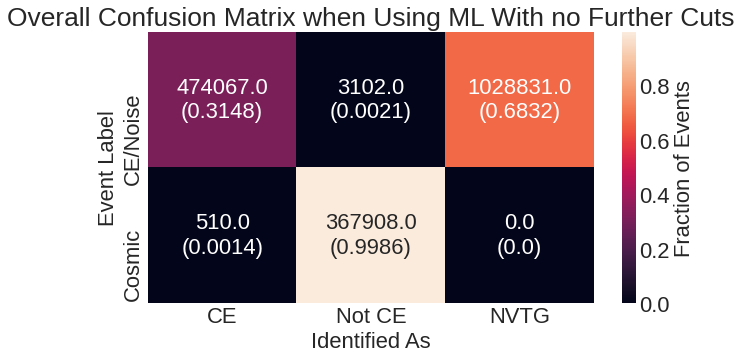

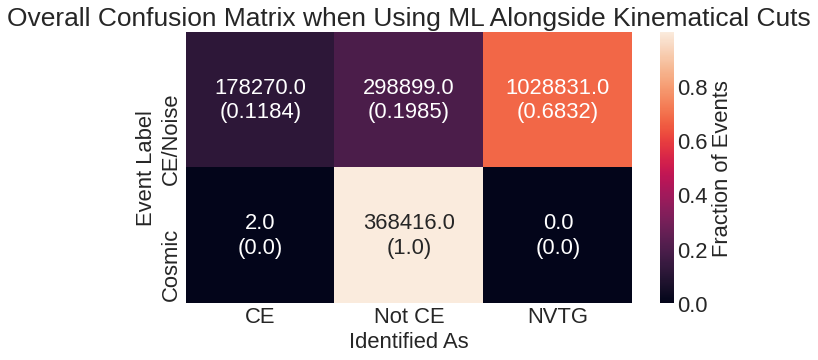

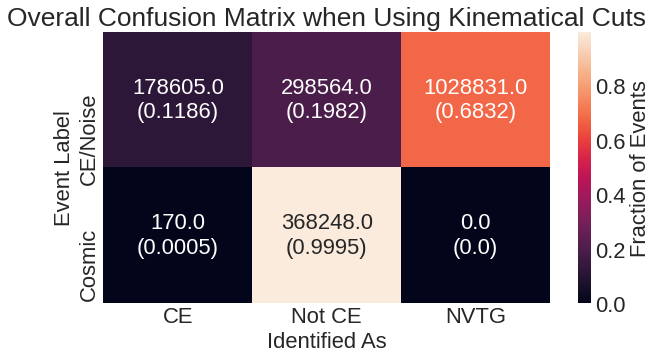

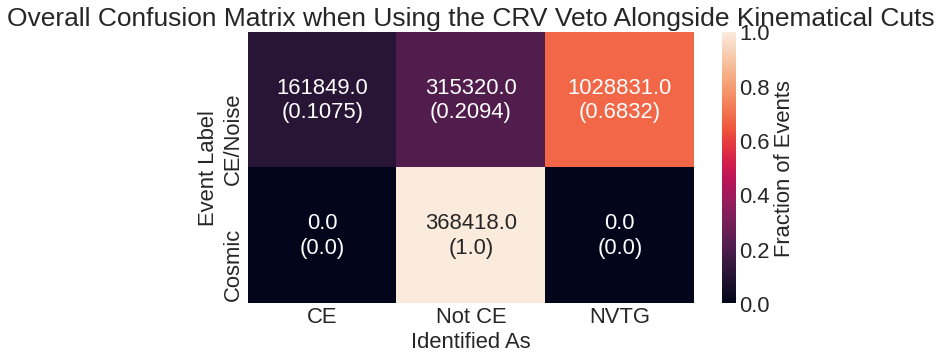

In [ ]:
MoarMatrix(Overall, OverallMLCuts, OverallcutNoCRV, OverallCut)

In [ ]:
del OverallMLCuts, OverallcutNoCRV, OverallCut

#1e8 - 1.2e8 nproton distribution

In [ ]:
nproton = Overall.query('evtinfo__nprotons < 1.2e8 and evtinfo__nprotons > 1e8')
nprotonCUT = OverallCUT.query('evtinfo__nprotons < 1.2e8 and evtinfo__nprotons > 1e8')

nprotonCUTBIG = OverallCUTBig.query('evtinfo__nprotons < 1.2e8 and evtinfo__nprotons > 1e8')

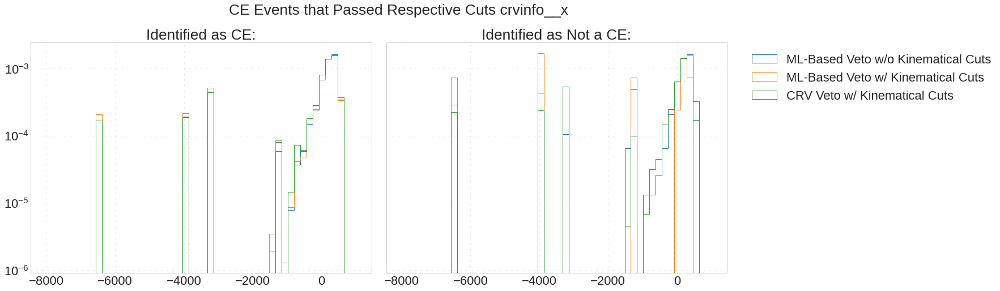

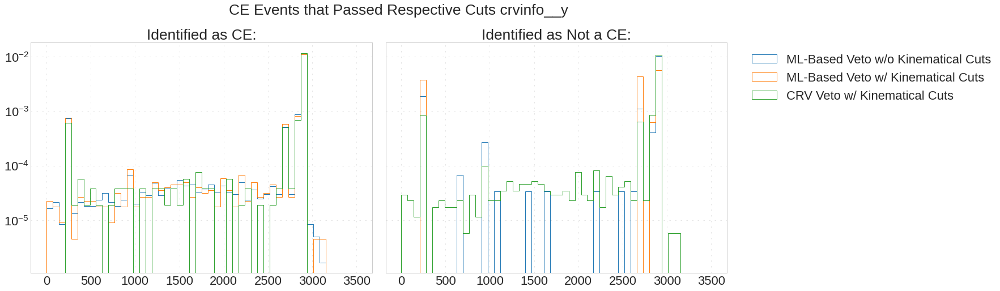

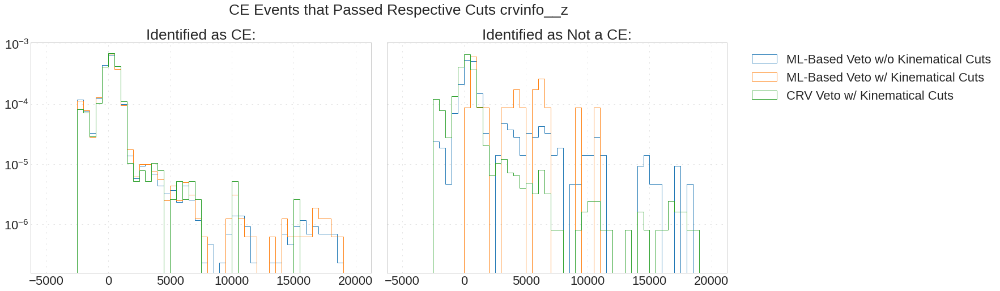

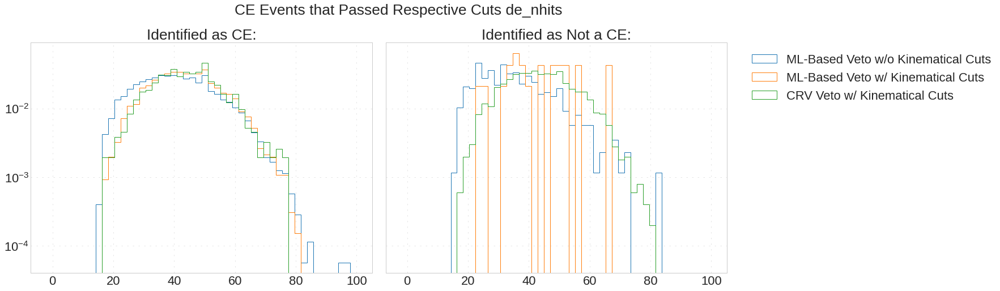

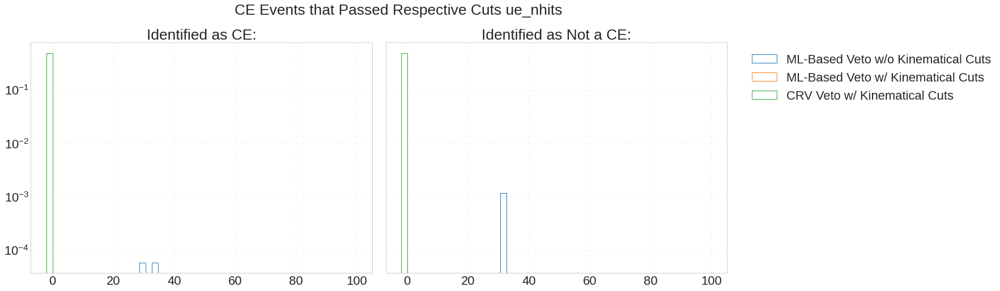

...

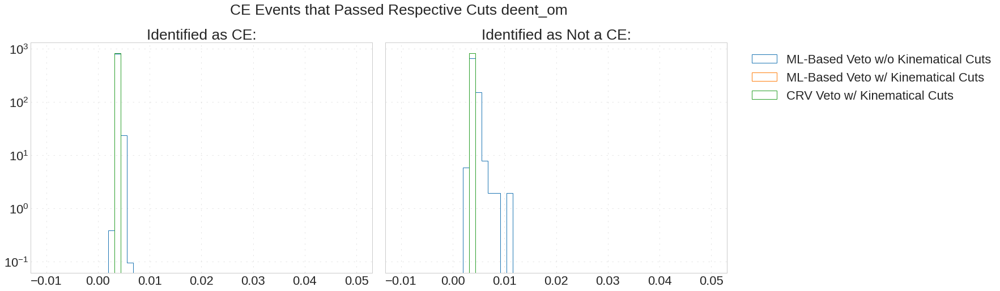

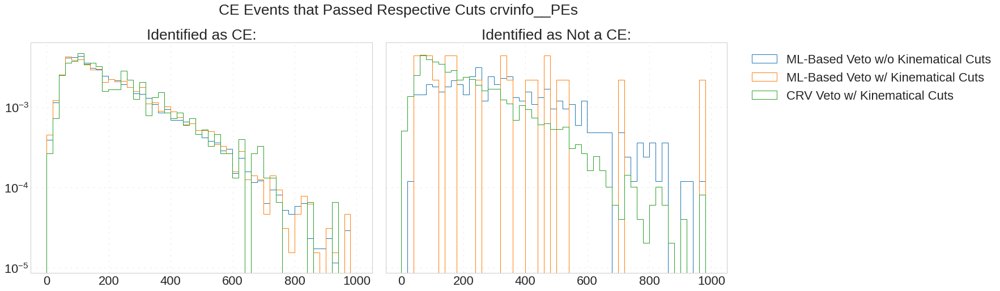

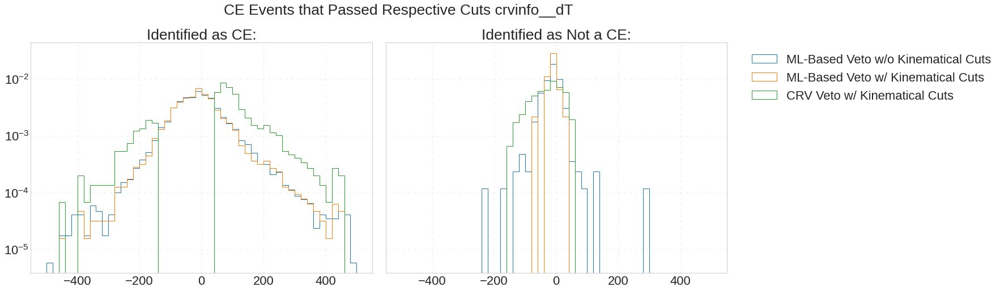

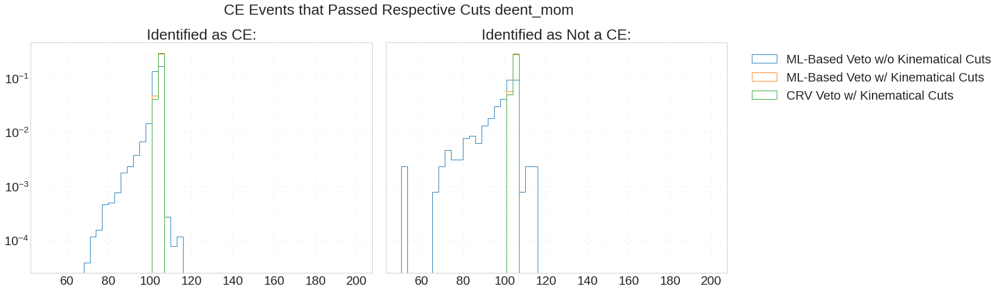

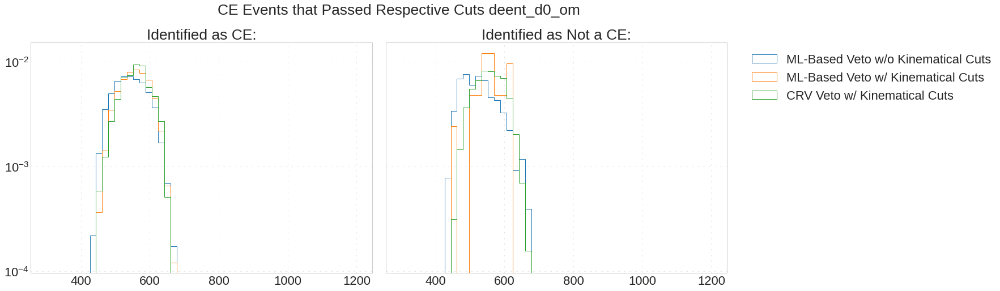

In [ ]:
nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut = createCutDistributions(nproton, nprotonCUT, plot=True)

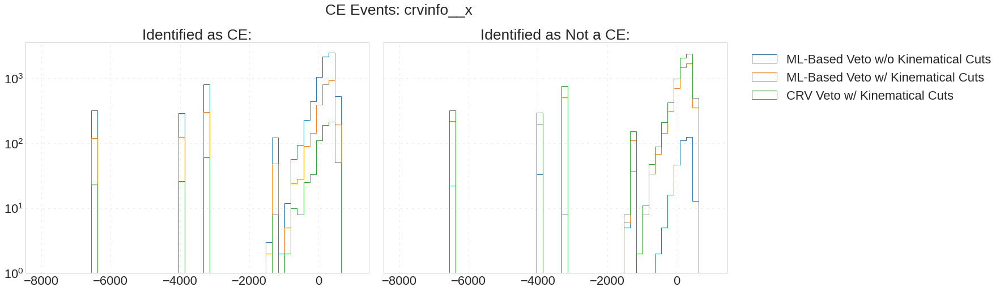

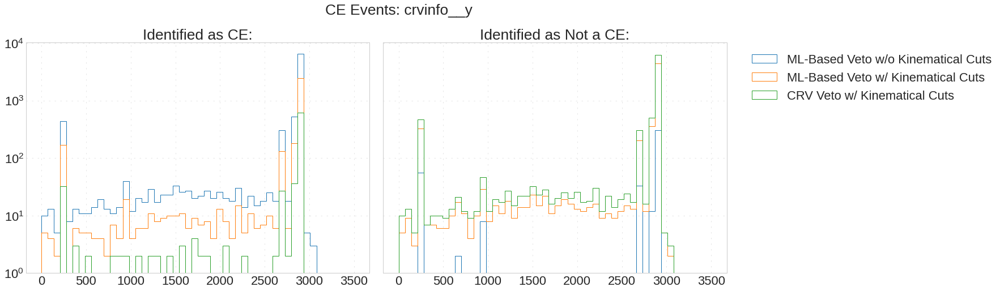

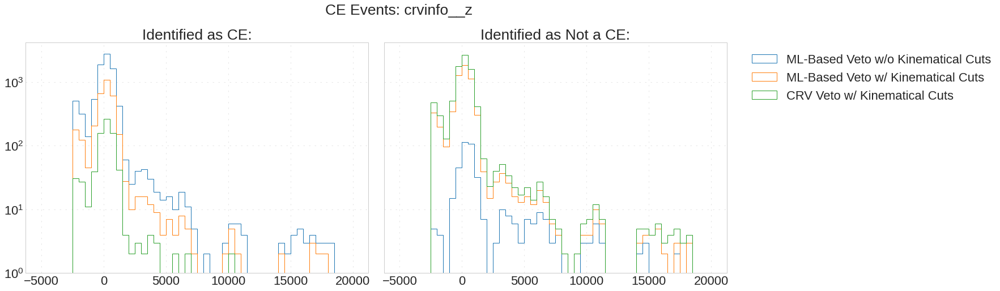

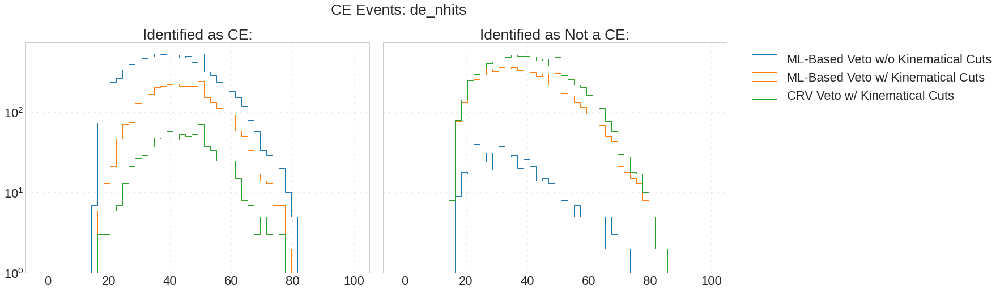

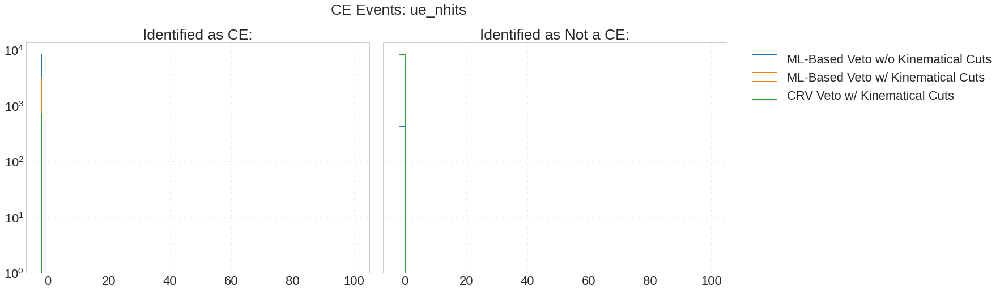

...

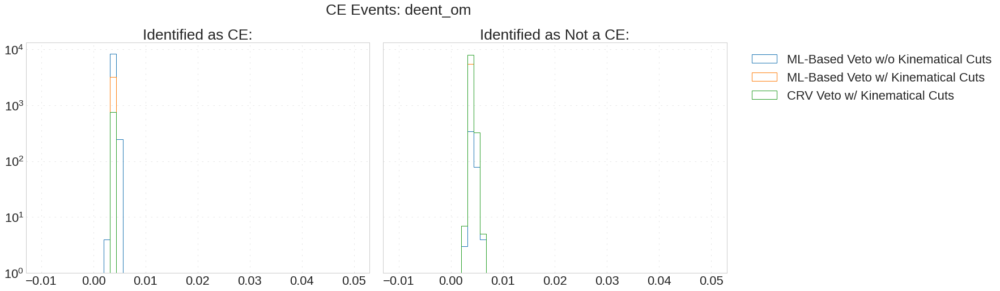

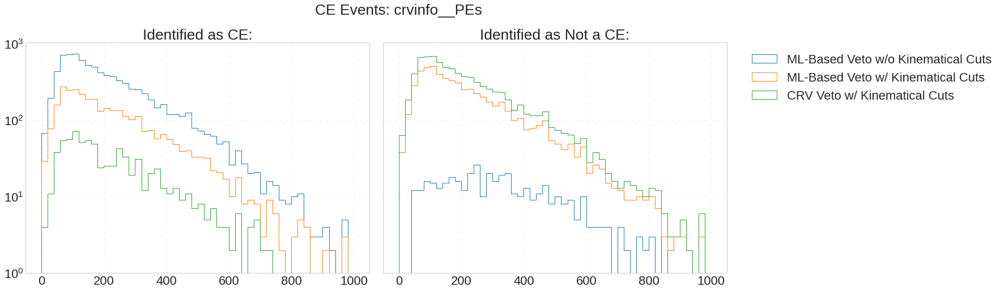

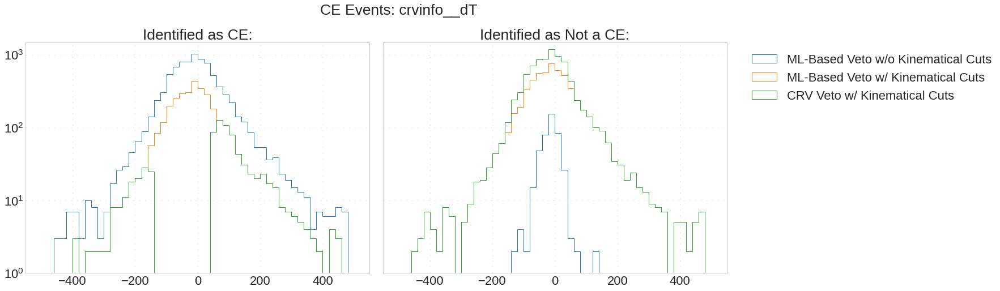

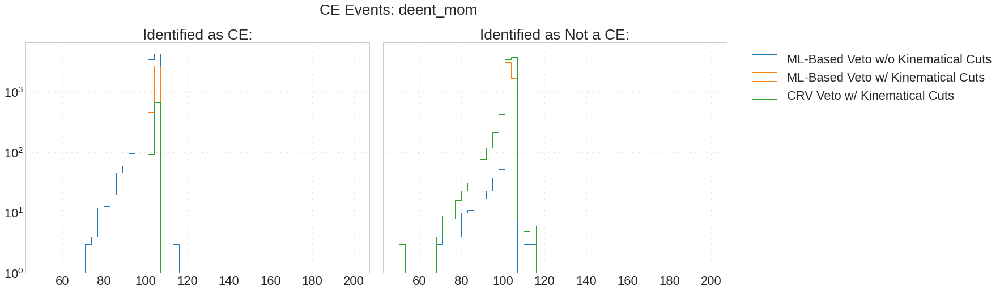

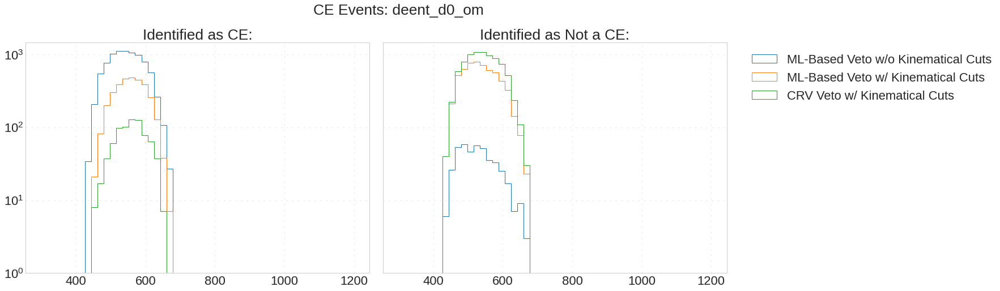

In [ ]:
nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut = createCutDistributions(nproton, nprotonCUTBIG, plot=True, dense=False)

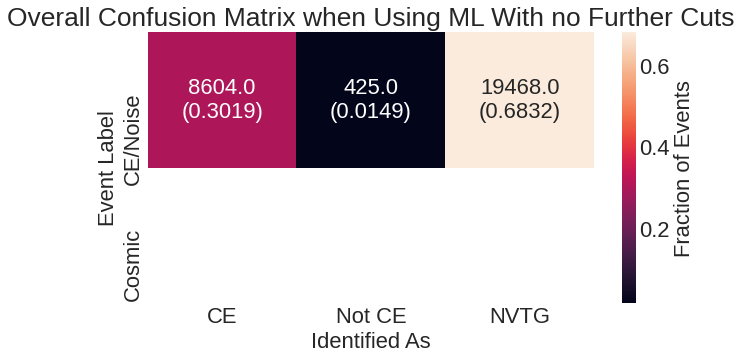

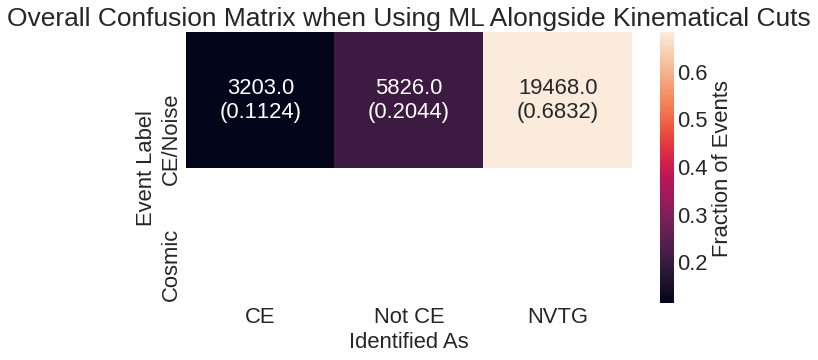

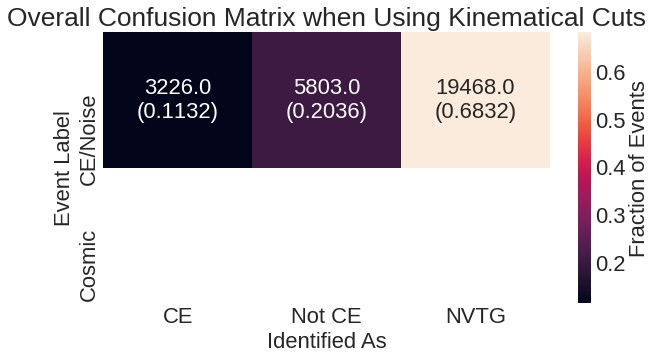

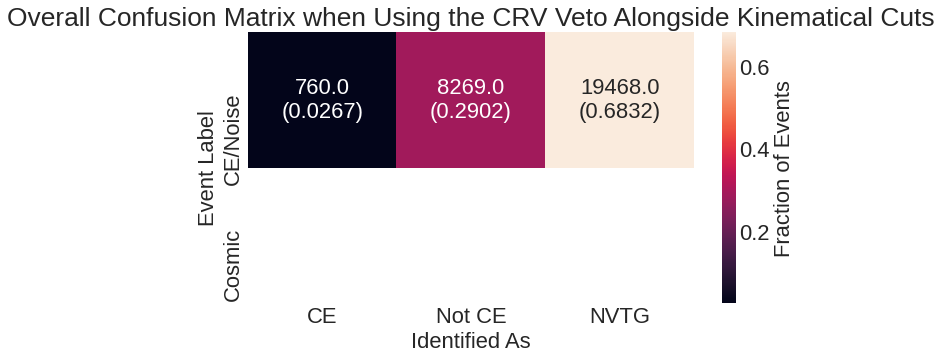

In [ ]:
MoarMatrix(nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut)

In [ ]:
del nproton, nprotonMom, nprotonMLCuts, nprotoncutNoCRV, nprotonCut

#0.8e8 - 1e8 nproton distribution

In [ ]:
nproton = Overall.query('evtinfo__nprotons < 1e8 and evtinfo__nprotons > 0.8e8')
nprotonCUT = OverallCUT.query('evtinfo__nprotons < 1e8 and evtinfo__nprotons > 0.8e8')

nprotonCUTBIG = OverallCUTBig.query('evtinfo__nprotons < 1e8 and evtinfo__nprotons > 0.8e8')

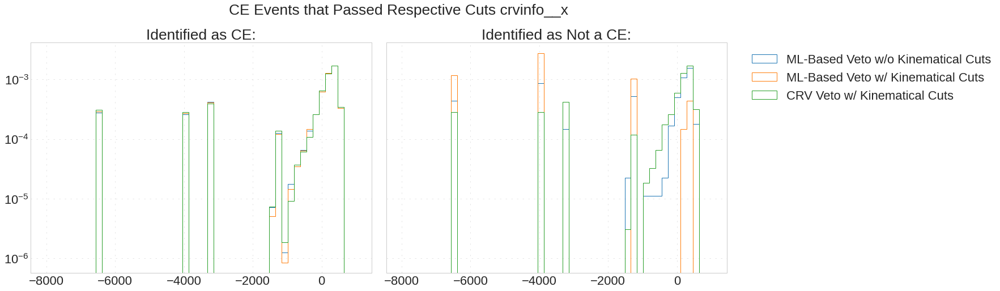

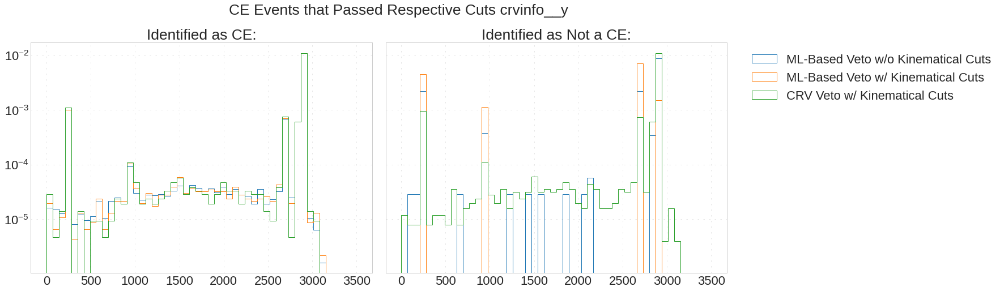

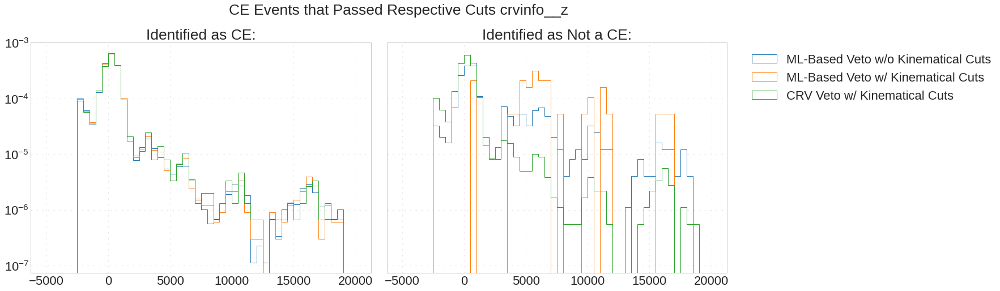

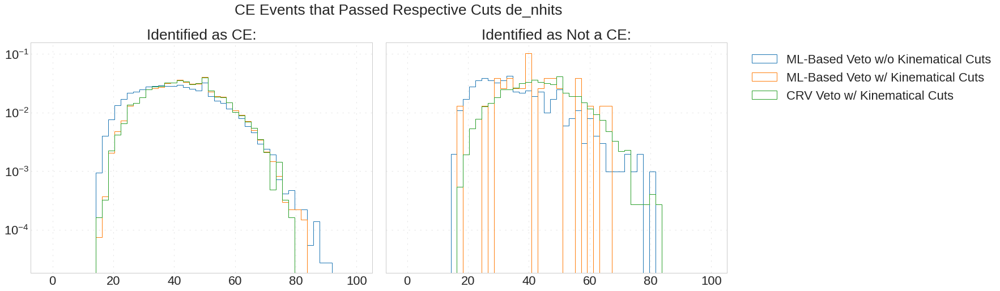

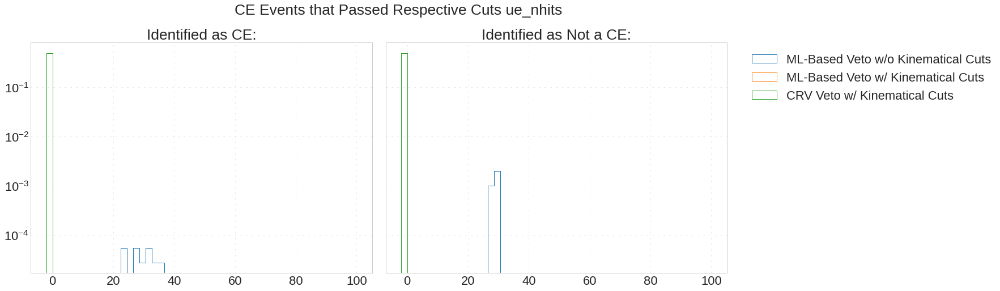

...

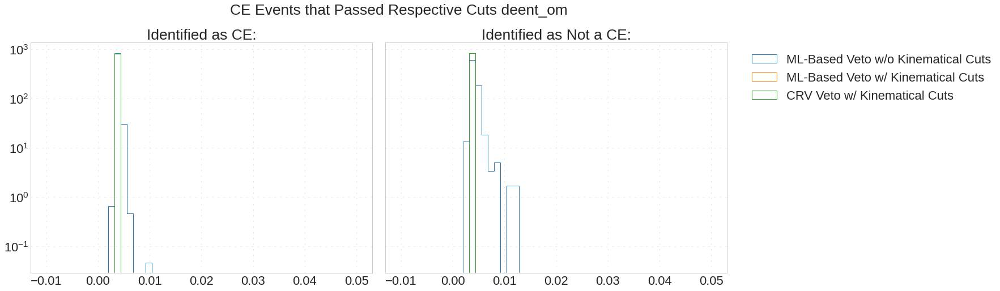

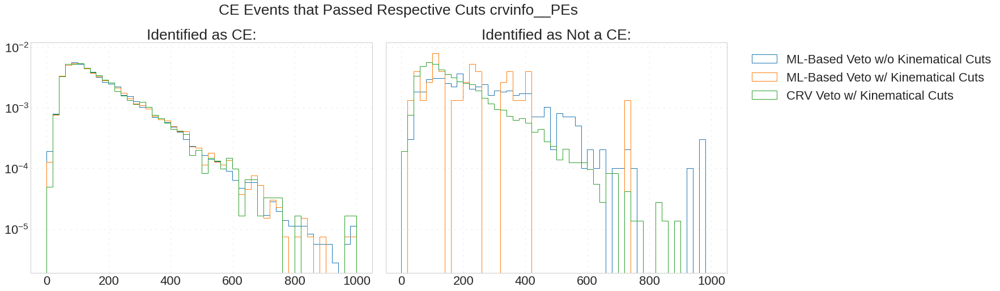

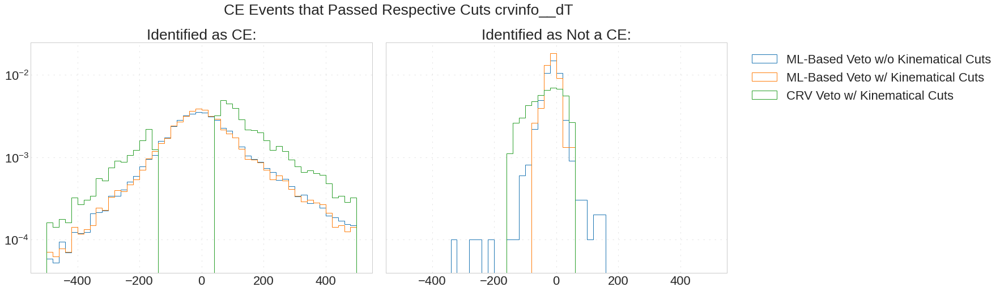

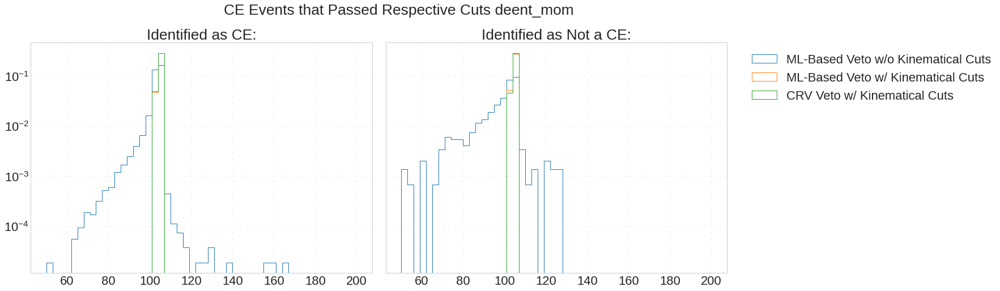

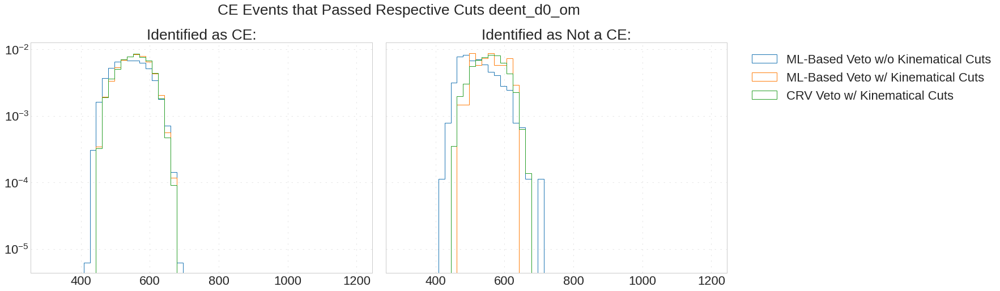

In [ ]:
nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut = createCutDistributions(nproton, nprotonCUT, plot=True)

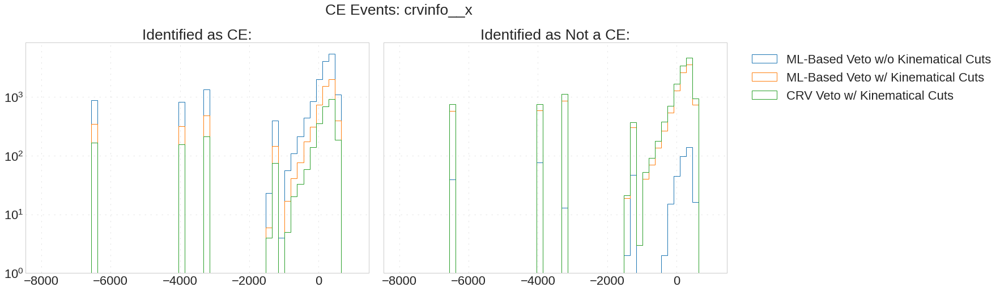

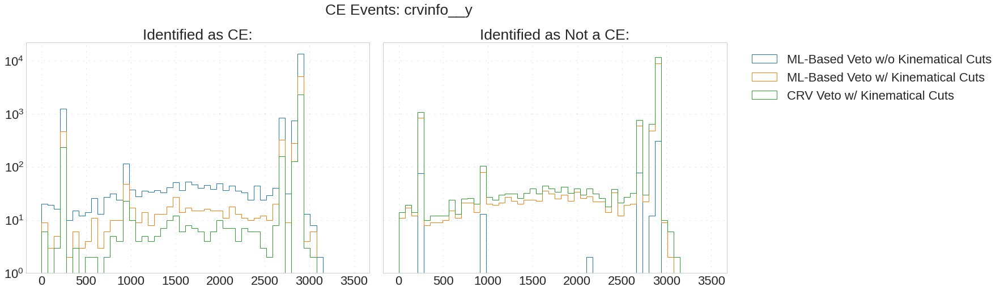

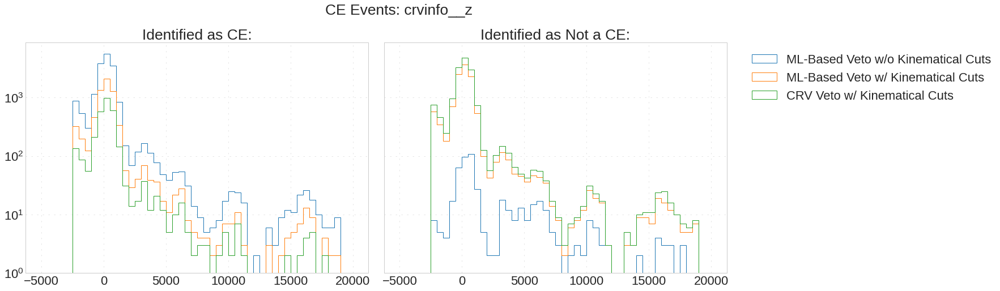

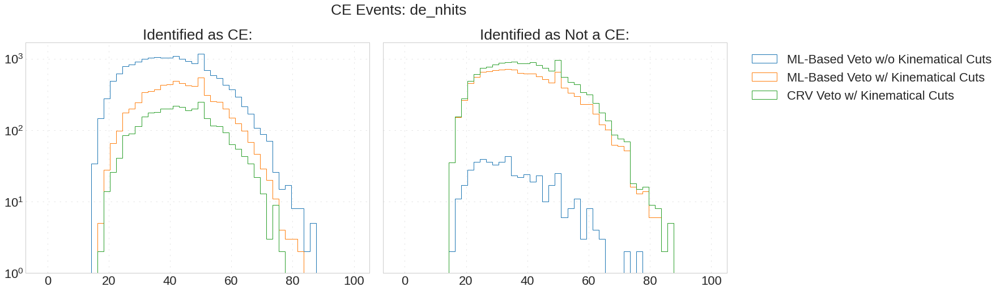

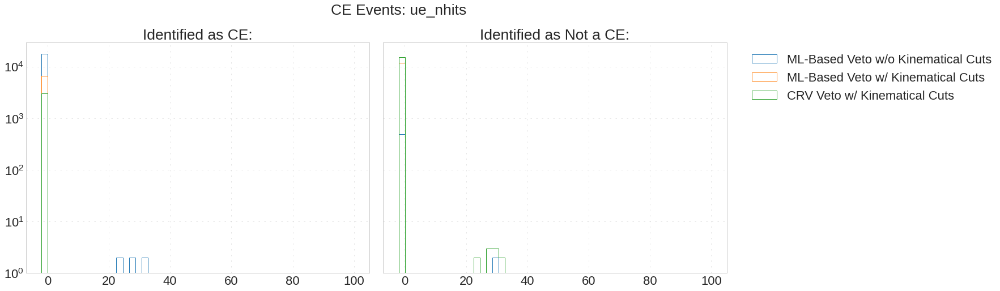

...

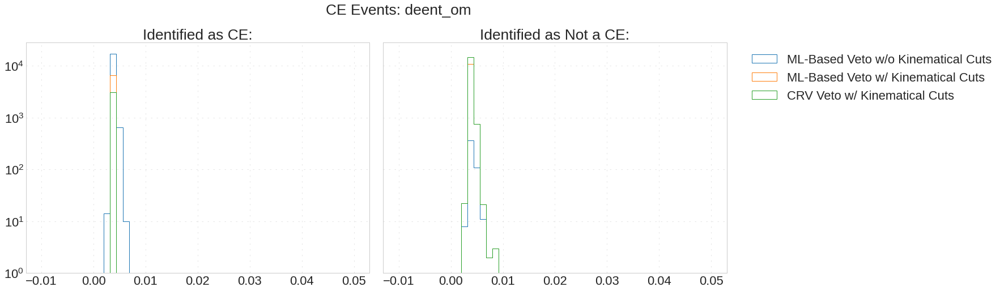

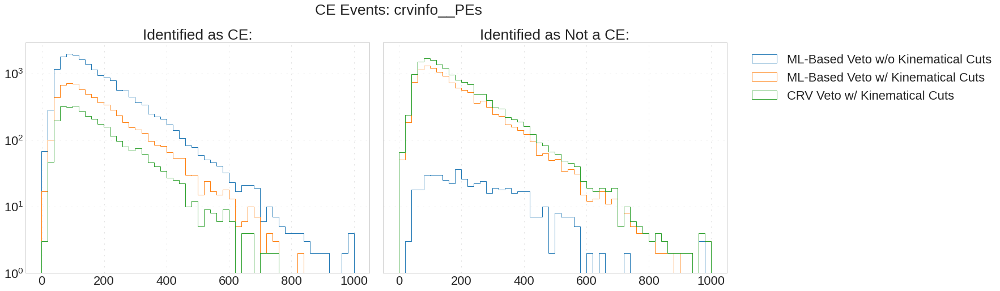

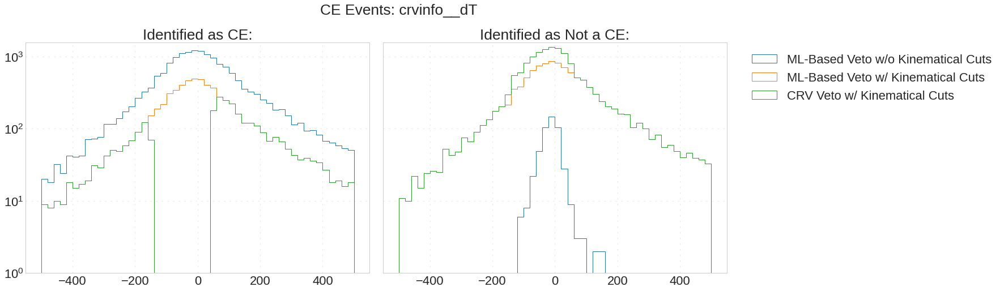

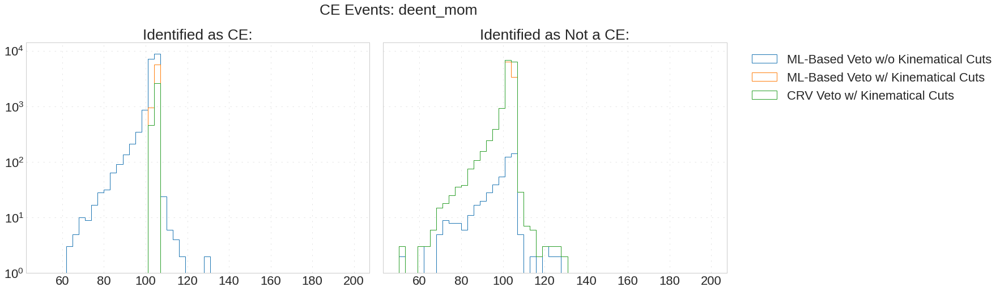

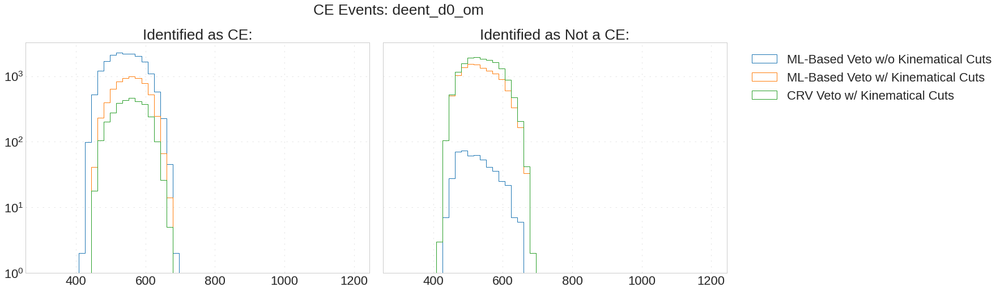

In [ ]:
nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut = createCutDistributions(nproton, nprotonCUTBIG, plot=True, dense=False)

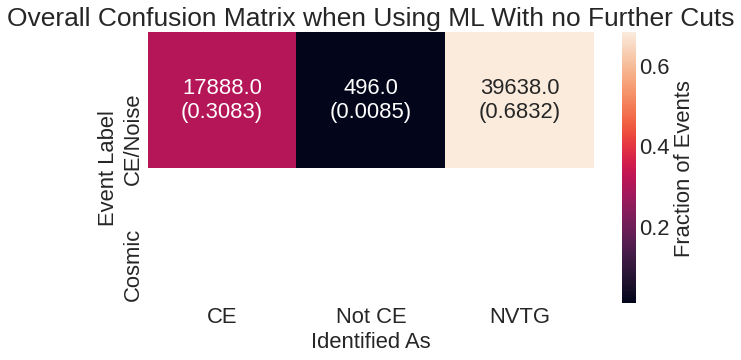

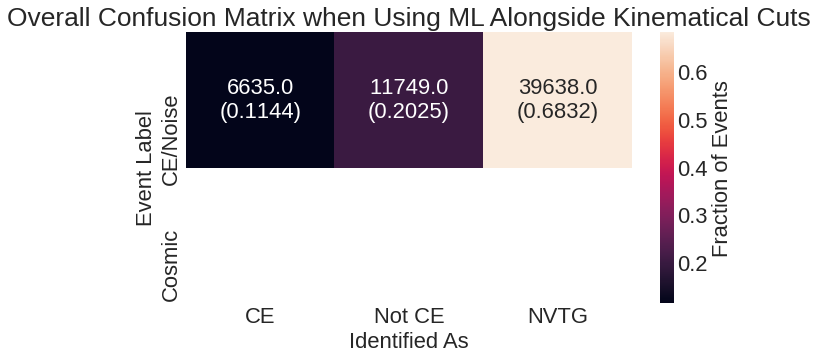

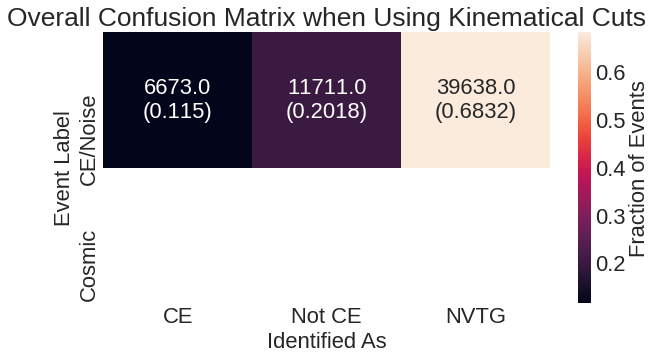

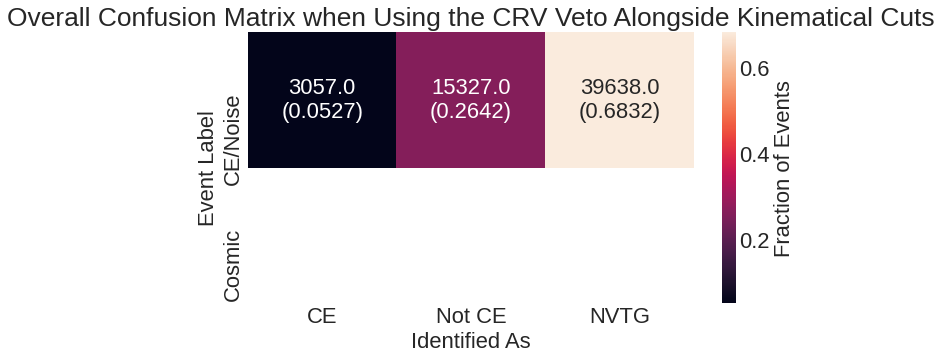

In [ ]:
MoarMatrix(nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut)

In [ ]:
del nproton, nprotonMom, nprotonMLCuts, nprotoncutNoCRV, nprotonCut

#0.6e8 - 0.8e8 nproton distribution

In [ ]:
nproton = Overall.query('evtinfo__nprotons < 0.8e8 and evtinfo__nprotons > 0.6e8')
nprotonCUT = OverallCUT.query('evtinfo__nprotons < 0.8e8 and evtinfo__nprotons > 0.6e8')

nprotonCUTBIG = OverallCUTBig.query('evtinfo__nprotons < 0.8e8 and evtinfo__nprotons > 0.6e8')

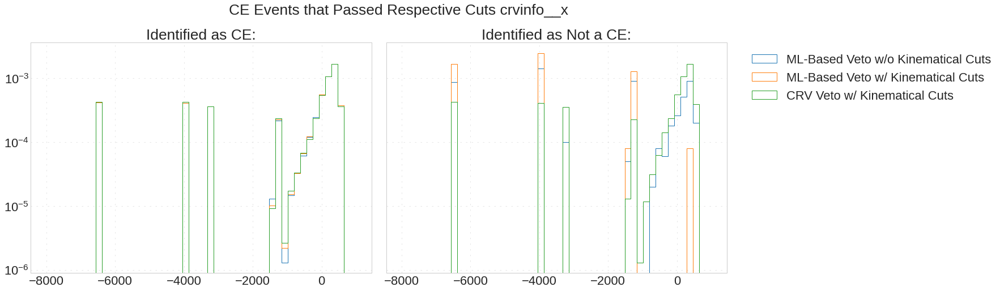

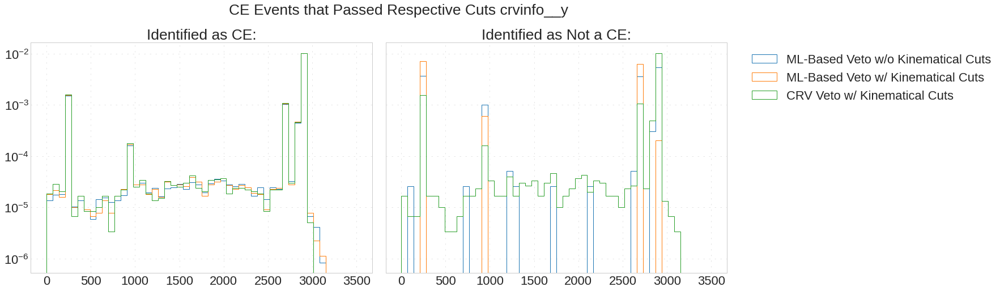

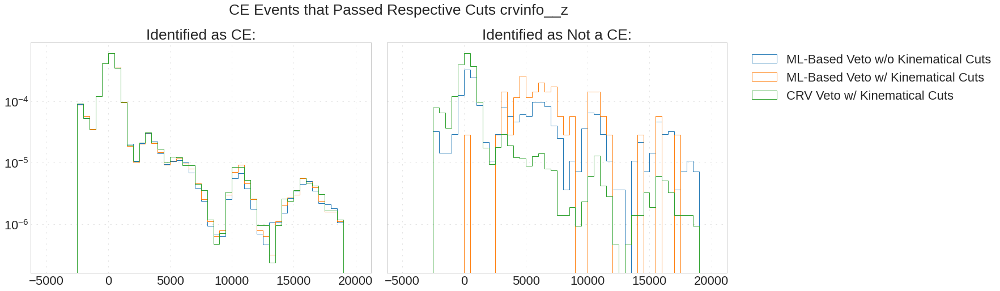

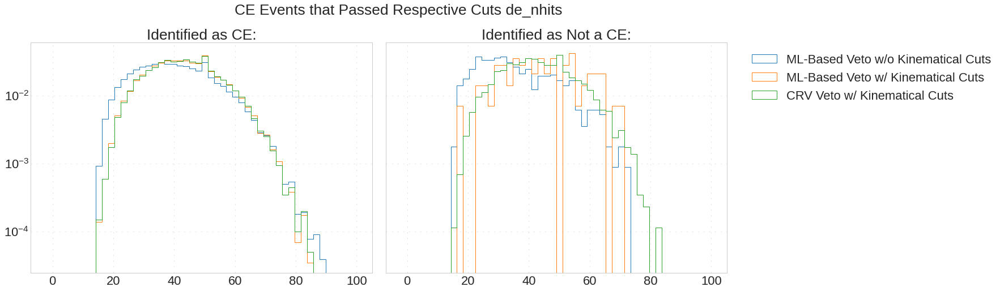

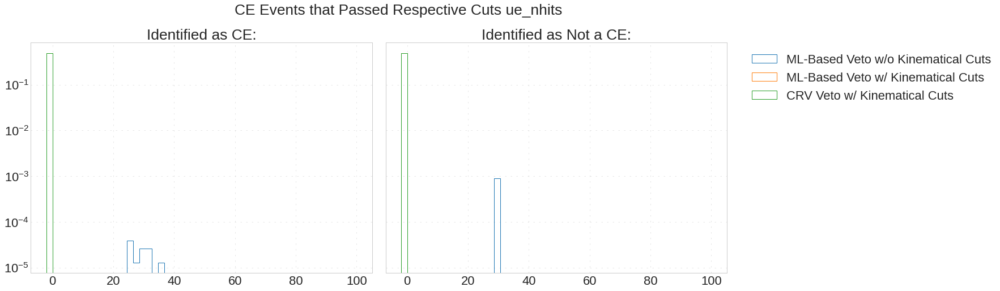

...

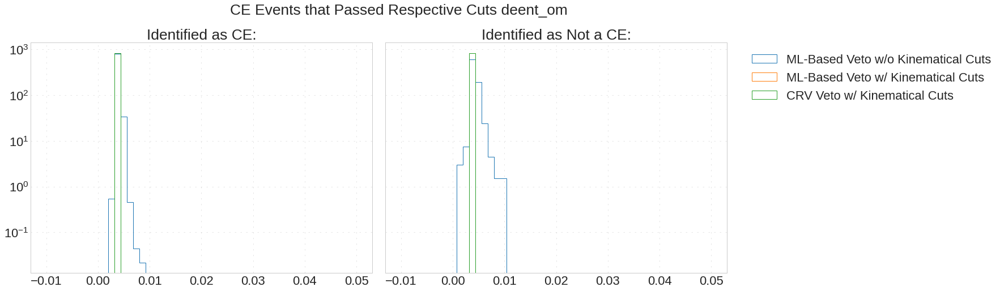

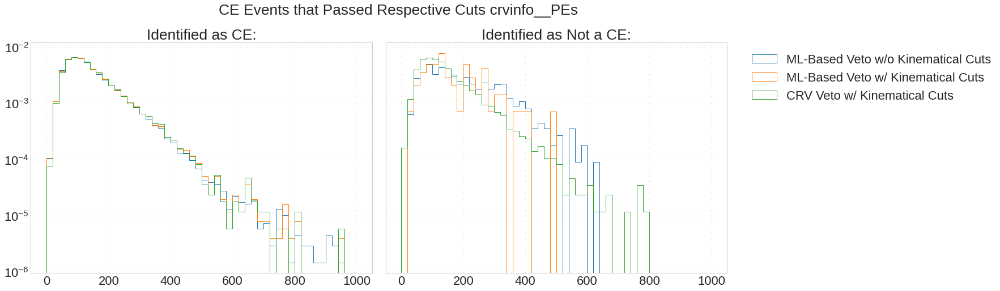

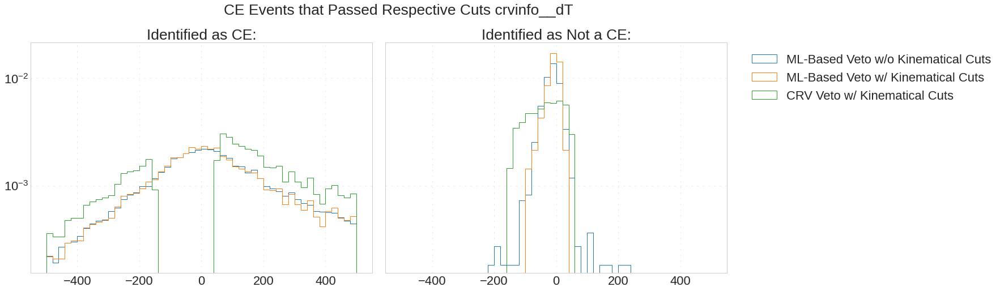

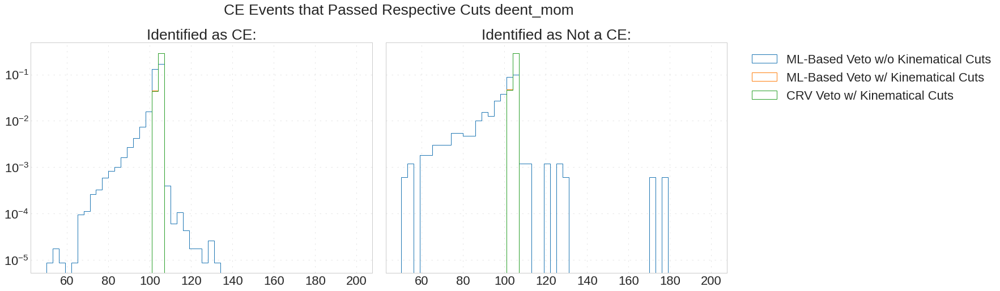

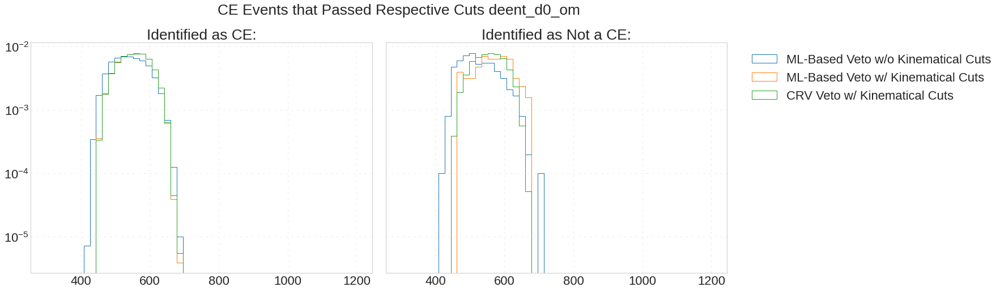

In [ ]:
nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut = createCutDistributions(nproton, nprotonCUT, plot=True)

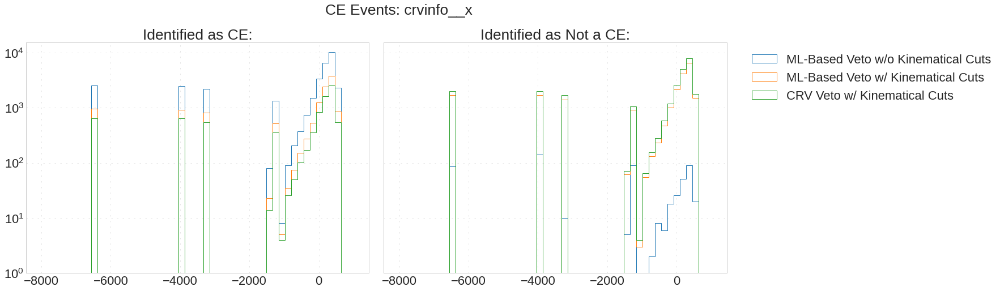

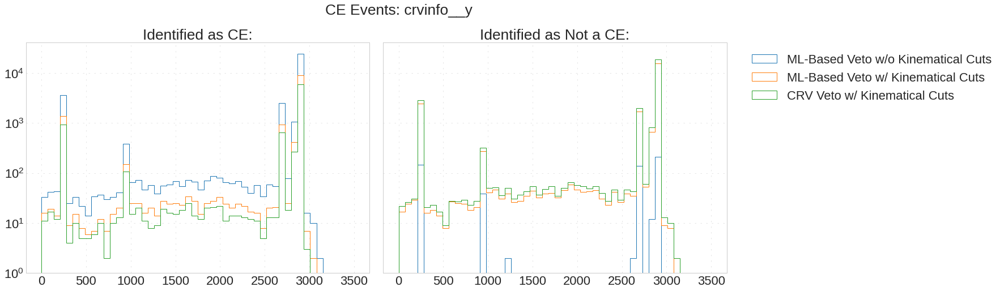

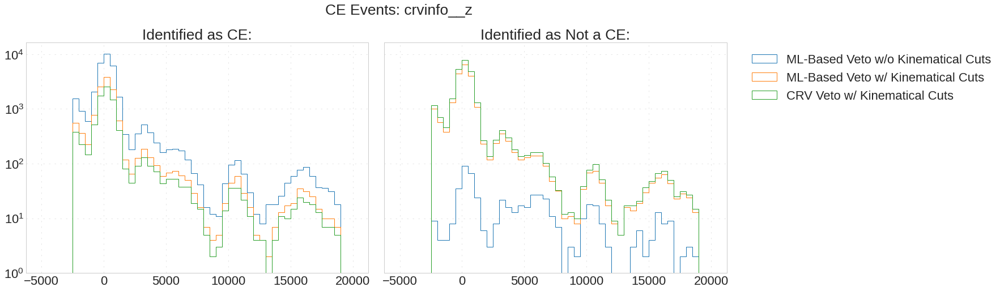

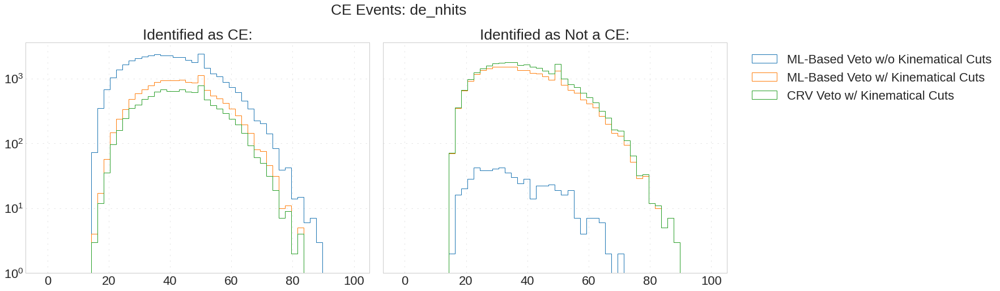

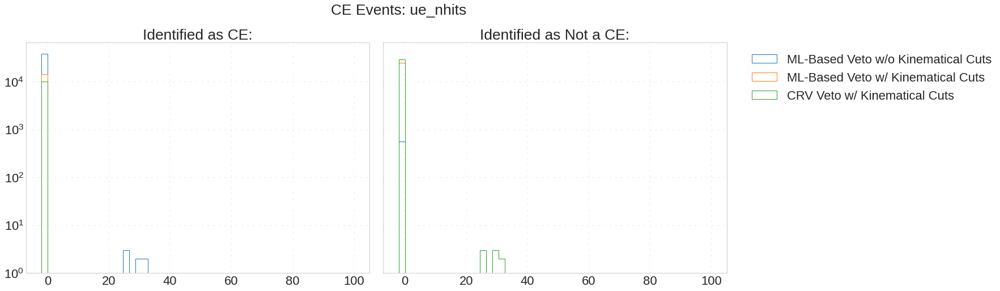

...

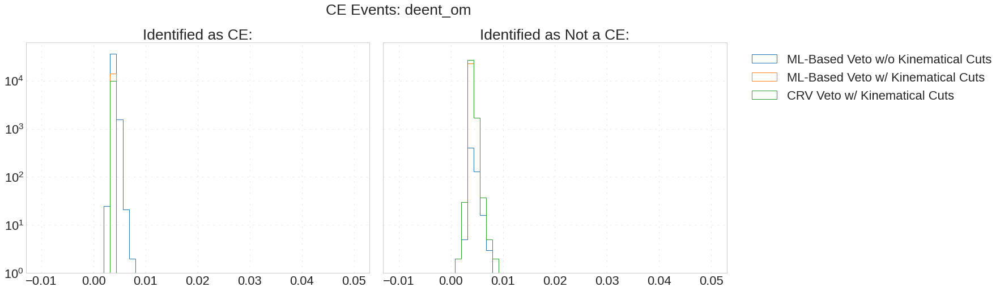

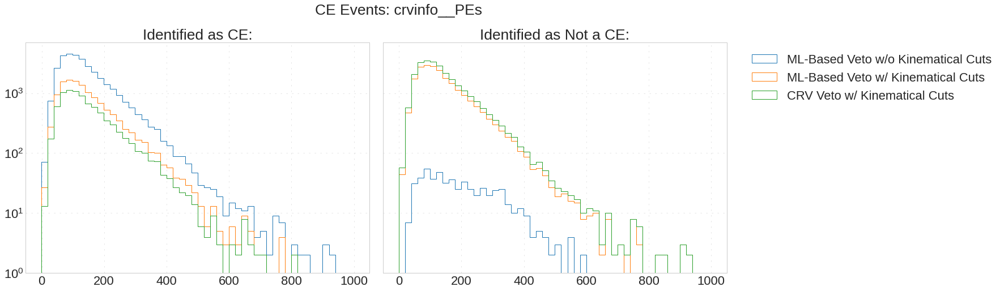

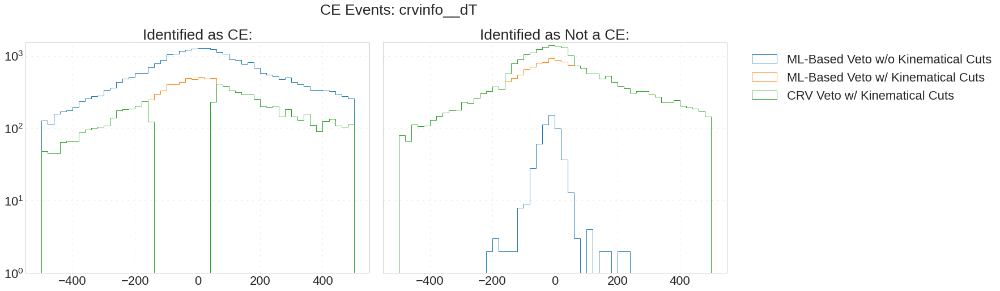

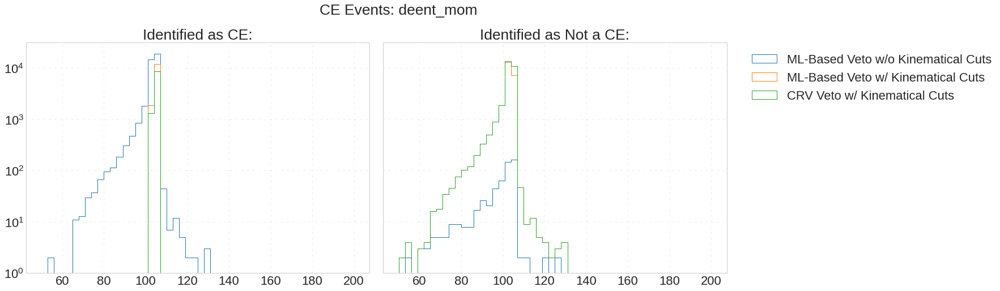

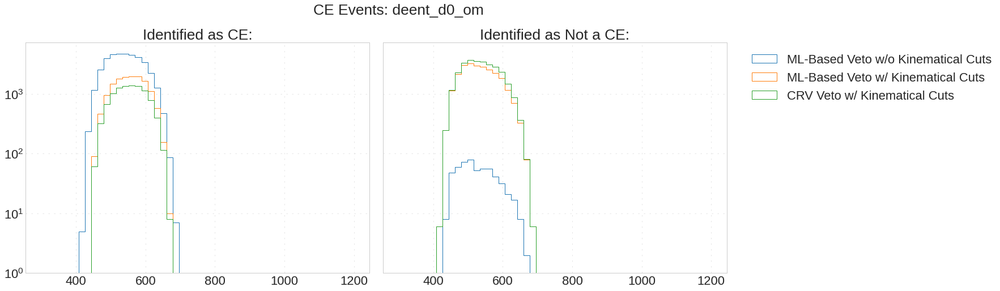

In [ ]:
nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut = createCutDistributions(nproton, nprotonCUTBIG, plot=True, dense=False)

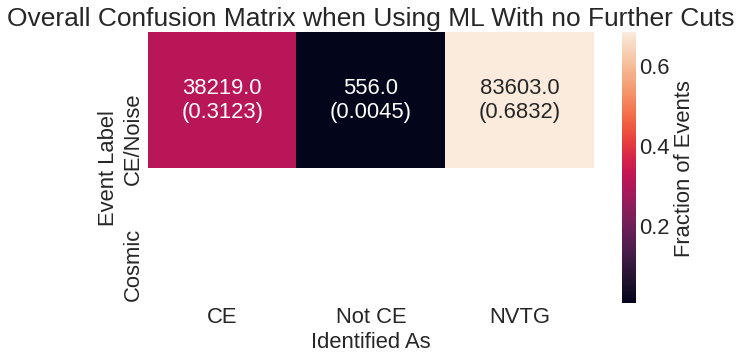

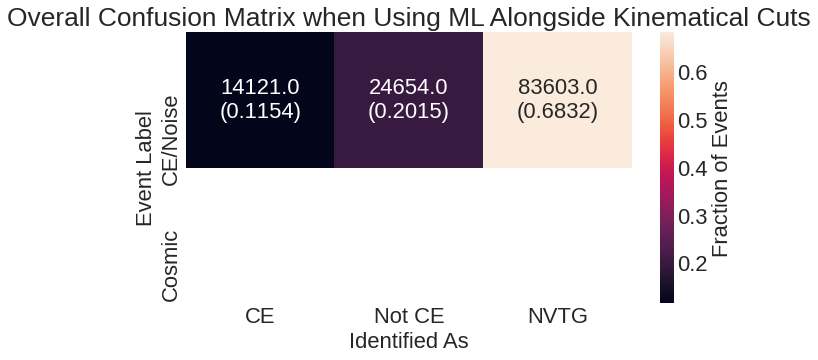

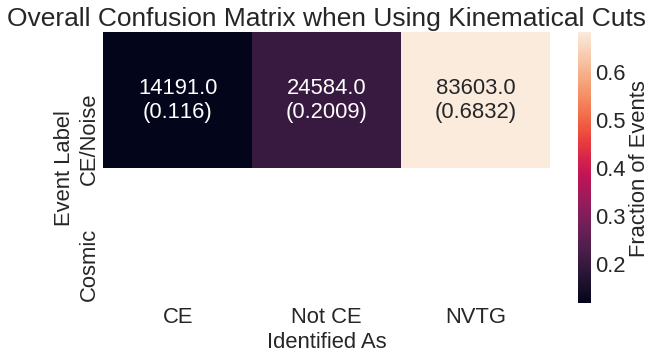

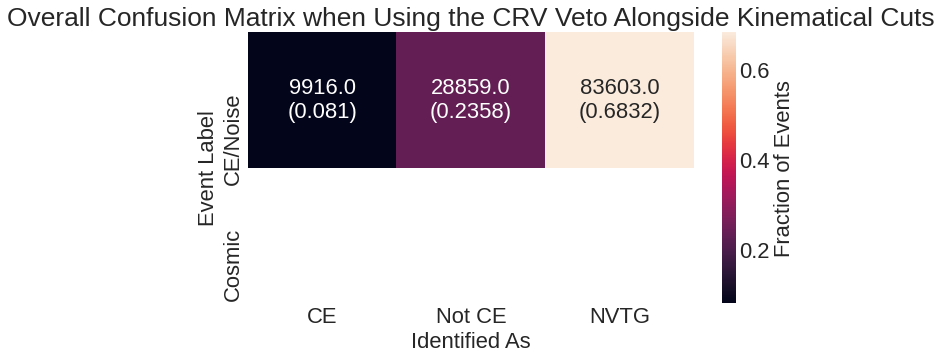

In [ ]:
MoarMatrix(nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut)

In [ ]:
del nproton, nprotonMom, nprotonMLCuts, nprotoncutNoCRV, nprotonCut

#0.4e8 - 0.6e8 nproton distribution

In [ ]:
nproton = Overall.query('evtinfo__nprotons < 0.6e8 and evtinfo__nprotons > 0.4e8')
nprotonCUT = OverallCUT.query('evtinfo__nprotons < 0.6e8 and evtinfo__nprotons > 0.4e8')

nprotonCUTBIG = OverallCUTBig.query('evtinfo__nprotons < 0.6e8 and evtinfo__nprotons > 0.4e8')

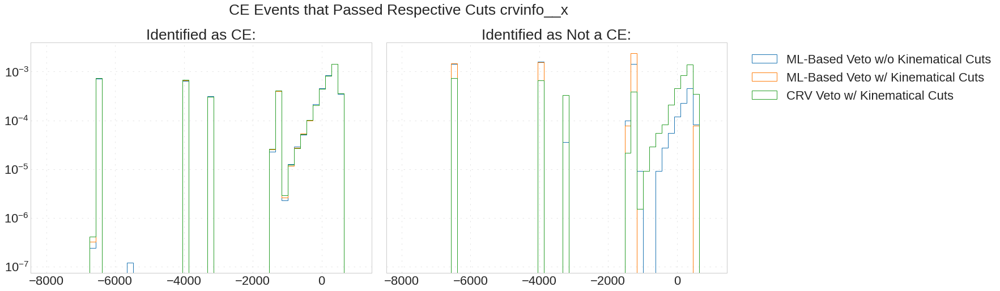

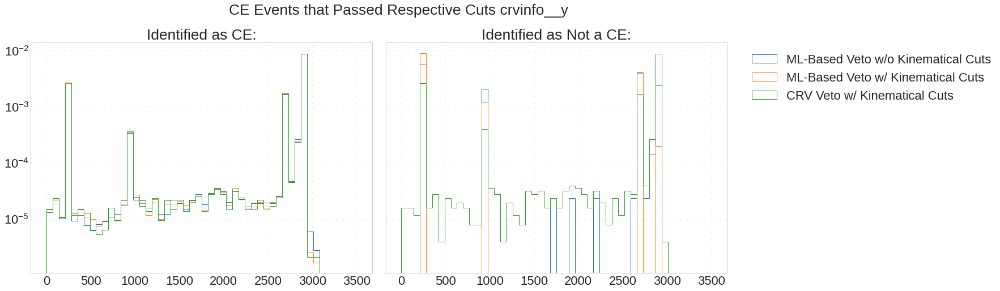

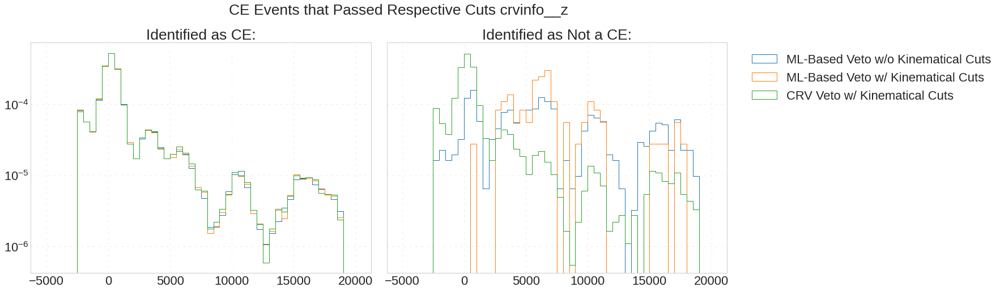

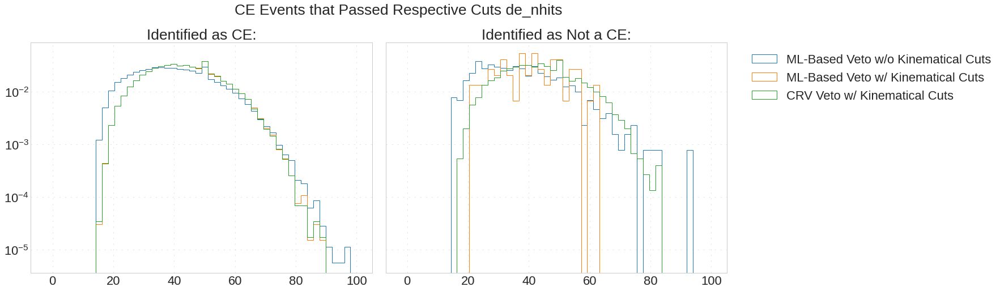

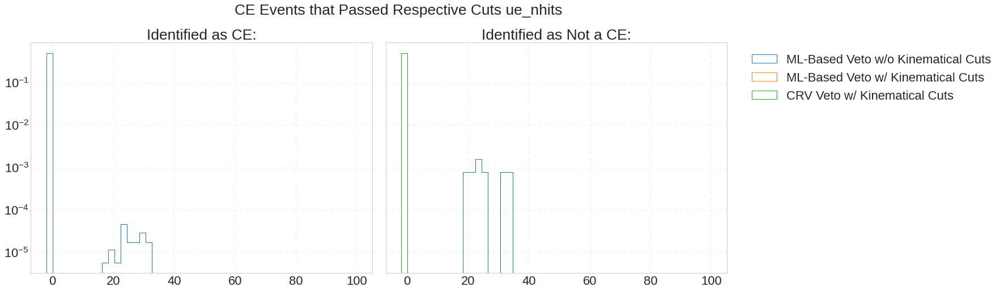

...

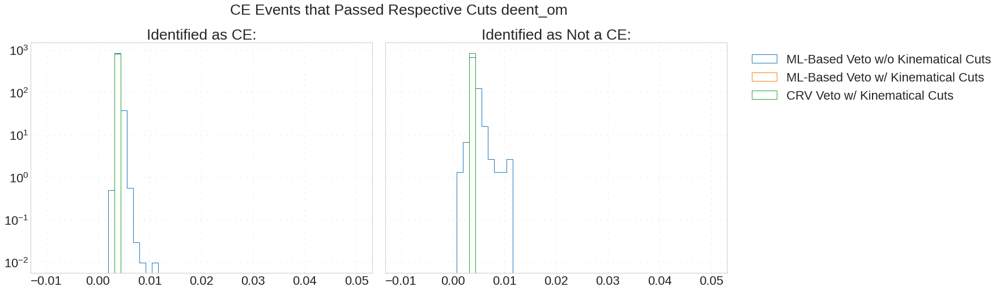

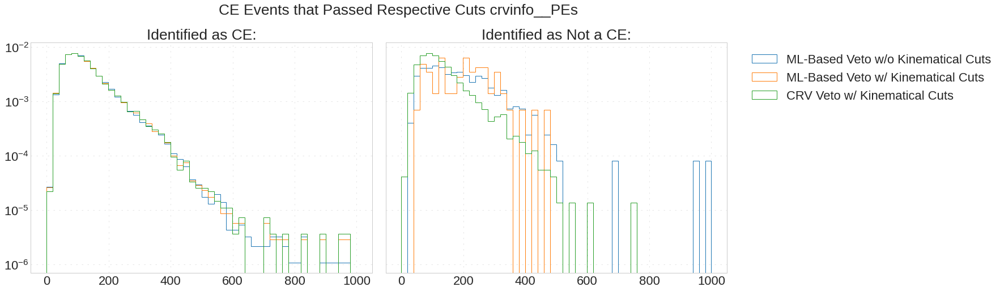

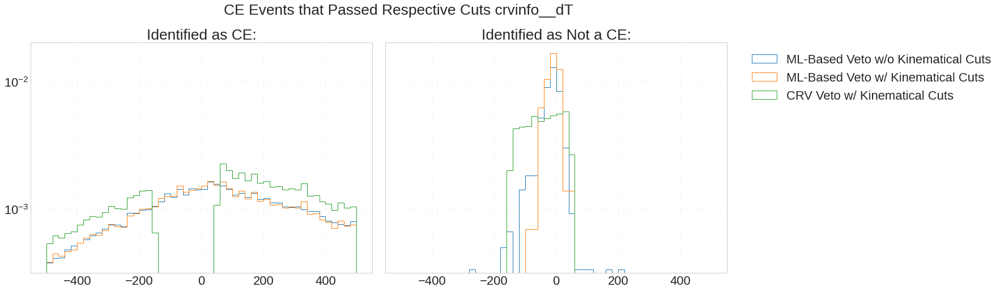

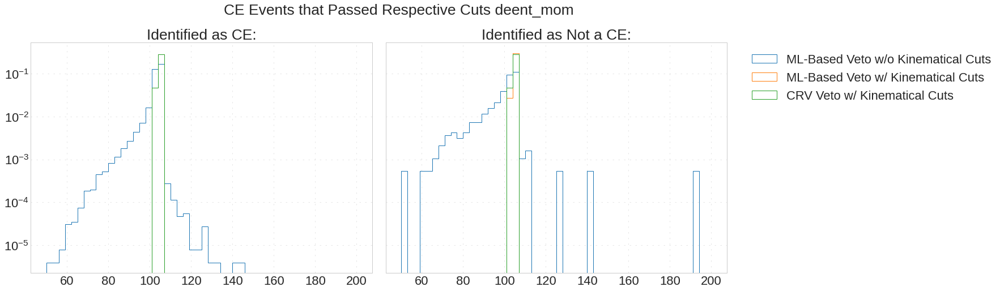

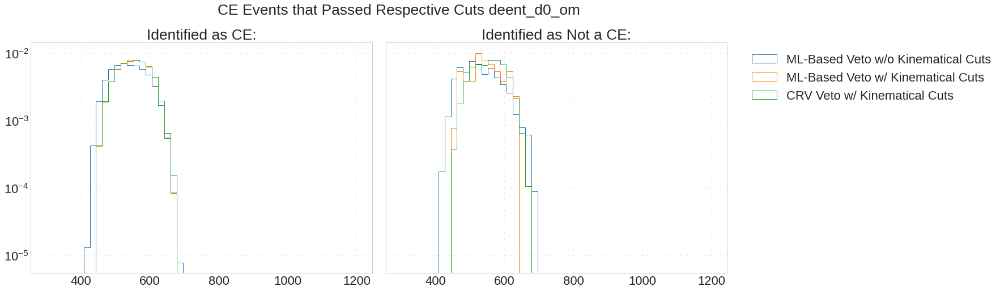

In [ ]:
nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut = createCutDistributions(nproton, nprotonCUT, plot=True)

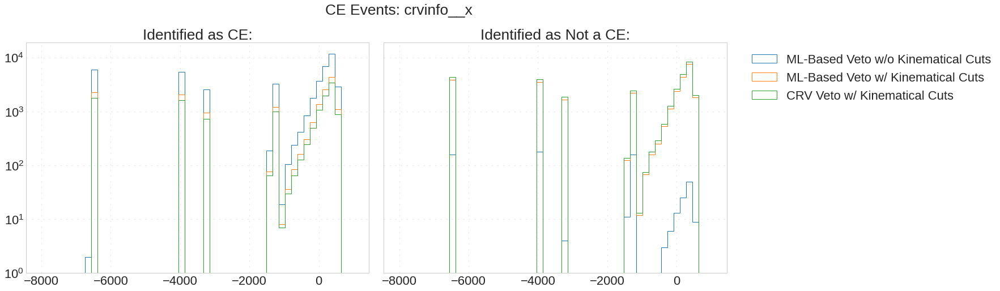

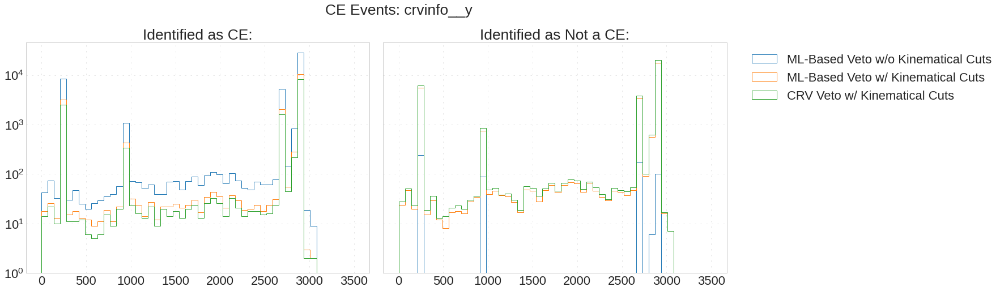

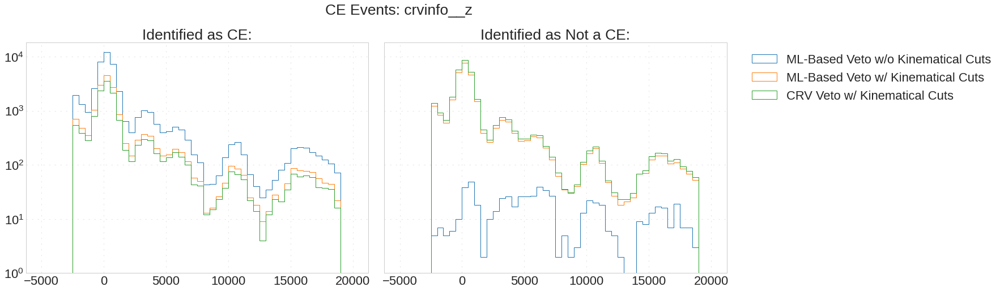

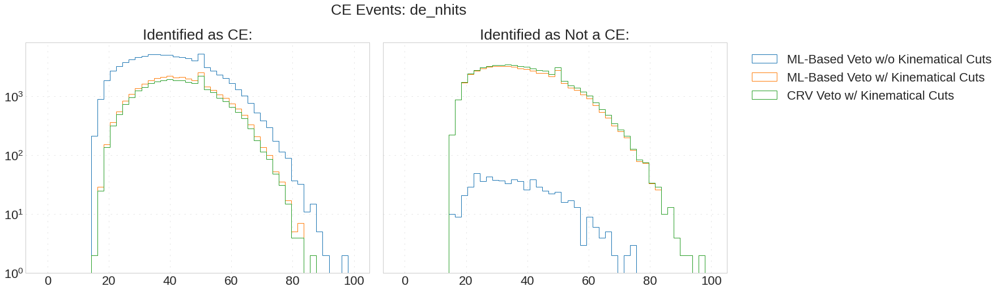

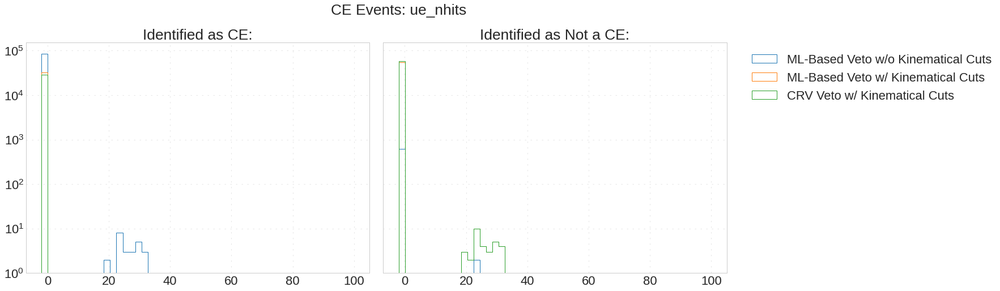

...

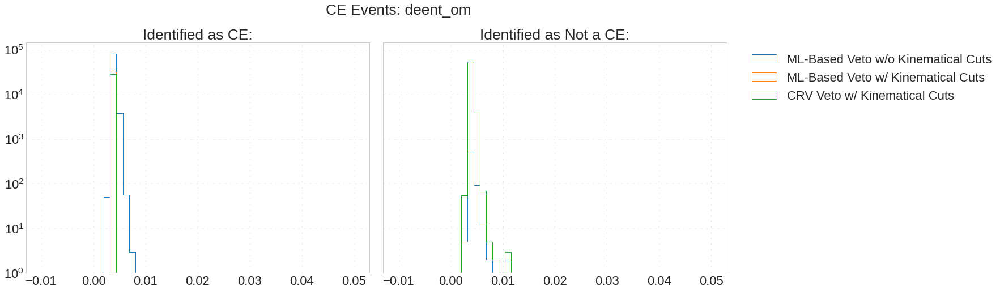

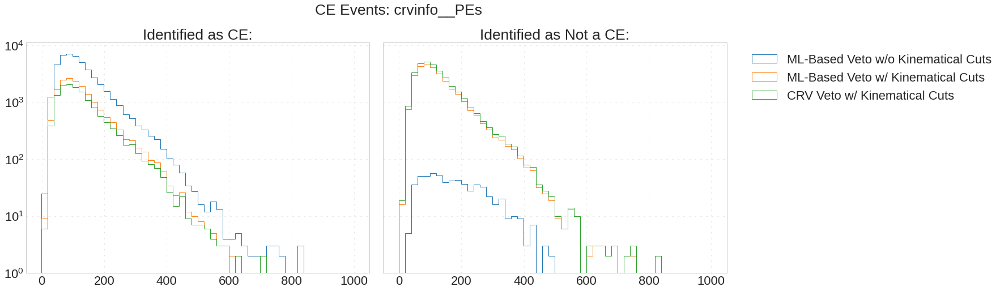

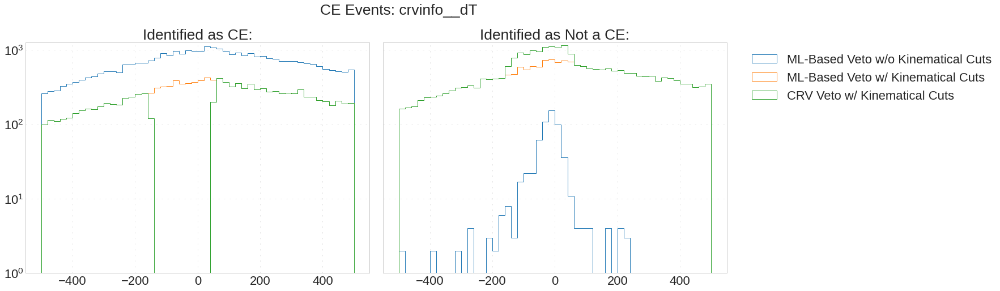

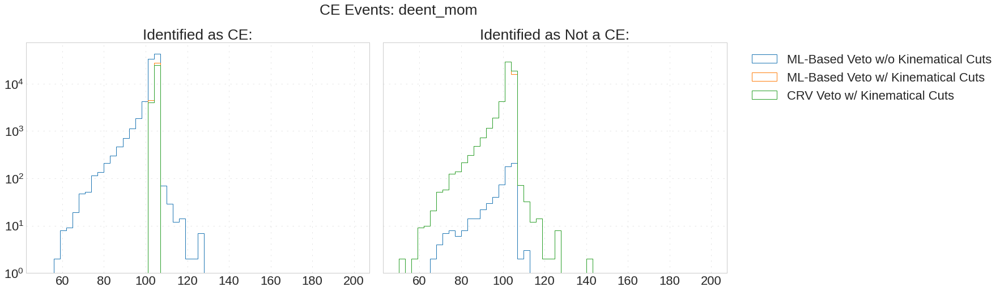

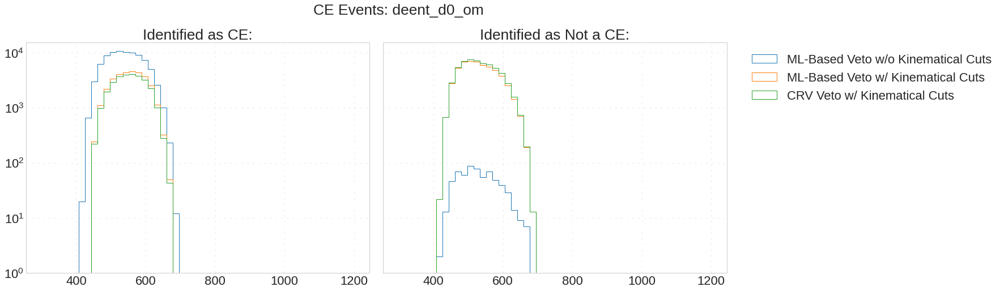

In [ ]:
nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut = createCutDistributions(nproton, nprotonCUTBIG, plot=True, dense=False)

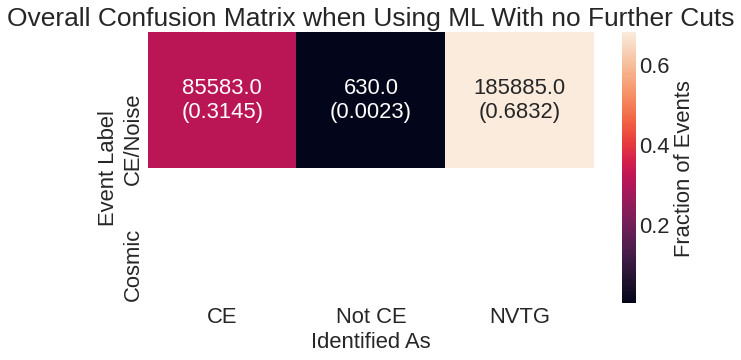

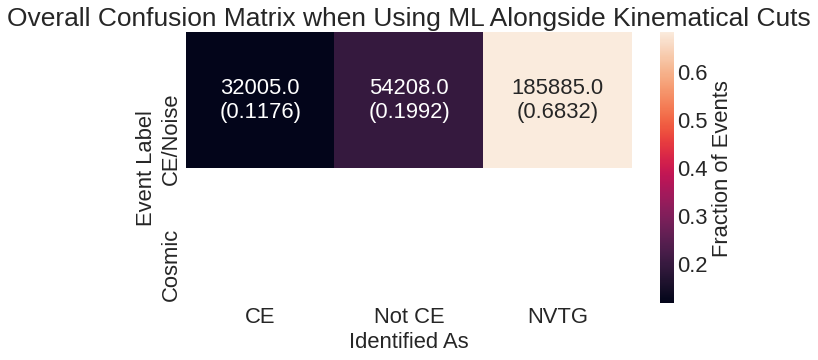

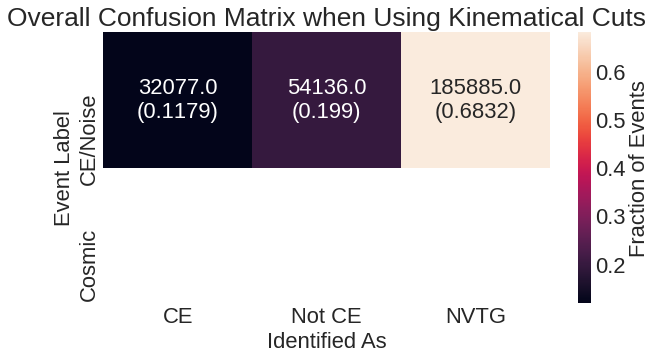

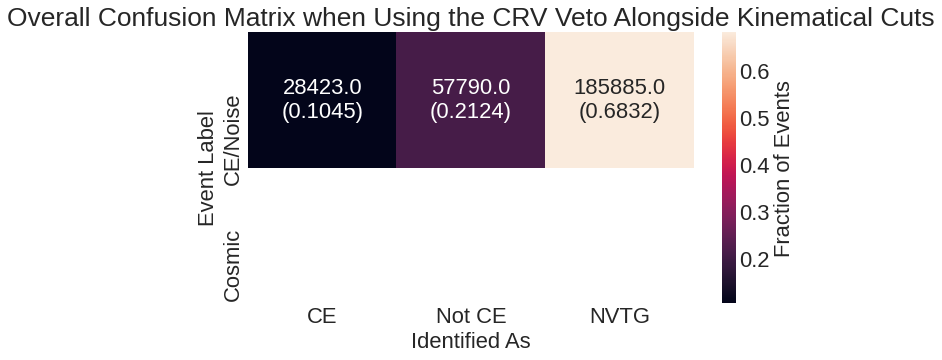

In [ ]:
MoarMatrix(nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut)

In [ ]:
del nproton, nprotonMom, nprotonMLCuts, nprotoncutNoCRV, nprotonCut

#0.2e8 - 0.4e8 nproton distribution

In [ ]:
nproton = Overall.query('evtinfo__nprotons < 0.4e8 and evtinfo__nprotons > 0.2e8')
nprotonCUT = OverallCUT.query('evtinfo__nprotons < 0.4e8 and evtinfo__nprotons > 0.2e8')

nprotonCUTBIG = OverallCUTBig.query('evtinfo__nprotons < 0.4e8 and evtinfo__nprotons > 0.2e8')

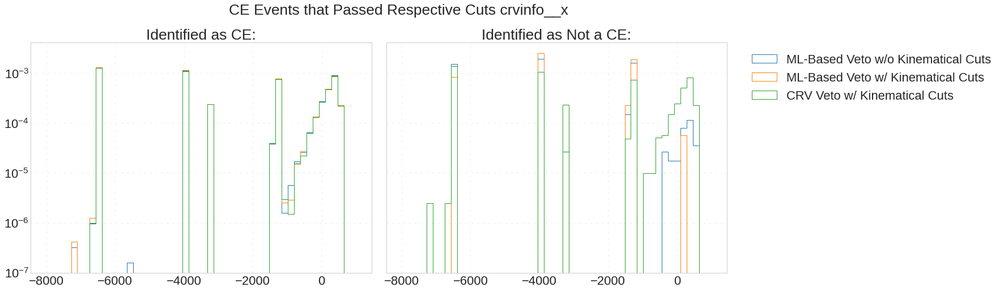

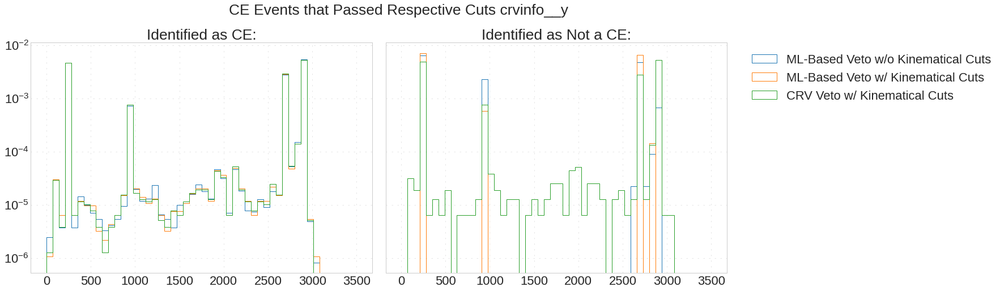

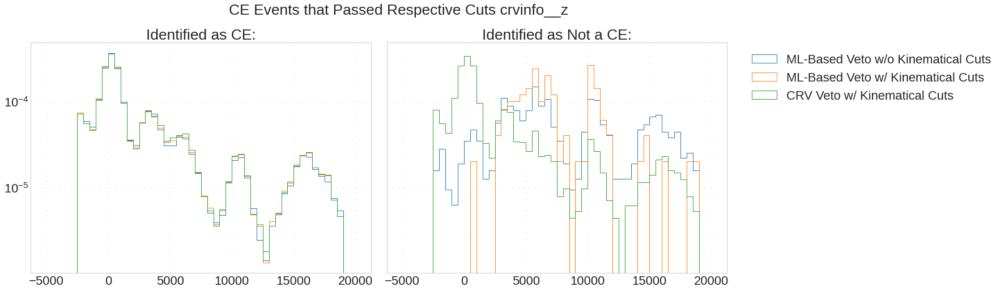

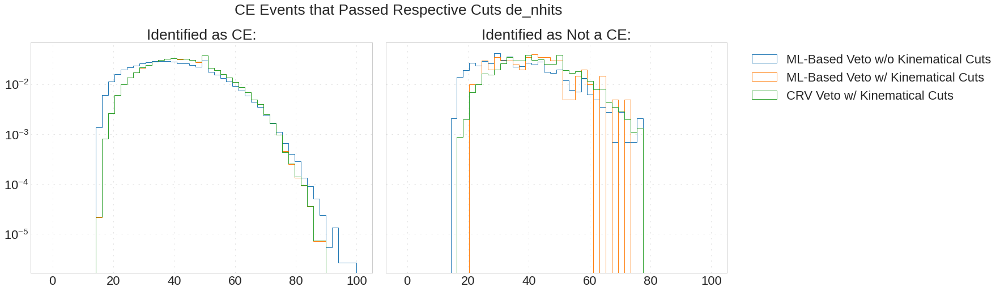

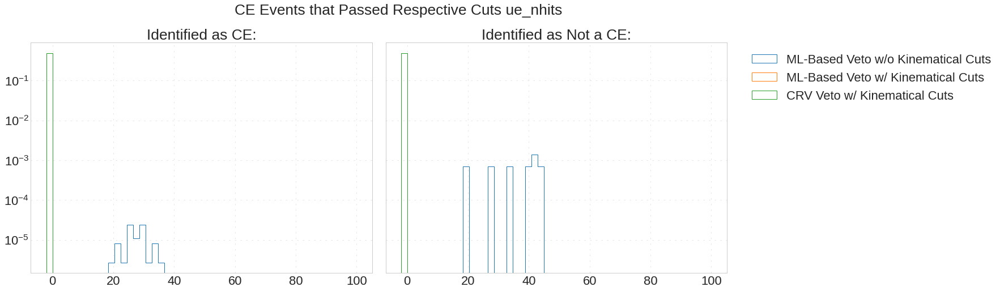

...

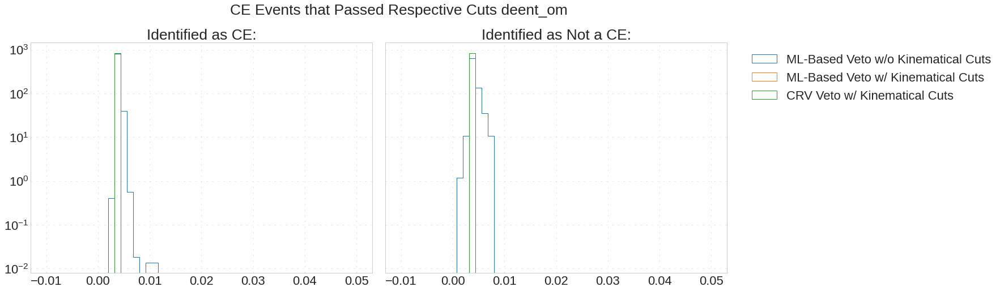

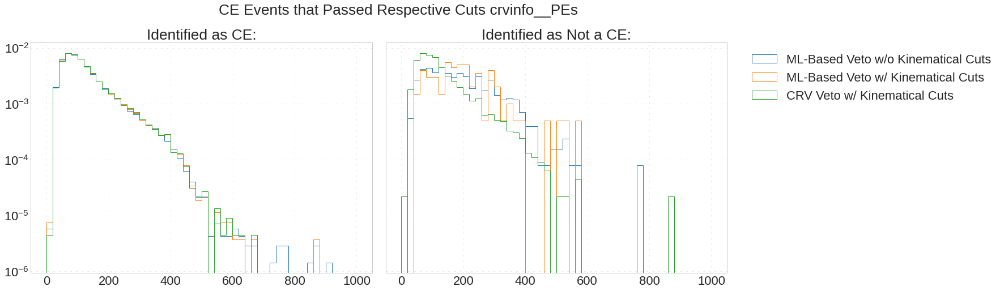

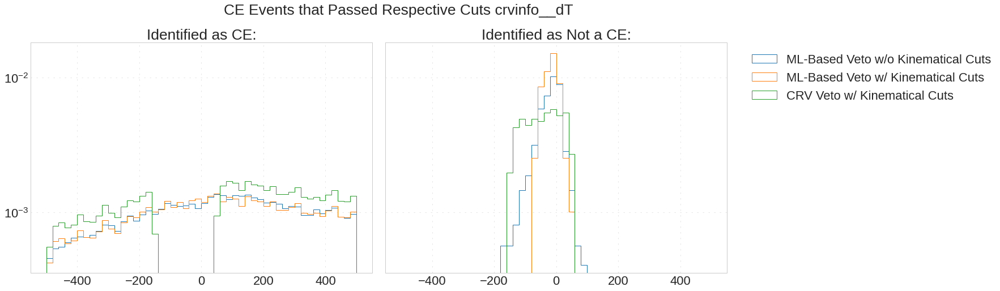

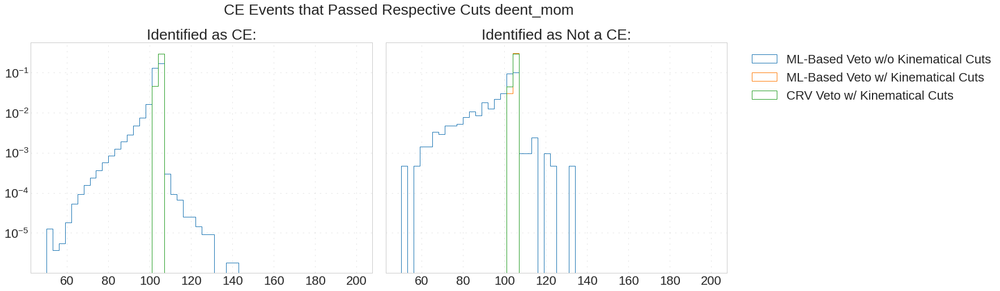

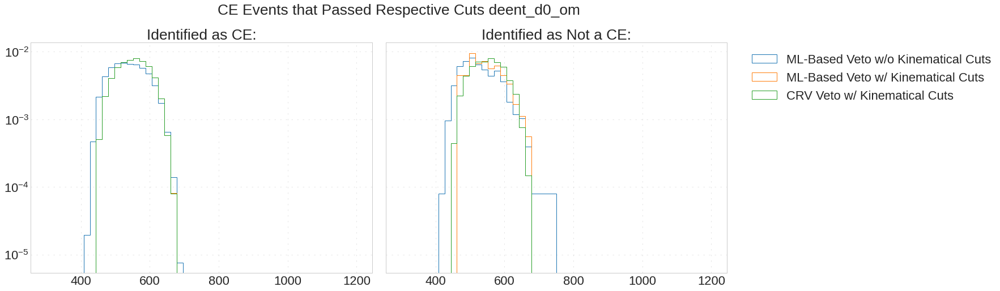

In [ ]:
nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut = createCutDistributions(nproton, nprotonCUT, plot=True)

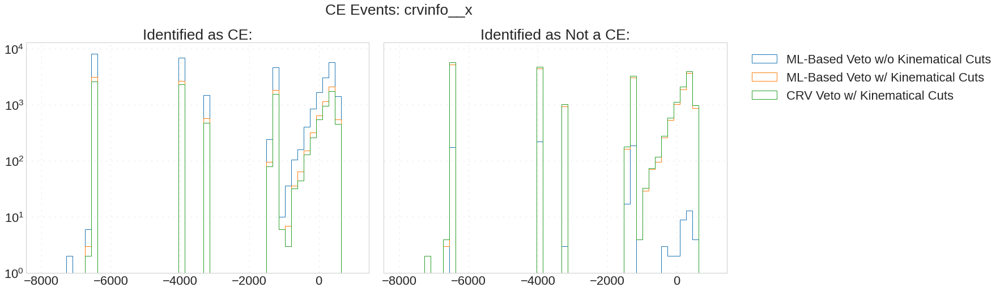

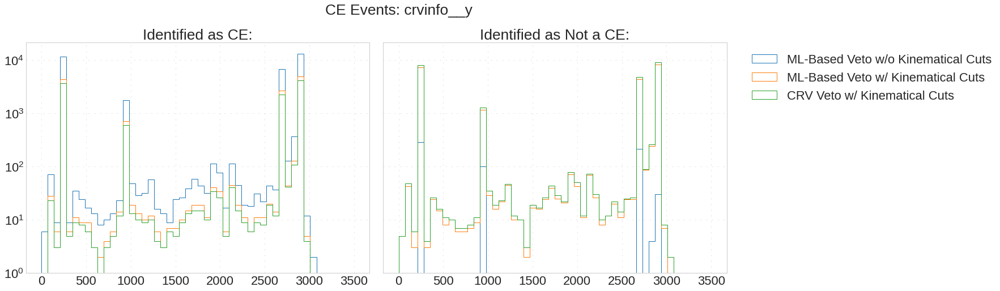

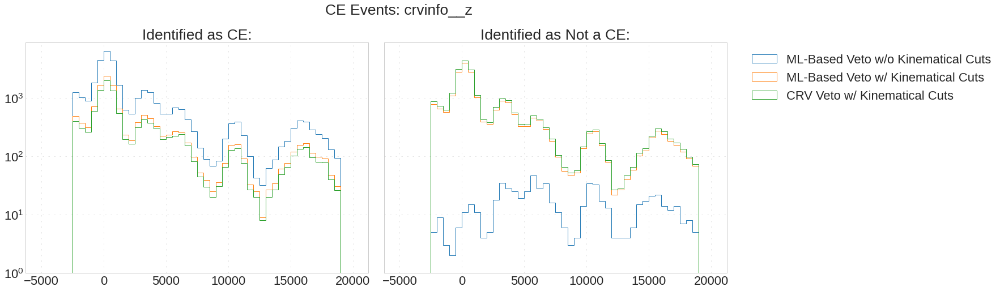

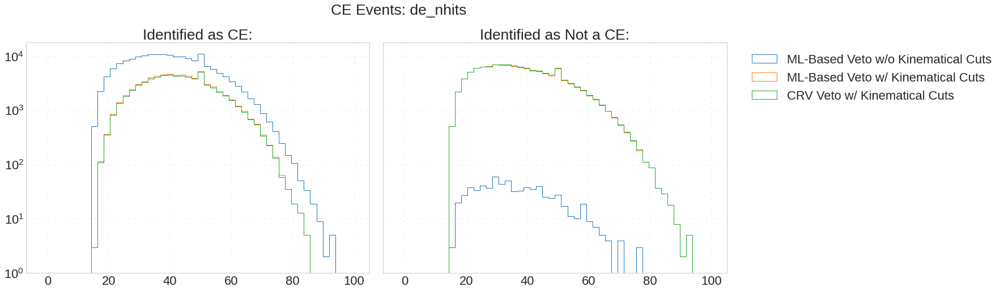

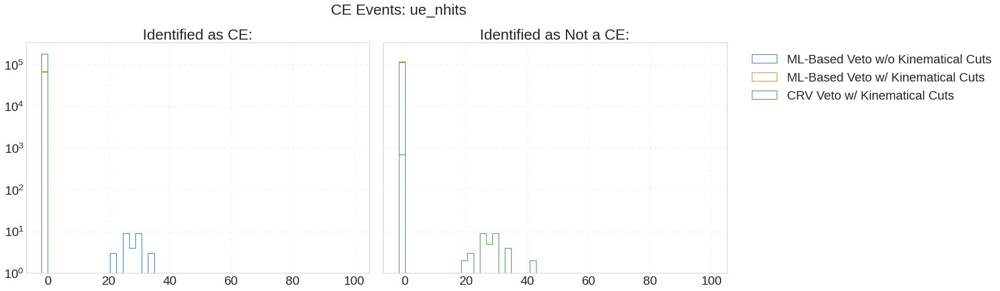

...

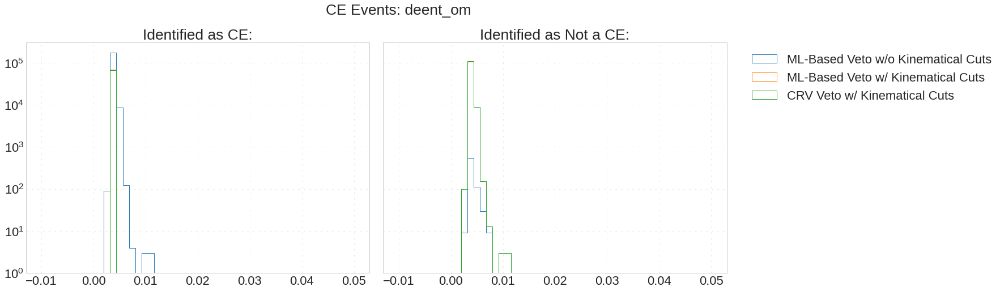

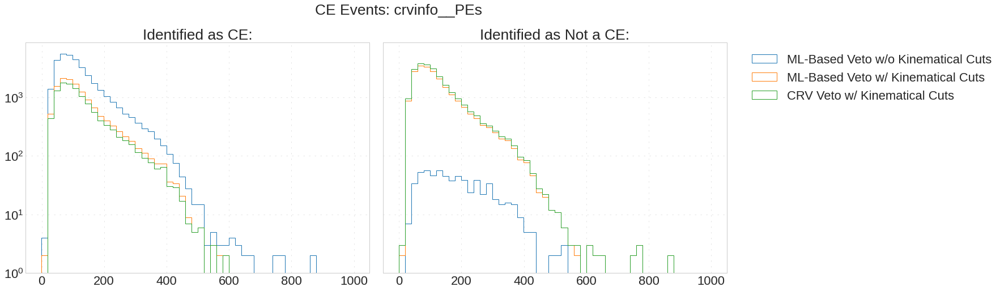

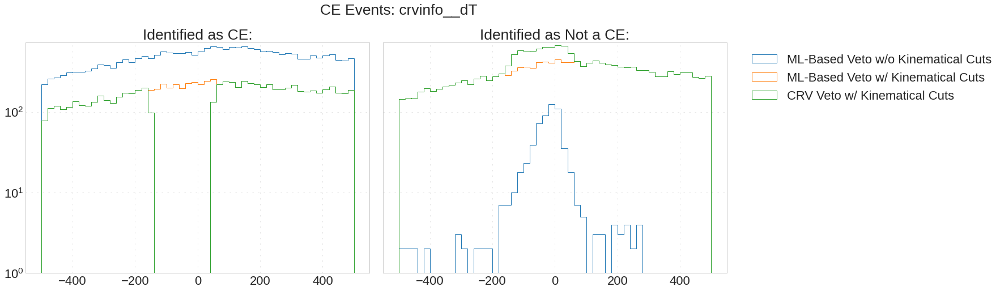

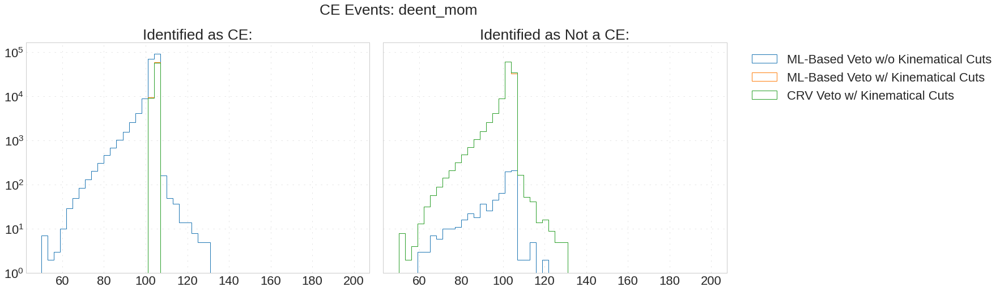

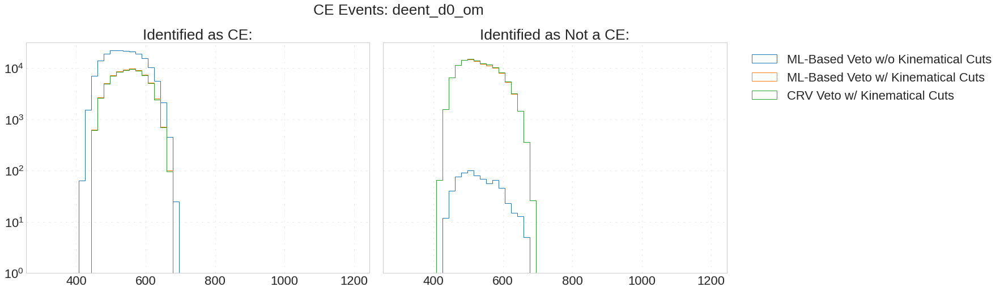

In [ ]:
nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut = createCutDistributions(nproton, nprotonCUTBIG, plot=True, dense=False)

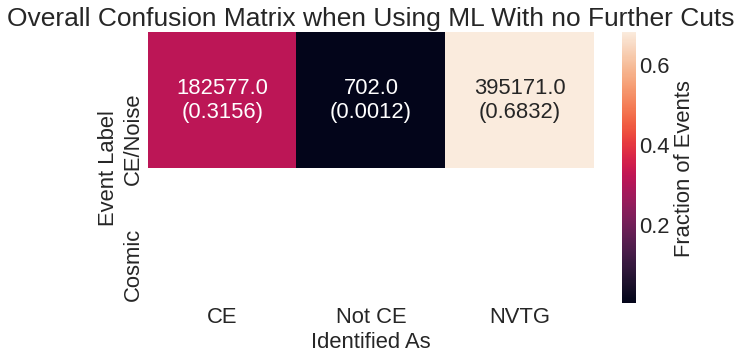

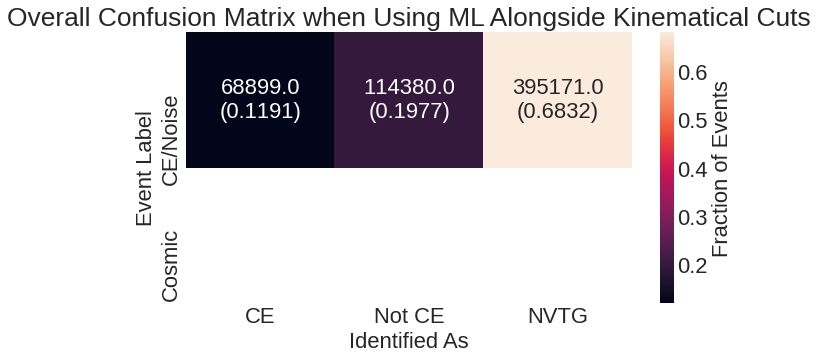

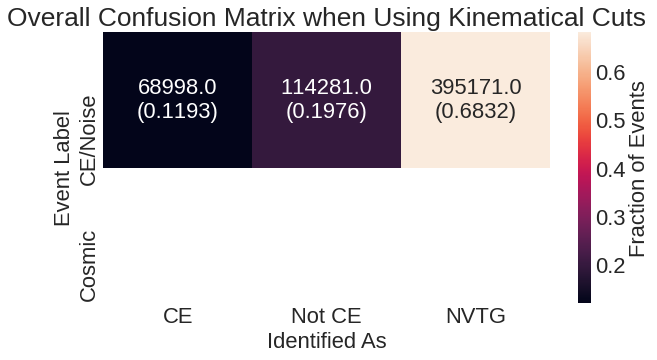

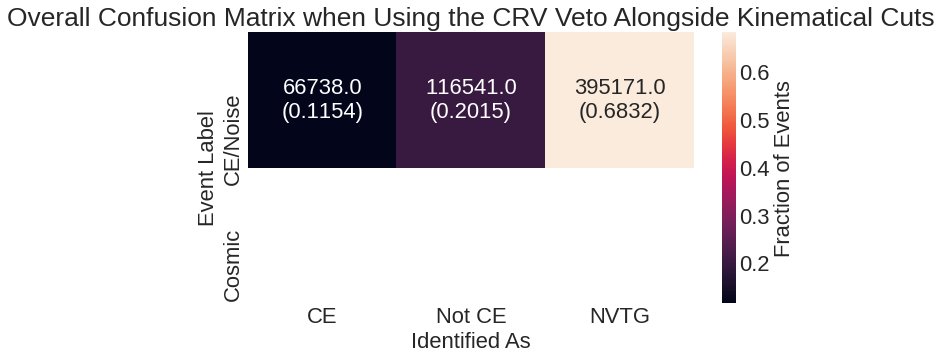

In [ ]:
MoarMatrix(nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut)

In [ ]:
del nproton, nprotonMom, nprotonMLCuts, nprotoncutNoCRV, nprotonCut

#0 - 0.2e8 nproton distribution

In [ ]:
nproton = Overall.query('evtinfo__nprotons < 0.2e8')
nprotonCUT = OverallCUT.query('evtinfo__nprotons < 0.2e8')

nprotonCUTBIG = OverallCUTBig.query('evtinfo__nprotons < 0.2e8')

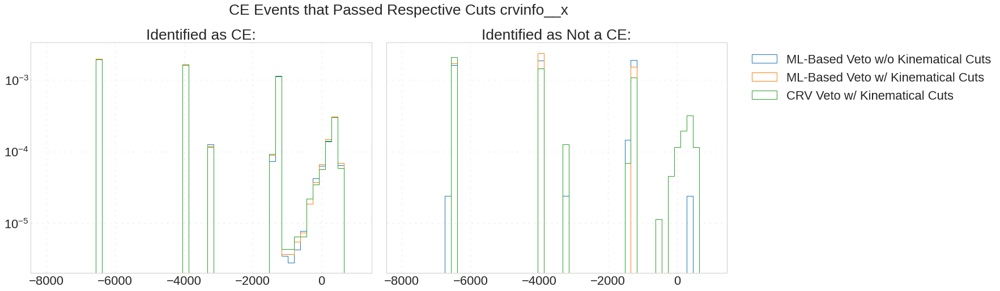

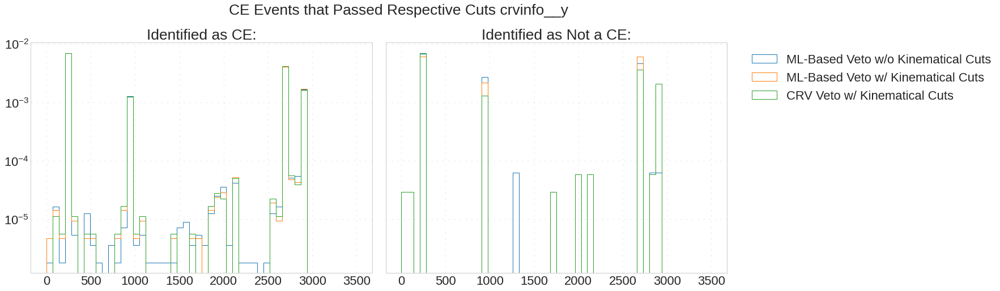

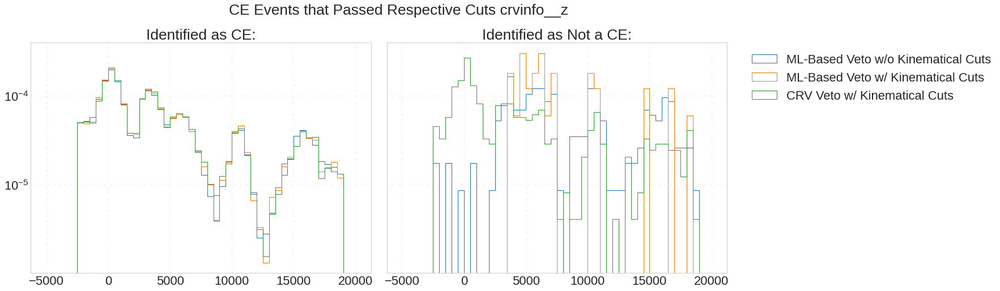

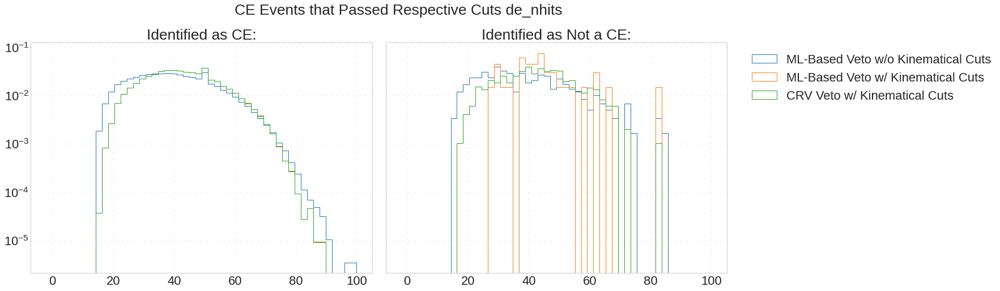

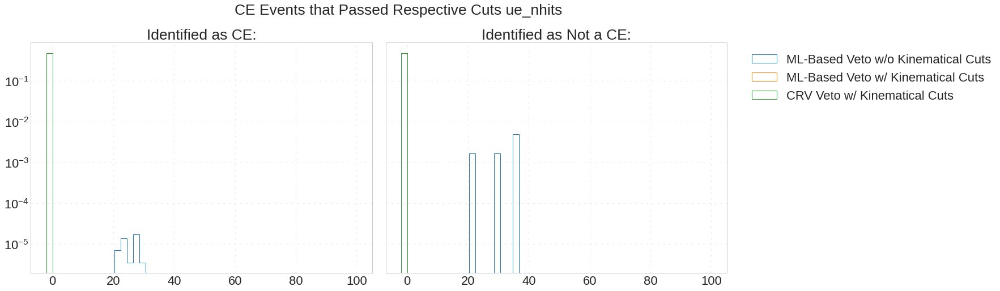

...

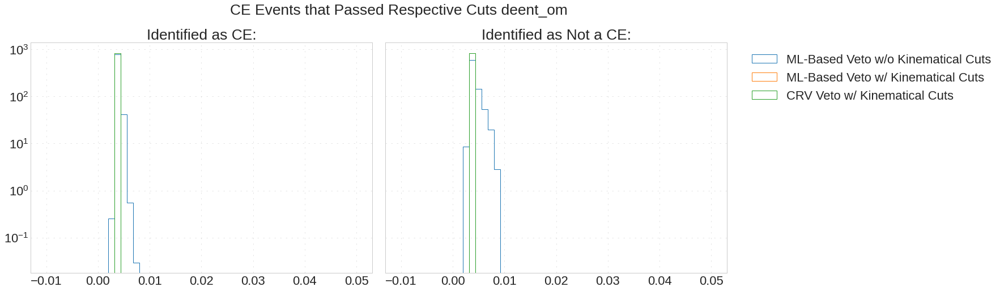

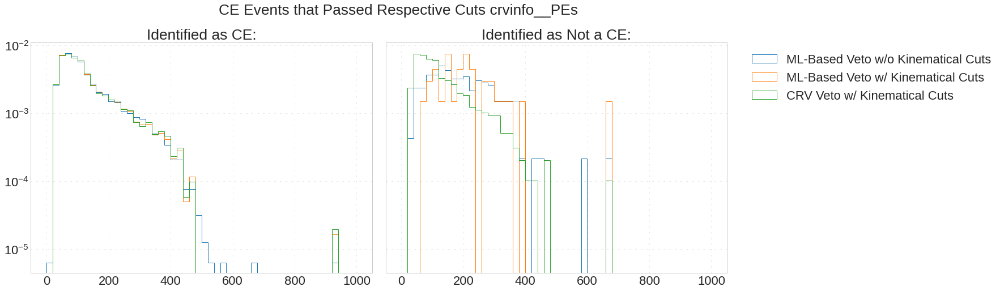

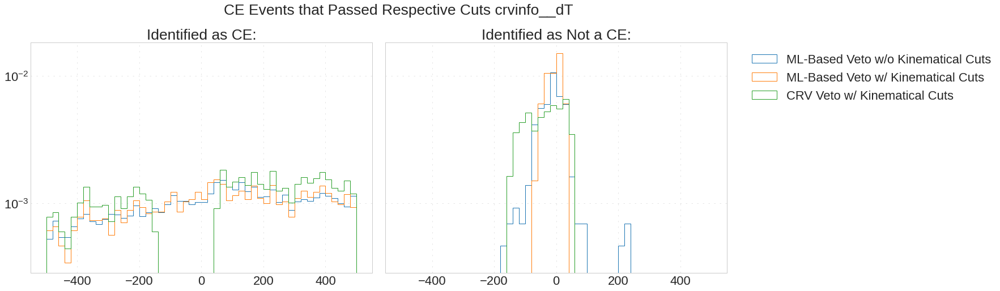

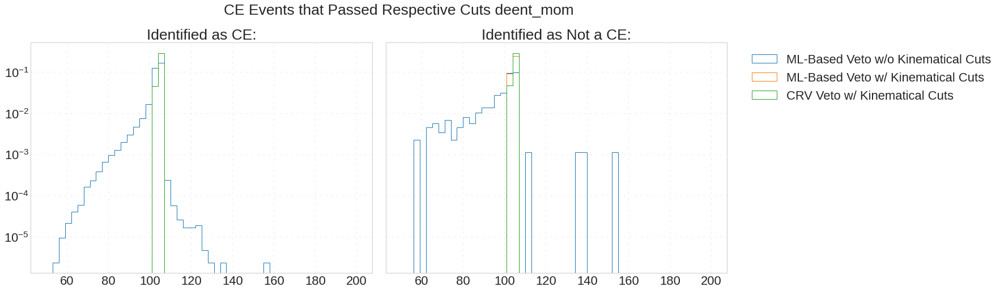

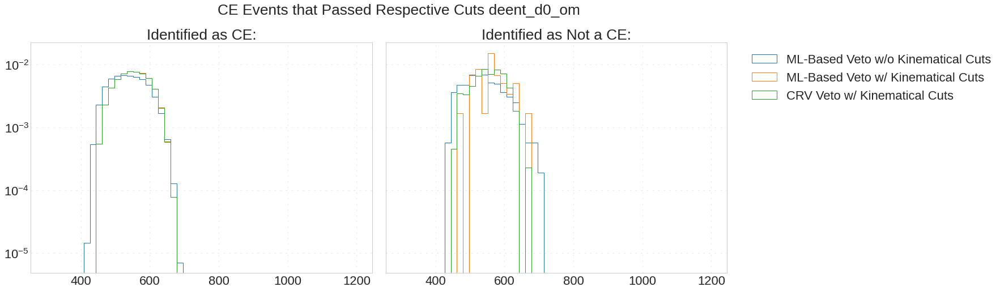

In [ ]:
nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut = createCutDistributions(nproton, nprotonCUT, plot=True)

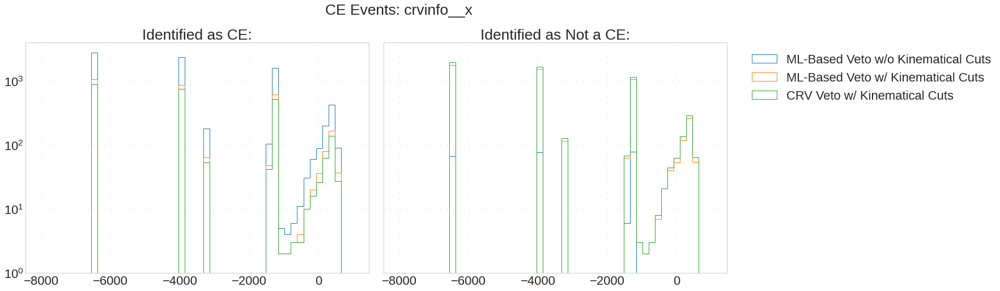

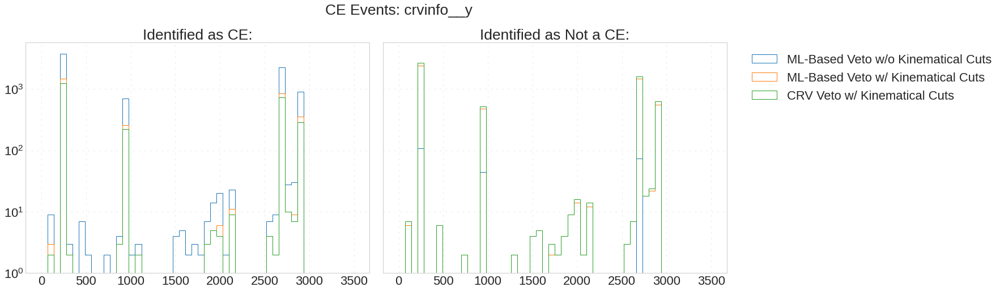

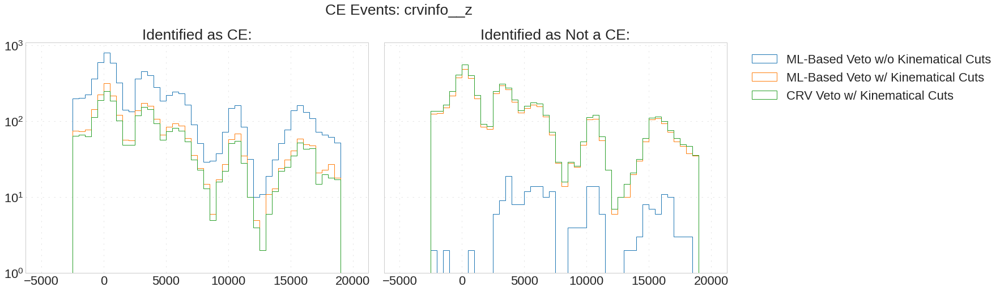

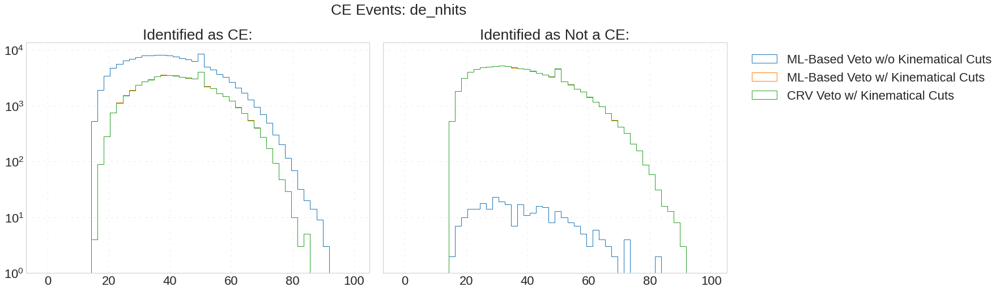

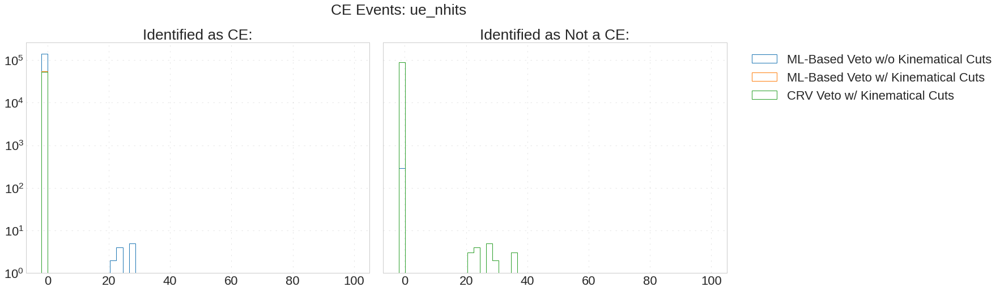

...

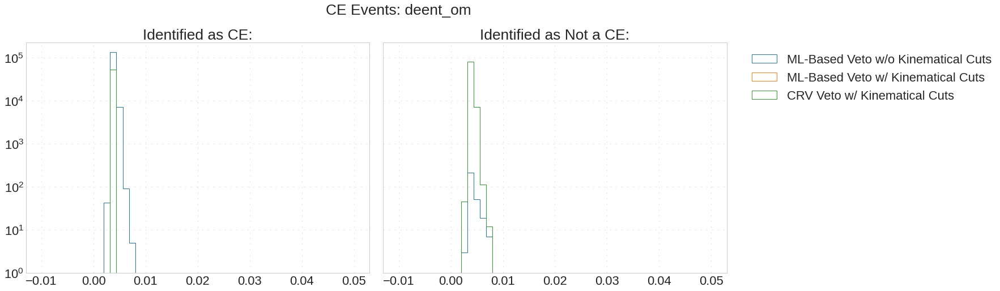

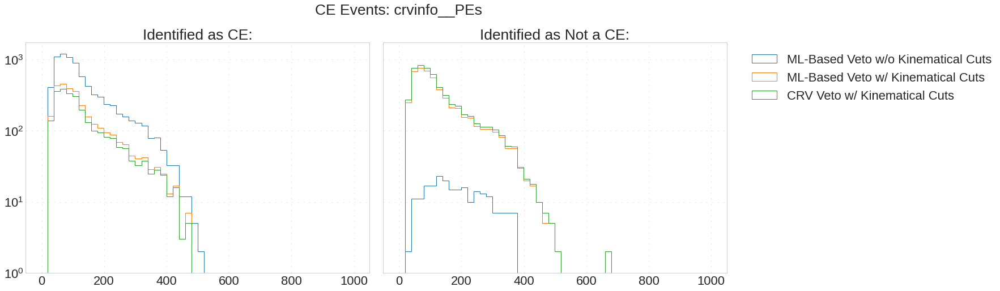

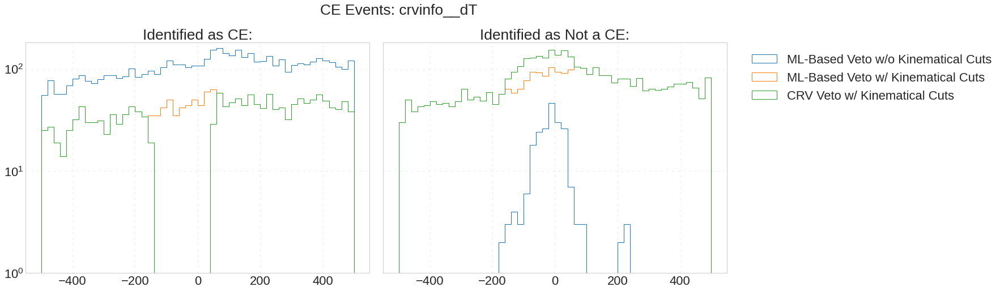

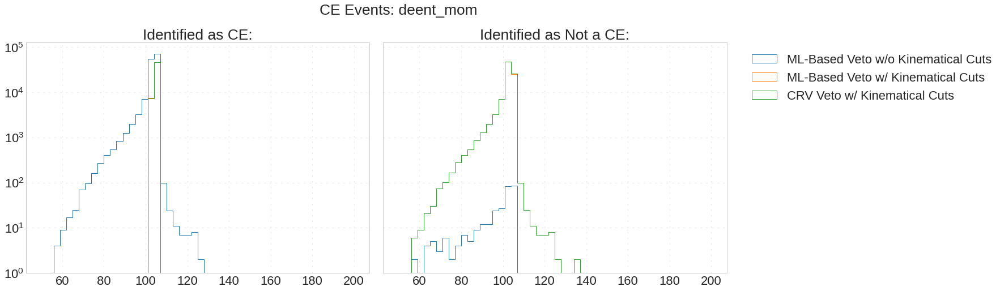

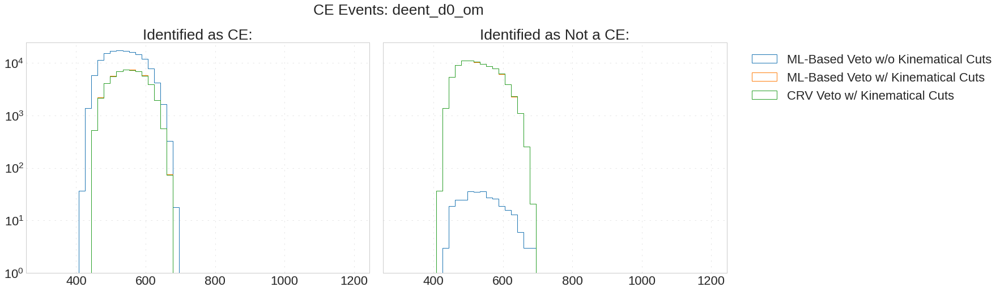

In [ ]:
nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut = createCutDistributions(nproton, nprotonCUTBIG, plot=True, dense=False)

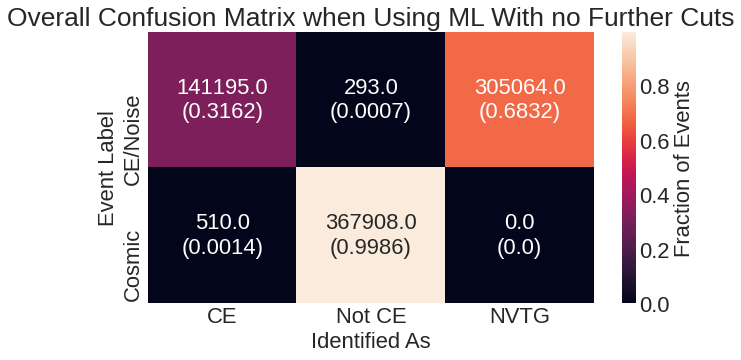

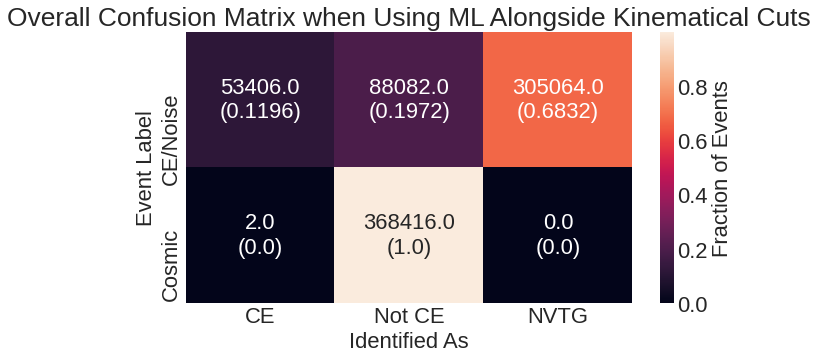

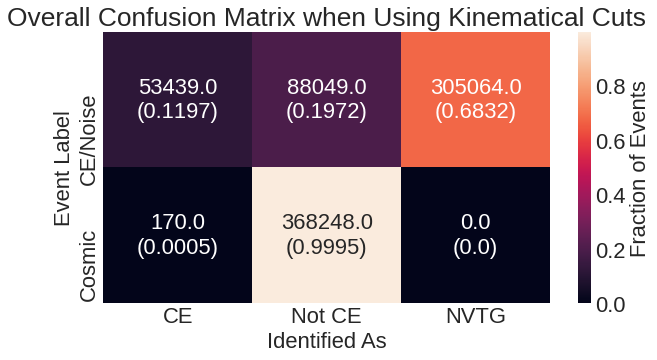

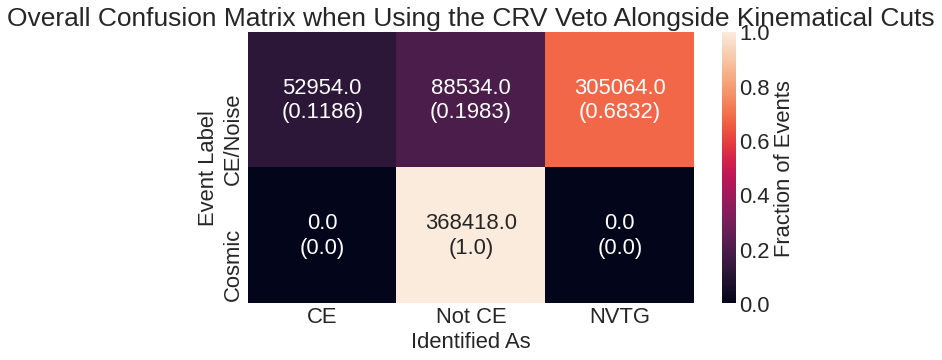

In [ ]:
MoarMatrix(nproton, nprotonMLCuts, nprotoncutNoCRV, nprotonCut)

In [ ]:
del nproton, nprotonMom, nprotonMLCuts, nprotoncutNoCRV, nprotonCut

#Plotting Deadtime and CRV Efficiency VS Beam Intensity

In [6]:
BI_eff_data = pd.read_csv(main_path+"Saved_Data/deadtime_nproton.csv")
# nprotonRanges = []
# for n,i in enumerate(BI_eff_data["nproton"]):
  # BI_eff_data["nproton"][n] = str(round(i-0.2,1)) + "-" + str(i)
BI_eff_data

,nproton,kinem_eff,kinem_eff%,veto_eff,veto_eff%,veto_dead,ML_eff,ML_eff%,ML_dead
0,0.1,53439,0.1,52954,0.1,0.0,53406,0.1,0.0
1,0.3,68998,0.1,66738,0.1,0.0,68899,0.1,0.0
2,0.5,32077,0.1,28423,0.1,0.1,32005,0.1,0.0
3,0.7,14191,0.1,9916,0.1,0.3,14121,0.1,0.0
4,0.9,6673,0.1,3057,0.1,0.5,6635,0.1,0.0
5,1.1,3226,0.1,760,0.0,0.8,3203,0.1,0.0


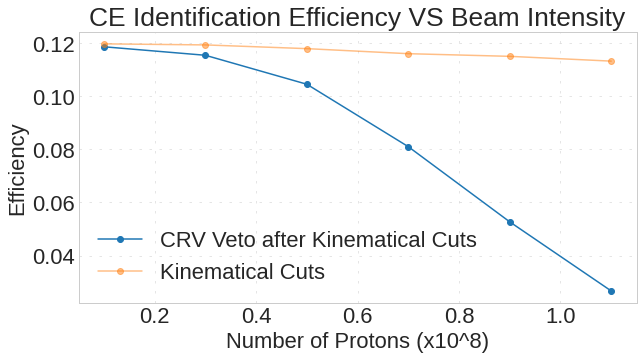

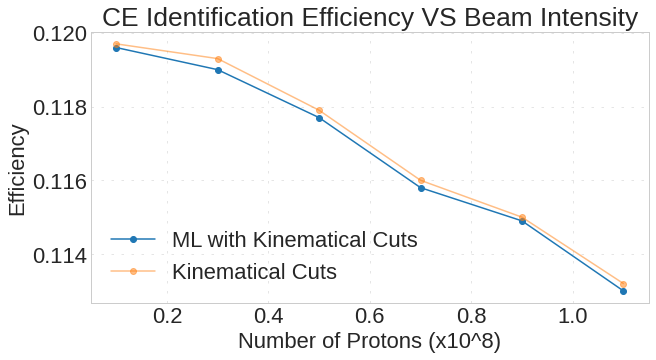

In [7]:
plt.plot(BI_eff_data["nproton"], BI_eff_data["veto_eff%"], label="CRV Veto after Kinematical Cuts", marker='o');
plt.plot(BI_eff_data["nproton"], BI_eff_data["kinem_eff%"], label="Kinematical Cuts", marker='o', alpha=0.5);
plt.legend(loc='best');
# plt.yscale('log');
plt.title("CE Identification Efficiency VS Beam Intensity");
plt.ylabel("Efficiency");
plt.xlabel("Number of Protons (x10^8)");

plt.figure();

plt.plot(BI_eff_data["nproton"], BI_eff_data["ML_eff%"], label="ML with Kinematical Cuts", marker='o');
plt.plot(BI_eff_data["nproton"], BI_eff_data["kinem_eff%"], label="Kinematical Cuts", marker='o', alpha=0.5);
plt.legend(loc='best');
# plt.yscale('log');
plt.title("CE Identification Efficiency VS Beam Intensity");
plt.ylabel("Efficiency");
plt.xlabel("Number of Protons (x10^8)");

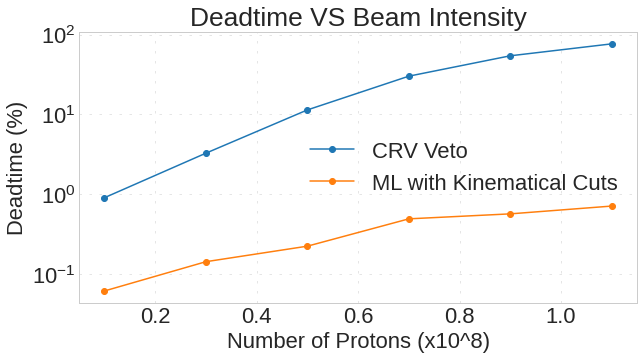

In [13]:
plt.plot(BI_eff_data["nproton"], BI_eff_data["veto_dead"]*100, label="CRV Veto", marker='o');
plt.plot(BI_eff_data["nproton"], BI_eff_data["ML_dead"]*100, label="ML with Kinematical Cuts", marker='o');
plt.legend(loc='best');
plt.yscale('log');
plt.title("Deadtime VS Beam Intensity");
plt.ylabel("Deadtime (%)");
plt.xlabel("Number of Protons (x10^8)");

#Legacy Code

In [ ]:
# Vetoed = Overall.query('not (' + cut_extmom + ')') #These are automatically shoved into the cosmic category
# NotVetoed = Overall.query(cut_extmom) #These are whatever

In [ ]:
# VetoedMom = Overall.query('not (' + cut_extmom_orig + ')') #These are automatically shoved into the cosmic category
# NotVetoedMom = Overall.query(cut_extmom_orig) #These are whatever

In [ ]:
# VetoedCut = Overall.query('not (' + crv_time + " & " + cut_extmom+ ')')
# NotVetoedCut = Overall.query('(' + crv_time + " & " + cut_extmom+ ')')

In [ ]:
# VetoedAssignment = Vetoed.assign(Predictions=1)
# VetoedAssignmentCut = VetoedCut.assign(Predictions=1)
# NotVetoedAssignmentCut = NotVetoedCut.assign(Predictions=0)
# VetoedAssignmentMom = VetoedMom.assign(Predictions=1)

In [ ]:
# OverallCuts = VetoedAssignment.append(NotVetoed).reset_index(drop=True)
# OverallCut = VetoedAssignmentCut.append(NotVetoedAssignmentCut).reset_index(drop=True)
# OverallMom = VetoedAssignmentMom.append(NotVetoedMom).reset_index(drop=True)
# del VetoedAssignment, VetoedAssignmentCut, NotVetoedAssignmentCut, VetoedAssignmentMom

In [ ]:
# for var in all_variables_list.keys():
#   fig, ax = plt.subplots(1,2, sharey=True, figsize=(25,7));
#   ax[0].hist(Overall.query('(is_cosmic==0) and (Predictions == 0)')[var], range=all_variables_list[var], histtype='step', bins=50, label="ML w/o Cuts");
#   ax[0].hist(OverallMom.query('(is_cosmic==0) and (Predictions == 0)')[var], range=all_variables_list[var], histtype='step', bins=50, label="ML w/ Momentum Cut");
#   ax[0].hist(OverallCuts.query('(is_cosmic == 0) and (Predictions == 0)')[var], range=all_variables_list[var], histtype='step', bins=50, label="ML with All Cuts", alpha=0.7);
#   ax[0].hist(OverallCut.query('(is_cosmic == 0) and (Predictions == 0)')[var], range=all_variables_list[var], histtype='step', bins=50, label="Just Cuts w/ Time Cut", alpha=0.3);
#   # ax[0].legend(bbox_to_anchor=(0, 1.02, 1, 0.2), loc="lower left", ncol=2);
#   ax[0].set_yscale('log');
#   ax[0].set_title("Identified as CE/Noise:");
#   ax[0].set_ylim(bottom=1);

#   ax[1].hist(Overall.query('(is_cosmic==0) and (Predictions == 1)')[var], range=all_variables_list[var], histtype='step', bins=50, label="ML w/o Cuts");
#   ax[1].hist(OverallMom.query('(is_cosmic==0) and (Predictions == 1)')[var], range=all_variables_list[var], histtype='step', bins=50, label="ML w/ Momentum Cut");
#   ax[1].hist(OverallCuts.query('(is_cosmic==0) and (Predictions == 1)')[var], range=all_variables_list[var], histtype='step', bins=50, label="ML with Cuts", alpha=0.7);
#   ax[1].hist(OverallCut.query('(is_cosmic==0) and (Predictions == 1)')[var], range=all_variables_list[var], histtype='step', bins=50, label="Cut Based", alpha=0.3);
#   ax[1].legend(bbox_to_anchor=(1.04, 1), loc="upper left");
#   ax[1].set_yscale('log');
#   ax[1].set_title("Identified as Cosmic Muon:");
#   ax[1].set_ylim(bottom=1);
#   fig.suptitle("Noise/CE Events: " + var, x=0.4);
#   plt.tight_layout();
#   plt.show();

In [ ]:
# cutsNoCRV = Vetoed.assign(Predictions=1).append(NotVetoed.assign(Predictions=0)).reset_index(drop=True)

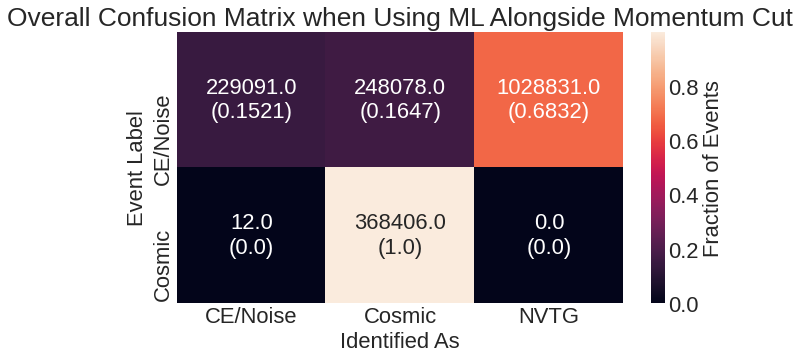

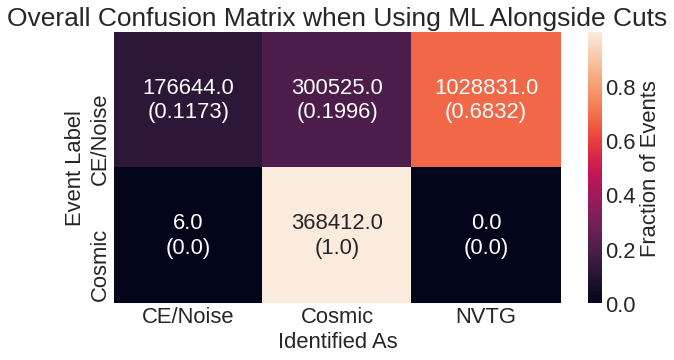

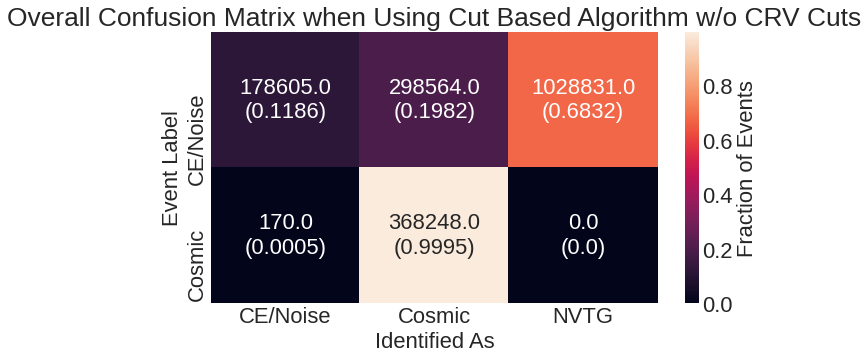

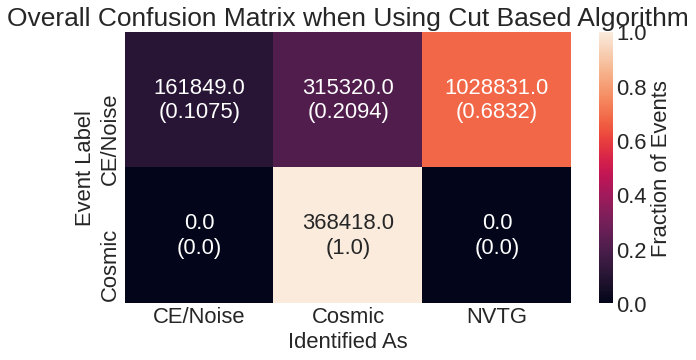

In [ ]:
ax = sns.heatmap(momPercentage, annot=momNewEffs, xticklabels=["CE/Noise", "Cosmic", "NVTG"], yticklabels=["CE/Noise", "Cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'})
ax.set(title="Overall Confusion Matrix when Using ML Alongside Momentum Cut",
      xlabel="Identified As",
      ylabel="Event Label",);

plt.figure();

ax = sns.heatmap(percentage, annot=newEffs, xticklabels=["CE/Noise", "Cosmic", "NVTG"], yticklabels=["CE/Noise", "Cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'})
ax.set(title="Overall Confusion Matrix when Using ML Alongside Cuts",
      xlabel="Identified As",
      ylabel="Event Label",);

plt.figure();

ax = sns.heatmap(noCRVCutPercentage, annot=noCRVCutNewEffs, xticklabels=["CE/Noise", "Cosmic", "NVTG"], yticklabels=["CE/Noise", "Cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'})
ax.set(title="Overall Confusion Matrix when Using Cut Based Algorithm w/o CRV Cuts",
      xlabel="Identified As",
      ylabel="Event Label",);

plt.figure();

ax = sns.heatmap(cutPercentage, annot=cutNewEffs, xticklabels=["CE/Noise", "Cosmic", "NVTG"], yticklabels=["CE/Noise", "Cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'})
ax.set(title="Overall Confusion Matrix when Using Cut Based Algorithm",
      xlabel="Identified As",
      ylabel="Event Label",);

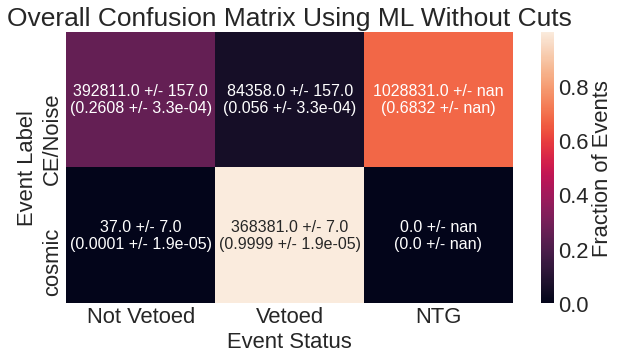

In [ ]:
tot_matrix = CRVconf_matrix + noCRVconf_matrix
divisor = np.array([0.2*superTotal, tot_matrix[1][0] + tot_matrix[1][1]])

tot_matrix = np.concatenate((tot_matrix, np.array([[divisor[0] - (tot_matrix[0][0] + tot_matrix[0][1])], [divisor[1] - (tot_matrix[1][0] + tot_matrix[1][1])]])), axis=1 )

fractional_overall = tot_matrix/divisor[:,None]

error_overall = CRVmatrix_errors + noCRVmatrix_errors
error_overall = np.concatenate((error_overall, np.array([[np.nan],[np.nan]])), axis=1)

plt.figure();
newEffs = np.array([['0'*50,'0'*50,'0'*50],['0'*50,'0'*50,'0'*50]])

counter = 0
for i,j,z in zip(tot_matrix, error_overall, fractional_overall):
  i = np.round(i)
  j = np.round(j)
  z = np.round(z,4)
  jj = np.round(j/(i[0]+i[1]),6)
  newEffs[counter][0] = str(i[0]) + " +/- " + str(j[0])
  newEffs[counter][0] += '\n(' + str(z[0]) + " +/- " + str('%.1e' %Decimal(jj[0])) + ')'
  newEffs[counter][1] = str(i[1]) + " +/- " + str(j[1])
  newEffs[counter][1] += '\n(' + str(z[1]) + " +/- " + str('%.1e' %Decimal(jj[1])) + ')'
  newEffs[counter][2] = str(i[2]) + " +/- " + str(j[2])
  newEffs[counter][2] += '\n(' + str(z[2]) + " +/- " + str('%.1e' %Decimal(jj[2])) + ')'
  counter += 1

ax = sns.heatmap(fractional_overall, annot=newEffs, xticklabels=["CE/Noise", "Cosmic", "NVTG"], yticklabels=["CE/Noise", "Cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'}, annot_kws={"fontsize":16});

ax.set(title="Overall Confusion Matrix Using ML Without Cuts",
      xlabel="Identified As",
      ylabel="Event Label",);

In [ ]:
# plt.hist(everythingBagel.event_errors, density=True, bins=50, histtype='step', label='all');
# plt.hist(halfBagel.event_errors, density=True, bins=50, histtype='step', label='all no crv variables');
# plt.hist(np.std(CRVpredictions, axis=0), density=True, bins=50, histtype='step', label='Coincidence Data');
# plt.hist(np.std(noCRVpredictions, axis=0), density=True, bins=50, histtype='step', label='No Coincidence Data');
# plt.yscale('log');
# plt.legend();

In [ ]:
# everythingWatcher = ww.WeightWatcher(model=everythingBagel.model);
# everythingDetails = everythingWatcher.analyze();
# everythingSummary = everythingWatcher.get_summary(everythingDetails);

In [ ]:
# allnoCRVWatcher = ww.WeightWatcher(model=halfBagel.model);
# allnoCRVDetails = allnoCRVWatcher.analyze();
# allnoCRVSummary = allnoCRVWatcher.get_summary(allnoCRVDetails);

In [ ]:
# CRVWatcher = ww.WeightWatcher(model=cinnamonBagel.model);
# CRVDetails = CRVWatcher.analyze();
# CRVSummary = CRVWatcher.get_summary(CRVDetails);

In [ ]:
# outWatcher = ww.WeightWatcher(model=plainBagel.model);
# outDetails = outWatcher.analyze();
# outSummary = outWatcher.get_summary(outDetails);

In [ ]:
# ww_translation = {
# 'alpha':'Alpha',
# 'alpha_weighted':'Alpha*log Max Eigenvalue',
# 'log_alpha_norm':'log sum(Eigenvalue^Alpha)',
# 'log_norm':'log sqrt(Layer Eigenvalue Sum)',
# 'log_spectral_norm': 'log sqrt(Max Layer Eigenvalue)',
# 'stable_rank': 'Stable Rank'
# }

# ww_titles = {
# 'alpha':'Alpha',
# 'alpha_weighted':'Weighted Alpha',
# 'log_alpha_norm':'log Alpha Norm',
# 'log_norm':'log Frobenius Norm',
# 'log_spectral_norm': 'log Spectral Norm',
# 'stable_rank': 'Stable Rank'
# }

In [ ]:
# def plotWWAtributes():
#   for i in CRVSummary.keys():
#     plt.figure(figsize=(10,7))
#     # plt.plot(everythingDetails['layer_id'], everythingDetails[i], marker='o', label='Everything', color='orange');
#     # plt.plot(allnoCRVDetails['layer_id'], allnoCRVDetails[i], marker='*', label="no CRV variables", color='red');
#     plt.plot(CRVDetails['layer_id'], CRVDetails[i], marker='D', label='Only Inside CRV', color='green');
#     plt.plot(outDetails['layer_id'], outDetails[i], marker='s', label='Only Outside CRV', color='blue');
#     # plt.gca().axhline(everythingSummary[i],0,1, color='orange');
#     # plt.gca().axhline(allnoCRVSummary[i],0,1, color='red');
#     plt.gca().axhline(CRVSummary[i],0,1, color='green');
#     plt.gca().axhline(outSummary[i],0,1, color='blue');
#     plt.legend(loc='best');
#     plt.xlabel('Layer ID');
#     plt.ylabel(ww_translation[i]);
#     plt.title(ww_titles[i] + ' of Different Models VS Layer ID and Their Averages');
#     # plt.tight_layout();
#     plt.show()

In [ ]:
# plotWWAtributes()

#low light yield Data

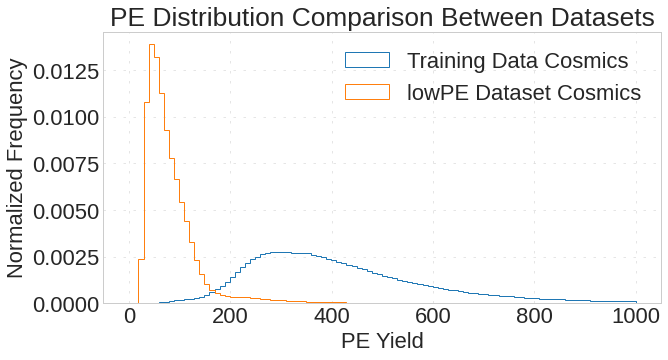

In [ ]:
plt.hist(df.query('(is_high == 0) or (is_high == 1)')['crvinfo__PEs'], bins=100, histtype='step', range=all_variables_list['crvinfo__PEs'], label='Training Data Cosmics', density=True);
plt.hist(lowLightYield['crvinfo__PEs'], bins=100, histtype='step', range=all_variables_list['crvinfo__PEs'], label='lowPE Dataset Cosmics', density=True);
plt.xlabel('PE Yield');
plt.ylabel('Normalized Frequency');
plt.title("PE Distribution Comparison Between Datasets")
plt.legend();

In [ ]:
# alllowLightYield = lowLightYield[variables_list.keys()]
# lowY = lowLightYield['is_cosmic']
# lowX = scaler.transform(alllowLightYield)

In [ ]:
# allnoCRVlowLightYield = lowLightYield[variables_list.keys()].drop(['crvinfo__z', 'crvinfo__PEs', 'crvinfo__dT'], axis=1)
# allnoCRVlowY = lowY
# allnoCRVlowX = allnoCRVscaler.transform(allnoCRVlowLightYield)

In [ ]:
CRVlowLightYield = lowLightYield.query('crvinfo__PEs >= -1')
CRVlowY = CRVlowLightYield['is_cosmic']
CRVlowX = CRVscaler.transform(CRVlowLightYield[variables_list.keys()])

In [ ]:
OutlowLightYield = lowLightYield.query('crvinfo__PEs < -1')
OutlowY = OutlowLightYield['is_cosmic']
OutlowX = OutlowLightYield[variables_list.keys()]
OutlowX.drop(['crvinfo__z', 'crvinfo__PEs', 'crvinfo__dT'], axis=1, inplace=True)
OutlowX = noCRVscaler.transform(OutlowX)

#Full model low light test (OUTDATED)

In [ ]:
stopgap, stopgappreds

In [ ]:
lightlySeasonedBagel = MLAnalyzer(variables_list, xTest=lowX, yTest=lowY, scaler=scaler, model=everythingBagel.model)

In [ ]:
lightlySeasonedBagel.avg_predictions, lightlySeasonedBagel.predictions = stopgap, stopgappreds

In [ ]:
lightlySeasonedBagel.predictMC(30)

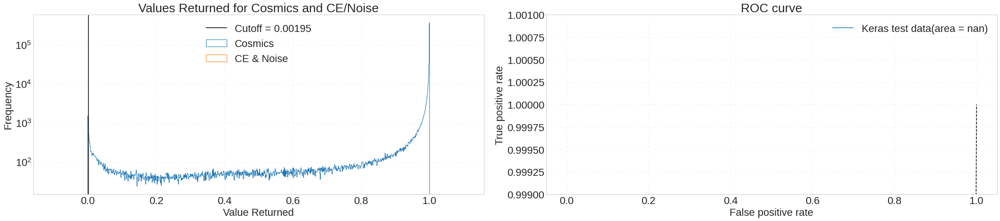

In [ ]:
lightlySeasonedBagel.cutoffTime(predefinedcutoff=everythingBagel.cutoff)

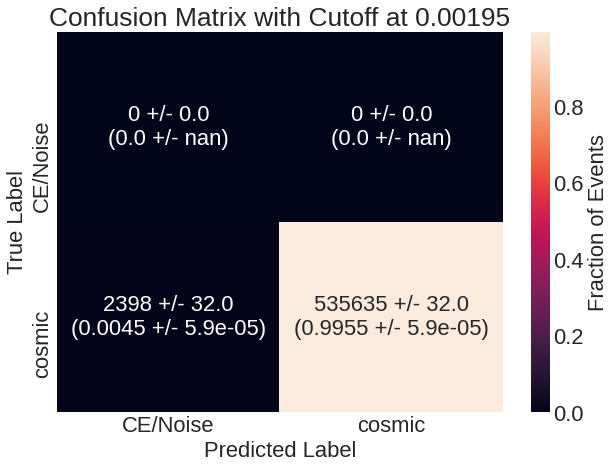

In [ ]:
lightlySeasonedBagel.finalConfusion()

#Full model no CRv variables low light test (OUTDATED)

In [ ]:
quarterBagel = MLAnalyzer(noCRV_noMom_variables_list, xTest = allnoCRVlowX, yTest=allnoCRVlowY, model=halfBagel.model, scaler=allnoCRVscaler)

In [ ]:
quarterBagel.predictMC(30)

16814/16814 [==============================] - 20s 1ms/step
iteration 1 done
16814/16814 [==============================] - 20s 1ms/step
iteration 2 done
16814/16814 [==============================] - 20s 1ms/step
iteration 3 done
16814/16814 [==============================] - 20s 1ms/step
iteration 4 done
16814/16814 [==============================] - 20s 1ms/step
iteration 5 done
16814/16814 [==============================] - 19s 1ms/step
iteration 6 done
16814/16814 [==============================] - 19s 1ms/step
iteration 7 done
16814/16814 [==============================] - 19s 1ms/step
iteration 8 done
16814/16814 [==============================] - 20s 1ms/step
iteration 9 done
16814/16814 [==============================] - 20s 1ms/step
iteration 10 done
16814/16814 [==============================] - 20s 1ms/step
iteration 11 done
16814/16814 [==============================] - 19s 1ms/step
iteration 12 done
16814/16814 [==============================] - 20s 1ms/step
iteration 13 

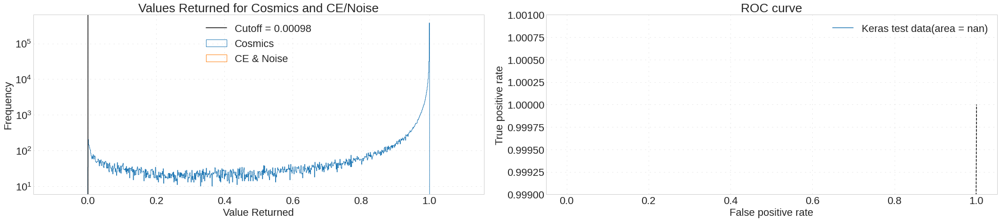

In [ ]:
quarterBagel.cutoffTime(predefinedcutoff=halfBagel.cutoff)

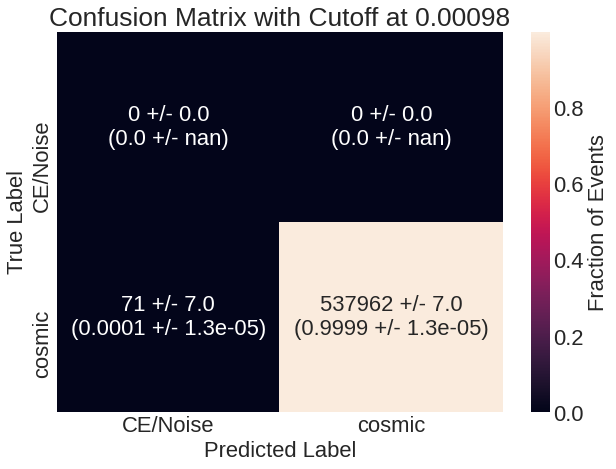

In [ ]:
quarterBagel.finalConfusion()

#CRV model low light test

In [ ]:
brownSugarBagel = MLAnalyzer(variables_list, xTest=CRVlowX, yTest=CRVlowY, model=cinnamonBagel.model, scaler=CRVscaler)

In [ ]:
brownSugarBagel.predictMC(100)

11883/11883 [==============================] - 14s 1ms/step
iteration 1 done
11883/11883 [==============================] - 14s 1ms/step
iteration 2 done
11883/11883 [==============================] - 14s 1ms/step
iteration 3 done
11883/11883 [==============================] - 14s 1ms/step
iteration 4 done
11883/11883 [==============================] - 14s 1ms/step
iteration 5 done
11883/11883 [==============================] - 13s 1ms/step
iteration 6 done
11883/11883 [==============================] - 14s 1ms/step
iteration 7 done
11883/11883 [==============================] - 14s 1ms/step
iteration 8 done
11883/11883 [==============================] - 14s 1ms/step
iteration 9 done
11883/11883 [==============================] - 13s 1ms/step
iteration 10 done
11883/11883 [==============================] - 13s 1ms/step
iteration 11 done
11883/11883 [==============================] - 13s 1ms/step
iteration 12 done
11883/11883 [==============================] - 14s 1ms/step
iteration 13 

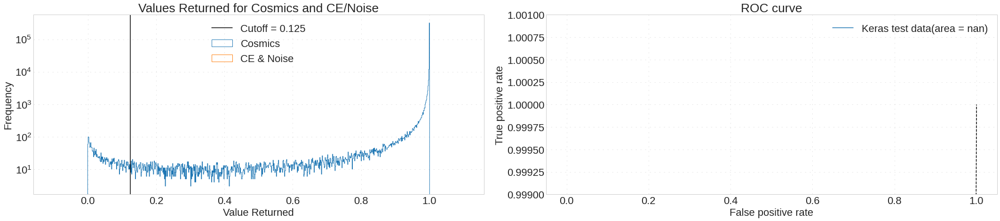

In [ ]:
brownSugarBagel.cutoffTime(predefinedcutoff=cinnamonBagel.cutoff)

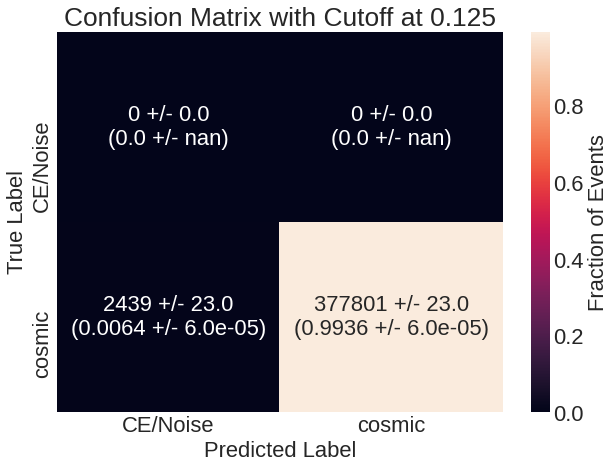

In [ ]:
brownSugarBagel.finalConfusion()

#outside crv model low light yield test

In [ ]:
bread = MLAnalyzer(noCRV_noMom_variables_list, xTest=OutlowX, yTest=OutlowY, model=plainBagel.model, scaler=noCRVscaler)

In [ ]:
bread.predictMC(100)

4932/4932 [==============================] - 6s 1ms/step
iteration 1 done
4932/4932 [==============================] - 5s 1ms/step
iteration 2 done
4932/4932 [==============================] - 5s 1ms/step
iteration 3 done
4932/4932 [==============================] - 6s 1ms/step
iteration 4 done
4932/4932 [==============================] - 6s 1ms/step
iteration 5 done
4932/4932 [==============================] - 6s 1ms/step
iteration 6 done
4932/4932 [==============================] - 5s 1ms/step
iteration 7 done
4932/4932 [==============================] - 6s 1ms/step
iteration 8 done
4932/4932 [==============================] - 5s 1ms/step
iteration 9 done
4932/4932 [==============================] - 6s 1ms/step
iteration 10 done
4932/4932 [==============================] - 6s 1ms/step
iteration 11 done
4932/4932 [==============================] - 6s 1ms/step
iteration 12 done
4932/4932 [==============================] - 6s 1ms/step
iteration 13 done
4932/4932 [=======================

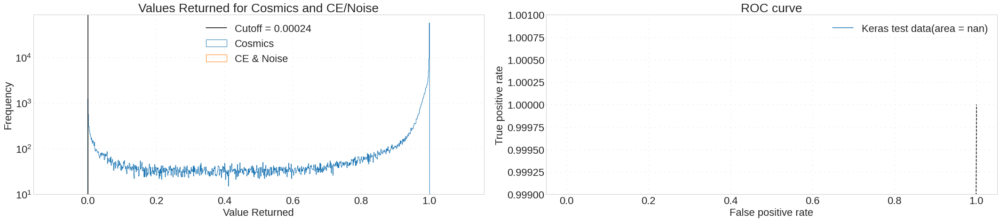

In [ ]:
bread.cutoffTime(predefinedcutoff=plainBagel.cutoff)

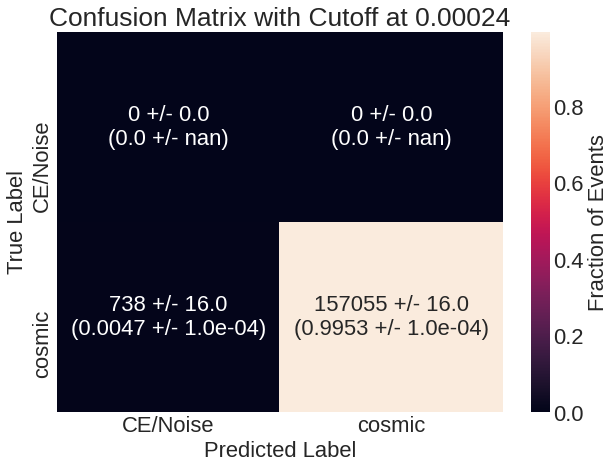

In [ ]:
bread.finalConfusion()

#Looking at all 3

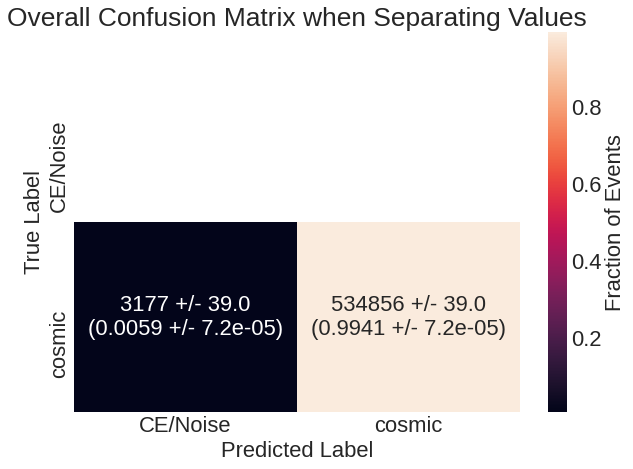

In [ ]:
tot_matrix = brownSugarBagel.conf_matrix + bread.conf_matrix
divisor = np.array([tot_matrix[0][0] + tot_matrix[0][1], tot_matrix[1][0] + tot_matrix[1][1]])
fractional_overall = tot_matrix/divisor[:,None]

error_overall = brownSugarBagel.matrix_errors + bread.matrix_errors

plt.figure(figsize=(10,7))
newEffs = np.array([['0'*50,'0'*50],['0'*50,'0'*50]])
counter = 0
for i,j,z in zip(tot_matrix, error_overall, fractional_overall):
  i = np.round(i)
  j = np.round(j)
  z = np.round(z,4)
  jj = np.round(j/(i[0]+i[1]),6)
  newEffs[counter][0] = str(i[0]) + " +/- " + str(j[0])
  newEffs[counter][0] += '\n(' + str(z[0]) + " +/- " + str('%.1e' %Decimal(jj[0])) + ')'
  newEffs[counter][1] = str(i[1]) + " +/- " + str(j[1])
  newEffs[counter][1] += '\n(' + str(z[1]) + " +/- " + str('%.1e' %Decimal(jj[1])) + ')'
  counter += 1

ax = sns.heatmap(fractional_overall, annot=newEffs, xticklabels=["CE/Noise", "cosmic"], yticklabels=["CE/Noise", "cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'});

ax.set(title="Overall Confusion Matrix when Separating Values",
      xlabel="Predicted Label",
      ylabel="True Label",);
plt.show();

#Analysing Best Model Found

In [ ]:
# print("Best Model Summary")
# bestmodel.summary()
# for l in bestmodel.layers:
#     print(l.name, l.input_shape[1],'==>',l.output_shape[1])
# print("\noverall accuracy:",bestAccuracy)

In [ ]:
# import random
# def get_random_set

In [ ]:
# def draw_neural_net(ax, left, right, bottom, top, layer_sizes):
#     '''
#     Draw a neural network cartoon using matplotilb.
    
#     :usage:
#         >>> fig = plt.figure(figsize=(12, 12))
#         >>> draw_neural_net(fig.gca(), .1, .9, .1, .9, [4, 7, 2])
    
#     :parameters:
#         - ax : matplotlib.axes.AxesSubplot
#             The axes on which to plot the cartoon (get e.g. by plt.gca())
#         - left : float
#             The center of the leftmost node(s) will be placed here
#         - right : float
#             The center of the rightmost node(s) will be placed here
#         - bottom : float
#             The center of the bottommost node(s) will be placed here
#         - top : float
#             The center of the topmost node(s) will be placed here
#         - layer_sizes : list of int
#             List of layer sizes, including input and output dimensionality
#     '''
#     n_layers = len(layer_sizes)
#     v_spacing = (top - bottom)/(max(layer_sizes))
#     h_spacing = (right - left)/(len(layer_sizes) - 1)
#     # Nodes
#     for n, layer_size in enumerate(layer_sizes):
#         layer_top = v_spacing*(layer_size - 1)/2. + (top + bottom)/2.
#         for m in range(layer_size):
#             circle = plt.Circle((n*h_spacing + left, layer_top - m*v_spacing), v_spacing/4.,
#                                 color='w', ec='k', zorder=4)
#             ax.add_artist(circle)
#     # Edges
#     for n, (layer_size_a, layer_size_b) in enumerate(zip(layer_sizes[:-1], layer_sizes[1:])):
#         layer_top_a = v_spacing*(layer_size_a - 1)/2. + (top + bottom)/2.
#         layer_top_b = v_spacing*(layer_size_b - 1)/2. + (top + bottom)/2.
#         for m in range(layer_size_a):
#             for o in range(layer_size_b):
#                 line = plt.Line2D([n*h_spacing + left, (n + 1)*h_spacing + left],
#                                   [layer_top_a - m*v_spacing, layer_top_b - o*v_spacing], c='k')
#                 ax.add_artist(line)

In [ ]:
# print(test)
# delete_random_elems(test, round(0.5*len(test)))

In [ ]:
# layers=[12]+[48]*8+[1]
# fig = plt.figure(figsize=(len(layers)*2, len(layers)*2))
# plt.axis('off');
# draw_neural_net(fig.gca(), .1, .9, .1, .9, layers)

In [ ]:
# def plotAcc(history, modelType):
#   fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=True, figsize=(14,5))

#   ax1.plot(history.history['accuracy'], label="training")
#   ax1.plot(history.history['val_accuracy'], label="validation")
#   ax1.set_title('model accuracy')
#   ax1.set_ylabel('accuracy')
#   ax1.set_xlabel('epoch')
#   ax1.legend(loc='bottom right')
#   ax1.set_ylim(0.99,1)
#   # ax1.set_yscale('log');

#   ax2.plot(history.history['loss'], 'r-', label="training")
#   ax2.plot(history.history['val_loss'], 'g-', label="validation")
#   ax2.set_title('model loss - ' + modelType)
#   ax2.set_ylabel('loss')
#   ax2.set_xlabel('epoch')
#   ax2.legend(loc='best')
#   ax2.set_ylim(0,0.1);
#   # ax2.set_yscale('log');
#   plt.tight_layout()
#   plt.show()

In [ ]:
# allHistory.history['accuracy'][-1]

In [ ]:
# plotAcc(allHistory, "Entire Dataset")

In [ ]:
# plotAcc(CRVHistory, "Valid CRV Events")

In [ ]:
# plotAcc(NoCRVHistory, "No CRV Events")

In [ ]:
# watcher = ww.WeightWatcher(model=bestmodel);
# details = watcher.analyze(randomize=True, plot=True);

In [ ]:
# summary = watcher.get_summary(details);

In [ ]:
# summary

In [ ]:
# details

In [ ]:
# plt.plot(details['alpha'])

#Predictions using MC Dropout

In [ ]:
def predict_with_MC_error(model, test_data, num_iter = 10):
  predictions_list = []
  for i in range(num_iter):
    predictions_list.append(model.predict(test_data, verbose=1).reshape(-1))
    print("iteration", i + 1, "done")
  predictions = np.mean(predictions_list, axis=0).reshape(-1)

  return predictions_list, predictions

In [ ]:
all_preds, predictions = predict_with_MC_error(allModel, X_test, num_iter=30)

26425/26425 [==============================] - 32s 1ms/step
iteration 1 done
26425/26425 [==============================] - 31s 1ms/step
iteration 2 done
26425/26425 [==============================] - 31s 1ms/step
iteration 3 done
26425/26425 [==============================] - 31s 1ms/step
iteration 4 done
26425/26425 [==============================] - 31s 1ms/step
iteration 5 done
26425/26425 [==============================] - 31s 1ms/step
iteration 6 done
26425/26425 [==============================] - 31s 1ms/step
iteration 7 done
26425/26425 [==============================] - 35s 1ms/step
iteration 8 done
26425/26425 [==============================] - 31s 1ms/step
iteration 9 done
26425/26425 [==============================] - 31s 1ms/step
iteration 10 done
26425/26425 [==============================] - 31s 1ms/step
iteration 11 done
26425/26425 [==============================] - 31s 1ms/step
iteration 12 done
26425/26425 [==============================] - 32s 1ms/step
iteration 13 

In [ ]:
NoCRV_all_preds, NoCRV_predictions = predict_with_MC_error(NoCRVModel, no_CRV_X_test, num_iter=30)

In [ ]:
CRV_all_preds, CRV_predictions = predict_with_MC_error(CRVModel, CRV_X_test, num_iter=30)

#Analytics of MC Dropout Results

In [ ]:
print("Brier Score of:", 1 - brier_score_loss(y_test, predictions), "for all data")
print("Brier Score of:", 1 - brier_score_loss(CRV_y_test, CRV_predictions), "for just CRV data")
print("Brier Score of:", 1 - brier_score_loss(no_CRV_y_test, NoCRV_predictions), "for no CRV data")

Brier Score of: 0.9950386824672566 for all data
Brier Score of: 0.999097605475575 for just CRV data
Brier Score of: 0.9983972559136851 for no CRV data


In [ ]:
def produceMatrix(divider):
  rounded = np.where(predictions < divider, 0, 1)
  confusion = confusion_matrix(y_test, rounded, normalize=None);
  sns.heatmap(confusion, annot=True, xticklabels=["noise", "cosmic"], yticklabels=["noise", "cosmic"], fmt='.5g');
  plt.xlabel("Predicted Label");
  plt.ylabel("True Label");
  return confusion, rounded

In [ ]:
def confusionmatrix(eff, percentage, cutoff):
  plt.figure(figsize=(10,7))
  
  annotStr = annot=np.array([[str(round(eff[0][0])) + '\n(' + str(round(percentage[0][0],5)) + ')', str(round(eff[0][1])) + '\n(' + str(round(percentage[0][1],5)) + ')'], [str(round(eff[1][0])) + '\n(' + str(round(percentage[1][0],5)) + ')', str(round(eff[1][1])) + '\n(' + str(round(percentage[1][1],5)) + ')']])

  ax = sns.heatmap(percentage, annot=annotStr, xticklabels=["CE + Noise", "cosmic"], yticklabels=["CE + Noise", "cosmic"], fmt='.18s', cbar_kws={'label': 'Fraction of Events'});
  
  ax.set(title="Confusion Matrix with Cutoff at " + str(round(cutoff, 5)),
        xlabel="Predicted Label",
        ylabel="True Label",);
    

In [ ]:
def outputHisto(prediction, ytest, cutoff):
  fig, ax = plt.subplots(1,2, figsize=(30,7))


  ax[0].hist(prediction[ytest==1], range=(-0.1,1.1), bins=1000, histtype='step', label='Cosmics');
  ax[0].hist(prediction[ytest==0], range=(-0.1,1.1), bins=1000, histtype='step', label='CE & Noise');
  ax[0].axvline(cutoff, label="Cutoff = " + str(round(cutoff, 5)), color='black')
  ax[0].set_yscale('log');
  ax[0].legend(loc='upper center');

  fpr_keras, tpr_keras, thresholds_keras = roc_curve(ytest, prediction);
  auc_keras = auc(fpr_keras, tpr_keras);
  ax[1].plot([0, 1], [0, 1], 'k--');
  ax[1].plot(fpr_keras, tpr_keras, label='Keras test data(area = {:.5f})'.format(auc_keras));
  ax[1].set_xlabel('False positive rate');
  ax[1].set_ylabel('True positive rate');
  ax[1].set_title('ROC curve');
  ax[1].set_ylim(0.999,1.001);
  # ax[1].set_yscale('log');
  ax[1].legend();

  ax[0].set_title("Values Returned for Cosmics and CE/Noise");
  ax[0].set_xlabel("Value Returned");
  ax[0].set_ylabel("Frequency");

In [ ]:
def cutoffTime(ytest, prediction):
  rejectionList = []
  ceList = []

  def cutoffScanner(ytest, prediction, upper, lower): #Defined within function so that global variable can be used
    divider = (upper + lower)/2
    rounded = np.where(prediction < divider, 0, 1)
    confusion = confusion_matrix(ytest, rounded, normalize='true');
    rejectionList.append((divider, confusion[1][1]))
    ceList.append((divider, confusion[0][0]))
    # print("Done with divider of:", divider,"==>", round(confusion[1][1], 6))

    if divider < 0.0001 and round(confusion[1][1], 6) != 1:
      print("Mission failed, we'll get em next time. Closest cutoff found of: ", divider)
      return divider, confusion_matrix(ytest, rounded), rounded, confusion

    elif (round(confusion[1][1],4) == 0.9999):
      # print("Cutoff found of: ", divider)
      return divider, confusion_matrix(ytest, rounded), rounded, confusion

    elif round(confusion[1][1],4) > 0.9999:
      return cutoffScanner(ytest, prediction, upper, divider)

    else:
      return cutoffScanner(ytest, prediction, divider, lower)

  cutoff, effs, rounded_predictions, percentages = cutoffScanner(ytest, prediction, 1, 0)
  fig, ax = plt.subplots(2,1, figsize=(8,12), sharex=True)
  rejectionList = sorted(rejectionList)
  ceList = sorted(ceList)
  ax[0].plot(*zip(*rejectionList), label="Cosmic", color='blue', marker='o');
  ax[1].plot(*zip(*ceList), label="CE", color='orange', marker='o');
  if cutoff < 0.01:
    plt.xscale('log');
  ax[0].set_ylabel('Efficiency');
  ax[1].set_ylabel('Efficiency');
  ax[0].set_title('Cosmic');
  ax[1].set_title('CE & Noise');
  fig.suptitle("Efficiency of Successful Identification VS Cutoff Value", y=1.01);
  fig.text(0.45,0,"Cutoff Value");
  confusionmatrix(effs, percentages, cutoff)
  outputHisto(prediction, ytest, cutoff)
  plt.tight_layout();
  plt.show();
  return cutoff, effs, rounded_predictions, percentages

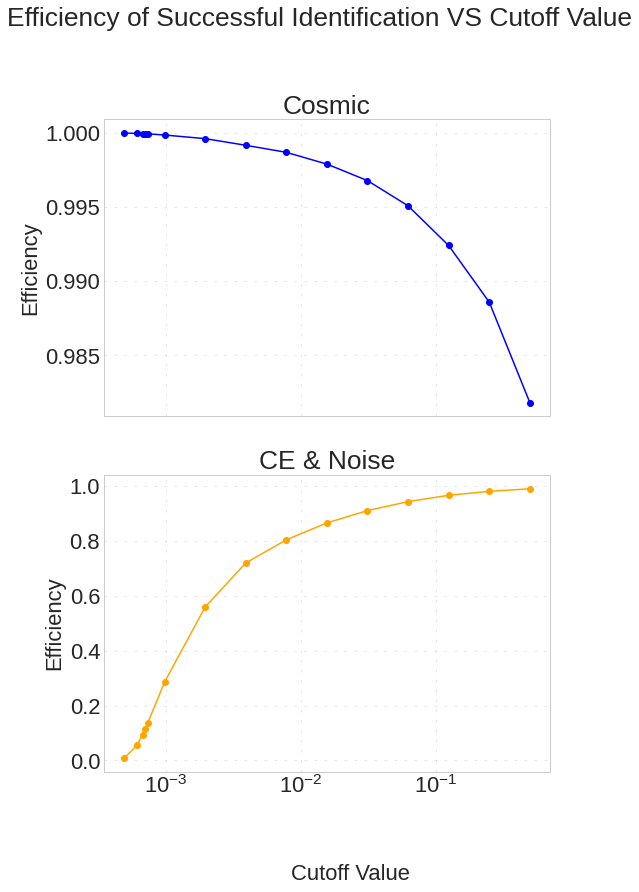

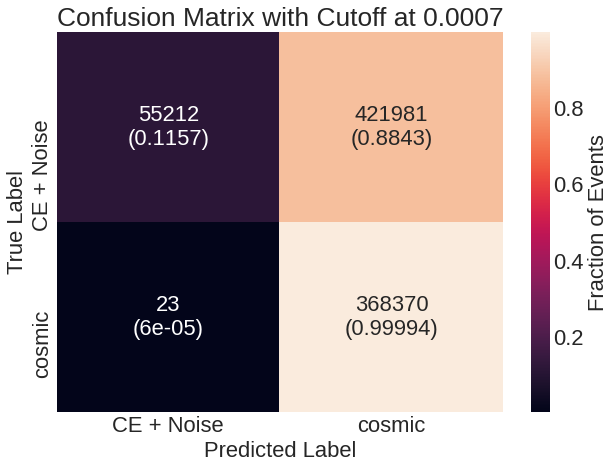

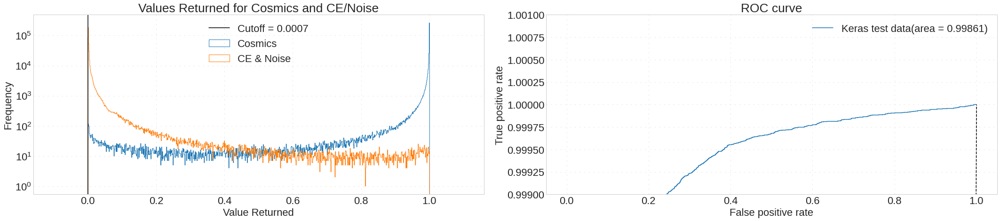

In [ ]:
all_cutoff, all_effs, all_rounded_predictions, all_percentages = cutoffTime(y_test, predictions)

In [ ]:
CRVcutoff, CRVeffs, CRVrounded_predictions, CRVpercentages = cutoffTime(CRV_y_test, CRV_predictions)

In [ ]:
NoCRVcutoff, NoCRVeffs, NoCRVrounded_predictions, NoCRVpercentages = cutoffTime(no_CRV_y_test, NoCRV_predictions)

In [ ]:
# ncos = np.count_nonzero(y_test ==1)
# nCE = np.count_nonzero(y_test ==0)
# print("Number of cosmics:", ncos)
# print("Number Correctly Identified as Cosmics:", round(effs[1][1]), "(" + str(effs[1][1]/ncos) + ")", "<-- ANALOGUE FOR CUT VETO EFFICIENCY")
# print("Number of CEs Identified as Cosmics:", round(effs[0][1]), "(" + str(effs[0][1]/nCE) + ")")
# print()
# print("Number of CEs:", nCE)
# print("Number Correctly Identified as CEs:", round(nCE), "(" + str(effs[0][0]/nCE) + ")", "<-- ANALOGUE FOR CUT CE RECONSTRUCTION EFFICIENCY")
# print("Number of cosmics Identified as CEs:", round(effs[1][0]), "(" + str(effs[1][0]/ncos) + ")")

#errors

In [ ]:
def ErrorCalculations(X_test_df2, all_predictions, out, ytest, variables_list, cutoff):
  X_test_df2 = X_test_df2.to_numpy()
  AbsoluteErrors = np.var(all_predictions, axis=0) #Gets the error for each event (the error is the variance in accordance with the paper linked earlier from CERN)

  TPErrors = {} #True positive
  FPErrors = {} #False positive
  FNErrors = {} #False negative
  TNErrors = {} #True negative

  TPInputs = [] #True positive
  FPInputs = [] #False positive
  FNInputs = [] #False negative
  TNInputs = [] #True negative

  for i in range(len(out)): #Placing everything in its respective bucket
    if (out[i] == 1) and (ytest[i] == 1):
      TPErrors[i] = AbsoluteErrors[i]
      TPInputs.append(X_test_df2[i])
    elif out[i] == 1 and ytest[i] == 0:
      FPErrors[i] = AbsoluteErrors[i]
      FPInputs.append(X_test_df2[i])
    elif out[i] == 0 and ytest[i] == 1:
      FNErrors[i] = AbsoluteErrors[i]
      FNInputs.append(X_test_df2[i])
    elif out[i] == 0 and ytest[i] == 0:
      TNErrors[i] = AbsoluteErrors[i]
      TNInputs.append( X_test_df2[i])

  def couldaMadeADifference(predictions, errorDict):
    count = 0
    for i in errorDict:
      if abs(predictions[i] - cutoff) < errorDict[i]:
        count += 1 #The uncertainty could have made a difference in the classification here
    return count #Which then returns the number of times that this algorithm could have made a difference in the classification
  
  categoryUncertainties = np.ceil(np.array([ [max(couldaMadeADifference(predictions, TNErrors), np.var(list(TNErrors.values()))*len(TNErrors)), max(couldaMadeADifference(predictions, FPErrors), np.var(list(FPErrors.values()))*len(FPErrors))],
                          [max(couldaMadeADifference(predictions, FNErrors), np.var(list(FNErrors.values()))*len(FNErrors)), max(couldaMadeADifference(predictions, TPErrors), np.var(list(TPErrors.values()))*len(TPErrors))] ]))
  nbins = 50
  upper_bound = max(max(TPErrors.values()), max(FPErrors.values()), max(TNErrors.values()), max(FNErrors.values()))
  plt.figure();
  plt.hist(TPErrors.values(), histtype='step', label="True Cosmics", bins=nbins, density = True, range=(0,upper_bound));
  plt.hist(FPErrors.values(), histtype='step', label="CE Labelled as Cosmic", bins=nbins, density = True, range=(0,upper_bound));
  plt.hist(TNErrors.values(), histtype='step', label="True CE", bins=nbins, density = True, range=(0,upper_bound));
  plt.hist(FNErrors.values(), histtype='step', label="Cosmic Labelled as CE", bins=nbins, density = True, range=(0,upper_bound));
  plt.legend(bbox_to_anchor=(1,1), loc="upper left", borderaxespad=0);
  plt.xlabel("Error")
  plt.title("Error Distributions for Different Event Classifications")
  plt.yscale('log');

  TPInputs = pd.DataFrame(np.array(TPInputs), columns=list(variables_list.keys()))
  FPInputs = pd.DataFrame(np.array(FPInputs), columns=list(variables_list.keys()))
  FNInputs = pd.DataFrame(np.array(FNInputs), columns=list(variables_list.keys()))
  TNInputs = pd.DataFrame(np.array(TNInputs), columns=list(variables_list.keys()))

  for var in variables_list:
    try:
      plt.figure(figsize=(20, 10))
      plt.hist(TPInputs[var], histtype='step', label="True Cosmics", bins=nbins, density=True,  range=variables_list[var]);
      plt.hist(FPInputs[var], histtype='step', label="Cosmic Labelled as CE/noise", bins=nbins, density=True,  range=variables_list[var]);
      plt.hist(FNInputs[var], histtype='step', label="CE/noise labelled as Cosmic", bins=nbins, density=True,  range=variables_list[var]);
      plt.hist(TNInputs[var], histtype='step', label="True CE/noise", bins=nbins, density=True,  range=variables_list[var]);
      plt.xlabel(translation[var])
      plt.yscale('log')
      plt.ylabel('Normalized Frequency')
      plt.legend(prop={'size': 20})
    except:
      continue
  return categoryUncertainties

In [ ]:
allErrors = ErrorCalculations(X_test_df, all_preds, all_rounded_predictions, y_test, noCRV_noMom_variables_list, all_cutoff)

In [ ]:
CRVErrors = ErrorCalculations(CRV_X_test_df, CRV_all_preds, CRVrounded_predictions, CRV_y_test, dTZPE_noMom_variables_list, CRVcutoff)

In [ ]:
NoCRVErrors = ErrorCalculations(no_CRV_X_test_df, NoCRV_all_preds, NoCRVrounded_predictions, no_CRV_y_test, noCRV_noMom_variables_list, NoCRVcutoff)

In [ ]:
# print("Using boundary conditions")
# print("Uncertainty for True Negatives")
# print(couldaMadeADifference(predictions, TNErrors, effs[0][0]),"\n")
# print("Uncertainty for False Negatives")
# print(couldaMadeADifference(predictions, FNErrors, effs[0][1]),"\n")
# print("Uncertainty for True Positives")
# print(couldaMadeADifference(predictions, TPErrors, effs[1][1]),"\n")
# print("Uncertainty for False Positives")
# print(couldaMadeADifference(predictions, FPErrors, effs[1][0]),"\n")
# print()
# print("Using variances")
# print("Uncertainty for True Negatives")
# print(np.var(list(TNErrors.values())) * effs[0][0], "\n")
# print("Uncertainty for False Negatives")
# print(np.var(list(FNErrors.values())) * effs[0][1], "\n")
# print("Uncertainty for True Positives")
# print(np.var(list(TPErrors.values())) * effs[1][1], "\n")
# print("Uncertainty for False Positives")
# print(np.var(list(FPErrors.values())) * effs[1][0], "\n")

In [ ]:
# categoryUncertainties = np.ceil(np.array([ [max(couldaMadeADifference(predictions, TNErrors, effs[0][0]), np.var(list(TNErrors.values()))*effs[0][0]), max(couldaMadeADifference(predictions, FPErrors, effs[1][0]), np.var(list(FPErrors.values()))*effs[1][0])],
#                           [max(couldaMadeADifference(predictions, FNErrors, effs[0][1]), np.var(list(FNErrors.values()))*effs[0][1]), max(couldaMadeADifference(predictions, TPErrors, effs[1][1]), np.var(list(TPErrors.values()))*effs[1][1])] ]))

In [ ]:
# nbins = 50
# upper_bound = max(max(TPErrors.values()), max(FPErrors.values()), max(TNErrors.values()), max(FNErrors.values()))
# plt.hist(TPErrors.values(), histtype='step', label="True Cosmics", bins=nbins, density = True, range=(0,upper_bound));
# plt.hist(FPErrors.values(), histtype='step', label="CE Labelled as Cosmic", bins=nbins, density = True, range=(0,upper_bound));
# plt.hist(TNErrors.values(), histtype='step', label="True CE", bins=nbins, density = True, range=(0,upper_bound));
# plt.hist(FNErrors.values(), histtype='step', label="Cosmic Labelled as CE", bins=nbins, density = True, range=(0,upper_bound));
# plt.legend(bbox_to_anchor=(1,1), loc="upper left", borderaxespad=0);
# plt.xlabel("Error")
# plt.title("Error Distributions for Different Event Classifications")
# plt.yscale('log');

In [ ]:
# possibleConfusions = 0
# for i in range(len(predictions)):
#   if abs(predictions[i] - cutoff) < AbsoluteErrors[i]:
#     possibleConfusions += 1
# print("Uncertainties could have changed", possibleConfusions, "events out of a total of", len(predictions), "events - affecting", possibleConfusions/len(predictions)*100, "\b% of events")

In [ ]:
confusionList

In [ ]:
np.var(confusionList, axis=0)

array([[3.68564900e+04, 3.68564900e+04],
       [3.02988889e+01, 3.02988889e+01]])

In [ ]:
def finalConfusion(eff, categoryUncertainty, percentage, cutoff):
  plt.figure(figsize=(10,7))

  newEffs = np.array([['0'*50,'0'*50],['0'*50,'0'*50]])
  counter = 0
  for i,j,z in zip(eff, categoryUncertainty, percentage):
    i = np.round(i)
    j = np.round(j)
    z = np.round(z,4)
    jj = np.round(j/(i[0]+i[1]),6)
    newEffs[counter][0] = str(i[0]) + " +/- " + str(j[0])
    newEffs[counter][0] += '\n(' + str(z[0]) + " +/- " + str('%.1e' %Decimal(jj[0])) + ')'
    newEffs[counter][1] = str(i[1]) + " +/- " + str(j[1])
    newEffs[counter][1] += '\n(' + str(z[1]) + " +/- " + str('%.1e' %Decimal(jj[1])) + ')'
    counter += 1

  ax = sns.heatmap(percentage, annot=newEffs, xticklabels=["CE/Noise", "cosmic"], yticklabels=["CE/Noise", "cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'});
  
  ax.set(title="Confusion Matrix with Cutoff at " + str(round(cutoff, 5)),
        xlabel="Predicted Label",
        ylabel="True Label",);

In [ ]:
np.std(confusionList, axis=0)

array([[191.98044171, 191.98044171],
       [  5.50444265,   5.50444265]])

In [ ]:
def alternateFinalConfusion(eff, percentage, all_predictions, cutoff):
  plt.figure(figsize=(10,7))

  confusionErr = []
  for i in all_preds:
    confusionErr.append(confusion_matrix(y_test, np.where(i < all_cutoff, 0, 1)))
  confusionErr = np.array(confusionErr)
  confusionErr = np.var(confusionErr, axis=0)

  newEffs = np.array([['0'*50,'0'*50],['0'*50,'0'*50]])
  counter = 0
  for i,j,z in zip(eff, confusionErr, percentage):
    i = np.round(i)
    j = np.round(j)
    z = np.round(z,4)
    jj = np.round(j/(i[0]+i[1]),6)
    newEffs[counter][0] = str(i[0]) + " +/- " + str(j[0])
    newEffs[counter][0] += '\n(' + str(z[0]) + " +/- " + str('%.1e' %Decimal(jj[0])) + ')'
    newEffs[counter][1] = str(i[1]) + " +/- " + str(j[1])
    newEffs[counter][1] += '\n(' + str(z[1]) + " +/- " + str('%.1e' %Decimal(jj[1])) + ')'
    counter += 1

  ax = sns.heatmap(percentage, annot=newEffs, xticklabels=["CE/Noise", "cosmic"], yticklabels=["CE/Noise", "cosmic"], fmt='.50s', cbar_kws={'label': 'Fraction of Events'});
  
  ax.set(title="Confusion Matrix with Cutoff at " + str(round(cutoff, 5)),
        xlabel="Predicted Label",
        ylabel="True Label",);

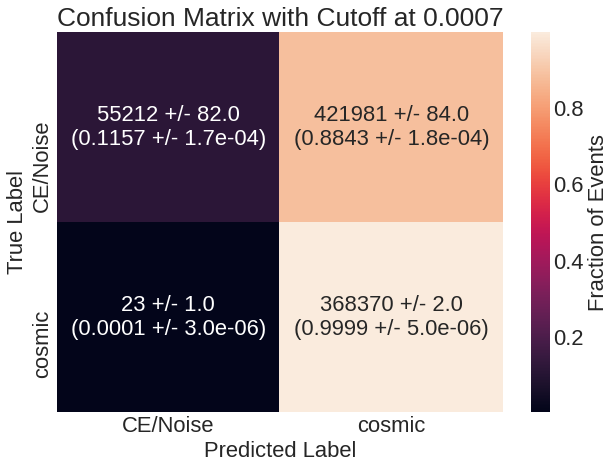

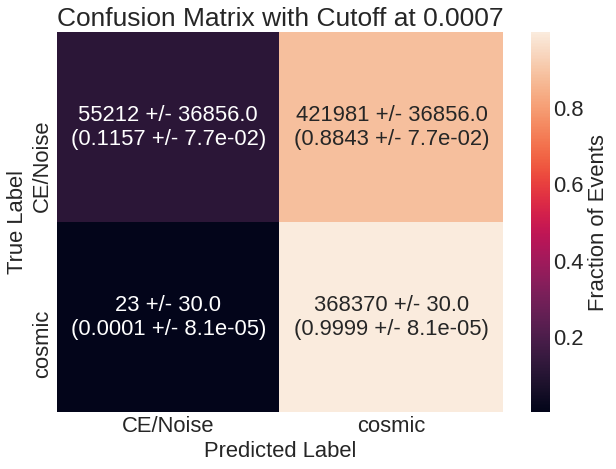

In [ ]:
finalConfusion(all_effs, allErrors, all_percentages, all_cutoff)
alternateFinalConfusion(all_effs, all_percentages, all_preds, all_cutoff)

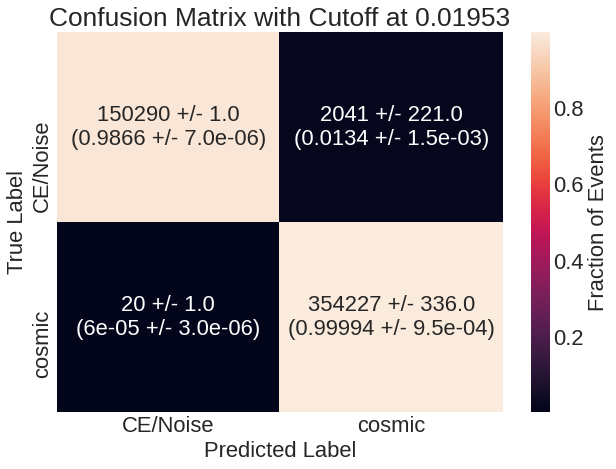

In [ ]:
finalConfusion(CRVeffs, CRVErrors, CRVpercentages, CRVcutoff)

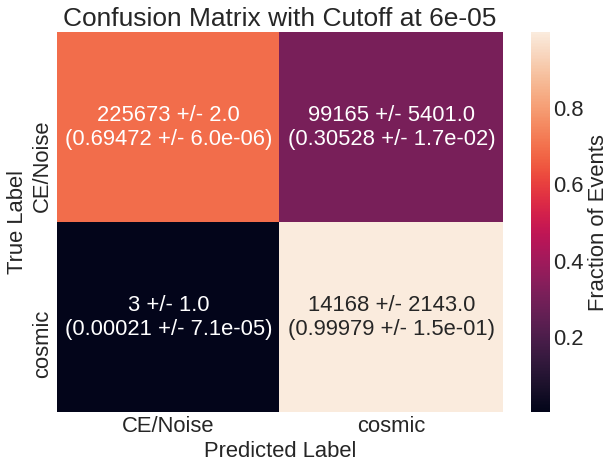

In [ ]:
finalConfusion(NoCRVeffs, NoCRVErrors, NoCRVpercentages, NoCRVcutoff)

#Analyzing Input Variables for Confusion Matrix Categories

In [ ]:
# TPInputs = pd.DataFrame(np.array(TPInputs), columns=list(variables_list.keys()))
# FPInputs = pd.DataFrame(np.array(FPInputs), columns=list(variables_list.keys()))
# FNInputs = pd.DataFrame(np.array(FNInputs), columns=list(variables_list.keys()))
# TNInputs = pd.DataFrame(np.array(TNInputs), columns=list(variables_list.keys()))

In [ ]:
# for var in variables_list:
#   try:
#     plt.figure(figsize=(20, 10))
#     plt.hist(TPInputs[var], histtype='step', label="True Cosmics", bins=nbins, density=True,  range=variables_list[var]);
#     plt.hist(FPInputs[var], histtype='step', label="Cosmic Labelled as CE/noise", bins=nbins, density=True,  range=variables_list[var]);
#     plt.hist(FNInputs[var], histtype='step', label="CE/noise labelled as Cosmic", bins=nbins, density=True,  range=variables_list[var]);
#     plt.hist(TNInputs[var], histtype='step', label="True CE/noise", bins=nbins, density=True,  range=variables_list[var]);
#     plt.xlabel(translation[var])
#     plt.yscale('log')
#     plt.ylabel('Normalized Frequancy')
#     plt.legend(prop={'size': 20})
#   except:
#     continue


#Training With All Variables

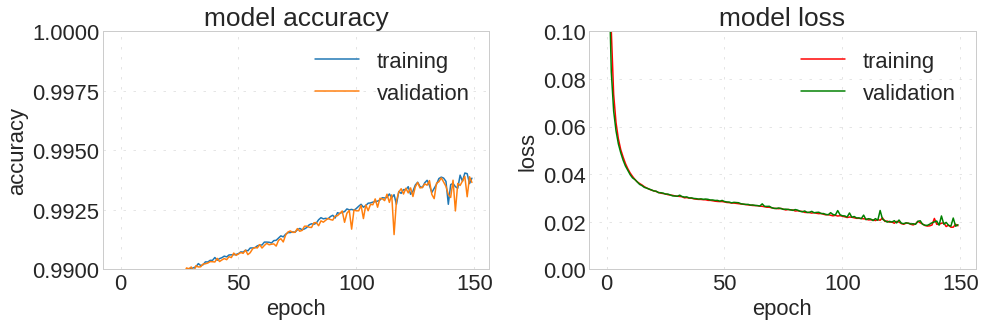

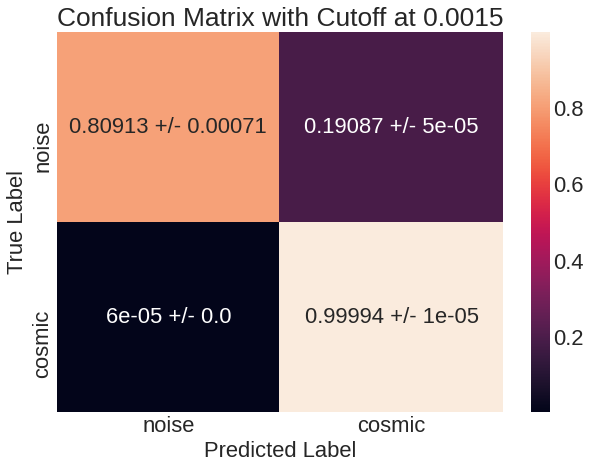

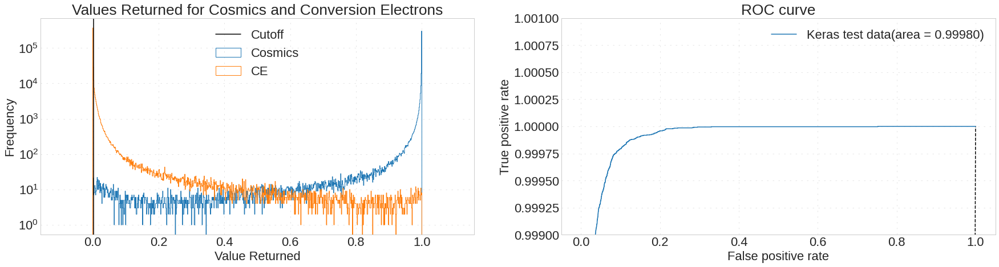

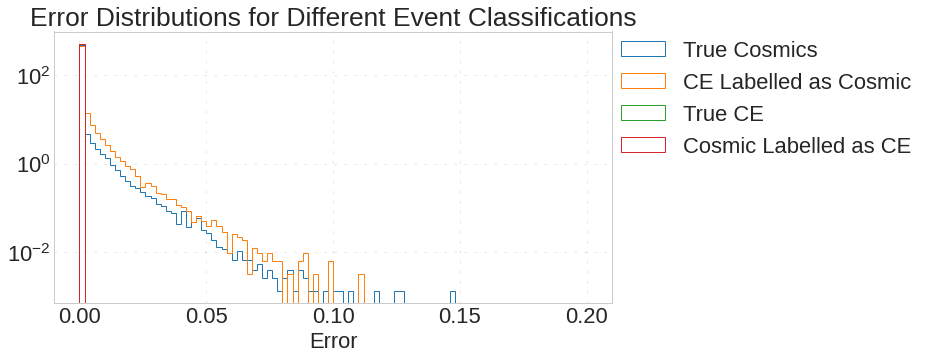

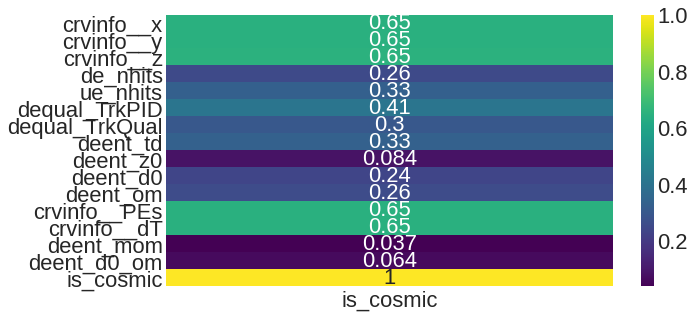

#Just dT

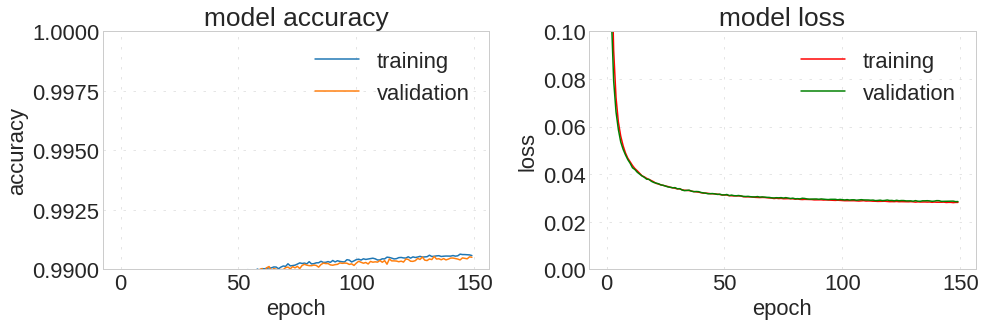

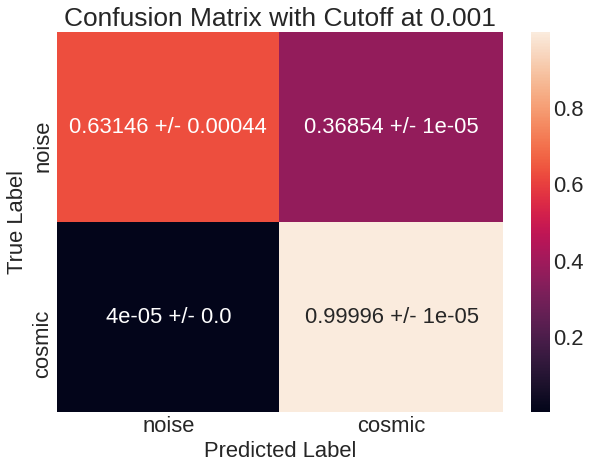

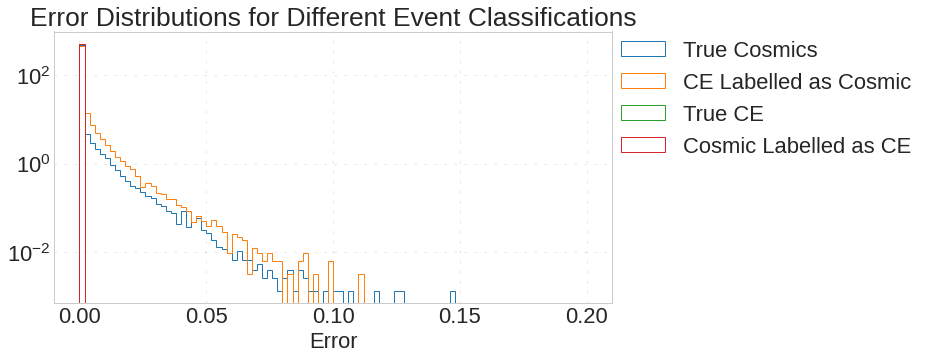

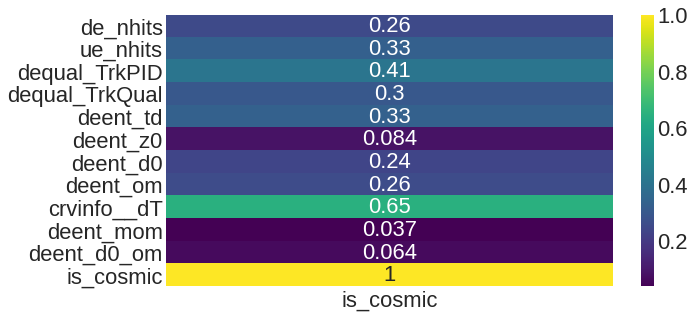

#Just Z

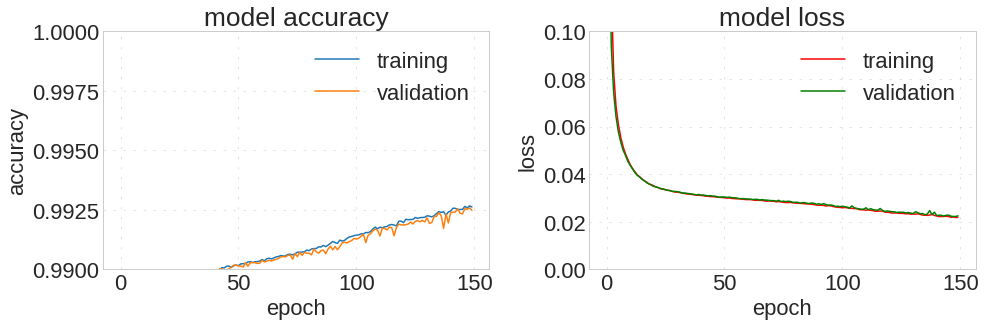

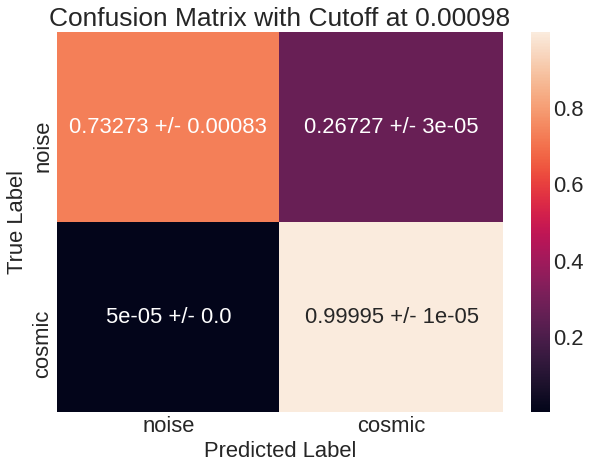

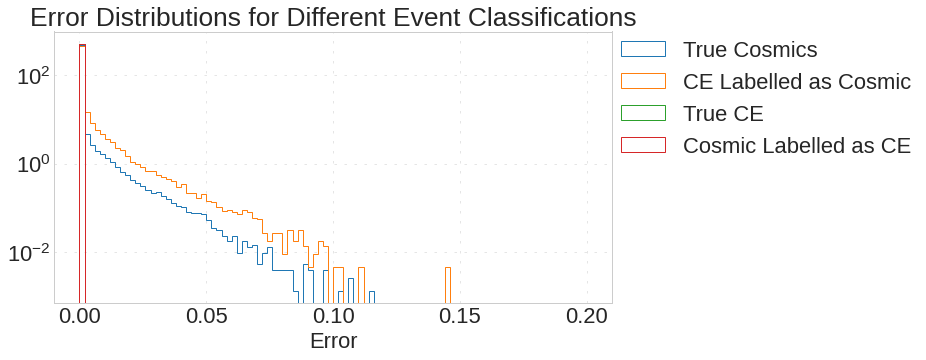

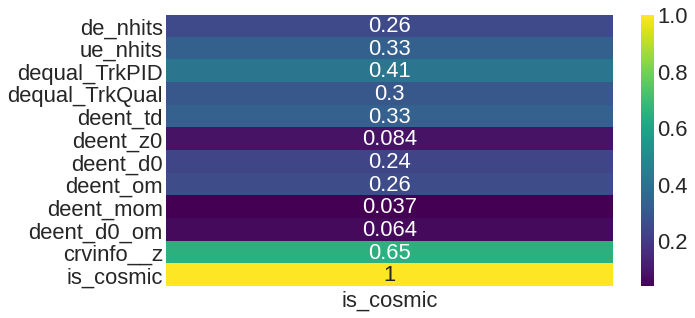

#dT & Z

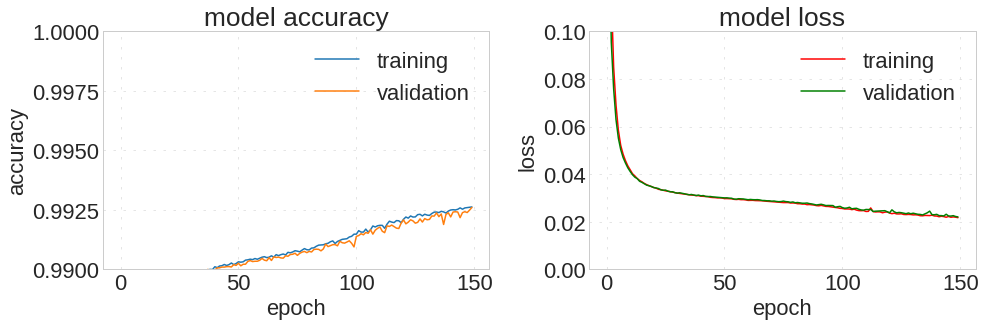

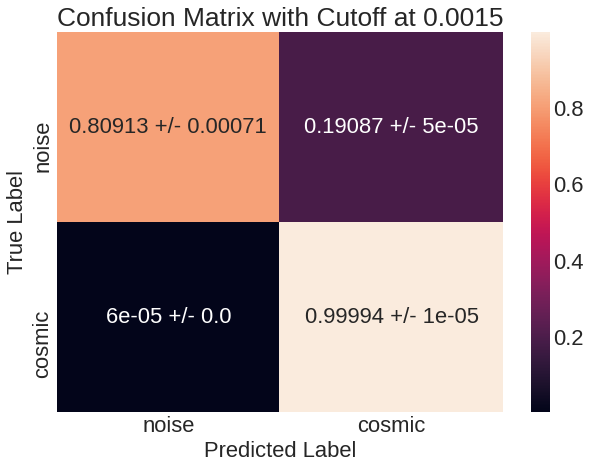

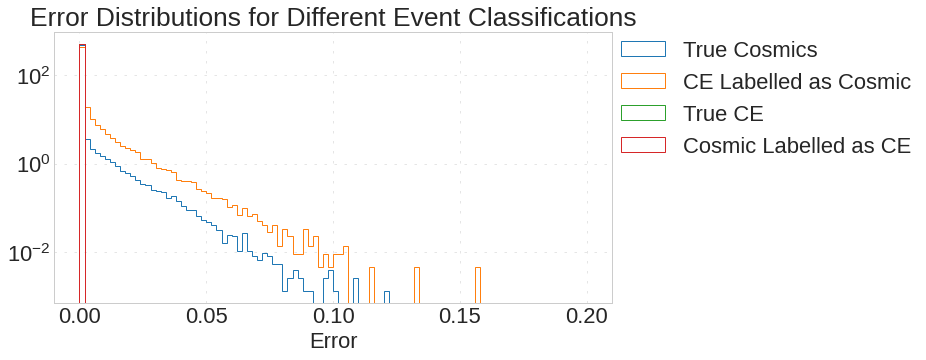

#All variables dropout=0.2

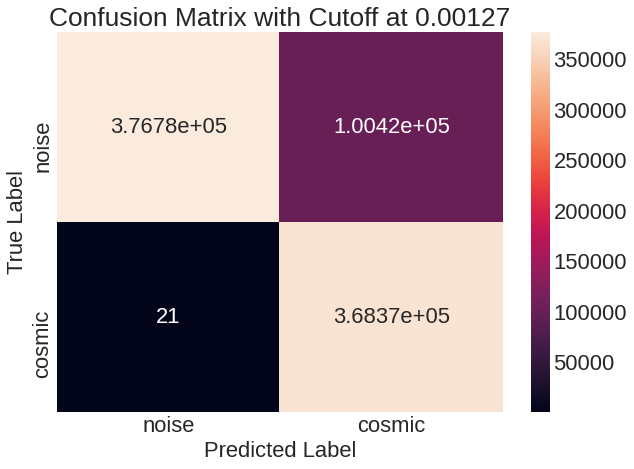

#All variables dropout=0.5

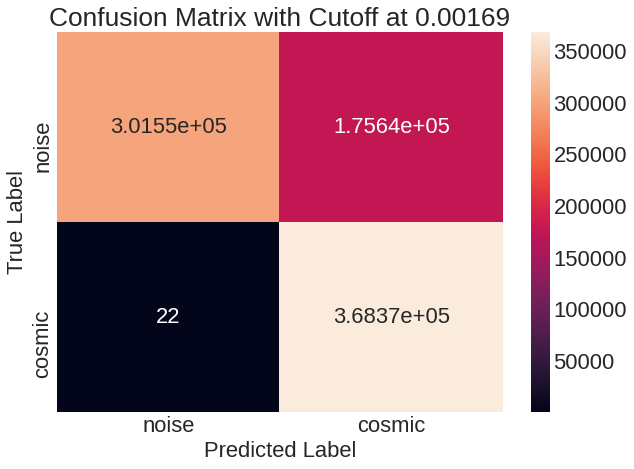

#Ignore

UndefinedVariableError: ignored

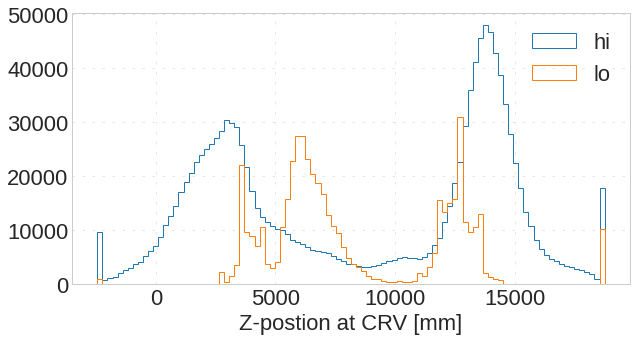

<Figure size 720x360 with 0 Axes>

In [ ]:
#@title Default title text
cuts_list = [cut_loose, cut_nomom, cut_extmom]

plt.hist(dfH['crvinfomc__z'], bins=100, histtype='step', label='hi');
plt.hist(dfL['crvinfomc__z'], bins=100, histtype='step', label='lo');
plt.xlabel('Z-postion at CRV [mm]')
plt.legend()

plt.figure()
for cut in cuts_list:
  plt.hist(dfH.query(cut)['crvinfomc__z'], bins=100, histtype='step', range=(-1000, 20000), density=True, label='cut');
plt.xlabel('Z-postion at CRV [mm]')
plt.legend()

plt.figure()
plt.hist(dfH.query(cut_loose)['crvinfomc__z'], bins=100, histtype='step', range=(-1000, 20000), density=True, label='loose cuts');
plt.hist(dfH.query(cut_nomom)['crvinfomc__z'], bins=100, histtype='step', range=(-1000, 20000), density=True, label='no mom');
plt.hist(dfH.query(cut_extmom)['crvinfomc__z'], bins=100, histtype='step', range=(-1000, 20000), density=True, label='ext mom');
#plt.hist(dfH.query(cut_box)['crvinfomc__z'], bins=100, histtype='step', range=(-1000, 20000), density=True, label='box');
plt.xlabel('Z-postion at CRV [mm]')
plt.legend()
plt.yscale('log')

plt.figure()
plt.hist(dfH.query(cut_loose)['crvinfomc__x'], bins=100, histtype='step', range=(-8000, 1000), density=True, label='loose cuts');
plt.hist(dfH.query(cut_nomom)['crvinfomc__x'], bins=100, histtype='step', range=(-8000, 1000), density=True, label='no mom cut');
plt.hist(dfH.query(cut_extmom)['crvinfomc__x'], bins=100, histtype='step', range=(-8000, 1000), density=True, label='mom cut');
plt.xlabel('X-postion at CRV [mm]')
plt.legend()

plt.figure()
plt.hist(dfH.query(cut_loose)['crvinfomc__y'], bins=100, histtype='step', range=(-2000, 2000), density=True, label='loose cuts');
plt.hist(dfH.query(cut_nomom)['crvinfomc__y'], bins=100, histtype='step', range=(-2000, 2000), density=True, label='no mom cut');
plt.hist(dfH.query(cut_extmom)['crvinfomc__y'], bins=100, histtype='step', range=(-2000, 2000), density=True, label='mom cut');
plt.xlabel('Y-postion at CRV [mm]')
plt.legend()

plt.figure()
plt.hist(dfH.query(cut_loose)['crvinfomc__parentE']/1000., bins=100, histtype='step', range=(0, 50), density=True, label='loose cuts');
plt.hist(dfH.query(cut_nomom)['crvinfomc__parentE']/1000., bins=100, histtype='step', range=(0, 50), density=True, label='no mom cut');
plt.hist(dfH.query(cut_extmom)['crvinfomc__parentE']/1000., bins=100, histtype='step', range=(0, 50), density=True, label='mom cut');
plt.xlabel('Primary energy[GeV]')
plt.legend()

#Legacy Code

In [ ]:
# keras.backend.clear_session() #This clears the previous training
# print("Model Summary")
# width = len(X_train[0])
# depth = 4
# keras.backend.clear_session()
# model = keras.Sequential()

# model.add(Dense(width, input_dim=width, activation='relu'))
# # model.add(Dropout(0.2))
# for i in range(depth):
#   model.add(Dense(2*width, activation='relu'))
#   model.add(Dropout(0.2))
# model.add(Dense(1, activation='sigmoid'))

# model.summary()
# model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
# es_callback = [keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)]
# print("fitting to the data...")
# #history = model.fit(x=X_train, y=y_train, epochs=100, batch_size=100000, callbacks=[es_callback], validation_split=0.2);
# history = model.fit(x=X_train, y=y_train, epochs=250, batch_size=100000, validation_split=0.2, verbose=False);

In [ ]:
# plt.plot(history.history['accuracy'], label="training")
# plt.plot(history.history['val_accuracy'], label="validation")
# plt.title('model accuracy')
# plt.ylabel('accuracy')
# plt.xlabel('epoch')
# plt.legend(loc='best')
# plt.figure()

# plt.plot(history.history['loss'], label="training")
# plt.plot(history.history['val_loss'], label="validation")
# plt.title('model loss')
# plt.ylabel('loss')
# plt.xlabel('epoch')
# plt.legend(loc='best')
# plt.show()

In [ ]:
# predictions = model.predict(X_test);

In [ ]:
# fig, ax = plt.subplots(1,2, figsize=(30,7))

# ax[0].hist(predictions[y_test==1], range=(-0.1,1.1), bins=1000, histtype='step', label='Cosmics')
# ax[0].hist(predictions[y_test==0], range=(-0.1,1.1), bins=1000, histtype='step', label='CE')
# ax[0].set_yscale('log')
# ax[0].legend(loc='upper center')

# fpr_keras, tpr_keras, thresholds_keras = roc_curve(y_test, predictions);
# auc_keras = auc(fpr_keras, tpr_keras);
# ax[1].plot([0, 1], [0, 1], 'k--');
# ax[1].plot(fpr_keras, tpr_keras, label='Keras test data(area = {:.5f})'.format(auc_keras));
# ax[1].set_xlabel('False positive rate');
# ax[1].set_ylabel('True positive rate');
# # ax[1].set_yscale('log')
# # ax[1].set_xlim(0, 0.5)
# # ax[1].set_ylim(0.999, 1.0)
# #ax[1].set_ylim(0.95, 1.001)
# ax[1].set_title('ROC curve');
# ax[1].legend();

In [ ]:
# confusion = confusion_matrix(y_test, predictions.round(), normalize='true')
# sns.heatmap(confusion, annot=True, xticklabels=["noise", "cosmic"], yticklabels=["noise", "cosmic"], fmt='.4g')
# plt.xlabel("Predicted Label");
# plt.ylabel("True Label");

In [ ]:
# plt.hist(df_cut_nomom.query('crvinfo__y>-9999 & is_high==1')['crvinfomc__y'], bins=100, histtype='step', range=(-2100, 3100), density=True);
# plt.hist(df_cut_extmom.query('crvinfo__y>-9999 & is_high==1')['crvinfomc__y'], bins=100, histtype='step', range=(-2100, 3100), density=True);
# plt.yscale('log')
# plt.xlabel('Y-position at CRV')
# plt.figure()
# plt.hist(df_cut_nomom.query('crvinfo__y>-9999 & is_high==1')['crvinfomc__z'], bins=100, histtype='step', range=(-2000, 20000), density=True);
# plt.hist(df_cut_extmom.query('crvinfo__y>-9999 & is_high==1')['crvinfomc__z'], bins=100, histtype='step', range=(-2000, 20000), density=True);
# #plt.yscale('log')
# plt.figure()
# plt.hist(df_cut_nomom.query('crvinfo__y>-9999 & is_high==1')['crvinfomc__x'], bins=100, histtype='step', range=(-7000, 0), density=True);
# plt.hist(df_cut_extmom.query('crvinfo__y>-9999 & is_high==1')['crvinfomc__x'], bins=100, histtype='step', range=(-7000, 0), density=True);
# plt.yscale('log')